<a href="https://colab.research.google.com/github/lntelliMed/fashion-mnist-gan/blob/master/fashion_mnist_gan.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
from scipy.interpolate import interp1d

import keras
from keras.layers import Input, Dense, Reshape, Flatten, Dropout
from keras.layers.convolutional import UpSampling2D, Conv2D
from keras.models import Sequential, Model
from keras.optimizers import Adam
from keras.layers import BatchNormalization, Activation, ZeroPadding2D
from keras.layers.advanced_activations import LeakyReLU

Using TensorFlow backend.


In [2]:
(x_train, y_train), (x_test, y_test) = keras.datasets.fashion_mnist.load_data()
x_train = x_train/127.5-1

4423680/4422102 [==============================] - 0s 0us/step


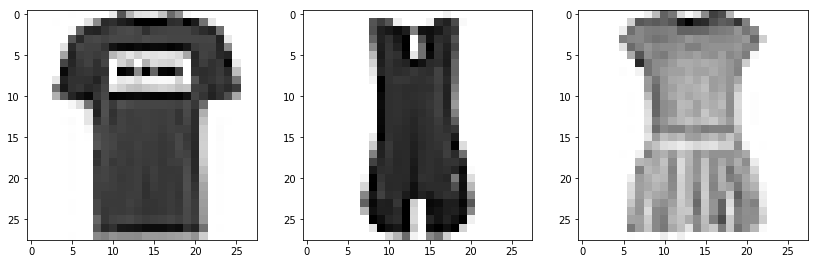

In [3]:
plt.figure(figsize=(14, 7))
plt.subplot(131)
plt.imshow(x_train[1], cmap='Greys')
plt.subplot(132)
plt.imshow(x_train[4], cmap='Greys')
plt.subplot(133)
plt.imshow(x_train[3], cmap='Greys')
plt.show()


In [0]:
x_train = np.expand_dims(x_train, axis=3)

In [5]:
def generator():
  model = Sequential()

  model.add(Dense(256, input_dim=100))
  model.add(LeakyReLU(0.2))
  model.add(BatchNormalization(momentum=0.8))
  
  model.add(Dense(512))
  model.add(LeakyReLU(0.2))
  model.add(BatchNormalization(momentum=0.8))

  model.add(Dense(1024))
  model.add(LeakyReLU(0.2))
  model.add(BatchNormalization(momentum=0.8))

  model.add(Dense(np.prod((28, 28, 1)), activation='tanh'))
  model.add(Reshape((28, 28, 1)))

  model.summary()

  noise = Input(shape=(100,))
  img = model(noise)

  return Model(noise, img)

generator = generator()
z = Input(shape=(100,))
img = generator(z)





Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1 (Dense)              (None, 256)               25856     
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 256)               0         
_________________________________________________________________
batch_normalization_1 (Batch (None, 256)               1024      
_________________________________________________________________
dense_2 (Dense)              (None, 512)               131584    
_________________________________________________________________
leaky_re_lu_2 (LeakyReLU)    (None, 512)               0         
_________________________________________________________________
batch_normalization_2 (Batch (None, 512)               2048      
_________________________________________________________________
dense_3 (Dense)              (None, 1024)         

In [6]:
def discriminator():
  model = Sequential()

  model.add(Flatten(input_shape=(28, 28, 1)))
  model.add(Dense(512))
  model.add(LeakyReLU(0.2))
  model.add(Dense(256))
  model.add(LeakyReLU(0.2))
  model.add(Dense(1, activation='sigmoid'))
  model.summary()

  img = Input(shape=(28, 28, 1))
  validity = model(img)

  return Model(img, validity)

discriminator = discriminator()
discriminator.compile(loss='binary_crossentropy', optimizer=Adam(0.0002, 0.5), metrics=['accuracy'])
discriminator.trainable = False

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
flatten_1 (Flatten)          (None, 784)               0         
_________________________________________________________________
dense_5 (Dense)              (None, 512)               401920    
_________________________________________________________________
leaky_re_lu_4 (LeakyReLU)    (None, 512)               0         
_________________________________________________________________
dense_6 (Dense)              (None, 256)               131328    
_________________________________________________________________
leaky_re_lu_5 (LeakyReLU)    (None, 256)               0         
_________________________________________________________________
dense_7 (Dense)              (None, 1)                 257       
Total params: 533,505
Trainable params: 533,505
Non-trainable params: 0
________________________________________________

In [0]:
validity = discriminator(img)
combined = Model(z, validity)
combined.compile(loss='binary_crossentropy', optimizer=Adam(0.0002, 0.5))

In [0]:
def sample_images(epoch):
  noise = np.random.normal(0, 1, (5*5, 100))
  gen_imgs = generator.predict(noise)

  gen_imgs = 0.5*gen_imgs+0.5

  fig, axs = plt.subplots(5, 5)
  cnt = 0
  for i in range(5):
    for j in range(5):
      axs[i, j].imshow(gen_imgs[cnt, :, :, 0], cmap='gray')
      axs[i, j].axis('off')
      cnt += 1

  plt.show()
  plt.close()

/usr/local/lib/python3.6/dist-packages/keras/engine/training.py:493: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'



0 [Discriminator loss: 0.676501, acc.: 42.19%] [Generator loss: 0.574633]


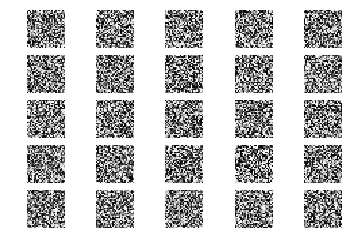

/usr/local/lib/python3.6/dist-packages/keras/engine/training.py:493: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


1 [Discriminator loss: 0.515009, acc.: 59.38%] [Generator loss: 0.553089]
2 [Discriminator loss: 0.431244, acc.: 70.31%] [Generator loss: 0.719924]
3 [Discriminator loss: 0.378743, acc.: 73.44%] [Generator loss: 0.898579]
4 [Discriminator loss: 0.322657, acc.: 79.69%] [Generator loss: 1.035166]
5 [Discriminator loss: 0.258988, acc.: 92.19%] [Generator loss: 1.133015]
6 [Discriminator loss: 0.220214, acc.: 98.44%] [Generator loss: 1.287514]
7 [Discriminator loss: 0.223699, acc.: 96.88%] [Generator loss: 1.434702]
8 [Discriminator loss: 0.184056, acc.: 96.88%] [Generator loss: 1.486103]
9 [Discriminator loss: 0.136381, acc.: 100.00%] [Generator loss: 1.591317]
10 [Discriminator loss: 0.148434, acc.: 100.00%] [Generator loss: 1.652024]
11 [Discriminator loss: 0.111653, acc.: 100.00%] [Generator loss: 1.684769]
12 [Discriminator loss: 0.122075, acc.: 98.44%] [Generator loss: 1.840637]
13 [Discriminator loss: 0.107505, acc.: 100.00%] [Generator loss: 1.968127]
14 [Discriminator loss: 0.1131

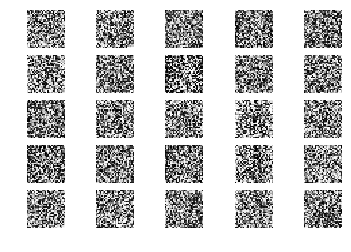

101 [Discriminator loss: 0.014663, acc.: 100.00%] [Generator loss: 4.418549]
102 [Discriminator loss: 0.012619, acc.: 100.00%] [Generator loss: 4.525360]
103 [Discriminator loss: 0.021991, acc.: 100.00%] [Generator loss: 4.452535]
104 [Discriminator loss: 0.016544, acc.: 100.00%] [Generator loss: 4.506719]
105 [Discriminator loss: 0.014926, acc.: 100.00%] [Generator loss: 4.573399]
106 [Discriminator loss: 0.013606, acc.: 100.00%] [Generator loss: 4.485866]
107 [Discriminator loss: 0.014126, acc.: 100.00%] [Generator loss: 4.452313]
108 [Discriminator loss: 0.013298, acc.: 100.00%] [Generator loss: 4.289522]
109 [Discriminator loss: 0.016165, acc.: 100.00%] [Generator loss: 4.421957]
110 [Discriminator loss: 0.020462, acc.: 100.00%] [Generator loss: 4.532860]
111 [Discriminator loss: 0.023696, acc.: 100.00%] [Generator loss: 4.564372]
112 [Discriminator loss: 0.046991, acc.: 98.44%] [Generator loss: 4.541442]
113 [Discriminator loss: 0.013867, acc.: 100.00%] [Generator loss: 4.384655]


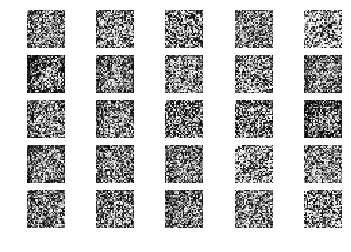

201 [Discriminator loss: 0.115448, acc.: 93.75%] [Generator loss: 4.133499]
202 [Discriminator loss: 0.222774, acc.: 90.62%] [Generator loss: 4.047446]
203 [Discriminator loss: 0.062483, acc.: 100.00%] [Generator loss: 4.470536]
204 [Discriminator loss: 0.106029, acc.: 93.75%] [Generator loss: 4.041478]
205 [Discriminator loss: 0.113210, acc.: 95.31%] [Generator loss: 4.272629]
206 [Discriminator loss: 0.089793, acc.: 96.88%] [Generator loss: 4.003446]
207 [Discriminator loss: 0.052132, acc.: 98.44%] [Generator loss: 4.335774]
208 [Discriminator loss: 0.110803, acc.: 96.88%] [Generator loss: 4.792315]
209 [Discriminator loss: 0.256595, acc.: 90.62%] [Generator loss: 4.139342]
210 [Discriminator loss: 0.152060, acc.: 92.19%] [Generator loss: 4.810948]
211 [Discriminator loss: 0.127255, acc.: 95.31%] [Generator loss: 4.251626]
212 [Discriminator loss: 0.162466, acc.: 95.31%] [Generator loss: 4.459049]
213 [Discriminator loss: 0.092610, acc.: 96.88%] [Generator loss: 4.756104]
214 [Discri

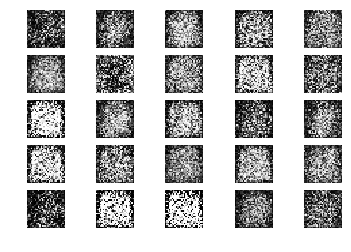

301 [Discriminator loss: 0.232091, acc.: 87.50%] [Generator loss: 3.619191]
302 [Discriminator loss: 0.412194, acc.: 92.19%] [Generator loss: 3.584929]
303 [Discriminator loss: 0.361078, acc.: 89.06%] [Generator loss: 3.478900]
304 [Discriminator loss: 0.257420, acc.: 90.62%] [Generator loss: 3.891296]
305 [Discriminator loss: 0.333982, acc.: 82.81%] [Generator loss: 3.692012]
306 [Discriminator loss: 0.206289, acc.: 92.19%] [Generator loss: 3.574344]
307 [Discriminator loss: 0.287746, acc.: 92.19%] [Generator loss: 3.178041]
308 [Discriminator loss: 0.239702, acc.: 87.50%] [Generator loss: 3.896855]
309 [Discriminator loss: 0.280945, acc.: 87.50%] [Generator loss: 3.081275]
310 [Discriminator loss: 0.142079, acc.: 93.75%] [Generator loss: 4.051269]
311 [Discriminator loss: 0.189496, acc.: 93.75%] [Generator loss: 3.937349]
312 [Discriminator loss: 0.416937, acc.: 82.81%] [Generator loss: 2.958058]
313 [Discriminator loss: 0.235873, acc.: 87.50%] [Generator loss: 4.098806]
314 [Discrim

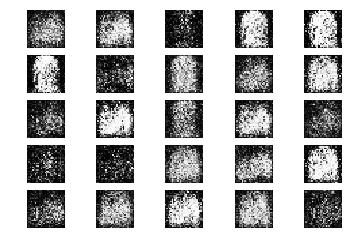

401 [Discriminator loss: 0.461374, acc.: 78.12%] [Generator loss: 1.959922]
402 [Discriminator loss: 0.588866, acc.: 76.56%] [Generator loss: 1.706534]
403 [Discriminator loss: 0.660459, acc.: 76.56%] [Generator loss: 1.686480]
404 [Discriminator loss: 0.515244, acc.: 73.44%] [Generator loss: 1.639742]
405 [Discriminator loss: 0.729015, acc.: 64.06%] [Generator loss: 1.428841]
406 [Discriminator loss: 0.490687, acc.: 76.56%] [Generator loss: 1.781778]
407 [Discriminator loss: 0.564983, acc.: 76.56%] [Generator loss: 1.537671]
408 [Discriminator loss: 0.574435, acc.: 67.19%] [Generator loss: 1.420106]
409 [Discriminator loss: 0.649545, acc.: 60.94%] [Generator loss: 1.657962]
410 [Discriminator loss: 0.488327, acc.: 75.00%] [Generator loss: 1.968547]
411 [Discriminator loss: 0.627668, acc.: 67.19%] [Generator loss: 1.802128]
412 [Discriminator loss: 0.778704, acc.: 70.31%] [Generator loss: 1.394457]
413 [Discriminator loss: 0.607170, acc.: 62.50%] [Generator loss: 1.626529]
414 [Discrim

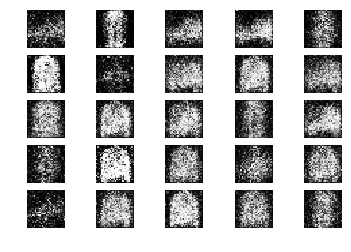

501 [Discriminator loss: 0.479403, acc.: 78.12%] [Generator loss: 1.182162]
502 [Discriminator loss: 0.657016, acc.: 71.88%] [Generator loss: 1.138484]
503 [Discriminator loss: 0.646878, acc.: 65.62%] [Generator loss: 1.060668]
504 [Discriminator loss: 0.532786, acc.: 73.44%] [Generator loss: 0.976522]
505 [Discriminator loss: 0.512494, acc.: 76.56%] [Generator loss: 1.160028]
506 [Discriminator loss: 0.604361, acc.: 68.75%] [Generator loss: 1.317627]
507 [Discriminator loss: 0.614130, acc.: 65.62%] [Generator loss: 1.171195]
508 [Discriminator loss: 0.587508, acc.: 65.62%] [Generator loss: 1.288647]
509 [Discriminator loss: 0.627614, acc.: 67.19%] [Generator loss: 1.201474]
510 [Discriminator loss: 0.576108, acc.: 71.88%] [Generator loss: 1.110548]
511 [Discriminator loss: 0.530342, acc.: 70.31%] [Generator loss: 1.248362]
512 [Discriminator loss: 0.543233, acc.: 71.88%] [Generator loss: 1.226172]
513 [Discriminator loss: 0.515798, acc.: 73.44%] [Generator loss: 1.216236]
514 [Discrim

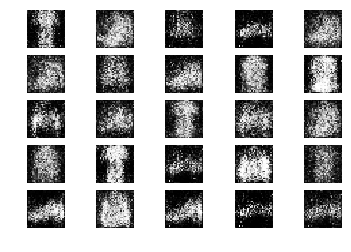

601 [Discriminator loss: 0.602357, acc.: 68.75%] [Generator loss: 1.017257]
602 [Discriminator loss: 0.625095, acc.: 70.31%] [Generator loss: 1.178555]
603 [Discriminator loss: 0.506642, acc.: 81.25%] [Generator loss: 1.179417]
604 [Discriminator loss: 0.539243, acc.: 71.88%] [Generator loss: 1.082522]
605 [Discriminator loss: 0.586977, acc.: 70.31%] [Generator loss: 1.217250]
606 [Discriminator loss: 0.646055, acc.: 62.50%] [Generator loss: 1.238737]
607 [Discriminator loss: 0.623689, acc.: 70.31%] [Generator loss: 1.226016]
608 [Discriminator loss: 0.608230, acc.: 70.31%] [Generator loss: 0.999271]
609 [Discriminator loss: 0.608618, acc.: 62.50%] [Generator loss: 1.102703]
610 [Discriminator loss: 0.516204, acc.: 78.12%] [Generator loss: 1.160545]
611 [Discriminator loss: 0.530705, acc.: 75.00%] [Generator loss: 1.148013]
612 [Discriminator loss: 0.560490, acc.: 79.69%] [Generator loss: 1.268032]
613 [Discriminator loss: 0.582582, acc.: 65.62%] [Generator loss: 1.118216]
614 [Discrim

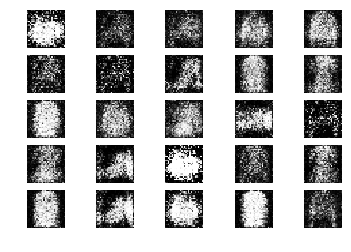

701 [Discriminator loss: 0.521815, acc.: 81.25%] [Generator loss: 1.151005]
702 [Discriminator loss: 0.493441, acc.: 81.25%] [Generator loss: 1.083730]
703 [Discriminator loss: 0.579527, acc.: 67.19%] [Generator loss: 1.085630]
704 [Discriminator loss: 0.491199, acc.: 84.38%] [Generator loss: 1.193642]
705 [Discriminator loss: 0.488277, acc.: 81.25%] [Generator loss: 1.198959]
706 [Discriminator loss: 0.498020, acc.: 78.12%] [Generator loss: 1.186237]
707 [Discriminator loss: 0.619427, acc.: 85.94%] [Generator loss: 1.215236]
708 [Discriminator loss: 0.505908, acc.: 75.00%] [Generator loss: 1.216258]
709 [Discriminator loss: 0.532359, acc.: 76.56%] [Generator loss: 1.182491]
710 [Discriminator loss: 0.548661, acc.: 76.56%] [Generator loss: 1.201334]
711 [Discriminator loss: 0.531522, acc.: 75.00%] [Generator loss: 1.117459]
712 [Discriminator loss: 0.534554, acc.: 73.44%] [Generator loss: 1.080042]
713 [Discriminator loss: 0.547428, acc.: 73.44%] [Generator loss: 1.108217]
714 [Discrim

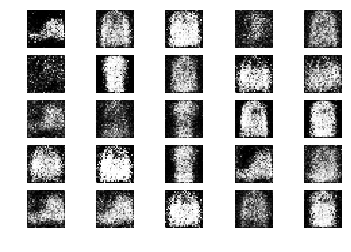

801 [Discriminator loss: 0.733341, acc.: 53.12%] [Generator loss: 1.061060]
802 [Discriminator loss: 0.705531, acc.: 53.12%] [Generator loss: 1.060910]
803 [Discriminator loss: 0.618329, acc.: 62.50%] [Generator loss: 1.070161]
804 [Discriminator loss: 0.660690, acc.: 59.38%] [Generator loss: 1.064415]
805 [Discriminator loss: 0.639562, acc.: 65.62%] [Generator loss: 1.009076]
806 [Discriminator loss: 0.682362, acc.: 59.38%] [Generator loss: 1.056302]
807 [Discriminator loss: 0.573089, acc.: 67.19%] [Generator loss: 1.019269]
808 [Discriminator loss: 0.587290, acc.: 65.62%] [Generator loss: 1.071281]
809 [Discriminator loss: 0.702694, acc.: 62.50%] [Generator loss: 1.111614]
810 [Discriminator loss: 0.696554, acc.: 64.06%] [Generator loss: 1.185703]
811 [Discriminator loss: 0.624123, acc.: 68.75%] [Generator loss: 1.033728]
812 [Discriminator loss: 0.683451, acc.: 60.94%] [Generator loss: 0.984051]
813 [Discriminator loss: 0.640652, acc.: 57.81%] [Generator loss: 0.985305]
814 [Discrim

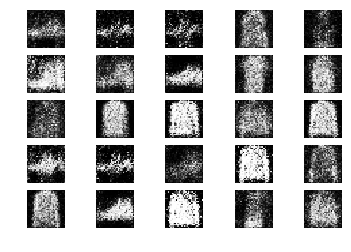

901 [Discriminator loss: 0.546994, acc.: 75.00%] [Generator loss: 1.062934]
902 [Discriminator loss: 0.721854, acc.: 57.81%] [Generator loss: 0.975772]
903 [Discriminator loss: 0.600854, acc.: 70.31%] [Generator loss: 0.963836]
904 [Discriminator loss: 0.637857, acc.: 65.62%] [Generator loss: 0.926282]
905 [Discriminator loss: 0.620210, acc.: 64.06%] [Generator loss: 0.917289]
906 [Discriminator loss: 0.592309, acc.: 73.44%] [Generator loss: 0.939240]
907 [Discriminator loss: 0.487743, acc.: 82.81%] [Generator loss: 0.975504]
908 [Discriminator loss: 0.609067, acc.: 65.62%] [Generator loss: 1.031238]
909 [Discriminator loss: 0.662051, acc.: 59.38%] [Generator loss: 0.939538]
910 [Discriminator loss: 0.626301, acc.: 65.62%] [Generator loss: 0.978882]
911 [Discriminator loss: 0.632179, acc.: 65.62%] [Generator loss: 0.897100]
912 [Discriminator loss: 0.556461, acc.: 75.00%] [Generator loss: 0.967563]
913 [Discriminator loss: 0.652539, acc.: 60.94%] [Generator loss: 0.994884]
914 [Discrim

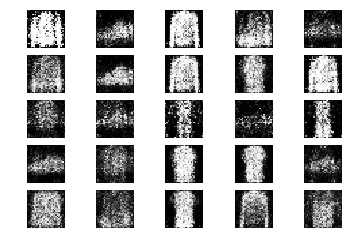

1001 [Discriminator loss: 0.632041, acc.: 67.19%] [Generator loss: 0.815504]
1002 [Discriminator loss: 0.634557, acc.: 73.44%] [Generator loss: 0.763606]
1003 [Discriminator loss: 0.587985, acc.: 62.50%] [Generator loss: 0.906129]
1004 [Discriminator loss: 0.568919, acc.: 75.00%] [Generator loss: 0.916722]
1005 [Discriminator loss: 0.586627, acc.: 68.75%] [Generator loss: 1.111504]
1006 [Discriminator loss: 0.664249, acc.: 65.62%] [Generator loss: 0.840609]
1007 [Discriminator loss: 0.610165, acc.: 71.88%] [Generator loss: 0.910498]
1008 [Discriminator loss: 0.667440, acc.: 64.06%] [Generator loss: 1.007267]
1009 [Discriminator loss: 0.549632, acc.: 76.56%] [Generator loss: 1.023405]
1010 [Discriminator loss: 0.652858, acc.: 53.12%] [Generator loss: 1.032280]
1011 [Discriminator loss: 0.682633, acc.: 56.25%] [Generator loss: 0.868193]
1012 [Discriminator loss: 0.635482, acc.: 65.62%] [Generator loss: 0.921914]
1013 [Discriminator loss: 0.567177, acc.: 78.12%] [Generator loss: 0.953356]

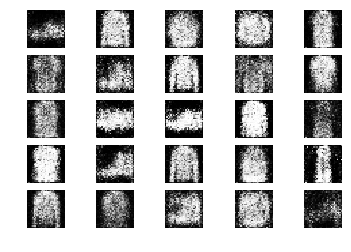

1101 [Discriminator loss: 0.592581, acc.: 75.00%] [Generator loss: 0.907139]
1102 [Discriminator loss: 0.650637, acc.: 60.94%] [Generator loss: 0.898564]
1103 [Discriminator loss: 0.612722, acc.: 67.19%] [Generator loss: 0.895468]
1104 [Discriminator loss: 0.622197, acc.: 70.31%] [Generator loss: 0.750732]
1105 [Discriminator loss: 0.586227, acc.: 68.75%] [Generator loss: 0.868611]
1106 [Discriminator loss: 0.665628, acc.: 57.81%] [Generator loss: 0.841297]
1107 [Discriminator loss: 0.604841, acc.: 60.94%] [Generator loss: 0.852918]
1108 [Discriminator loss: 0.685648, acc.: 53.12%] [Generator loss: 0.963982]
1109 [Discriminator loss: 0.640743, acc.: 62.50%] [Generator loss: 0.924093]
1110 [Discriminator loss: 0.583882, acc.: 68.75%] [Generator loss: 0.932343]
1111 [Discriminator loss: 0.634462, acc.: 59.38%] [Generator loss: 1.032864]
1112 [Discriminator loss: 0.590143, acc.: 67.19%] [Generator loss: 0.960940]
1113 [Discriminator loss: 0.658688, acc.: 62.50%] [Generator loss: 0.914148]

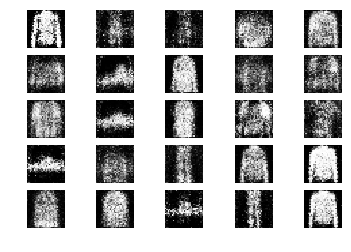

1201 [Discriminator loss: 0.619162, acc.: 59.38%] [Generator loss: 0.886534]
1202 [Discriminator loss: 0.561309, acc.: 70.31%] [Generator loss: 0.990137]
1203 [Discriminator loss: 0.597748, acc.: 67.19%] [Generator loss: 0.894513]
1204 [Discriminator loss: 0.680456, acc.: 51.56%] [Generator loss: 0.868445]
1205 [Discriminator loss: 0.596773, acc.: 64.06%] [Generator loss: 0.901522]
1206 [Discriminator loss: 0.614055, acc.: 68.75%] [Generator loss: 0.986609]
1207 [Discriminator loss: 0.563183, acc.: 76.56%] [Generator loss: 1.057756]
1208 [Discriminator loss: 0.609677, acc.: 70.31%] [Generator loss: 0.992866]
1209 [Discriminator loss: 0.629389, acc.: 65.62%] [Generator loss: 0.937689]
1210 [Discriminator loss: 0.631056, acc.: 70.31%] [Generator loss: 0.871709]
1211 [Discriminator loss: 0.597108, acc.: 64.06%] [Generator loss: 0.870085]
1212 [Discriminator loss: 0.621965, acc.: 67.19%] [Generator loss: 0.833382]
1213 [Discriminator loss: 0.651581, acc.: 65.62%] [Generator loss: 0.811237]

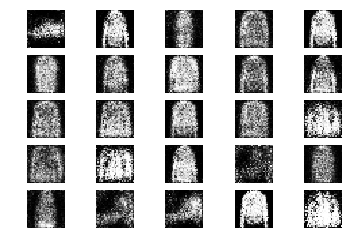

1301 [Discriminator loss: 0.598472, acc.: 67.19%] [Generator loss: 0.937297]
1302 [Discriminator loss: 0.573061, acc.: 68.75%] [Generator loss: 0.914901]
1303 [Discriminator loss: 0.646340, acc.: 59.38%] [Generator loss: 0.847232]
1304 [Discriminator loss: 0.669764, acc.: 53.12%] [Generator loss: 0.873788]
1305 [Discriminator loss: 0.575536, acc.: 71.88%] [Generator loss: 0.898592]
1306 [Discriminator loss: 0.591157, acc.: 70.31%] [Generator loss: 0.967477]
1307 [Discriminator loss: 0.660268, acc.: 56.25%] [Generator loss: 0.898979]
1308 [Discriminator loss: 0.595532, acc.: 65.62%] [Generator loss: 0.881318]
1309 [Discriminator loss: 0.637800, acc.: 62.50%] [Generator loss: 0.834574]
1310 [Discriminator loss: 0.644692, acc.: 57.81%] [Generator loss: 0.795976]
1311 [Discriminator loss: 0.617689, acc.: 67.19%] [Generator loss: 0.849549]
1312 [Discriminator loss: 0.583608, acc.: 75.00%] [Generator loss: 0.988433]
1313 [Discriminator loss: 0.604934, acc.: 65.62%] [Generator loss: 0.893520]

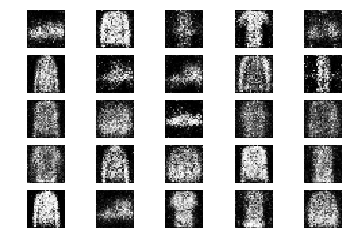

1401 [Discriminator loss: 0.579823, acc.: 70.31%] [Generator loss: 0.846688]
1402 [Discriminator loss: 0.594502, acc.: 75.00%] [Generator loss: 0.922795]
1403 [Discriminator loss: 0.546309, acc.: 75.00%] [Generator loss: 1.056934]
1404 [Discriminator loss: 0.615551, acc.: 68.75%] [Generator loss: 0.990504]
1405 [Discriminator loss: 0.557415, acc.: 75.00%] [Generator loss: 0.968743]
1406 [Discriminator loss: 0.593773, acc.: 65.62%] [Generator loss: 0.987289]
1407 [Discriminator loss: 0.662662, acc.: 62.50%] [Generator loss: 0.911027]
1408 [Discriminator loss: 0.671840, acc.: 51.56%] [Generator loss: 0.950879]
1409 [Discriminator loss: 0.613747, acc.: 68.75%] [Generator loss: 0.928510]
1410 [Discriminator loss: 0.623825, acc.: 57.81%] [Generator loss: 0.960823]
1411 [Discriminator loss: 0.567908, acc.: 78.12%] [Generator loss: 0.906200]
1412 [Discriminator loss: 0.624765, acc.: 57.81%] [Generator loss: 0.908759]
1413 [Discriminator loss: 0.618564, acc.: 60.94%] [Generator loss: 0.908871]

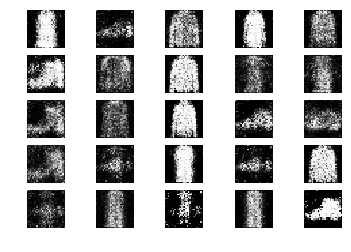

1501 [Discriminator loss: 0.615091, acc.: 73.44%] [Generator loss: 0.922604]
1502 [Discriminator loss: 0.594130, acc.: 65.62%] [Generator loss: 0.827189]
1503 [Discriminator loss: 0.713842, acc.: 51.56%] [Generator loss: 0.851374]
1504 [Discriminator loss: 0.612312, acc.: 64.06%] [Generator loss: 0.937095]
1505 [Discriminator loss: 0.587238, acc.: 65.62%] [Generator loss: 0.936855]
1506 [Discriminator loss: 0.520744, acc.: 75.00%] [Generator loss: 0.927572]
1507 [Discriminator loss: 0.605870, acc.: 64.06%] [Generator loss: 0.881644]
1508 [Discriminator loss: 0.562123, acc.: 78.12%] [Generator loss: 1.051120]
1509 [Discriminator loss: 0.521343, acc.: 82.81%] [Generator loss: 0.995525]
1510 [Discriminator loss: 0.711075, acc.: 53.12%] [Generator loss: 0.921803]
1511 [Discriminator loss: 0.653985, acc.: 56.25%] [Generator loss: 0.812543]
1512 [Discriminator loss: 0.571313, acc.: 73.44%] [Generator loss: 0.917710]
1513 [Discriminator loss: 0.561350, acc.: 71.88%] [Generator loss: 0.957692]

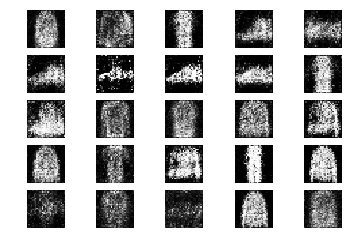

1601 [Discriminator loss: 0.643443, acc.: 57.81%] [Generator loss: 0.940497]
1602 [Discriminator loss: 0.601704, acc.: 71.88%] [Generator loss: 0.972121]
1603 [Discriminator loss: 0.639661, acc.: 65.62%] [Generator loss: 0.945365]
1604 [Discriminator loss: 0.611864, acc.: 68.75%] [Generator loss: 0.956798]
1605 [Discriminator loss: 0.607427, acc.: 68.75%] [Generator loss: 0.947176]
1606 [Discriminator loss: 0.614225, acc.: 68.75%] [Generator loss: 0.933460]
1607 [Discriminator loss: 0.497896, acc.: 81.25%] [Generator loss: 0.950747]
1608 [Discriminator loss: 0.539372, acc.: 73.44%] [Generator loss: 0.977344]
1609 [Discriminator loss: 0.603126, acc.: 64.06%] [Generator loss: 0.889378]
1610 [Discriminator loss: 0.572763, acc.: 68.75%] [Generator loss: 0.906380]
1611 [Discriminator loss: 0.593582, acc.: 68.75%] [Generator loss: 0.926888]
1612 [Discriminator loss: 0.634539, acc.: 68.75%] [Generator loss: 0.935644]
1613 [Discriminator loss: 0.578061, acc.: 68.75%] [Generator loss: 0.930454]

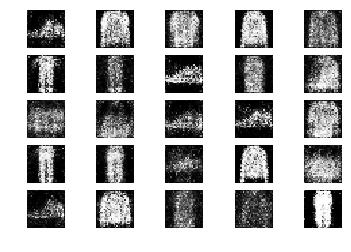

1701 [Discriminator loss: 0.603108, acc.: 67.19%] [Generator loss: 0.903969]
1702 [Discriminator loss: 0.667692, acc.: 64.06%] [Generator loss: 0.914409]
1703 [Discriminator loss: 0.643858, acc.: 57.81%] [Generator loss: 0.918441]
1704 [Discriminator loss: 0.596683, acc.: 68.75%] [Generator loss: 0.936306]
1705 [Discriminator loss: 0.714096, acc.: 57.81%] [Generator loss: 0.942649]
1706 [Discriminator loss: 0.632213, acc.: 56.25%] [Generator loss: 1.010272]
1707 [Discriminator loss: 0.642657, acc.: 68.75%] [Generator loss: 0.947439]
1708 [Discriminator loss: 0.641991, acc.: 65.62%] [Generator loss: 0.952948]
1709 [Discriminator loss: 0.554142, acc.: 78.12%] [Generator loss: 0.957444]
1710 [Discriminator loss: 0.579363, acc.: 65.62%] [Generator loss: 0.858081]
1711 [Discriminator loss: 0.582737, acc.: 70.31%] [Generator loss: 0.958951]
1712 [Discriminator loss: 0.568639, acc.: 79.69%] [Generator loss: 1.001580]
1713 [Discriminator loss: 0.708342, acc.: 57.81%] [Generator loss: 0.880928]

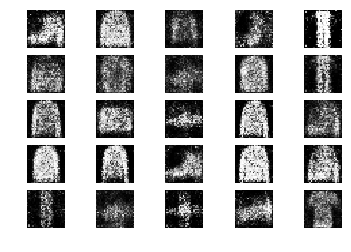

1801 [Discriminator loss: 0.547157, acc.: 71.88%] [Generator loss: 1.059931]
1802 [Discriminator loss: 0.667784, acc.: 54.69%] [Generator loss: 0.920147]
1803 [Discriminator loss: 0.583811, acc.: 65.62%] [Generator loss: 0.989714]
1804 [Discriminator loss: 0.585451, acc.: 68.75%] [Generator loss: 0.845422]
1805 [Discriminator loss: 0.590585, acc.: 68.75%] [Generator loss: 0.926622]
1806 [Discriminator loss: 0.585654, acc.: 59.38%] [Generator loss: 0.908761]
1807 [Discriminator loss: 0.610568, acc.: 62.50%] [Generator loss: 0.965307]
1808 [Discriminator loss: 0.579364, acc.: 76.56%] [Generator loss: 0.963886]
1809 [Discriminator loss: 0.655079, acc.: 64.06%] [Generator loss: 0.866616]
1810 [Discriminator loss: 0.579345, acc.: 73.44%] [Generator loss: 0.958222]
1811 [Discriminator loss: 0.654272, acc.: 59.38%] [Generator loss: 0.867482]
1812 [Discriminator loss: 0.592890, acc.: 65.62%] [Generator loss: 0.952954]
1813 [Discriminator loss: 0.614937, acc.: 71.88%] [Generator loss: 1.017514]

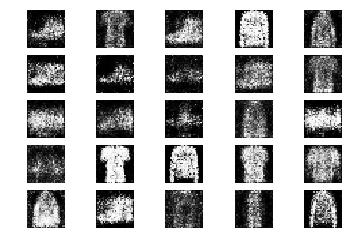

1901 [Discriminator loss: 0.591567, acc.: 67.19%] [Generator loss: 1.044793]
1902 [Discriminator loss: 0.654243, acc.: 57.81%] [Generator loss: 0.943870]
1903 [Discriminator loss: 0.633737, acc.: 62.50%] [Generator loss: 0.949143]
1904 [Discriminator loss: 0.560333, acc.: 70.31%] [Generator loss: 1.018486]
1905 [Discriminator loss: 0.602314, acc.: 68.75%] [Generator loss: 0.928094]
1906 [Discriminator loss: 0.546272, acc.: 71.88%] [Generator loss: 0.897123]
1907 [Discriminator loss: 0.591829, acc.: 67.19%] [Generator loss: 0.952813]
1908 [Discriminator loss: 0.592063, acc.: 68.75%] [Generator loss: 0.872289]
1909 [Discriminator loss: 0.583655, acc.: 59.38%] [Generator loss: 0.907411]
1910 [Discriminator loss: 0.627733, acc.: 68.75%] [Generator loss: 0.920625]
1911 [Discriminator loss: 0.641539, acc.: 56.25%] [Generator loss: 0.888111]
1912 [Discriminator loss: 0.626966, acc.: 60.94%] [Generator loss: 0.913960]
1913 [Discriminator loss: 0.580048, acc.: 64.06%] [Generator loss: 0.859437]

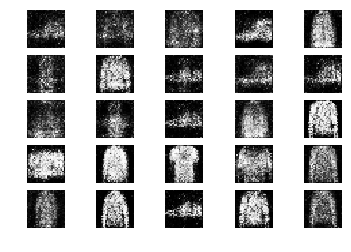

2001 [Discriminator loss: 0.607030, acc.: 62.50%] [Generator loss: 1.004959]
2002 [Discriminator loss: 0.649512, acc.: 65.62%] [Generator loss: 1.015912]
2003 [Discriminator loss: 0.644843, acc.: 57.81%] [Generator loss: 1.031039]
2004 [Discriminator loss: 0.595178, acc.: 75.00%] [Generator loss: 0.898346]
2005 [Discriminator loss: 0.742201, acc.: 45.31%] [Generator loss: 0.954613]
2006 [Discriminator loss: 0.611171, acc.: 67.19%] [Generator loss: 0.915486]
2007 [Discriminator loss: 0.641177, acc.: 64.06%] [Generator loss: 0.853621]
2008 [Discriminator loss: 0.589246, acc.: 67.19%] [Generator loss: 0.886645]
2009 [Discriminator loss: 0.574098, acc.: 70.31%] [Generator loss: 0.895509]
2010 [Discriminator loss: 0.579451, acc.: 75.00%] [Generator loss: 0.834284]
2011 [Discriminator loss: 0.594197, acc.: 65.62%] [Generator loss: 0.953346]
2012 [Discriminator loss: 0.542367, acc.: 71.88%] [Generator loss: 1.031740]
2013 [Discriminator loss: 0.562608, acc.: 75.00%] [Generator loss: 1.011605]

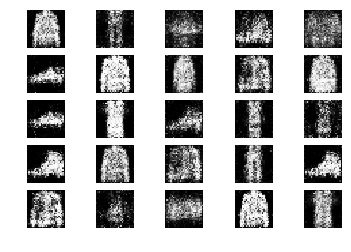

2101 [Discriminator loss: 0.644756, acc.: 62.50%] [Generator loss: 0.968223]
2102 [Discriminator loss: 0.618201, acc.: 68.75%] [Generator loss: 0.984256]
2103 [Discriminator loss: 0.640726, acc.: 60.94%] [Generator loss: 0.855104]
2104 [Discriminator loss: 0.600923, acc.: 65.62%] [Generator loss: 0.952314]
2105 [Discriminator loss: 0.651345, acc.: 64.06%] [Generator loss: 0.983670]
2106 [Discriminator loss: 0.561550, acc.: 79.69%] [Generator loss: 1.014026]
2107 [Discriminator loss: 0.608443, acc.: 67.19%] [Generator loss: 0.996401]
2108 [Discriminator loss: 0.608391, acc.: 60.94%] [Generator loss: 0.878548]
2109 [Discriminator loss: 0.642429, acc.: 64.06%] [Generator loss: 0.969132]
2110 [Discriminator loss: 0.639366, acc.: 57.81%] [Generator loss: 1.000702]
2111 [Discriminator loss: 0.586188, acc.: 75.00%] [Generator loss: 0.897714]
2112 [Discriminator loss: 0.635854, acc.: 60.94%] [Generator loss: 0.946607]
2113 [Discriminator loss: 0.638131, acc.: 59.38%] [Generator loss: 0.822443]

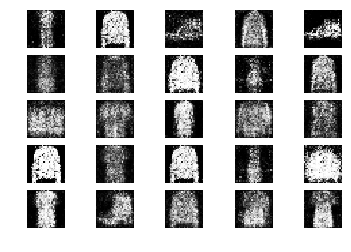

2201 [Discriminator loss: 0.582854, acc.: 67.19%] [Generator loss: 0.972145]
2202 [Discriminator loss: 0.565416, acc.: 75.00%] [Generator loss: 1.018002]
2203 [Discriminator loss: 0.549488, acc.: 67.19%] [Generator loss: 1.016779]
2204 [Discriminator loss: 0.693140, acc.: 64.06%] [Generator loss: 0.930137]
2205 [Discriminator loss: 0.531515, acc.: 76.56%] [Generator loss: 1.047491]
2206 [Discriminator loss: 0.641897, acc.: 53.12%] [Generator loss: 0.902630]
2207 [Discriminator loss: 0.600762, acc.: 68.75%] [Generator loss: 0.927329]
2208 [Discriminator loss: 0.555306, acc.: 70.31%] [Generator loss: 0.943972]
2209 [Discriminator loss: 0.608656, acc.: 70.31%] [Generator loss: 0.895235]
2210 [Discriminator loss: 0.584874, acc.: 70.31%] [Generator loss: 0.938121]
2211 [Discriminator loss: 0.593861, acc.: 60.94%] [Generator loss: 0.876134]
2212 [Discriminator loss: 0.631108, acc.: 64.06%] [Generator loss: 0.928969]
2213 [Discriminator loss: 0.637751, acc.: 70.31%] [Generator loss: 0.987475]

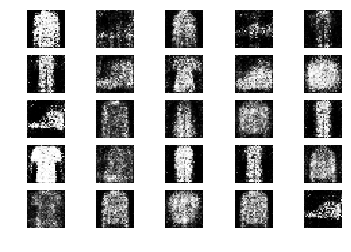

2301 [Discriminator loss: 0.639582, acc.: 59.38%] [Generator loss: 1.004319]
2302 [Discriminator loss: 0.578327, acc.: 68.75%] [Generator loss: 0.926317]
2303 [Discriminator loss: 0.642238, acc.: 57.81%] [Generator loss: 0.908457]
2304 [Discriminator loss: 0.561841, acc.: 75.00%] [Generator loss: 1.070045]
2305 [Discriminator loss: 0.651767, acc.: 53.12%] [Generator loss: 1.041708]
2306 [Discriminator loss: 0.653326, acc.: 60.94%] [Generator loss: 0.991776]
2307 [Discriminator loss: 0.618452, acc.: 60.94%] [Generator loss: 0.947002]
2308 [Discriminator loss: 0.619597, acc.: 62.50%] [Generator loss: 0.897567]
2309 [Discriminator loss: 0.572776, acc.: 73.44%] [Generator loss: 1.041745]
2310 [Discriminator loss: 0.625026, acc.: 62.50%] [Generator loss: 1.044903]
2311 [Discriminator loss: 0.628389, acc.: 70.31%] [Generator loss: 0.999652]
2312 [Discriminator loss: 0.613301, acc.: 67.19%] [Generator loss: 1.022130]
2313 [Discriminator loss: 0.651992, acc.: 59.38%] [Generator loss: 0.940319]

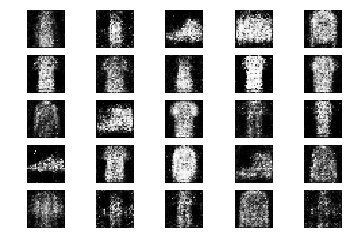

2401 [Discriminator loss: 0.585674, acc.: 68.75%] [Generator loss: 0.959190]
2402 [Discriminator loss: 0.575920, acc.: 67.19%] [Generator loss: 0.988131]
2403 [Discriminator loss: 0.656086, acc.: 62.50%] [Generator loss: 0.901939]
2404 [Discriminator loss: 0.592923, acc.: 70.31%] [Generator loss: 1.067760]
2405 [Discriminator loss: 0.523550, acc.: 73.44%] [Generator loss: 0.926887]
2406 [Discriminator loss: 0.619879, acc.: 60.94%] [Generator loss: 0.960918]
2407 [Discriminator loss: 0.688983, acc.: 57.81%] [Generator loss: 1.001863]
2408 [Discriminator loss: 0.612606, acc.: 70.31%] [Generator loss: 0.893208]
2409 [Discriminator loss: 0.601258, acc.: 68.75%] [Generator loss: 0.925631]
2410 [Discriminator loss: 0.578868, acc.: 68.75%] [Generator loss: 0.873480]
2411 [Discriminator loss: 0.597432, acc.: 68.75%] [Generator loss: 1.064505]
2412 [Discriminator loss: 0.571868, acc.: 70.31%] [Generator loss: 0.964313]
2413 [Discriminator loss: 0.619474, acc.: 62.50%] [Generator loss: 1.004673]

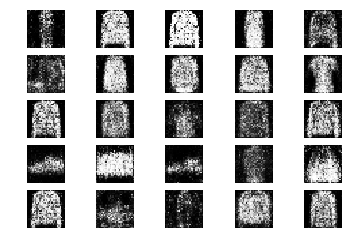

2501 [Discriminator loss: 0.575025, acc.: 71.88%] [Generator loss: 0.891588]
2502 [Discriminator loss: 0.627366, acc.: 67.19%] [Generator loss: 0.864290]
2503 [Discriminator loss: 0.597281, acc.: 62.50%] [Generator loss: 0.921227]
2504 [Discriminator loss: 0.678179, acc.: 60.94%] [Generator loss: 0.883400]
2505 [Discriminator loss: 0.705570, acc.: 57.81%] [Generator loss: 0.903800]
2506 [Discriminator loss: 0.641855, acc.: 59.38%] [Generator loss: 1.026630]
2507 [Discriminator loss: 0.598903, acc.: 60.94%] [Generator loss: 0.950449]
2508 [Discriminator loss: 0.654835, acc.: 62.50%] [Generator loss: 0.951879]
2509 [Discriminator loss: 0.603217, acc.: 68.75%] [Generator loss: 0.992036]
2510 [Discriminator loss: 0.669263, acc.: 60.94%] [Generator loss: 0.867081]
2511 [Discriminator loss: 0.624337, acc.: 64.06%] [Generator loss: 0.975300]
2512 [Discriminator loss: 0.642560, acc.: 71.88%] [Generator loss: 0.882973]
2513 [Discriminator loss: 0.652108, acc.: 54.69%] [Generator loss: 1.063322]

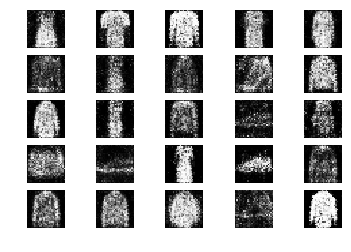

2601 [Discriminator loss: 0.671328, acc.: 53.12%] [Generator loss: 0.976122]
2602 [Discriminator loss: 0.637416, acc.: 62.50%] [Generator loss: 0.917651]
2603 [Discriminator loss: 0.540850, acc.: 75.00%] [Generator loss: 1.030392]
2604 [Discriminator loss: 0.649687, acc.: 57.81%] [Generator loss: 0.953713]
2605 [Discriminator loss: 0.603801, acc.: 65.62%] [Generator loss: 1.046106]
2606 [Discriminator loss: 0.648144, acc.: 62.50%] [Generator loss: 0.888942]
2607 [Discriminator loss: 0.540645, acc.: 70.31%] [Generator loss: 0.991523]
2608 [Discriminator loss: 0.600310, acc.: 59.38%] [Generator loss: 0.969515]
2609 [Discriminator loss: 0.628061, acc.: 64.06%] [Generator loss: 0.991838]
2610 [Discriminator loss: 0.534997, acc.: 75.00%] [Generator loss: 0.916385]
2611 [Discriminator loss: 0.623105, acc.: 68.75%] [Generator loss: 0.973231]
2612 [Discriminator loss: 0.675270, acc.: 56.25%] [Generator loss: 1.009977]
2613 [Discriminator loss: 0.620927, acc.: 65.62%] [Generator loss: 0.924744]

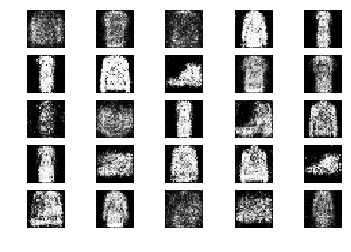

2701 [Discriminator loss: 0.573619, acc.: 67.19%] [Generator loss: 0.923608]
2702 [Discriminator loss: 0.615788, acc.: 59.38%] [Generator loss: 0.968192]
2703 [Discriminator loss: 0.566240, acc.: 78.12%] [Generator loss: 0.956797]
2704 [Discriminator loss: 0.569142, acc.: 67.19%] [Generator loss: 0.950271]
2705 [Discriminator loss: 0.643182, acc.: 62.50%] [Generator loss: 0.962897]
2706 [Discriminator loss: 0.618785, acc.: 60.94%] [Generator loss: 1.010875]
2707 [Discriminator loss: 0.662656, acc.: 60.94%] [Generator loss: 0.990522]
2708 [Discriminator loss: 0.557981, acc.: 71.88%] [Generator loss: 0.898619]
2709 [Discriminator loss: 0.647121, acc.: 65.62%] [Generator loss: 0.976604]
2710 [Discriminator loss: 0.627619, acc.: 68.75%] [Generator loss: 0.954672]
2711 [Discriminator loss: 0.647608, acc.: 60.94%] [Generator loss: 0.856777]
2712 [Discriminator loss: 0.646131, acc.: 51.56%] [Generator loss: 0.902843]
2713 [Discriminator loss: 0.571446, acc.: 73.44%] [Generator loss: 0.921486]

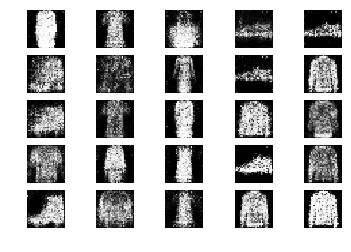

2801 [Discriminator loss: 0.488561, acc.: 75.00%] [Generator loss: 1.024191]
2802 [Discriminator loss: 0.662744, acc.: 54.69%] [Generator loss: 1.031863]
2803 [Discriminator loss: 0.599520, acc.: 64.06%] [Generator loss: 0.978907]
2804 [Discriminator loss: 0.554722, acc.: 79.69%] [Generator loss: 0.876681]
2805 [Discriminator loss: 0.605010, acc.: 68.75%] [Generator loss: 0.918392]
2806 [Discriminator loss: 0.567723, acc.: 68.75%] [Generator loss: 0.835224]
2807 [Discriminator loss: 0.578201, acc.: 71.88%] [Generator loss: 0.974674]
2808 [Discriminator loss: 0.658279, acc.: 56.25%] [Generator loss: 0.975336]
2809 [Discriminator loss: 0.661373, acc.: 65.62%] [Generator loss: 1.023246]
2810 [Discriminator loss: 0.664891, acc.: 62.50%] [Generator loss: 0.979664]
2811 [Discriminator loss: 0.631077, acc.: 71.88%] [Generator loss: 0.984170]
2812 [Discriminator loss: 0.697286, acc.: 57.81%] [Generator loss: 1.048721]
2813 [Discriminator loss: 0.572366, acc.: 71.88%] [Generator loss: 0.952391]

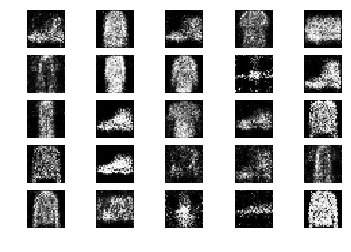

2901 [Discriminator loss: 0.676634, acc.: 54.69%] [Generator loss: 0.937801]
2902 [Discriminator loss: 0.585518, acc.: 65.62%] [Generator loss: 0.940924]
2903 [Discriminator loss: 0.572816, acc.: 67.19%] [Generator loss: 0.916150]
2904 [Discriminator loss: 0.667978, acc.: 62.50%] [Generator loss: 0.980975]
2905 [Discriminator loss: 0.530337, acc.: 73.44%] [Generator loss: 0.950819]
2906 [Discriminator loss: 0.641678, acc.: 59.38%] [Generator loss: 0.884043]
2907 [Discriminator loss: 0.581659, acc.: 71.88%] [Generator loss: 1.005350]
2908 [Discriminator loss: 0.638853, acc.: 64.06%] [Generator loss: 0.966531]
2909 [Discriminator loss: 0.529327, acc.: 78.12%] [Generator loss: 0.993354]
2910 [Discriminator loss: 0.686444, acc.: 59.38%] [Generator loss: 0.927791]
2911 [Discriminator loss: 0.694483, acc.: 51.56%] [Generator loss: 0.937272]
2912 [Discriminator loss: 0.647123, acc.: 62.50%] [Generator loss: 1.022181]
2913 [Discriminator loss: 0.606624, acc.: 64.06%] [Generator loss: 0.877741]

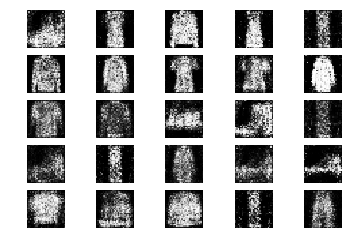

3001 [Discriminator loss: 0.592398, acc.: 67.19%] [Generator loss: 0.978490]
3002 [Discriminator loss: 0.662104, acc.: 59.38%] [Generator loss: 0.796117]
3003 [Discriminator loss: 0.553353, acc.: 78.12%] [Generator loss: 0.836429]
3004 [Discriminator loss: 0.626455, acc.: 57.81%] [Generator loss: 0.906771]
3005 [Discriminator loss: 0.612512, acc.: 64.06%] [Generator loss: 0.943657]
3006 [Discriminator loss: 0.559291, acc.: 71.88%] [Generator loss: 0.899766]
3007 [Discriminator loss: 0.654625, acc.: 51.56%] [Generator loss: 1.000974]
3008 [Discriminator loss: 0.569427, acc.: 68.75%] [Generator loss: 1.008348]
3009 [Discriminator loss: 0.607470, acc.: 64.06%] [Generator loss: 0.881884]
3010 [Discriminator loss: 0.568521, acc.: 71.88%] [Generator loss: 0.931975]
3011 [Discriminator loss: 0.583019, acc.: 75.00%] [Generator loss: 0.962169]
3012 [Discriminator loss: 0.576668, acc.: 70.31%] [Generator loss: 0.979871]
3013 [Discriminator loss: 0.535936, acc.: 70.31%] [Generator loss: 0.971294]

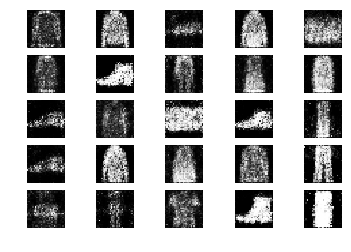

3101 [Discriminator loss: 0.661207, acc.: 64.06%] [Generator loss: 0.954590]
3102 [Discriminator loss: 0.586548, acc.: 68.75%] [Generator loss: 0.935441]
3103 [Discriminator loss: 0.559543, acc.: 70.31%] [Generator loss: 0.952264]
3104 [Discriminator loss: 0.620301, acc.: 62.50%] [Generator loss: 0.898802]
3105 [Discriminator loss: 0.638652, acc.: 62.50%] [Generator loss: 0.862986]
3106 [Discriminator loss: 0.599360, acc.: 67.19%] [Generator loss: 0.873565]
3107 [Discriminator loss: 0.625374, acc.: 59.38%] [Generator loss: 0.917684]
3108 [Discriminator loss: 0.623415, acc.: 75.00%] [Generator loss: 0.853085]
3109 [Discriminator loss: 0.544182, acc.: 75.00%] [Generator loss: 0.849729]
3110 [Discriminator loss: 0.612576, acc.: 65.62%] [Generator loss: 0.939068]
3111 [Discriminator loss: 0.600720, acc.: 70.31%] [Generator loss: 0.898066]
3112 [Discriminator loss: 0.617548, acc.: 65.62%] [Generator loss: 0.942985]
3113 [Discriminator loss: 0.642168, acc.: 64.06%] [Generator loss: 1.058963]

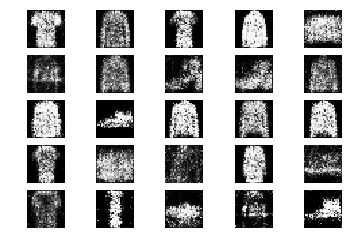

3201 [Discriminator loss: 0.636543, acc.: 56.25%] [Generator loss: 0.891163]
3202 [Discriminator loss: 0.662027, acc.: 56.25%] [Generator loss: 0.930909]
3203 [Discriminator loss: 0.688716, acc.: 64.06%] [Generator loss: 0.949248]
3204 [Discriminator loss: 0.631284, acc.: 56.25%] [Generator loss: 0.977311]
3205 [Discriminator loss: 0.639611, acc.: 54.69%] [Generator loss: 0.924049]
3206 [Discriminator loss: 0.587796, acc.: 65.62%] [Generator loss: 0.990977]
3207 [Discriminator loss: 0.612314, acc.: 67.19%] [Generator loss: 0.889580]
3208 [Discriminator loss: 0.628807, acc.: 60.94%] [Generator loss: 0.892567]
3209 [Discriminator loss: 0.648052, acc.: 64.06%] [Generator loss: 0.943035]
3210 [Discriminator loss: 0.657182, acc.: 62.50%] [Generator loss: 1.079263]
3211 [Discriminator loss: 0.555903, acc.: 78.12%] [Generator loss: 1.081313]
3212 [Discriminator loss: 0.643670, acc.: 60.94%] [Generator loss: 0.893707]
3213 [Discriminator loss: 0.627911, acc.: 67.19%] [Generator loss: 0.936401]

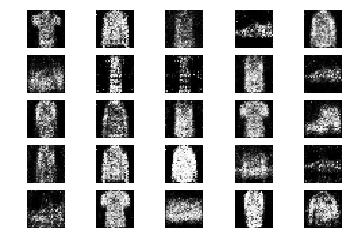

3301 [Discriminator loss: 0.581494, acc.: 75.00%] [Generator loss: 1.051080]
3302 [Discriminator loss: 0.539778, acc.: 75.00%] [Generator loss: 0.954878]
3303 [Discriminator loss: 0.652506, acc.: 59.38%] [Generator loss: 1.027753]
3304 [Discriminator loss: 0.639270, acc.: 64.06%] [Generator loss: 0.908774]
3305 [Discriminator loss: 0.639307, acc.: 64.06%] [Generator loss: 0.922792]
3306 [Discriminator loss: 0.696952, acc.: 54.69%] [Generator loss: 0.913054]
3307 [Discriminator loss: 0.598449, acc.: 70.31%] [Generator loss: 0.903521]
3308 [Discriminator loss: 0.615849, acc.: 67.19%] [Generator loss: 0.909164]
3309 [Discriminator loss: 0.583582, acc.: 75.00%] [Generator loss: 0.862609]
3310 [Discriminator loss: 0.601318, acc.: 71.88%] [Generator loss: 0.884773]
3311 [Discriminator loss: 0.654645, acc.: 59.38%] [Generator loss: 0.918875]
3312 [Discriminator loss: 0.586616, acc.: 68.75%] [Generator loss: 0.910792]
3313 [Discriminator loss: 0.651437, acc.: 59.38%] [Generator loss: 0.962901]

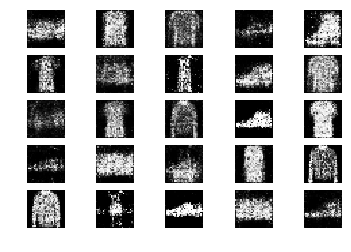

3401 [Discriminator loss: 0.642825, acc.: 59.38%] [Generator loss: 1.014150]
3402 [Discriminator loss: 0.572318, acc.: 71.88%] [Generator loss: 1.038094]
3403 [Discriminator loss: 0.597655, acc.: 68.75%] [Generator loss: 0.932652]
3404 [Discriminator loss: 0.657996, acc.: 56.25%] [Generator loss: 0.950224]
3405 [Discriminator loss: 0.607063, acc.: 68.75%] [Generator loss: 0.910602]
3406 [Discriminator loss: 0.606367, acc.: 64.06%] [Generator loss: 0.990185]
3407 [Discriminator loss: 0.585347, acc.: 68.75%] [Generator loss: 0.995645]
3408 [Discriminator loss: 0.674300, acc.: 62.50%] [Generator loss: 0.942707]
3409 [Discriminator loss: 0.628030, acc.: 60.94%] [Generator loss: 0.925708]
3410 [Discriminator loss: 0.674874, acc.: 60.94%] [Generator loss: 0.950120]
3411 [Discriminator loss: 0.603750, acc.: 62.50%] [Generator loss: 0.982840]
3412 [Discriminator loss: 0.598294, acc.: 65.62%] [Generator loss: 0.922195]
3413 [Discriminator loss: 0.580416, acc.: 67.19%] [Generator loss: 1.083104]

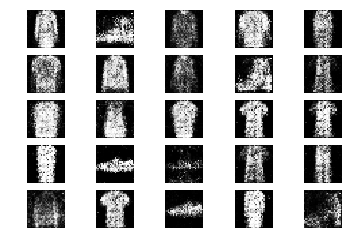

3501 [Discriminator loss: 0.556201, acc.: 68.75%] [Generator loss: 1.049263]
3502 [Discriminator loss: 0.594549, acc.: 71.88%] [Generator loss: 0.898216]
3503 [Discriminator loss: 0.678423, acc.: 56.25%] [Generator loss: 0.991989]
3504 [Discriminator loss: 0.625890, acc.: 62.50%] [Generator loss: 0.954916]
3505 [Discriminator loss: 0.568808, acc.: 71.88%] [Generator loss: 1.011062]
3506 [Discriminator loss: 0.545161, acc.: 76.56%] [Generator loss: 0.866562]
3507 [Discriminator loss: 0.734351, acc.: 45.31%] [Generator loss: 0.964936]
3508 [Discriminator loss: 0.610244, acc.: 62.50%] [Generator loss: 1.034228]
3509 [Discriminator loss: 0.654144, acc.: 60.94%] [Generator loss: 1.019747]
3510 [Discriminator loss: 0.677051, acc.: 59.38%] [Generator loss: 1.010549]
3511 [Discriminator loss: 0.564102, acc.: 68.75%] [Generator loss: 1.020869]
3512 [Discriminator loss: 0.669041, acc.: 56.25%] [Generator loss: 0.948468]
3513 [Discriminator loss: 0.707565, acc.: 54.69%] [Generator loss: 0.956635]

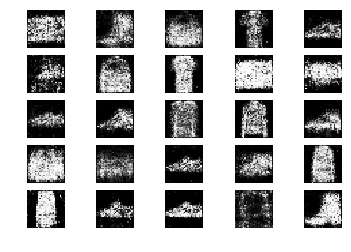

3601 [Discriminator loss: 0.639387, acc.: 57.81%] [Generator loss: 0.939353]
3602 [Discriminator loss: 0.714899, acc.: 60.94%] [Generator loss: 0.972448]
3603 [Discriminator loss: 0.654979, acc.: 60.94%] [Generator loss: 0.946349]
3604 [Discriminator loss: 0.641754, acc.: 62.50%] [Generator loss: 0.954056]
3605 [Discriminator loss: 0.594453, acc.: 68.75%] [Generator loss: 1.039162]
3606 [Discriminator loss: 0.612051, acc.: 62.50%] [Generator loss: 0.996216]
3607 [Discriminator loss: 0.581378, acc.: 67.19%] [Generator loss: 1.016598]
3608 [Discriminator loss: 0.566910, acc.: 70.31%] [Generator loss: 0.940543]
3609 [Discriminator loss: 0.655418, acc.: 60.94%] [Generator loss: 0.980777]
3610 [Discriminator loss: 0.591848, acc.: 65.62%] [Generator loss: 1.014075]
3611 [Discriminator loss: 0.654598, acc.: 54.69%] [Generator loss: 0.884837]
3612 [Discriminator loss: 0.557742, acc.: 70.31%] [Generator loss: 0.921081]
3613 [Discriminator loss: 0.605419, acc.: 68.75%] [Generator loss: 0.986542]

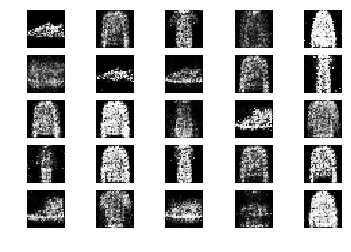

3701 [Discriminator loss: 0.615077, acc.: 62.50%] [Generator loss: 0.977295]
3702 [Discriminator loss: 0.623384, acc.: 62.50%] [Generator loss: 0.950571]
3703 [Discriminator loss: 0.620780, acc.: 60.94%] [Generator loss: 1.068182]
3704 [Discriminator loss: 0.590346, acc.: 70.31%] [Generator loss: 1.055573]
3705 [Discriminator loss: 0.597536, acc.: 64.06%] [Generator loss: 1.004048]
3706 [Discriminator loss: 0.640366, acc.: 54.69%] [Generator loss: 0.924061]
3707 [Discriminator loss: 0.620254, acc.: 64.06%] [Generator loss: 0.916689]
3708 [Discriminator loss: 0.646667, acc.: 62.50%] [Generator loss: 0.961743]
3709 [Discriminator loss: 0.643741, acc.: 62.50%] [Generator loss: 0.951236]
3710 [Discriminator loss: 0.608178, acc.: 70.31%] [Generator loss: 0.992678]
3711 [Discriminator loss: 0.618772, acc.: 70.31%] [Generator loss: 1.034698]
3712 [Discriminator loss: 0.591086, acc.: 67.19%] [Generator loss: 1.038023]
3713 [Discriminator loss: 0.653041, acc.: 62.50%] [Generator loss: 1.087459]

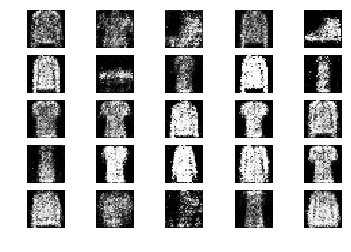

3801 [Discriminator loss: 0.555966, acc.: 76.56%] [Generator loss: 0.977019]
3802 [Discriminator loss: 0.635101, acc.: 57.81%] [Generator loss: 0.926539]
3803 [Discriminator loss: 0.594253, acc.: 73.44%] [Generator loss: 0.952033]
3804 [Discriminator loss: 0.539292, acc.: 70.31%] [Generator loss: 0.992065]
3805 [Discriminator loss: 0.646857, acc.: 67.19%] [Generator loss: 0.940986]
3806 [Discriminator loss: 0.654241, acc.: 67.19%] [Generator loss: 0.996459]
3807 [Discriminator loss: 0.611844, acc.: 65.62%] [Generator loss: 0.950160]
3808 [Discriminator loss: 0.599688, acc.: 64.06%] [Generator loss: 0.924672]
3809 [Discriminator loss: 0.648727, acc.: 59.38%] [Generator loss: 0.954722]
3810 [Discriminator loss: 0.586968, acc.: 73.44%] [Generator loss: 1.109039]
3811 [Discriminator loss: 0.588340, acc.: 65.62%] [Generator loss: 0.926026]
3812 [Discriminator loss: 0.573244, acc.: 70.31%] [Generator loss: 0.982071]
3813 [Discriminator loss: 0.662007, acc.: 60.94%] [Generator loss: 0.947960]

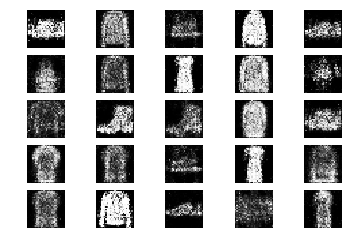

3901 [Discriminator loss: 0.576221, acc.: 73.44%] [Generator loss: 0.916016]
3902 [Discriminator loss: 0.602246, acc.: 64.06%] [Generator loss: 0.909855]
3903 [Discriminator loss: 0.607149, acc.: 65.62%] [Generator loss: 0.901091]
3904 [Discriminator loss: 0.481640, acc.: 84.38%] [Generator loss: 1.079983]
3905 [Discriminator loss: 0.648866, acc.: 60.94%] [Generator loss: 0.978352]
3906 [Discriminator loss: 0.566673, acc.: 65.62%] [Generator loss: 0.989891]
3907 [Discriminator loss: 0.575536, acc.: 70.31%] [Generator loss: 0.977644]
3908 [Discriminator loss: 0.560534, acc.: 68.75%] [Generator loss: 1.016803]
3909 [Discriminator loss: 0.607144, acc.: 70.31%] [Generator loss: 0.920780]
3910 [Discriminator loss: 0.640333, acc.: 59.38%] [Generator loss: 1.033396]
3911 [Discriminator loss: 0.588336, acc.: 67.19%] [Generator loss: 1.111095]
3912 [Discriminator loss: 0.573265, acc.: 68.75%] [Generator loss: 0.998407]
3913 [Discriminator loss: 0.691759, acc.: 57.81%] [Generator loss: 0.957041]

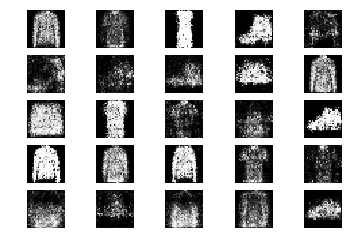

4001 [Discriminator loss: 0.635893, acc.: 62.50%] [Generator loss: 0.917575]
4002 [Discriminator loss: 0.608207, acc.: 65.62%] [Generator loss: 0.887172]
4003 [Discriminator loss: 0.622217, acc.: 70.31%] [Generator loss: 0.911009]
4004 [Discriminator loss: 0.655192, acc.: 60.94%] [Generator loss: 0.957089]
4005 [Discriminator loss: 0.640552, acc.: 70.31%] [Generator loss: 0.893419]
4006 [Discriminator loss: 0.641575, acc.: 57.81%] [Generator loss: 0.857700]
4007 [Discriminator loss: 0.648928, acc.: 54.69%] [Generator loss: 0.883150]
4008 [Discriminator loss: 0.559053, acc.: 70.31%] [Generator loss: 0.942687]
4009 [Discriminator loss: 0.601601, acc.: 64.06%] [Generator loss: 1.039505]
4010 [Discriminator loss: 0.639738, acc.: 64.06%] [Generator loss: 1.073113]
4011 [Discriminator loss: 0.539776, acc.: 76.56%] [Generator loss: 1.117784]
4012 [Discriminator loss: 0.590175, acc.: 62.50%] [Generator loss: 1.063074]
4013 [Discriminator loss: 0.591724, acc.: 70.31%] [Generator loss: 1.006293]

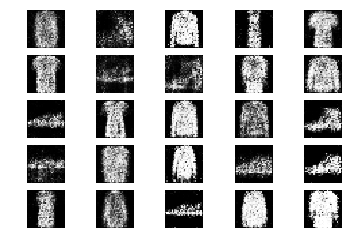

4101 [Discriminator loss: 0.624698, acc.: 64.06%] [Generator loss: 0.951879]
4102 [Discriminator loss: 0.661761, acc.: 57.81%] [Generator loss: 0.927956]
4103 [Discriminator loss: 0.607896, acc.: 64.06%] [Generator loss: 0.944561]
4104 [Discriminator loss: 0.558682, acc.: 70.31%] [Generator loss: 0.982906]
4105 [Discriminator loss: 0.620882, acc.: 57.81%] [Generator loss: 0.935372]
4106 [Discriminator loss: 0.567952, acc.: 71.88%] [Generator loss: 0.826539]
4107 [Discriminator loss: 0.735129, acc.: 51.56%] [Generator loss: 0.928842]
4108 [Discriminator loss: 0.589801, acc.: 79.69%] [Generator loss: 0.851250]
4109 [Discriminator loss: 0.674354, acc.: 59.38%] [Generator loss: 0.932400]
4110 [Discriminator loss: 0.656332, acc.: 65.62%] [Generator loss: 0.983565]
4111 [Discriminator loss: 0.599878, acc.: 76.56%] [Generator loss: 0.986693]
4112 [Discriminator loss: 0.698517, acc.: 50.00%] [Generator loss: 1.034950]
4113 [Discriminator loss: 0.589344, acc.: 65.62%] [Generator loss: 0.986084]

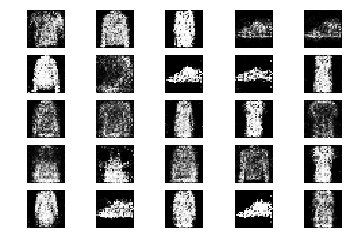

4201 [Discriminator loss: 0.525268, acc.: 81.25%] [Generator loss: 1.064078]
4202 [Discriminator loss: 0.655758, acc.: 68.75%] [Generator loss: 1.000542]
4203 [Discriminator loss: 0.563544, acc.: 73.44%] [Generator loss: 1.013092]
4204 [Discriminator loss: 0.635692, acc.: 64.06%] [Generator loss: 0.944345]
4205 [Discriminator loss: 0.623634, acc.: 60.94%] [Generator loss: 0.989951]
4206 [Discriminator loss: 0.576111, acc.: 71.88%] [Generator loss: 0.947878]
4207 [Discriminator loss: 0.637401, acc.: 60.94%] [Generator loss: 1.031819]
4208 [Discriminator loss: 0.593547, acc.: 67.19%] [Generator loss: 1.031716]
4209 [Discriminator loss: 0.622961, acc.: 65.62%] [Generator loss: 1.077985]
4210 [Discriminator loss: 0.566274, acc.: 75.00%] [Generator loss: 1.045859]
4211 [Discriminator loss: 0.610583, acc.: 62.50%] [Generator loss: 1.090247]
4212 [Discriminator loss: 0.674877, acc.: 57.81%] [Generator loss: 1.040041]
4213 [Discriminator loss: 0.624932, acc.: 57.81%] [Generator loss: 1.005667]

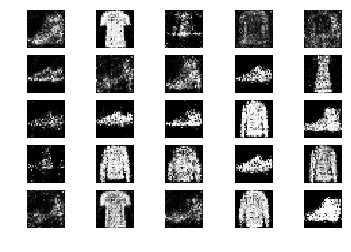

4301 [Discriminator loss: 0.649744, acc.: 68.75%] [Generator loss: 0.939286]
4302 [Discriminator loss: 0.637603, acc.: 57.81%] [Generator loss: 0.940804]
4303 [Discriminator loss: 0.555726, acc.: 75.00%] [Generator loss: 0.967967]
4304 [Discriminator loss: 0.624896, acc.: 59.38%] [Generator loss: 1.025601]
4305 [Discriminator loss: 0.602728, acc.: 64.06%] [Generator loss: 1.124635]
4306 [Discriminator loss: 0.602452, acc.: 70.31%] [Generator loss: 1.016195]
4307 [Discriminator loss: 0.633793, acc.: 70.31%] [Generator loss: 0.947696]
4308 [Discriminator loss: 0.681449, acc.: 60.94%] [Generator loss: 0.938581]
4309 [Discriminator loss: 0.608665, acc.: 65.62%] [Generator loss: 0.946854]
4310 [Discriminator loss: 0.596680, acc.: 65.62%] [Generator loss: 0.980281]
4311 [Discriminator loss: 0.597718, acc.: 68.75%] [Generator loss: 1.090803]
4312 [Discriminator loss: 0.578450, acc.: 64.06%] [Generator loss: 0.936603]
4313 [Discriminator loss: 0.642891, acc.: 64.06%] [Generator loss: 1.054447]

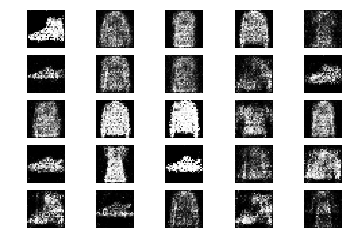

4401 [Discriminator loss: 0.571893, acc.: 75.00%] [Generator loss: 1.179545]
4402 [Discriminator loss: 0.741029, acc.: 45.31%] [Generator loss: 0.912688]
4403 [Discriminator loss: 0.591819, acc.: 75.00%] [Generator loss: 0.942421]
4404 [Discriminator loss: 0.570481, acc.: 67.19%] [Generator loss: 0.945116]
4405 [Discriminator loss: 0.614351, acc.: 65.62%] [Generator loss: 0.867362]
4406 [Discriminator loss: 0.619360, acc.: 65.62%] [Generator loss: 0.986061]
4407 [Discriminator loss: 0.648304, acc.: 64.06%] [Generator loss: 0.928496]
4408 [Discriminator loss: 0.540974, acc.: 76.56%] [Generator loss: 1.008974]
4409 [Discriminator loss: 0.622671, acc.: 65.62%] [Generator loss: 0.936569]
4410 [Discriminator loss: 0.715872, acc.: 51.56%] [Generator loss: 0.932399]
4411 [Discriminator loss: 0.698791, acc.: 59.38%] [Generator loss: 0.959802]
4412 [Discriminator loss: 0.684226, acc.: 59.38%] [Generator loss: 1.093785]
4413 [Discriminator loss: 0.659596, acc.: 65.62%] [Generator loss: 1.041921]

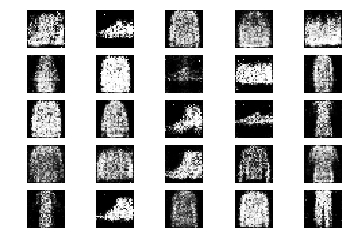

4501 [Discriminator loss: 0.613824, acc.: 68.75%] [Generator loss: 1.023356]
4502 [Discriminator loss: 0.659209, acc.: 62.50%] [Generator loss: 0.982686]
4503 [Discriminator loss: 0.611166, acc.: 68.75%] [Generator loss: 0.956901]
4504 [Discriminator loss: 0.664195, acc.: 60.94%] [Generator loss: 1.050958]
4505 [Discriminator loss: 0.646742, acc.: 56.25%] [Generator loss: 1.016359]
4506 [Discriminator loss: 0.593968, acc.: 71.88%] [Generator loss: 0.915414]
4507 [Discriminator loss: 0.575393, acc.: 71.88%] [Generator loss: 0.988561]
4508 [Discriminator loss: 0.609029, acc.: 70.31%] [Generator loss: 1.014064]
4509 [Discriminator loss: 0.661480, acc.: 57.81%] [Generator loss: 1.026575]
4510 [Discriminator loss: 0.569678, acc.: 75.00%] [Generator loss: 1.114199]
4511 [Discriminator loss: 0.555840, acc.: 78.12%] [Generator loss: 0.999025]
4512 [Discriminator loss: 0.593410, acc.: 68.75%] [Generator loss: 0.930145]
4513 [Discriminator loss: 0.612408, acc.: 62.50%] [Generator loss: 0.976937]

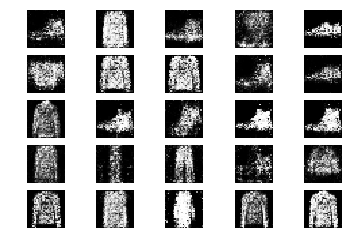

4601 [Discriminator loss: 0.630961, acc.: 57.81%] [Generator loss: 0.986055]
4602 [Discriminator loss: 0.641564, acc.: 60.94%] [Generator loss: 0.947189]
4603 [Discriminator loss: 0.628886, acc.: 60.94%] [Generator loss: 1.009899]
4604 [Discriminator loss: 0.606997, acc.: 60.94%] [Generator loss: 1.063516]
4605 [Discriminator loss: 0.620098, acc.: 64.06%] [Generator loss: 0.951335]
4606 [Discriminator loss: 0.668435, acc.: 57.81%] [Generator loss: 1.019174]
4607 [Discriminator loss: 0.628950, acc.: 56.25%] [Generator loss: 1.027223]
4608 [Discriminator loss: 0.619732, acc.: 62.50%] [Generator loss: 0.974611]
4609 [Discriminator loss: 0.658943, acc.: 68.75%] [Generator loss: 0.978907]
4610 [Discriminator loss: 0.733507, acc.: 53.12%] [Generator loss: 0.924964]
4611 [Discriminator loss: 0.646070, acc.: 65.62%] [Generator loss: 0.938331]
4612 [Discriminator loss: 0.567357, acc.: 75.00%] [Generator loss: 1.002572]
4613 [Discriminator loss: 0.606748, acc.: 70.31%] [Generator loss: 0.930787]

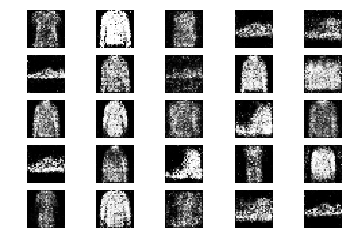

4701 [Discriminator loss: 0.594480, acc.: 62.50%] [Generator loss: 1.012851]
4702 [Discriminator loss: 0.691904, acc.: 54.69%] [Generator loss: 0.915037]
4703 [Discriminator loss: 0.607016, acc.: 60.94%] [Generator loss: 0.923354]
4704 [Discriminator loss: 0.598614, acc.: 64.06%] [Generator loss: 0.908703]
4705 [Discriminator loss: 0.604955, acc.: 70.31%] [Generator loss: 1.001847]
4706 [Discriminator loss: 0.601884, acc.: 68.75%] [Generator loss: 0.907595]
4707 [Discriminator loss: 0.597287, acc.: 68.75%] [Generator loss: 0.930930]
4708 [Discriminator loss: 0.665357, acc.: 56.25%] [Generator loss: 0.983489]
4709 [Discriminator loss: 0.620811, acc.: 76.56%] [Generator loss: 0.990200]
4710 [Discriminator loss: 0.642256, acc.: 65.62%] [Generator loss: 1.043373]
4711 [Discriminator loss: 0.544611, acc.: 78.12%] [Generator loss: 0.926682]
4712 [Discriminator loss: 0.579930, acc.: 65.62%] [Generator loss: 0.976924]
4713 [Discriminator loss: 0.632389, acc.: 60.94%] [Generator loss: 1.016597]

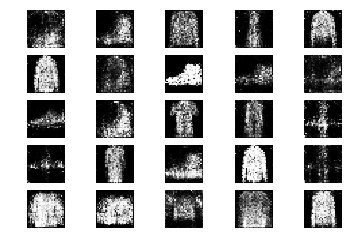

4801 [Discriminator loss: 0.671634, acc.: 62.50%] [Generator loss: 0.935983]
4802 [Discriminator loss: 0.637545, acc.: 65.62%] [Generator loss: 1.030403]
4803 [Discriminator loss: 0.578443, acc.: 68.75%] [Generator loss: 0.873393]
4804 [Discriminator loss: 0.743506, acc.: 59.38%] [Generator loss: 0.904843]
4805 [Discriminator loss: 0.624590, acc.: 65.62%] [Generator loss: 0.914637]
4806 [Discriminator loss: 0.642650, acc.: 62.50%] [Generator loss: 0.906843]
4807 [Discriminator loss: 0.648578, acc.: 64.06%] [Generator loss: 1.010436]
4808 [Discriminator loss: 0.673010, acc.: 54.69%] [Generator loss: 0.989670]
4809 [Discriminator loss: 0.638545, acc.: 60.94%] [Generator loss: 0.953658]
4810 [Discriminator loss: 0.581321, acc.: 73.44%] [Generator loss: 1.007653]
4811 [Discriminator loss: 0.610740, acc.: 68.75%] [Generator loss: 0.957962]
4812 [Discriminator loss: 0.648018, acc.: 62.50%] [Generator loss: 1.045436]
4813 [Discriminator loss: 0.660256, acc.: 67.19%] [Generator loss: 0.946704]

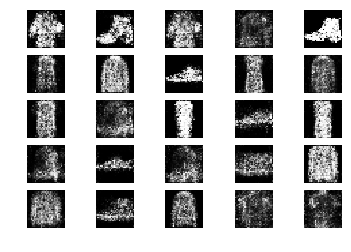

4901 [Discriminator loss: 0.576816, acc.: 71.88%] [Generator loss: 1.032770]
4902 [Discriminator loss: 0.610348, acc.: 68.75%] [Generator loss: 0.997268]
4903 [Discriminator loss: 0.611687, acc.: 64.06%] [Generator loss: 1.043084]
4904 [Discriminator loss: 0.700952, acc.: 64.06%] [Generator loss: 0.959942]
4905 [Discriminator loss: 0.585893, acc.: 67.19%] [Generator loss: 0.974910]
4906 [Discriminator loss: 0.591995, acc.: 68.75%] [Generator loss: 0.942160]
4907 [Discriminator loss: 0.626545, acc.: 65.62%] [Generator loss: 0.876085]
4908 [Discriminator loss: 0.720436, acc.: 48.44%] [Generator loss: 0.944611]
4909 [Discriminator loss: 0.679138, acc.: 60.94%] [Generator loss: 0.901650]
4910 [Discriminator loss: 0.653766, acc.: 62.50%] [Generator loss: 0.956782]
4911 [Discriminator loss: 0.674119, acc.: 57.81%] [Generator loss: 0.910213]
4912 [Discriminator loss: 0.642132, acc.: 68.75%] [Generator loss: 0.860041]
4913 [Discriminator loss: 0.623015, acc.: 60.94%] [Generator loss: 0.952320]

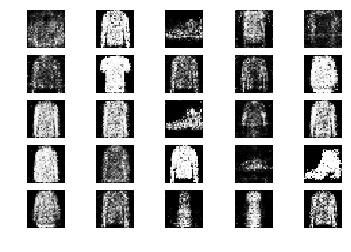

5001 [Discriminator loss: 0.666954, acc.: 65.62%] [Generator loss: 0.947647]
5002 [Discriminator loss: 0.573719, acc.: 76.56%] [Generator loss: 0.946154]
5003 [Discriminator loss: 0.669735, acc.: 59.38%] [Generator loss: 0.960197]
5004 [Discriminator loss: 0.652070, acc.: 67.19%] [Generator loss: 0.987906]
5005 [Discriminator loss: 0.581797, acc.: 67.19%] [Generator loss: 1.013718]
5006 [Discriminator loss: 0.562561, acc.: 75.00%] [Generator loss: 1.016820]
5007 [Discriminator loss: 0.636677, acc.: 68.75%] [Generator loss: 0.890621]
5008 [Discriminator loss: 0.654163, acc.: 62.50%] [Generator loss: 0.998198]
5009 [Discriminator loss: 0.617726, acc.: 67.19%] [Generator loss: 0.879915]
5010 [Discriminator loss: 0.605162, acc.: 64.06%] [Generator loss: 0.845908]
5011 [Discriminator loss: 0.658839, acc.: 59.38%] [Generator loss: 0.893196]
5012 [Discriminator loss: 0.605246, acc.: 67.19%] [Generator loss: 0.913867]
5013 [Discriminator loss: 0.626127, acc.: 60.94%] [Generator loss: 0.894570]

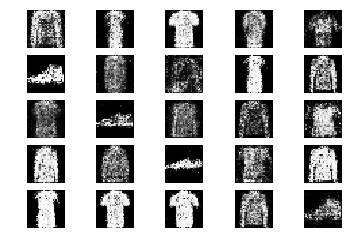

5101 [Discriminator loss: 0.654672, acc.: 64.06%] [Generator loss: 1.007425]
5102 [Discriminator loss: 0.645922, acc.: 64.06%] [Generator loss: 0.926200]
5103 [Discriminator loss: 0.631205, acc.: 56.25%] [Generator loss: 1.012404]
5104 [Discriminator loss: 0.581901, acc.: 70.31%] [Generator loss: 0.879679]
5105 [Discriminator loss: 0.637049, acc.: 59.38%] [Generator loss: 1.020386]
5106 [Discriminator loss: 0.643869, acc.: 59.38%] [Generator loss: 0.982476]
5107 [Discriminator loss: 0.696077, acc.: 60.94%] [Generator loss: 0.867934]
5108 [Discriminator loss: 0.651362, acc.: 60.94%] [Generator loss: 0.959257]
5109 [Discriminator loss: 0.597739, acc.: 67.19%] [Generator loss: 1.054051]
5110 [Discriminator loss: 0.674237, acc.: 57.81%] [Generator loss: 1.042059]
5111 [Discriminator loss: 0.549378, acc.: 70.31%] [Generator loss: 1.081034]
5112 [Discriminator loss: 0.635166, acc.: 65.62%] [Generator loss: 1.067008]
5113 [Discriminator loss: 0.677344, acc.: 50.00%] [Generator loss: 0.859347]

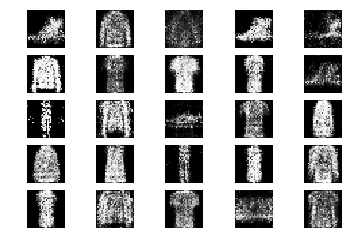

5201 [Discriminator loss: 0.613126, acc.: 60.94%] [Generator loss: 0.977369]
5202 [Discriminator loss: 0.683897, acc.: 57.81%] [Generator loss: 0.891839]
5203 [Discriminator loss: 0.572393, acc.: 67.19%] [Generator loss: 0.895747]
5204 [Discriminator loss: 0.705780, acc.: 54.69%] [Generator loss: 0.951975]
5205 [Discriminator loss: 0.698852, acc.: 53.12%] [Generator loss: 1.049659]
5206 [Discriminator loss: 0.607521, acc.: 75.00%] [Generator loss: 0.990844]
5207 [Discriminator loss: 0.644325, acc.: 62.50%] [Generator loss: 0.988370]
5208 [Discriminator loss: 0.633488, acc.: 67.19%] [Generator loss: 0.913125]
5209 [Discriminator loss: 0.631573, acc.: 65.62%] [Generator loss: 1.041840]
5210 [Discriminator loss: 0.675559, acc.: 53.12%] [Generator loss: 0.861895]
5211 [Discriminator loss: 0.604301, acc.: 64.06%] [Generator loss: 0.976524]
5212 [Discriminator loss: 0.671983, acc.: 51.56%] [Generator loss: 0.990035]
5213 [Discriminator loss: 0.633889, acc.: 59.38%] [Generator loss: 0.908241]

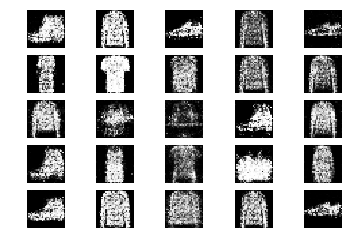

5301 [Discriminator loss: 0.658604, acc.: 60.94%] [Generator loss: 0.892371]
5302 [Discriminator loss: 0.721310, acc.: 51.56%] [Generator loss: 0.859908]
5303 [Discriminator loss: 0.667130, acc.: 56.25%] [Generator loss: 0.950511]
5304 [Discriminator loss: 0.646722, acc.: 60.94%] [Generator loss: 0.855070]
5305 [Discriminator loss: 0.653947, acc.: 65.62%] [Generator loss: 0.998940]
5306 [Discriminator loss: 0.618750, acc.: 67.19%] [Generator loss: 1.013918]
5307 [Discriminator loss: 0.571684, acc.: 75.00%] [Generator loss: 0.928863]
5308 [Discriminator loss: 0.643019, acc.: 67.19%] [Generator loss: 0.963238]
5309 [Discriminator loss: 0.613031, acc.: 67.19%] [Generator loss: 0.935328]
5310 [Discriminator loss: 0.688312, acc.: 51.56%] [Generator loss: 0.919921]
5311 [Discriminator loss: 0.603151, acc.: 73.44%] [Generator loss: 0.921439]
5312 [Discriminator loss: 0.618461, acc.: 70.31%] [Generator loss: 0.937549]
5313 [Discriminator loss: 0.614319, acc.: 75.00%] [Generator loss: 0.968643]

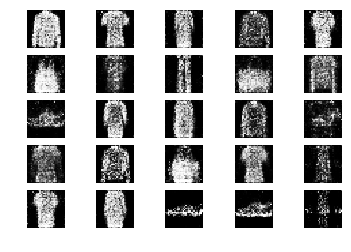

5401 [Discriminator loss: 0.558700, acc.: 71.88%] [Generator loss: 0.932089]
5402 [Discriminator loss: 0.616243, acc.: 68.75%] [Generator loss: 0.933155]
5403 [Discriminator loss: 0.670766, acc.: 56.25%] [Generator loss: 0.929799]
5404 [Discriminator loss: 0.597068, acc.: 68.75%] [Generator loss: 1.006898]
5405 [Discriminator loss: 0.662171, acc.: 65.62%] [Generator loss: 0.953726]
5406 [Discriminator loss: 0.623818, acc.: 65.62%] [Generator loss: 1.002473]
5407 [Discriminator loss: 0.644891, acc.: 67.19%] [Generator loss: 0.925783]
5408 [Discriminator loss: 0.603102, acc.: 67.19%] [Generator loss: 0.957552]
5409 [Discriminator loss: 0.630027, acc.: 62.50%] [Generator loss: 0.908209]
5410 [Discriminator loss: 0.643073, acc.: 65.62%] [Generator loss: 0.901607]
5411 [Discriminator loss: 0.563039, acc.: 73.44%] [Generator loss: 0.939352]
5412 [Discriminator loss: 0.638742, acc.: 62.50%] [Generator loss: 0.920502]
5413 [Discriminator loss: 0.658521, acc.: 60.94%] [Generator loss: 0.950201]

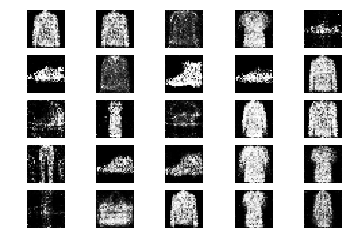

5501 [Discriminator loss: 0.609758, acc.: 68.75%] [Generator loss: 0.953446]
5502 [Discriminator loss: 0.629193, acc.: 64.06%] [Generator loss: 0.970553]
5503 [Discriminator loss: 0.852330, acc.: 48.44%] [Generator loss: 0.886172]
5504 [Discriminator loss: 0.567362, acc.: 71.88%] [Generator loss: 1.036095]
5505 [Discriminator loss: 0.625827, acc.: 64.06%] [Generator loss: 1.016762]
5506 [Discriminator loss: 0.676197, acc.: 60.94%] [Generator loss: 0.972068]
5507 [Discriminator loss: 0.597829, acc.: 73.44%] [Generator loss: 1.018993]
5508 [Discriminator loss: 0.702761, acc.: 57.81%] [Generator loss: 0.912394]
5509 [Discriminator loss: 0.720067, acc.: 59.38%] [Generator loss: 0.887285]
5510 [Discriminator loss: 0.589672, acc.: 76.56%] [Generator loss: 0.892001]
5511 [Discriminator loss: 0.667696, acc.: 62.50%] [Generator loss: 0.905763]
5512 [Discriminator loss: 0.667484, acc.: 60.94%] [Generator loss: 0.947066]
5513 [Discriminator loss: 0.596365, acc.: 67.19%] [Generator loss: 1.003245]

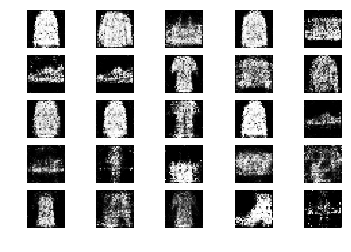

5601 [Discriminator loss: 0.548576, acc.: 78.12%] [Generator loss: 0.974648]
5602 [Discriminator loss: 0.598608, acc.: 73.44%] [Generator loss: 0.922590]
5603 [Discriminator loss: 0.653459, acc.: 59.38%] [Generator loss: 0.988384]
5604 [Discriminator loss: 0.594942, acc.: 70.31%] [Generator loss: 0.932752]
5605 [Discriminator loss: 0.591031, acc.: 68.75%] [Generator loss: 1.003736]
5606 [Discriminator loss: 0.694079, acc.: 57.81%] [Generator loss: 0.896482]
5607 [Discriminator loss: 0.564805, acc.: 70.31%] [Generator loss: 0.942554]
5608 [Discriminator loss: 0.656028, acc.: 54.69%] [Generator loss: 0.927794]
5609 [Discriminator loss: 0.583035, acc.: 71.88%] [Generator loss: 0.915958]
5610 [Discriminator loss: 0.652752, acc.: 64.06%] [Generator loss: 0.940237]
5611 [Discriminator loss: 0.640114, acc.: 64.06%] [Generator loss: 0.910164]
5612 [Discriminator loss: 0.554969, acc.: 68.75%] [Generator loss: 0.952394]
5613 [Discriminator loss: 0.637925, acc.: 65.62%] [Generator loss: 0.980363]

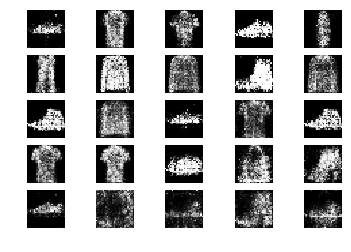

5701 [Discriminator loss: 0.654426, acc.: 53.12%] [Generator loss: 0.940652]
5702 [Discriminator loss: 0.619965, acc.: 65.62%] [Generator loss: 0.950968]
5703 [Discriminator loss: 0.653419, acc.: 59.38%] [Generator loss: 0.948896]
5704 [Discriminator loss: 0.606532, acc.: 65.62%] [Generator loss: 0.898113]
5705 [Discriminator loss: 0.636294, acc.: 65.62%] [Generator loss: 0.846575]
5706 [Discriminator loss: 0.602515, acc.: 73.44%] [Generator loss: 0.946060]
5707 [Discriminator loss: 0.557000, acc.: 73.44%] [Generator loss: 0.959306]
5708 [Discriminator loss: 0.646000, acc.: 65.62%] [Generator loss: 0.935332]
5709 [Discriminator loss: 0.617424, acc.: 62.50%] [Generator loss: 0.976098]
5710 [Discriminator loss: 0.714364, acc.: 59.38%] [Generator loss: 0.950243]
5711 [Discriminator loss: 0.644842, acc.: 64.06%] [Generator loss: 1.018519]
5712 [Discriminator loss: 0.610798, acc.: 62.50%] [Generator loss: 0.950502]
5713 [Discriminator loss: 0.680925, acc.: 57.81%] [Generator loss: 0.908518]

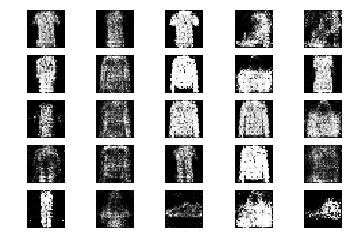

5801 [Discriminator loss: 0.658472, acc.: 62.50%] [Generator loss: 0.821434]
5802 [Discriminator loss: 0.557566, acc.: 81.25%] [Generator loss: 0.955031]
5803 [Discriminator loss: 0.632215, acc.: 59.38%] [Generator loss: 0.920272]
5804 [Discriminator loss: 0.602012, acc.: 65.62%] [Generator loss: 0.919069]
5805 [Discriminator loss: 0.647056, acc.: 57.81%] [Generator loss: 0.872716]
5806 [Discriminator loss: 0.669114, acc.: 54.69%] [Generator loss: 0.983226]
5807 [Discriminator loss: 0.615432, acc.: 65.62%] [Generator loss: 0.938237]
5808 [Discriminator loss: 0.548338, acc.: 67.19%] [Generator loss: 0.994738]
5809 [Discriminator loss: 0.670796, acc.: 57.81%] [Generator loss: 1.011846]
5810 [Discriminator loss: 0.588850, acc.: 67.19%] [Generator loss: 0.956648]
5811 [Discriminator loss: 0.627782, acc.: 68.75%] [Generator loss: 0.974099]
5812 [Discriminator loss: 0.661879, acc.: 57.81%] [Generator loss: 0.889084]
5813 [Discriminator loss: 0.623912, acc.: 59.38%] [Generator loss: 0.926223]

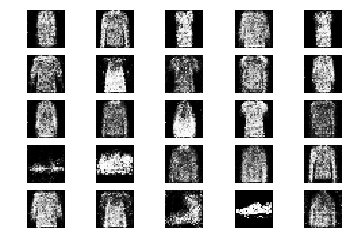

5901 [Discriminator loss: 0.597145, acc.: 65.62%] [Generator loss: 0.947415]
5902 [Discriminator loss: 0.713060, acc.: 45.31%] [Generator loss: 1.005368]
5903 [Discriminator loss: 0.639730, acc.: 67.19%] [Generator loss: 0.955940]
5904 [Discriminator loss: 0.648747, acc.: 57.81%] [Generator loss: 1.012670]
5905 [Discriminator loss: 0.613440, acc.: 76.56%] [Generator loss: 0.996522]
5906 [Discriminator loss: 0.660478, acc.: 62.50%] [Generator loss: 1.017354]
5907 [Discriminator loss: 0.680300, acc.: 60.94%] [Generator loss: 0.959187]
5908 [Discriminator loss: 0.668029, acc.: 62.50%] [Generator loss: 0.906931]
5909 [Discriminator loss: 0.599503, acc.: 64.06%] [Generator loss: 0.992160]
5910 [Discriminator loss: 0.662189, acc.: 50.00%] [Generator loss: 0.976147]
5911 [Discriminator loss: 0.585401, acc.: 70.31%] [Generator loss: 0.978115]
5912 [Discriminator loss: 0.686728, acc.: 54.69%] [Generator loss: 1.026639]
5913 [Discriminator loss: 0.638781, acc.: 62.50%] [Generator loss: 0.960597]

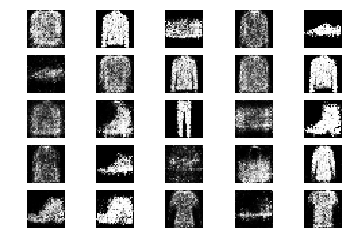

6001 [Discriminator loss: 0.707141, acc.: 62.50%] [Generator loss: 0.917763]
6002 [Discriminator loss: 0.658464, acc.: 62.50%] [Generator loss: 0.877795]
6003 [Discriminator loss: 0.670577, acc.: 60.94%] [Generator loss: 0.957512]
6004 [Discriminator loss: 0.664542, acc.: 50.00%] [Generator loss: 0.872957]
6005 [Discriminator loss: 0.601899, acc.: 70.31%] [Generator loss: 0.908676]
6006 [Discriminator loss: 0.667767, acc.: 57.81%] [Generator loss: 0.916798]
6007 [Discriminator loss: 0.603002, acc.: 71.88%] [Generator loss: 0.856337]
6008 [Discriminator loss: 0.727307, acc.: 64.06%] [Generator loss: 0.843515]
6009 [Discriminator loss: 0.634677, acc.: 65.62%] [Generator loss: 0.968733]
6010 [Discriminator loss: 0.661494, acc.: 62.50%] [Generator loss: 0.896164]
6011 [Discriminator loss: 0.646313, acc.: 67.19%] [Generator loss: 0.911563]
6012 [Discriminator loss: 0.665919, acc.: 54.69%] [Generator loss: 0.895894]
6013 [Discriminator loss: 0.642372, acc.: 64.06%] [Generator loss: 0.939757]

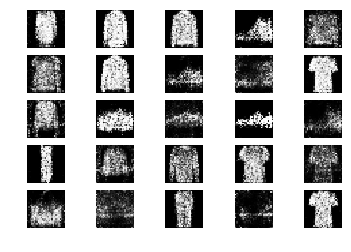

6101 [Discriminator loss: 0.705826, acc.: 57.81%] [Generator loss: 0.952482]
6102 [Discriminator loss: 0.670044, acc.: 59.38%] [Generator loss: 0.923877]
6103 [Discriminator loss: 0.614166, acc.: 65.62%] [Generator loss: 0.982743]
6104 [Discriminator loss: 0.628405, acc.: 73.44%] [Generator loss: 0.967076]
6105 [Discriminator loss: 0.671619, acc.: 59.38%] [Generator loss: 0.963449]
6106 [Discriminator loss: 0.635210, acc.: 68.75%] [Generator loss: 0.909217]
6107 [Discriminator loss: 0.695235, acc.: 54.69%] [Generator loss: 0.935335]
6108 [Discriminator loss: 0.663371, acc.: 57.81%] [Generator loss: 0.913768]
6109 [Discriminator loss: 0.606734, acc.: 64.06%] [Generator loss: 0.882227]
6110 [Discriminator loss: 0.633155, acc.: 65.62%] [Generator loss: 0.939194]
6111 [Discriminator loss: 0.649456, acc.: 62.50%] [Generator loss: 0.915024]
6112 [Discriminator loss: 0.632974, acc.: 75.00%] [Generator loss: 0.932476]
6113 [Discriminator loss: 0.589225, acc.: 75.00%] [Generator loss: 0.942935]

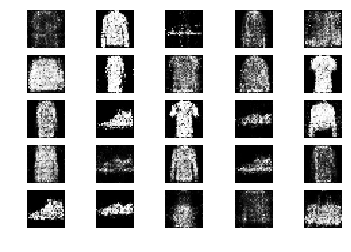

6201 [Discriminator loss: 0.630886, acc.: 64.06%] [Generator loss: 0.890358]
6202 [Discriminator loss: 0.620473, acc.: 67.19%] [Generator loss: 0.900028]
6203 [Discriminator loss: 0.618775, acc.: 67.19%] [Generator loss: 0.908974]
6204 [Discriminator loss: 0.545044, acc.: 76.56%] [Generator loss: 0.950318]
6205 [Discriminator loss: 0.712315, acc.: 53.12%] [Generator loss: 0.972776]
6206 [Discriminator loss: 0.655659, acc.: 65.62%] [Generator loss: 0.976200]
6207 [Discriminator loss: 0.663552, acc.: 59.38%] [Generator loss: 0.985065]
6208 [Discriminator loss: 0.612409, acc.: 75.00%] [Generator loss: 0.898596]
6209 [Discriminator loss: 0.659466, acc.: 62.50%] [Generator loss: 0.976900]
6210 [Discriminator loss: 0.569705, acc.: 75.00%] [Generator loss: 0.886900]
6211 [Discriminator loss: 0.686711, acc.: 59.38%] [Generator loss: 0.943550]
6212 [Discriminator loss: 0.676627, acc.: 59.38%] [Generator loss: 0.967844]
6213 [Discriminator loss: 0.645879, acc.: 65.62%] [Generator loss: 0.861149]

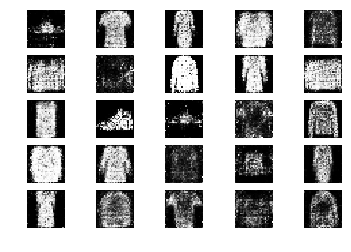

6301 [Discriminator loss: 0.685807, acc.: 50.00%] [Generator loss: 0.872644]
6302 [Discriminator loss: 0.725504, acc.: 48.44%] [Generator loss: 0.907579]
6303 [Discriminator loss: 0.649821, acc.: 60.94%] [Generator loss: 0.875251]
6304 [Discriminator loss: 0.589861, acc.: 71.88%] [Generator loss: 0.879185]
6305 [Discriminator loss: 0.590442, acc.: 65.62%] [Generator loss: 0.998406]
6306 [Discriminator loss: 0.633918, acc.: 60.94%] [Generator loss: 1.023032]
6307 [Discriminator loss: 0.589959, acc.: 76.56%] [Generator loss: 0.887838]
6308 [Discriminator loss: 0.624661, acc.: 68.75%] [Generator loss: 0.983364]
6309 [Discriminator loss: 0.674986, acc.: 56.25%] [Generator loss: 0.971453]
6310 [Discriminator loss: 0.636841, acc.: 65.62%] [Generator loss: 1.018199]
6311 [Discriminator loss: 0.651882, acc.: 62.50%] [Generator loss: 0.988204]
6312 [Discriminator loss: 0.596557, acc.: 60.94%] [Generator loss: 0.908480]
6313 [Discriminator loss: 0.642402, acc.: 65.62%] [Generator loss: 0.919106]

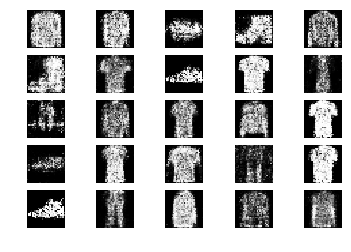

6401 [Discriminator loss: 0.600726, acc.: 67.19%] [Generator loss: 0.918481]
6402 [Discriminator loss: 0.566915, acc.: 71.88%] [Generator loss: 0.931671]
6403 [Discriminator loss: 0.662399, acc.: 64.06%] [Generator loss: 0.958032]
6404 [Discriminator loss: 0.681758, acc.: 60.94%] [Generator loss: 0.962354]
6405 [Discriminator loss: 0.626404, acc.: 60.94%] [Generator loss: 0.944728]
6406 [Discriminator loss: 0.581680, acc.: 75.00%] [Generator loss: 0.948186]
6407 [Discriminator loss: 0.602161, acc.: 65.62%] [Generator loss: 0.987237]
6408 [Discriminator loss: 0.655173, acc.: 59.38%] [Generator loss: 0.932658]
6409 [Discriminator loss: 0.700933, acc.: 57.81%] [Generator loss: 0.961905]
6410 [Discriminator loss: 0.549800, acc.: 73.44%] [Generator loss: 0.912261]
6411 [Discriminator loss: 0.644905, acc.: 57.81%] [Generator loss: 1.002665]
6412 [Discriminator loss: 0.634084, acc.: 70.31%] [Generator loss: 0.933200]
6413 [Discriminator loss: 0.631819, acc.: 65.62%] [Generator loss: 0.925137]

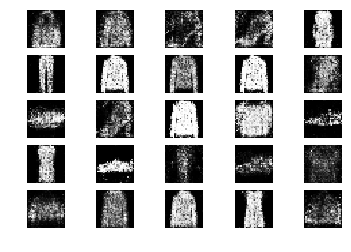

6501 [Discriminator loss: 0.630585, acc.: 59.38%] [Generator loss: 0.941868]
6502 [Discriminator loss: 0.682276, acc.: 59.38%] [Generator loss: 0.940645]
6503 [Discriminator loss: 0.648085, acc.: 59.38%] [Generator loss: 0.880019]
6504 [Discriminator loss: 0.663206, acc.: 57.81%] [Generator loss: 0.915925]
6505 [Discriminator loss: 0.698831, acc.: 59.38%] [Generator loss: 0.839079]
6506 [Discriminator loss: 0.648898, acc.: 64.06%] [Generator loss: 0.857331]
6507 [Discriminator loss: 0.620898, acc.: 60.94%] [Generator loss: 0.851678]
6508 [Discriminator loss: 0.639726, acc.: 70.31%] [Generator loss: 0.972096]
6509 [Discriminator loss: 0.567133, acc.: 68.75%] [Generator loss: 1.006720]
6510 [Discriminator loss: 0.669345, acc.: 56.25%] [Generator loss: 0.998690]
6511 [Discriminator loss: 0.628278, acc.: 60.94%] [Generator loss: 0.896500]
6512 [Discriminator loss: 0.712237, acc.: 54.69%] [Generator loss: 0.982226]
6513 [Discriminator loss: 0.631366, acc.: 64.06%] [Generator loss: 0.901639]

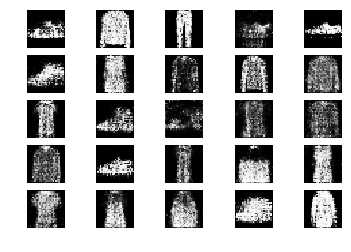

6601 [Discriminator loss: 0.630582, acc.: 64.06%] [Generator loss: 0.988509]
6602 [Discriminator loss: 0.679904, acc.: 67.19%] [Generator loss: 0.954153]
6603 [Discriminator loss: 0.629368, acc.: 60.94%] [Generator loss: 0.917047]
6604 [Discriminator loss: 0.661077, acc.: 59.38%] [Generator loss: 0.987986]
6605 [Discriminator loss: 0.595367, acc.: 67.19%] [Generator loss: 0.945545]
6606 [Discriminator loss: 0.628885, acc.: 62.50%] [Generator loss: 1.093103]
6607 [Discriminator loss: 0.611849, acc.: 67.19%] [Generator loss: 1.034599]
6608 [Discriminator loss: 0.669616, acc.: 54.69%] [Generator loss: 0.944990]
6609 [Discriminator loss: 0.604640, acc.: 65.62%] [Generator loss: 0.964539]
6610 [Discriminator loss: 0.641322, acc.: 60.94%] [Generator loss: 0.939640]
6611 [Discriminator loss: 0.746213, acc.: 51.56%] [Generator loss: 0.967624]
6612 [Discriminator loss: 0.699490, acc.: 60.94%] [Generator loss: 0.981013]
6613 [Discriminator loss: 0.659521, acc.: 53.12%] [Generator loss: 0.940797]

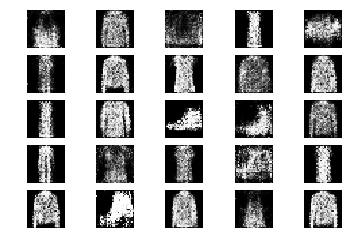

6701 [Discriminator loss: 0.739782, acc.: 48.44%] [Generator loss: 0.947318]
6702 [Discriminator loss: 0.599101, acc.: 65.62%] [Generator loss: 0.900959]
6703 [Discriminator loss: 0.643768, acc.: 60.94%] [Generator loss: 0.869869]
6704 [Discriminator loss: 0.660498, acc.: 68.75%] [Generator loss: 0.957852]
6705 [Discriminator loss: 0.619529, acc.: 67.19%] [Generator loss: 0.961801]
6706 [Discriminator loss: 0.575936, acc.: 76.56%] [Generator loss: 0.995041]
6707 [Discriminator loss: 0.691101, acc.: 59.38%] [Generator loss: 0.962556]
6708 [Discriminator loss: 0.661193, acc.: 64.06%] [Generator loss: 0.918491]
6709 [Discriminator loss: 0.655969, acc.: 64.06%] [Generator loss: 0.945955]
6710 [Discriminator loss: 0.641110, acc.: 57.81%] [Generator loss: 0.986351]
6711 [Discriminator loss: 0.672771, acc.: 62.50%] [Generator loss: 0.944204]
6712 [Discriminator loss: 0.651572, acc.: 62.50%] [Generator loss: 0.931977]
6713 [Discriminator loss: 0.639680, acc.: 62.50%] [Generator loss: 0.879488]

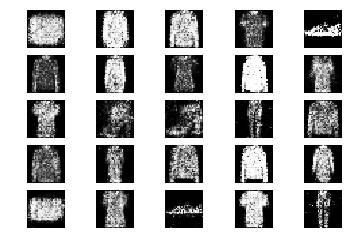

6801 [Discriminator loss: 0.688784, acc.: 60.94%] [Generator loss: 0.928951]
6802 [Discriminator loss: 0.604797, acc.: 62.50%] [Generator loss: 0.971136]
6803 [Discriminator loss: 0.677352, acc.: 51.56%] [Generator loss: 0.854636]
6804 [Discriminator loss: 0.633185, acc.: 65.62%] [Generator loss: 0.893173]
6805 [Discriminator loss: 0.645042, acc.: 60.94%] [Generator loss: 1.023543]
6806 [Discriminator loss: 0.548699, acc.: 78.12%] [Generator loss: 0.930112]
6807 [Discriminator loss: 0.681267, acc.: 62.50%] [Generator loss: 0.952360]
6808 [Discriminator loss: 0.667356, acc.: 56.25%] [Generator loss: 0.908392]
6809 [Discriminator loss: 0.612858, acc.: 64.06%] [Generator loss: 0.826556]
6810 [Discriminator loss: 0.633534, acc.: 56.25%] [Generator loss: 0.863273]
6811 [Discriminator loss: 0.644665, acc.: 64.06%] [Generator loss: 0.863578]
6812 [Discriminator loss: 0.715655, acc.: 51.56%] [Generator loss: 0.850286]
6813 [Discriminator loss: 0.673341, acc.: 59.38%] [Generator loss: 0.968013]

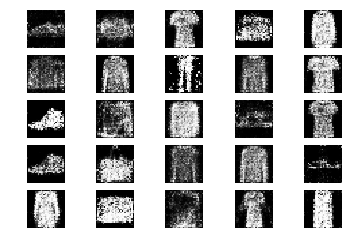

6901 [Discriminator loss: 0.629073, acc.: 64.06%] [Generator loss: 0.873698]
6902 [Discriminator loss: 0.678308, acc.: 60.94%] [Generator loss: 0.811082]
6903 [Discriminator loss: 0.625806, acc.: 67.19%] [Generator loss: 0.867846]
6904 [Discriminator loss: 0.557444, acc.: 73.44%] [Generator loss: 1.019535]
6905 [Discriminator loss: 0.640530, acc.: 65.62%] [Generator loss: 0.868165]
6906 [Discriminator loss: 0.601128, acc.: 64.06%] [Generator loss: 0.891704]
6907 [Discriminator loss: 0.552891, acc.: 79.69%] [Generator loss: 0.881586]
6908 [Discriminator loss: 0.597272, acc.: 64.06%] [Generator loss: 0.919808]
6909 [Discriminator loss: 0.631754, acc.: 59.38%] [Generator loss: 0.951148]
6910 [Discriminator loss: 0.676595, acc.: 59.38%] [Generator loss: 0.901051]
6911 [Discriminator loss: 0.612947, acc.: 68.75%] [Generator loss: 0.931927]
6912 [Discriminator loss: 0.628229, acc.: 62.50%] [Generator loss: 0.968540]
6913 [Discriminator loss: 0.569530, acc.: 76.56%] [Generator loss: 1.059742]

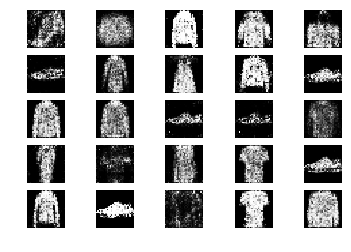

7001 [Discriminator loss: 0.637504, acc.: 60.94%] [Generator loss: 0.888990]
7002 [Discriminator loss: 0.665776, acc.: 57.81%] [Generator loss: 0.895876]
7003 [Discriminator loss: 0.596379, acc.: 65.62%] [Generator loss: 0.919399]
7004 [Discriminator loss: 0.625586, acc.: 70.31%] [Generator loss: 0.963132]
7005 [Discriminator loss: 0.613410, acc.: 64.06%] [Generator loss: 0.892421]
7006 [Discriminator loss: 0.640741, acc.: 64.06%] [Generator loss: 0.967175]
7007 [Discriminator loss: 0.718602, acc.: 59.38%] [Generator loss: 0.962473]
7008 [Discriminator loss: 0.680672, acc.: 60.94%] [Generator loss: 1.020299]
7009 [Discriminator loss: 0.623509, acc.: 59.38%] [Generator loss: 0.947345]
7010 [Discriminator loss: 0.716158, acc.: 48.44%] [Generator loss: 0.991560]
7011 [Discriminator loss: 0.622403, acc.: 60.94%] [Generator loss: 0.885952]
7012 [Discriminator loss: 0.688661, acc.: 59.38%] [Generator loss: 0.980232]
7013 [Discriminator loss: 0.617480, acc.: 60.94%] [Generator loss: 0.966394]

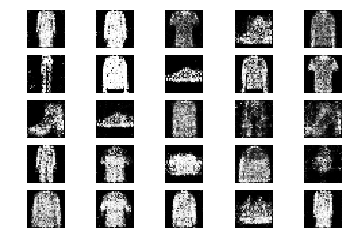

7101 [Discriminator loss: 0.665780, acc.: 56.25%] [Generator loss: 0.892114]
7102 [Discriminator loss: 0.600891, acc.: 67.19%] [Generator loss: 0.931191]
7103 [Discriminator loss: 0.714165, acc.: 51.56%] [Generator loss: 0.905093]
7104 [Discriminator loss: 0.617510, acc.: 68.75%] [Generator loss: 0.973565]
7105 [Discriminator loss: 0.616092, acc.: 65.62%] [Generator loss: 0.983955]
7106 [Discriminator loss: 0.668140, acc.: 57.81%] [Generator loss: 0.983258]
7107 [Discriminator loss: 0.694046, acc.: 60.94%] [Generator loss: 0.921628]
7108 [Discriminator loss: 0.657362, acc.: 59.38%] [Generator loss: 0.868916]
7109 [Discriminator loss: 0.602620, acc.: 67.19%] [Generator loss: 0.917858]
7110 [Discriminator loss: 0.659633, acc.: 64.06%] [Generator loss: 0.956697]
7111 [Discriminator loss: 0.628576, acc.: 62.50%] [Generator loss: 0.856082]
7112 [Discriminator loss: 0.611933, acc.: 67.19%] [Generator loss: 0.871861]
7113 [Discriminator loss: 0.648940, acc.: 62.50%] [Generator loss: 0.942837]

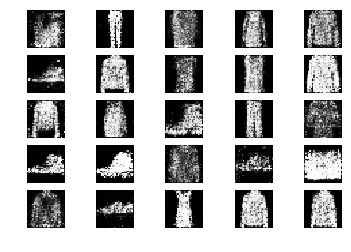

7201 [Discriminator loss: 0.645093, acc.: 65.62%] [Generator loss: 0.935356]
7202 [Discriminator loss: 0.683279, acc.: 54.69%] [Generator loss: 0.850307]
7203 [Discriminator loss: 0.650090, acc.: 67.19%] [Generator loss: 0.797381]
7204 [Discriminator loss: 0.604305, acc.: 65.62%] [Generator loss: 0.963499]
7205 [Discriminator loss: 0.762217, acc.: 50.00%] [Generator loss: 0.847987]
7206 [Discriminator loss: 0.621183, acc.: 67.19%] [Generator loss: 0.975128]
7207 [Discriminator loss: 0.674943, acc.: 53.12%] [Generator loss: 0.830656]
7208 [Discriminator loss: 0.661747, acc.: 56.25%] [Generator loss: 0.961621]
7209 [Discriminator loss: 0.586787, acc.: 73.44%] [Generator loss: 0.941076]
7210 [Discriminator loss: 0.674625, acc.: 53.12%] [Generator loss: 0.937249]
7211 [Discriminator loss: 0.638982, acc.: 59.38%] [Generator loss: 0.991743]
7212 [Discriminator loss: 0.622728, acc.: 64.06%] [Generator loss: 0.951364]
7213 [Discriminator loss: 0.687367, acc.: 59.38%] [Generator loss: 0.860908]

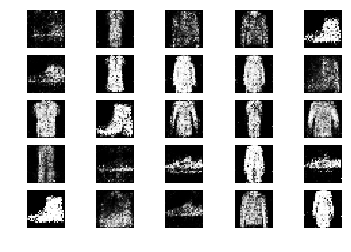

7301 [Discriminator loss: 0.669120, acc.: 60.94%] [Generator loss: 0.910664]
7302 [Discriminator loss: 0.692389, acc.: 51.56%] [Generator loss: 0.879228]
7303 [Discriminator loss: 0.722348, acc.: 48.44%] [Generator loss: 0.956521]
7304 [Discriminator loss: 0.725388, acc.: 56.25%] [Generator loss: 0.900629]
7305 [Discriminator loss: 0.665424, acc.: 64.06%] [Generator loss: 1.009628]
7306 [Discriminator loss: 0.609104, acc.: 64.06%] [Generator loss: 0.946597]
7307 [Discriminator loss: 0.594097, acc.: 71.88%] [Generator loss: 0.948716]
7308 [Discriminator loss: 0.702049, acc.: 51.56%] [Generator loss: 0.875878]
7309 [Discriminator loss: 0.618653, acc.: 62.50%] [Generator loss: 0.937085]
7310 [Discriminator loss: 0.638749, acc.: 62.50%] [Generator loss: 0.948878]
7311 [Discriminator loss: 0.608749, acc.: 67.19%] [Generator loss: 0.916843]
7312 [Discriminator loss: 0.598032, acc.: 68.75%] [Generator loss: 0.884375]
7313 [Discriminator loss: 0.587763, acc.: 70.31%] [Generator loss: 0.986245]

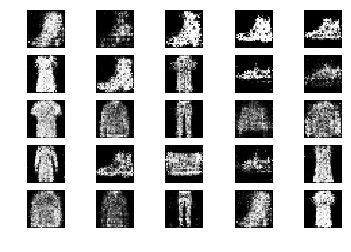

7401 [Discriminator loss: 0.689989, acc.: 57.81%] [Generator loss: 0.954144]
7402 [Discriminator loss: 0.635437, acc.: 64.06%] [Generator loss: 0.935175]
7403 [Discriminator loss: 0.668745, acc.: 56.25%] [Generator loss: 0.871688]
7404 [Discriminator loss: 0.667128, acc.: 53.12%] [Generator loss: 0.900538]
7405 [Discriminator loss: 0.603902, acc.: 62.50%] [Generator loss: 0.898890]
7406 [Discriminator loss: 0.596152, acc.: 68.75%] [Generator loss: 1.042574]
7407 [Discriminator loss: 0.642937, acc.: 59.38%] [Generator loss: 1.026937]
7408 [Discriminator loss: 0.658645, acc.: 59.38%] [Generator loss: 0.960256]
7409 [Discriminator loss: 0.604594, acc.: 70.31%] [Generator loss: 1.014907]
7410 [Discriminator loss: 0.684716, acc.: 60.94%] [Generator loss: 0.962918]
7411 [Discriminator loss: 0.683467, acc.: 53.12%] [Generator loss: 0.905172]
7412 [Discriminator loss: 0.589882, acc.: 68.75%] [Generator loss: 0.931519]
7413 [Discriminator loss: 0.684675, acc.: 57.81%] [Generator loss: 0.842791]

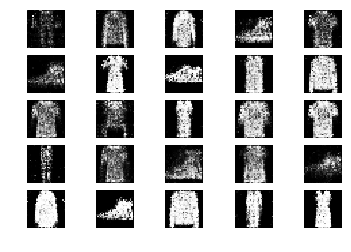

7501 [Discriminator loss: 0.674421, acc.: 53.12%] [Generator loss: 1.017692]
7502 [Discriminator loss: 0.589491, acc.: 70.31%] [Generator loss: 0.923886]
7503 [Discriminator loss: 0.680256, acc.: 56.25%] [Generator loss: 0.929215]
7504 [Discriminator loss: 0.624608, acc.: 68.75%] [Generator loss: 0.959923]
7505 [Discriminator loss: 0.669790, acc.: 62.50%] [Generator loss: 0.988968]
7506 [Discriminator loss: 0.641321, acc.: 59.38%] [Generator loss: 0.953644]
7507 [Discriminator loss: 0.671991, acc.: 56.25%] [Generator loss: 0.844608]
7508 [Discriminator loss: 0.629869, acc.: 67.19%] [Generator loss: 0.903053]
7509 [Discriminator loss: 0.611812, acc.: 67.19%] [Generator loss: 0.785633]
7510 [Discriminator loss: 0.699143, acc.: 59.38%] [Generator loss: 0.904457]
7511 [Discriminator loss: 0.698471, acc.: 57.81%] [Generator loss: 0.924683]
7512 [Discriminator loss: 0.660188, acc.: 62.50%] [Generator loss: 0.878498]
7513 [Discriminator loss: 0.674217, acc.: 59.38%] [Generator loss: 0.913155]

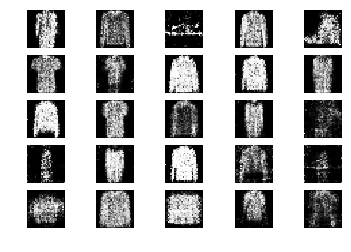

7601 [Discriminator loss: 0.618000, acc.: 62.50%] [Generator loss: 0.913168]
7602 [Discriminator loss: 0.642323, acc.: 64.06%] [Generator loss: 0.961858]
7603 [Discriminator loss: 0.650276, acc.: 60.94%] [Generator loss: 0.909139]
7604 [Discriminator loss: 0.637772, acc.: 57.81%] [Generator loss: 0.893943]
7605 [Discriminator loss: 0.671675, acc.: 57.81%] [Generator loss: 0.854624]
7606 [Discriminator loss: 0.704193, acc.: 54.69%] [Generator loss: 0.818511]
7607 [Discriminator loss: 0.660550, acc.: 60.94%] [Generator loss: 0.804240]
7608 [Discriminator loss: 0.686380, acc.: 46.88%] [Generator loss: 0.913815]
7609 [Discriminator loss: 0.706066, acc.: 65.62%] [Generator loss: 0.833387]
7610 [Discriminator loss: 0.678060, acc.: 64.06%] [Generator loss: 0.854679]
7611 [Discriminator loss: 0.618514, acc.: 67.19%] [Generator loss: 0.933111]
7612 [Discriminator loss: 0.649651, acc.: 53.12%] [Generator loss: 0.927167]
7613 [Discriminator loss: 0.605880, acc.: 65.62%] [Generator loss: 0.965785]

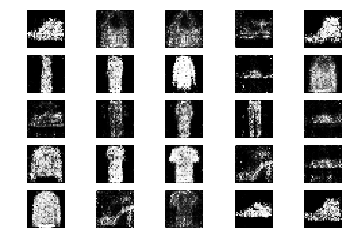

7701 [Discriminator loss: 0.681604, acc.: 70.31%] [Generator loss: 0.976721]
7702 [Discriminator loss: 0.682044, acc.: 54.69%] [Generator loss: 0.898384]
7703 [Discriminator loss: 0.671587, acc.: 56.25%] [Generator loss: 0.963455]
7704 [Discriminator loss: 0.654806, acc.: 60.94%] [Generator loss: 1.023231]
7705 [Discriminator loss: 0.658700, acc.: 54.69%] [Generator loss: 0.997086]
7706 [Discriminator loss: 0.633558, acc.: 68.75%] [Generator loss: 0.894385]
7707 [Discriminator loss: 0.664790, acc.: 57.81%] [Generator loss: 0.857718]
7708 [Discriminator loss: 0.627015, acc.: 60.94%] [Generator loss: 0.845034]
7709 [Discriminator loss: 0.638152, acc.: 60.94%] [Generator loss: 0.991293]
7710 [Discriminator loss: 0.698660, acc.: 56.25%] [Generator loss: 0.920733]
7711 [Discriminator loss: 0.653349, acc.: 67.19%] [Generator loss: 0.836913]
7712 [Discriminator loss: 0.688959, acc.: 48.44%] [Generator loss: 0.870065]
7713 [Discriminator loss: 0.614712, acc.: 68.75%] [Generator loss: 0.916367]

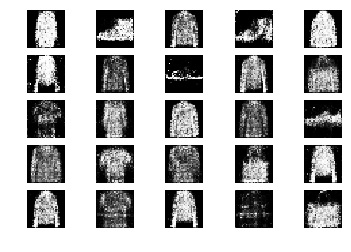

7801 [Discriminator loss: 0.689721, acc.: 60.94%] [Generator loss: 0.855682]
7802 [Discriminator loss: 0.652656, acc.: 67.19%] [Generator loss: 0.958042]
7803 [Discriminator loss: 0.605628, acc.: 73.44%] [Generator loss: 0.967448]
7804 [Discriminator loss: 0.643149, acc.: 67.19%] [Generator loss: 0.975387]
7805 [Discriminator loss: 0.650740, acc.: 62.50%] [Generator loss: 0.985772]
7806 [Discriminator loss: 0.637300, acc.: 75.00%] [Generator loss: 1.014082]
7807 [Discriminator loss: 0.601964, acc.: 71.88%] [Generator loss: 0.977461]
7808 [Discriminator loss: 0.614590, acc.: 67.19%] [Generator loss: 0.930275]
7809 [Discriminator loss: 0.632708, acc.: 67.19%] [Generator loss: 0.875019]
7810 [Discriminator loss: 0.662554, acc.: 70.31%] [Generator loss: 0.917321]
7811 [Discriminator loss: 0.637779, acc.: 67.19%] [Generator loss: 0.862443]
7812 [Discriminator loss: 0.621973, acc.: 70.31%] [Generator loss: 0.941805]
7813 [Discriminator loss: 0.661408, acc.: 54.69%] [Generator loss: 0.941521]

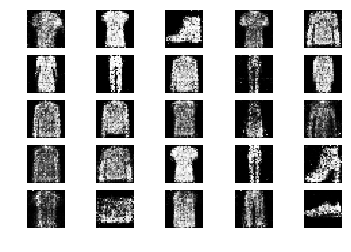

7901 [Discriminator loss: 0.669820, acc.: 67.19%] [Generator loss: 0.860963]
7902 [Discriminator loss: 0.597845, acc.: 75.00%] [Generator loss: 1.022381]
7903 [Discriminator loss: 0.599655, acc.: 68.75%] [Generator loss: 0.939056]
7904 [Discriminator loss: 0.645671, acc.: 68.75%] [Generator loss: 0.944104]
7905 [Discriminator loss: 0.665778, acc.: 60.94%] [Generator loss: 1.018703]
7906 [Discriminator loss: 0.626033, acc.: 67.19%] [Generator loss: 1.005242]
7907 [Discriminator loss: 0.595455, acc.: 71.88%] [Generator loss: 0.946473]
7908 [Discriminator loss: 0.608299, acc.: 67.19%] [Generator loss: 0.920389]
7909 [Discriminator loss: 0.615390, acc.: 71.88%] [Generator loss: 0.860318]
7910 [Discriminator loss: 0.661946, acc.: 59.38%] [Generator loss: 0.871227]
7911 [Discriminator loss: 0.631840, acc.: 60.94%] [Generator loss: 0.942667]
7912 [Discriminator loss: 0.680242, acc.: 59.38%] [Generator loss: 0.899572]
7913 [Discriminator loss: 0.612891, acc.: 68.75%] [Generator loss: 0.932551]

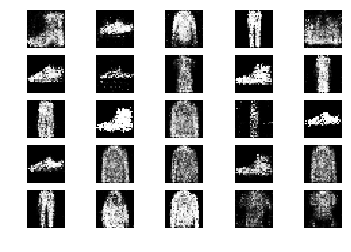

8001 [Discriminator loss: 0.728892, acc.: 56.25%] [Generator loss: 0.976759]
8002 [Discriminator loss: 0.639195, acc.: 60.94%] [Generator loss: 0.920294]
8003 [Discriminator loss: 0.642178, acc.: 67.19%] [Generator loss: 0.979305]
8004 [Discriminator loss: 0.698649, acc.: 53.12%] [Generator loss: 0.967483]
8005 [Discriminator loss: 0.639302, acc.: 67.19%] [Generator loss: 0.892978]
8006 [Discriminator loss: 0.619503, acc.: 64.06%] [Generator loss: 0.870222]
8007 [Discriminator loss: 0.642974, acc.: 56.25%] [Generator loss: 0.870028]
8008 [Discriminator loss: 0.685035, acc.: 56.25%] [Generator loss: 0.879373]
8009 [Discriminator loss: 0.652110, acc.: 62.50%] [Generator loss: 1.003399]
8010 [Discriminator loss: 0.593568, acc.: 67.19%] [Generator loss: 0.904183]
8011 [Discriminator loss: 0.702329, acc.: 53.12%] [Generator loss: 0.903260]
8012 [Discriminator loss: 0.670156, acc.: 53.12%] [Generator loss: 0.921526]
8013 [Discriminator loss: 0.611633, acc.: 68.75%] [Generator loss: 0.815141]

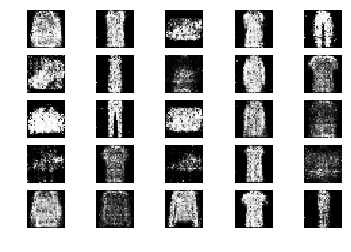

8101 [Discriminator loss: 0.681064, acc.: 51.56%] [Generator loss: 0.963416]
8102 [Discriminator loss: 0.664522, acc.: 64.06%] [Generator loss: 0.998705]
8103 [Discriminator loss: 0.664166, acc.: 62.50%] [Generator loss: 1.061882]
8104 [Discriminator loss: 0.672209, acc.: 62.50%] [Generator loss: 0.875257]
8105 [Discriminator loss: 0.707862, acc.: 53.12%] [Generator loss: 0.937274]
8106 [Discriminator loss: 0.595932, acc.: 68.75%] [Generator loss: 0.983744]
8107 [Discriminator loss: 0.663361, acc.: 59.38%] [Generator loss: 1.004769]
8108 [Discriminator loss: 0.650171, acc.: 65.62%] [Generator loss: 0.924502]
8109 [Discriminator loss: 0.620950, acc.: 62.50%] [Generator loss: 0.992103]
8110 [Discriminator loss: 0.665776, acc.: 60.94%] [Generator loss: 0.974893]
8111 [Discriminator loss: 0.650656, acc.: 65.62%] [Generator loss: 0.857111]
8112 [Discriminator loss: 0.642282, acc.: 64.06%] [Generator loss: 0.886179]
8113 [Discriminator loss: 0.665212, acc.: 56.25%] [Generator loss: 0.862897]

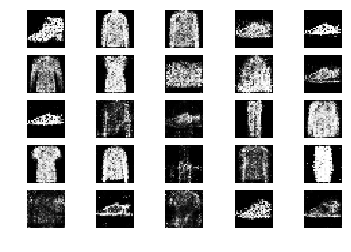

8201 [Discriminator loss: 0.670211, acc.: 62.50%] [Generator loss: 0.908259]
8202 [Discriminator loss: 0.671934, acc.: 62.50%] [Generator loss: 0.873066]
8203 [Discriminator loss: 0.614557, acc.: 65.62%] [Generator loss: 0.929708]
8204 [Discriminator loss: 0.797971, acc.: 43.75%] [Generator loss: 0.805904]
8205 [Discriminator loss: 0.657108, acc.: 59.38%] [Generator loss: 0.885883]
8206 [Discriminator loss: 0.674923, acc.: 51.56%] [Generator loss: 0.980848]
8207 [Discriminator loss: 0.642078, acc.: 64.06%] [Generator loss: 0.995445]
8208 [Discriminator loss: 0.671451, acc.: 59.38%] [Generator loss: 1.090203]
8209 [Discriminator loss: 0.652924, acc.: 62.50%] [Generator loss: 0.987478]
8210 [Discriminator loss: 0.636200, acc.: 60.94%] [Generator loss: 0.884040]
8211 [Discriminator loss: 0.647578, acc.: 67.19%] [Generator loss: 0.900708]
8212 [Discriminator loss: 0.571222, acc.: 75.00%] [Generator loss: 0.854912]
8213 [Discriminator loss: 0.554084, acc.: 75.00%] [Generator loss: 0.921492]

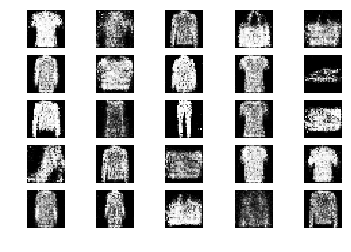

8301 [Discriminator loss: 0.645235, acc.: 64.06%] [Generator loss: 0.895215]
8302 [Discriminator loss: 0.644598, acc.: 64.06%] [Generator loss: 0.972507]
8303 [Discriminator loss: 0.657716, acc.: 56.25%] [Generator loss: 0.987512]
8304 [Discriminator loss: 0.712851, acc.: 50.00%] [Generator loss: 0.958713]
8305 [Discriminator loss: 0.672815, acc.: 62.50%] [Generator loss: 0.985096]
8306 [Discriminator loss: 0.581109, acc.: 70.31%] [Generator loss: 0.984200]
8307 [Discriminator loss: 0.595351, acc.: 65.62%] [Generator loss: 0.953294]
8308 [Discriminator loss: 0.602686, acc.: 68.75%] [Generator loss: 0.930427]
8309 [Discriminator loss: 0.617942, acc.: 64.06%] [Generator loss: 0.952038]
8310 [Discriminator loss: 0.657539, acc.: 59.38%] [Generator loss: 0.875222]
8311 [Discriminator loss: 0.625247, acc.: 65.62%] [Generator loss: 1.009893]
8312 [Discriminator loss: 0.665937, acc.: 56.25%] [Generator loss: 1.014337]
8313 [Discriminator loss: 0.603550, acc.: 75.00%] [Generator loss: 0.922289]

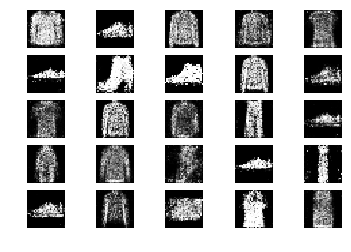

8401 [Discriminator loss: 0.695240, acc.: 54.69%] [Generator loss: 0.897188]
8402 [Discriminator loss: 0.654911, acc.: 62.50%] [Generator loss: 0.890705]
8403 [Discriminator loss: 0.659024, acc.: 57.81%] [Generator loss: 0.944200]
8404 [Discriminator loss: 0.652538, acc.: 65.62%] [Generator loss: 0.881679]
8405 [Discriminator loss: 0.649896, acc.: 60.94%] [Generator loss: 0.892198]
8406 [Discriminator loss: 0.685798, acc.: 59.38%] [Generator loss: 0.924205]
8407 [Discriminator loss: 0.669232, acc.: 60.94%] [Generator loss: 0.946138]
8408 [Discriminator loss: 0.708301, acc.: 57.81%] [Generator loss: 0.900691]
8409 [Discriminator loss: 0.614923, acc.: 65.62%] [Generator loss: 0.874455]
8410 [Discriminator loss: 0.652661, acc.: 62.50%] [Generator loss: 0.939052]
8411 [Discriminator loss: 0.659591, acc.: 65.62%] [Generator loss: 0.893346]
8412 [Discriminator loss: 0.634989, acc.: 67.19%] [Generator loss: 0.902349]
8413 [Discriminator loss: 0.628787, acc.: 67.19%] [Generator loss: 0.965474]

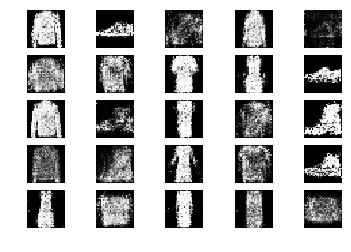

8501 [Discriminator loss: 0.640120, acc.: 59.38%] [Generator loss: 0.918486]
8502 [Discriminator loss: 0.658180, acc.: 62.50%] [Generator loss: 0.897525]
8503 [Discriminator loss: 0.661257, acc.: 62.50%] [Generator loss: 0.927981]
8504 [Discriminator loss: 0.620983, acc.: 70.31%] [Generator loss: 0.923938]
8505 [Discriminator loss: 0.642253, acc.: 62.50%] [Generator loss: 0.940230]
8506 [Discriminator loss: 0.628253, acc.: 62.50%] [Generator loss: 0.949763]
8507 [Discriminator loss: 0.637474, acc.: 64.06%] [Generator loss: 0.886794]
8508 [Discriminator loss: 0.622837, acc.: 67.19%] [Generator loss: 0.927521]
8509 [Discriminator loss: 0.743031, acc.: 54.69%] [Generator loss: 0.900666]
8510 [Discriminator loss: 0.658820, acc.: 56.25%] [Generator loss: 0.895765]
8511 [Discriminator loss: 0.633275, acc.: 60.94%] [Generator loss: 0.896638]
8512 [Discriminator loss: 0.649989, acc.: 54.69%] [Generator loss: 0.887478]
8513 [Discriminator loss: 0.697579, acc.: 60.94%] [Generator loss: 0.924997]

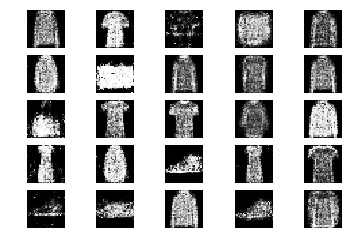

8601 [Discriminator loss: 0.642071, acc.: 60.94%] [Generator loss: 0.936681]
8602 [Discriminator loss: 0.657617, acc.: 57.81%] [Generator loss: 0.919776]
8603 [Discriminator loss: 0.578583, acc.: 71.88%] [Generator loss: 1.043313]
8604 [Discriminator loss: 0.602668, acc.: 64.06%] [Generator loss: 0.946928]
8605 [Discriminator loss: 0.689778, acc.: 56.25%] [Generator loss: 0.979743]
8606 [Discriminator loss: 0.614648, acc.: 64.06%] [Generator loss: 1.008802]
8607 [Discriminator loss: 0.680108, acc.: 45.31%] [Generator loss: 0.898938]
8608 [Discriminator loss: 0.634756, acc.: 62.50%] [Generator loss: 0.940475]
8609 [Discriminator loss: 0.656223, acc.: 75.00%] [Generator loss: 0.813204]
8610 [Discriminator loss: 0.631483, acc.: 64.06%] [Generator loss: 0.938409]
8611 [Discriminator loss: 0.704813, acc.: 59.38%] [Generator loss: 0.921967]
8612 [Discriminator loss: 0.642105, acc.: 70.31%] [Generator loss: 0.989000]
8613 [Discriminator loss: 0.655073, acc.: 56.25%] [Generator loss: 1.057329]

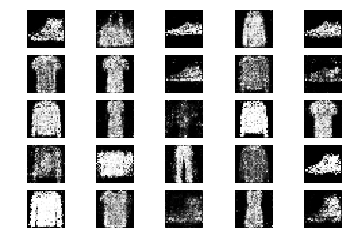

8701 [Discriminator loss: 0.605406, acc.: 67.19%] [Generator loss: 0.903352]
8702 [Discriminator loss: 0.673331, acc.: 65.62%] [Generator loss: 0.900120]
8703 [Discriminator loss: 0.660468, acc.: 65.62%] [Generator loss: 0.986236]
8704 [Discriminator loss: 0.645073, acc.: 64.06%] [Generator loss: 0.880448]
8705 [Discriminator loss: 0.686753, acc.: 65.62%] [Generator loss: 0.876143]
8706 [Discriminator loss: 0.550433, acc.: 75.00%] [Generator loss: 0.913122]
8707 [Discriminator loss: 0.663925, acc.: 56.25%] [Generator loss: 0.879259]
8708 [Discriminator loss: 0.624800, acc.: 65.62%] [Generator loss: 0.919659]
8709 [Discriminator loss: 0.582794, acc.: 71.88%] [Generator loss: 0.936865]
8710 [Discriminator loss: 0.709002, acc.: 50.00%] [Generator loss: 0.900510]
8711 [Discriminator loss: 0.686221, acc.: 62.50%] [Generator loss: 0.914864]
8712 [Discriminator loss: 0.640631, acc.: 64.06%] [Generator loss: 0.860047]
8713 [Discriminator loss: 0.669334, acc.: 56.25%] [Generator loss: 1.030721]

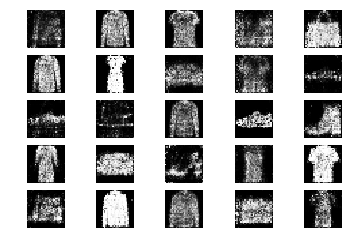

8801 [Discriminator loss: 0.627488, acc.: 73.44%] [Generator loss: 0.901554]
8802 [Discriminator loss: 0.637984, acc.: 64.06%] [Generator loss: 0.900540]
8803 [Discriminator loss: 0.640790, acc.: 70.31%] [Generator loss: 0.814307]
8804 [Discriminator loss: 0.679006, acc.: 57.81%] [Generator loss: 0.896673]
8805 [Discriminator loss: 0.624400, acc.: 60.94%] [Generator loss: 0.868378]
8806 [Discriminator loss: 0.667473, acc.: 60.94%] [Generator loss: 0.921178]
8807 [Discriminator loss: 0.704349, acc.: 53.12%] [Generator loss: 0.897330]
8808 [Discriminator loss: 0.625151, acc.: 62.50%] [Generator loss: 0.949636]
8809 [Discriminator loss: 0.667571, acc.: 59.38%] [Generator loss: 0.858253]
8810 [Discriminator loss: 0.611532, acc.: 68.75%] [Generator loss: 0.895532]
8811 [Discriminator loss: 0.602504, acc.: 65.62%] [Generator loss: 0.863757]
8812 [Discriminator loss: 0.683507, acc.: 54.69%] [Generator loss: 0.834348]
8813 [Discriminator loss: 0.630320, acc.: 60.94%] [Generator loss: 0.903906]

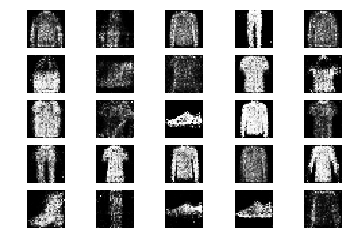

8901 [Discriminator loss: 0.680309, acc.: 59.38%] [Generator loss: 0.950730]
8902 [Discriminator loss: 0.628795, acc.: 64.06%] [Generator loss: 0.918653]
8903 [Discriminator loss: 0.618220, acc.: 67.19%] [Generator loss: 1.026276]
8904 [Discriminator loss: 0.633770, acc.: 67.19%] [Generator loss: 0.920540]
8905 [Discriminator loss: 0.665573, acc.: 59.38%] [Generator loss: 0.873108]
8906 [Discriminator loss: 0.585533, acc.: 68.75%] [Generator loss: 0.969842]
8907 [Discriminator loss: 0.650196, acc.: 57.81%] [Generator loss: 0.927860]
8908 [Discriminator loss: 0.631835, acc.: 62.50%] [Generator loss: 0.963682]
8909 [Discriminator loss: 0.629813, acc.: 71.88%] [Generator loss: 0.883584]
8910 [Discriminator loss: 0.690469, acc.: 59.38%] [Generator loss: 0.923312]
8911 [Discriminator loss: 0.728285, acc.: 50.00%] [Generator loss: 0.944000]
8912 [Discriminator loss: 0.615925, acc.: 64.06%] [Generator loss: 0.984961]
8913 [Discriminator loss: 0.592636, acc.: 68.75%] [Generator loss: 0.898720]

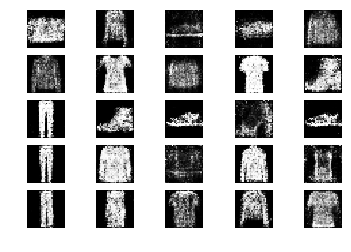

9001 [Discriminator loss: 0.654773, acc.: 65.62%] [Generator loss: 0.957298]
9002 [Discriminator loss: 0.660961, acc.: 59.38%] [Generator loss: 0.896907]
9003 [Discriminator loss: 0.667981, acc.: 62.50%] [Generator loss: 0.881658]
9004 [Discriminator loss: 0.636083, acc.: 57.81%] [Generator loss: 0.921365]
9005 [Discriminator loss: 0.675023, acc.: 53.12%] [Generator loss: 0.993589]
9006 [Discriminator loss: 0.601350, acc.: 65.62%] [Generator loss: 1.002311]
9007 [Discriminator loss: 0.697224, acc.: 60.94%] [Generator loss: 0.935370]
9008 [Discriminator loss: 0.750346, acc.: 45.31%] [Generator loss: 0.861861]
9009 [Discriminator loss: 0.670691, acc.: 57.81%] [Generator loss: 0.925174]
9010 [Discriminator loss: 0.591597, acc.: 65.62%] [Generator loss: 0.837168]
9011 [Discriminator loss: 0.584815, acc.: 67.19%] [Generator loss: 0.954171]
9012 [Discriminator loss: 0.698282, acc.: 48.44%] [Generator loss: 0.886784]
9013 [Discriminator loss: 0.676583, acc.: 56.25%] [Generator loss: 0.875148]

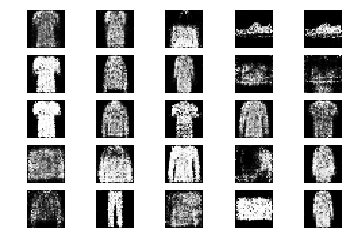

9101 [Discriminator loss: 0.651303, acc.: 60.94%] [Generator loss: 0.908847]
9102 [Discriminator loss: 0.624574, acc.: 57.81%] [Generator loss: 0.962803]
9103 [Discriminator loss: 0.680506, acc.: 50.00%] [Generator loss: 0.941907]
9104 [Discriminator loss: 0.673224, acc.: 56.25%] [Generator loss: 0.892143]
9105 [Discriminator loss: 0.693334, acc.: 53.12%] [Generator loss: 0.840775]
9106 [Discriminator loss: 0.685709, acc.: 57.81%] [Generator loss: 0.813095]
9107 [Discriminator loss: 0.671948, acc.: 59.38%] [Generator loss: 0.958755]
9108 [Discriminator loss: 0.683776, acc.: 59.38%] [Generator loss: 0.921739]
9109 [Discriminator loss: 0.651524, acc.: 65.62%] [Generator loss: 0.878646]
9110 [Discriminator loss: 0.612118, acc.: 73.44%] [Generator loss: 0.875653]
9111 [Discriminator loss: 0.654614, acc.: 65.62%] [Generator loss: 0.832211]
9112 [Discriminator loss: 0.617668, acc.: 70.31%] [Generator loss: 0.862625]
9113 [Discriminator loss: 0.693526, acc.: 54.69%] [Generator loss: 0.898972]

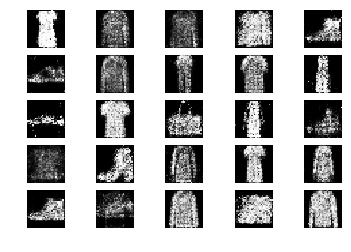

9201 [Discriminator loss: 0.600723, acc.: 64.06%] [Generator loss: 0.871263]
9202 [Discriminator loss: 0.605961, acc.: 67.19%] [Generator loss: 0.967811]
9203 [Discriminator loss: 0.681345, acc.: 56.25%] [Generator loss: 0.831271]
9204 [Discriminator loss: 0.663416, acc.: 56.25%] [Generator loss: 0.905945]
9205 [Discriminator loss: 0.650518, acc.: 62.50%] [Generator loss: 0.850320]
9206 [Discriminator loss: 0.663768, acc.: 57.81%] [Generator loss: 0.958210]
9207 [Discriminator loss: 0.719974, acc.: 54.69%] [Generator loss: 0.942382]
9208 [Discriminator loss: 0.681958, acc.: 54.69%] [Generator loss: 1.023545]
9209 [Discriminator loss: 0.701433, acc.: 53.12%] [Generator loss: 1.032663]
9210 [Discriminator loss: 0.644945, acc.: 62.50%] [Generator loss: 0.911378]
9211 [Discriminator loss: 0.613839, acc.: 64.06%] [Generator loss: 0.913280]
9212 [Discriminator loss: 0.610361, acc.: 67.19%] [Generator loss: 0.935654]
9213 [Discriminator loss: 0.637404, acc.: 56.25%] [Generator loss: 0.887232]

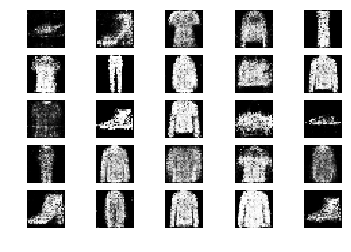

9301 [Discriminator loss: 0.701651, acc.: 53.12%] [Generator loss: 0.855820]
9302 [Discriminator loss: 0.704780, acc.: 53.12%] [Generator loss: 0.933088]
9303 [Discriminator loss: 0.692590, acc.: 50.00%] [Generator loss: 0.914360]
9304 [Discriminator loss: 0.665674, acc.: 56.25%] [Generator loss: 0.914599]
9305 [Discriminator loss: 0.646039, acc.: 60.94%] [Generator loss: 0.857426]
9306 [Discriminator loss: 0.680764, acc.: 64.06%] [Generator loss: 0.897455]
9307 [Discriminator loss: 0.642993, acc.: 70.31%] [Generator loss: 0.883956]
9308 [Discriminator loss: 0.675471, acc.: 59.38%] [Generator loss: 0.845276]
9309 [Discriminator loss: 0.624411, acc.: 64.06%] [Generator loss: 0.923569]
9310 [Discriminator loss: 0.648627, acc.: 65.62%] [Generator loss: 0.889830]
9311 [Discriminator loss: 0.681335, acc.: 56.25%] [Generator loss: 0.958803]
9312 [Discriminator loss: 0.702897, acc.: 53.12%] [Generator loss: 0.953339]
9313 [Discriminator loss: 0.680796, acc.: 57.81%] [Generator loss: 0.887400]

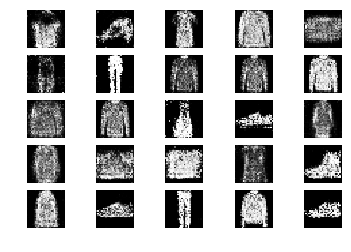

9401 [Discriminator loss: 0.674300, acc.: 51.56%] [Generator loss: 0.804775]
9402 [Discriminator loss: 0.655393, acc.: 60.94%] [Generator loss: 1.019440]
9403 [Discriminator loss: 0.655706, acc.: 60.94%] [Generator loss: 0.928328]
9404 [Discriminator loss: 0.716025, acc.: 54.69%] [Generator loss: 0.916202]
9405 [Discriminator loss: 0.654694, acc.: 59.38%] [Generator loss: 0.918135]
9406 [Discriminator loss: 0.722828, acc.: 56.25%] [Generator loss: 0.940978]
9407 [Discriminator loss: 0.638235, acc.: 62.50%] [Generator loss: 0.896405]
9408 [Discriminator loss: 0.678877, acc.: 54.69%] [Generator loss: 0.924795]
9409 [Discriminator loss: 0.688595, acc.: 56.25%] [Generator loss: 0.819120]
9410 [Discriminator loss: 0.669948, acc.: 54.69%] [Generator loss: 0.881257]
9411 [Discriminator loss: 0.677390, acc.: 60.94%] [Generator loss: 0.815677]
9412 [Discriminator loss: 0.667274, acc.: 57.81%] [Generator loss: 0.882028]
9413 [Discriminator loss: 0.734586, acc.: 48.44%] [Generator loss: 0.907565]

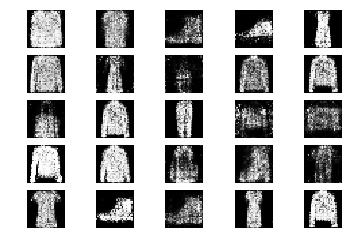

9501 [Discriminator loss: 0.600939, acc.: 71.88%] [Generator loss: 0.905211]
9502 [Discriminator loss: 0.621372, acc.: 65.62%] [Generator loss: 0.868132]
9503 [Discriminator loss: 0.686831, acc.: 57.81%] [Generator loss: 0.853045]
9504 [Discriminator loss: 0.651634, acc.: 59.38%] [Generator loss: 0.835358]
9505 [Discriminator loss: 0.681547, acc.: 48.44%] [Generator loss: 0.832895]
9506 [Discriminator loss: 0.595682, acc.: 65.62%] [Generator loss: 0.833606]
9507 [Discriminator loss: 0.670525, acc.: 59.38%] [Generator loss: 0.989594]
9508 [Discriminator loss: 0.636302, acc.: 64.06%] [Generator loss: 0.949127]
9509 [Discriminator loss: 0.651666, acc.: 56.25%] [Generator loss: 0.877080]
9510 [Discriminator loss: 0.712002, acc.: 51.56%] [Generator loss: 0.849528]
9511 [Discriminator loss: 0.620052, acc.: 70.31%] [Generator loss: 0.920170]
9512 [Discriminator loss: 0.594984, acc.: 67.19%] [Generator loss: 0.926594]
9513 [Discriminator loss: 0.656577, acc.: 56.25%] [Generator loss: 0.978601]

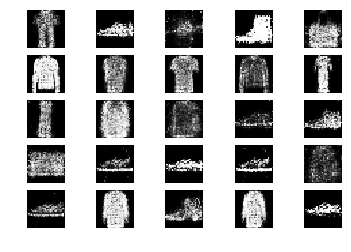

9601 [Discriminator loss: 0.609762, acc.: 70.31%] [Generator loss: 0.859258]
9602 [Discriminator loss: 0.666230, acc.: 60.94%] [Generator loss: 1.006344]
9603 [Discriminator loss: 0.683891, acc.: 54.69%] [Generator loss: 0.817549]
9604 [Discriminator loss: 0.683318, acc.: 57.81%] [Generator loss: 0.859701]
9605 [Discriminator loss: 0.682734, acc.: 56.25%] [Generator loss: 0.989349]
9606 [Discriminator loss: 0.713706, acc.: 54.69%] [Generator loss: 0.833160]
9607 [Discriminator loss: 0.630367, acc.: 50.00%] [Generator loss: 0.988376]
9608 [Discriminator loss: 0.686961, acc.: 51.56%] [Generator loss: 0.988084]
9609 [Discriminator loss: 0.658213, acc.: 60.94%] [Generator loss: 0.888333]
9610 [Discriminator loss: 0.654558, acc.: 59.38%] [Generator loss: 0.882119]
9611 [Discriminator loss: 0.639870, acc.: 64.06%] [Generator loss: 0.842116]
9612 [Discriminator loss: 0.656717, acc.: 65.62%] [Generator loss: 0.924057]
9613 [Discriminator loss: 0.604484, acc.: 68.75%] [Generator loss: 0.965482]

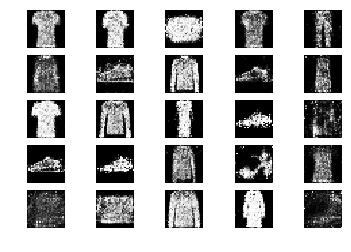

9701 [Discriminator loss: 0.640369, acc.: 64.06%] [Generator loss: 0.960397]
9702 [Discriminator loss: 0.611512, acc.: 68.75%] [Generator loss: 0.954898]
9703 [Discriminator loss: 0.661824, acc.: 57.81%] [Generator loss: 0.964571]
9704 [Discriminator loss: 0.653830, acc.: 62.50%] [Generator loss: 0.963861]
9705 [Discriminator loss: 0.690679, acc.: 56.25%] [Generator loss: 0.977205]
9706 [Discriminator loss: 0.673234, acc.: 60.94%] [Generator loss: 0.938216]
9707 [Discriminator loss: 0.674848, acc.: 62.50%] [Generator loss: 0.886249]
9708 [Discriminator loss: 0.686421, acc.: 53.12%] [Generator loss: 0.892458]
9709 [Discriminator loss: 0.710794, acc.: 53.12%] [Generator loss: 0.839224]
9710 [Discriminator loss: 0.671386, acc.: 60.94%] [Generator loss: 0.845323]
9711 [Discriminator loss: 0.682824, acc.: 59.38%] [Generator loss: 0.823779]
9712 [Discriminator loss: 0.645227, acc.: 67.19%] [Generator loss: 0.865638]
9713 [Discriminator loss: 0.629664, acc.: 54.69%] [Generator loss: 0.847379]

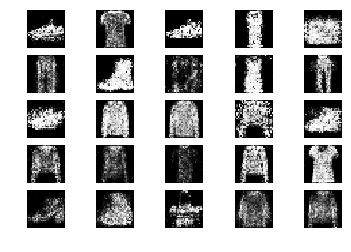

9801 [Discriminator loss: 0.599070, acc.: 73.44%] [Generator loss: 0.808386]
9802 [Discriminator loss: 0.702354, acc.: 51.56%] [Generator loss: 0.902894]
9803 [Discriminator loss: 0.603132, acc.: 65.62%] [Generator loss: 0.850480]
9804 [Discriminator loss: 0.569107, acc.: 70.31%] [Generator loss: 0.856356]
9805 [Discriminator loss: 0.673906, acc.: 57.81%] [Generator loss: 0.878358]
9806 [Discriminator loss: 0.562641, acc.: 71.88%] [Generator loss: 0.898013]
9807 [Discriminator loss: 0.688721, acc.: 57.81%] [Generator loss: 0.932717]
9808 [Discriminator loss: 0.658646, acc.: 64.06%] [Generator loss: 0.904275]
9809 [Discriminator loss: 0.745672, acc.: 51.56%] [Generator loss: 0.921844]
9810 [Discriminator loss: 0.661597, acc.: 64.06%] [Generator loss: 0.964712]
9811 [Discriminator loss: 0.597680, acc.: 71.88%] [Generator loss: 0.961123]
9812 [Discriminator loss: 0.686167, acc.: 59.38%] [Generator loss: 0.934056]
9813 [Discriminator loss: 0.599878, acc.: 71.88%] [Generator loss: 0.911064]

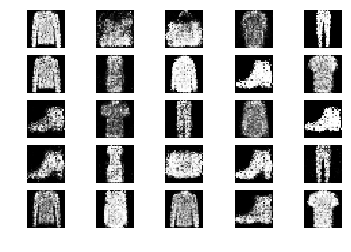

9901 [Discriminator loss: 0.691689, acc.: 48.44%] [Generator loss: 0.953078]
9902 [Discriminator loss: 0.613119, acc.: 62.50%] [Generator loss: 0.981325]
9903 [Discriminator loss: 0.603800, acc.: 62.50%] [Generator loss: 0.907775]
9904 [Discriminator loss: 0.599990, acc.: 70.31%] [Generator loss: 0.902073]
9905 [Discriminator loss: 0.704607, acc.: 51.56%] [Generator loss: 0.948608]
9906 [Discriminator loss: 0.655921, acc.: 59.38%] [Generator loss: 0.906885]
9907 [Discriminator loss: 0.660452, acc.: 56.25%] [Generator loss: 1.001181]
9908 [Discriminator loss: 0.726971, acc.: 50.00%] [Generator loss: 0.886687]
9909 [Discriminator loss: 0.665721, acc.: 62.50%] [Generator loss: 0.827007]
9910 [Discriminator loss: 0.679618, acc.: 64.06%] [Generator loss: 0.917677]
9911 [Discriminator loss: 0.618584, acc.: 71.88%] [Generator loss: 0.898962]
9912 [Discriminator loss: 0.654977, acc.: 60.94%] [Generator loss: 0.955301]
9913 [Discriminator loss: 0.695505, acc.: 51.56%] [Generator loss: 0.977599]

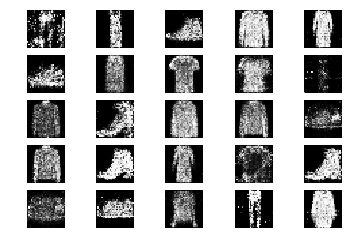

10001 [Discriminator loss: 0.678850, acc.: 54.69%] [Generator loss: 0.878861]
10002 [Discriminator loss: 0.655438, acc.: 60.94%] [Generator loss: 0.950128]
10003 [Discriminator loss: 0.718636, acc.: 53.12%] [Generator loss: 0.989365]
10004 [Discriminator loss: 0.593957, acc.: 79.69%] [Generator loss: 0.955783]
10005 [Discriminator loss: 0.709821, acc.: 51.56%] [Generator loss: 0.879976]
10006 [Discriminator loss: 0.645967, acc.: 62.50%] [Generator loss: 0.925141]
10007 [Discriminator loss: 0.653593, acc.: 65.62%] [Generator loss: 0.927538]
10008 [Discriminator loss: 0.673217, acc.: 56.25%] [Generator loss: 0.925009]
10009 [Discriminator loss: 0.681482, acc.: 48.44%] [Generator loss: 0.956872]
10010 [Discriminator loss: 0.662780, acc.: 60.94%] [Generator loss: 0.974964]
10011 [Discriminator loss: 0.647318, acc.: 62.50%] [Generator loss: 1.029755]
10012 [Discriminator loss: 0.635912, acc.: 62.50%] [Generator loss: 0.977193]
10013 [Discriminator loss: 0.673756, acc.: 60.94%] [Generator lo

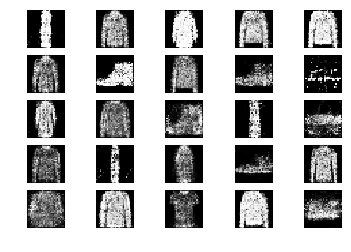

10101 [Discriminator loss: 0.668301, acc.: 57.81%] [Generator loss: 0.814715]
10102 [Discriminator loss: 0.699479, acc.: 59.38%] [Generator loss: 0.831745]
10103 [Discriminator loss: 0.646746, acc.: 54.69%] [Generator loss: 0.894404]
10104 [Discriminator loss: 0.687358, acc.: 56.25%] [Generator loss: 0.857871]
10105 [Discriminator loss: 0.598249, acc.: 75.00%] [Generator loss: 0.852301]
10106 [Discriminator loss: 0.672204, acc.: 54.69%] [Generator loss: 0.882721]
10107 [Discriminator loss: 0.683253, acc.: 54.69%] [Generator loss: 0.861777]
10108 [Discriminator loss: 0.593683, acc.: 68.75%] [Generator loss: 0.884445]
10109 [Discriminator loss: 0.648602, acc.: 57.81%] [Generator loss: 0.879071]
10110 [Discriminator loss: 0.612573, acc.: 68.75%] [Generator loss: 0.923623]
10111 [Discriminator loss: 0.641467, acc.: 57.81%] [Generator loss: 0.920094]
10112 [Discriminator loss: 0.640312, acc.: 59.38%] [Generator loss: 0.929352]
10113 [Discriminator loss: 0.629825, acc.: 68.75%] [Generator lo

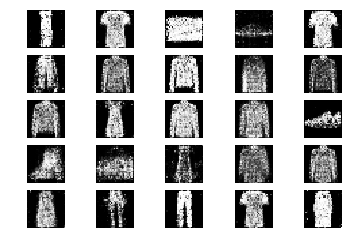

10201 [Discriminator loss: 0.646997, acc.: 62.50%] [Generator loss: 0.963946]
10202 [Discriminator loss: 0.646820, acc.: 68.75%] [Generator loss: 0.912504]
10203 [Discriminator loss: 0.653395, acc.: 56.25%] [Generator loss: 0.919215]
10204 [Discriminator loss: 0.648234, acc.: 60.94%] [Generator loss: 0.881100]
10205 [Discriminator loss: 0.600960, acc.: 68.75%] [Generator loss: 0.842653]
10206 [Discriminator loss: 0.625949, acc.: 71.88%] [Generator loss: 0.810572]
10207 [Discriminator loss: 0.717670, acc.: 54.69%] [Generator loss: 0.956239]
10208 [Discriminator loss: 0.682971, acc.: 60.94%] [Generator loss: 0.935912]
10209 [Discriminator loss: 0.639624, acc.: 62.50%] [Generator loss: 0.974792]
10210 [Discriminator loss: 0.673886, acc.: 60.94%] [Generator loss: 0.917724]
10211 [Discriminator loss: 0.696747, acc.: 51.56%] [Generator loss: 0.950654]
10212 [Discriminator loss: 0.636152, acc.: 59.38%] [Generator loss: 0.918025]
10213 [Discriminator loss: 0.759297, acc.: 59.38%] [Generator lo

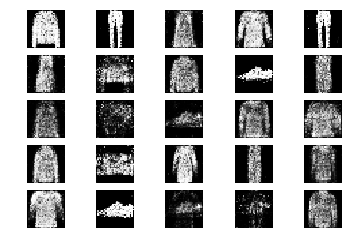

10301 [Discriminator loss: 0.661056, acc.: 59.38%] [Generator loss: 0.913820]
10302 [Discriminator loss: 0.654514, acc.: 68.75%] [Generator loss: 0.885892]
10303 [Discriminator loss: 0.695903, acc.: 54.69%] [Generator loss: 0.976582]
10304 [Discriminator loss: 0.660324, acc.: 60.94%] [Generator loss: 1.006084]
10305 [Discriminator loss: 0.664973, acc.: 62.50%] [Generator loss: 1.052723]
10306 [Discriminator loss: 0.618719, acc.: 65.62%] [Generator loss: 0.965838]
10307 [Discriminator loss: 0.647281, acc.: 65.62%] [Generator loss: 0.913552]
10308 [Discriminator loss: 0.628162, acc.: 73.44%] [Generator loss: 0.922373]
10309 [Discriminator loss: 0.631063, acc.: 71.88%] [Generator loss: 0.905316]
10310 [Discriminator loss: 0.662612, acc.: 62.50%] [Generator loss: 0.949658]
10311 [Discriminator loss: 0.598082, acc.: 62.50%] [Generator loss: 0.921275]
10312 [Discriminator loss: 0.631219, acc.: 65.62%] [Generator loss: 0.934632]
10313 [Discriminator loss: 0.659161, acc.: 62.50%] [Generator lo

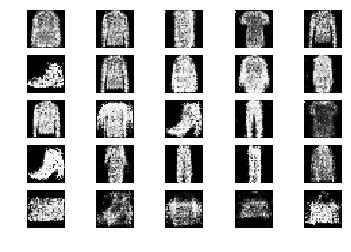

10401 [Discriminator loss: 0.714844, acc.: 59.38%] [Generator loss: 0.819333]
10402 [Discriminator loss: 0.597004, acc.: 70.31%] [Generator loss: 0.953093]
10403 [Discriminator loss: 0.658130, acc.: 67.19%] [Generator loss: 0.946973]
10404 [Discriminator loss: 0.633673, acc.: 60.94%] [Generator loss: 0.864899]
10405 [Discriminator loss: 0.606055, acc.: 67.19%] [Generator loss: 0.912097]
10406 [Discriminator loss: 0.709303, acc.: 62.50%] [Generator loss: 0.820782]
10407 [Discriminator loss: 0.542654, acc.: 73.44%] [Generator loss: 0.894075]
10408 [Discriminator loss: 0.720056, acc.: 51.56%] [Generator loss: 0.880348]
10409 [Discriminator loss: 0.684451, acc.: 56.25%] [Generator loss: 0.935017]
10410 [Discriminator loss: 0.644572, acc.: 57.81%] [Generator loss: 0.896298]
10411 [Discriminator loss: 0.597157, acc.: 68.75%] [Generator loss: 0.867662]
10412 [Discriminator loss: 0.671431, acc.: 60.94%] [Generator loss: 0.851511]
10413 [Discriminator loss: 0.618572, acc.: 70.31%] [Generator lo

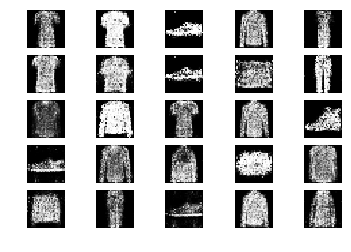

10501 [Discriminator loss: 0.724741, acc.: 51.56%] [Generator loss: 0.909877]
10502 [Discriminator loss: 0.685735, acc.: 59.38%] [Generator loss: 0.857145]
10503 [Discriminator loss: 0.672988, acc.: 56.25%] [Generator loss: 0.779753]
10504 [Discriminator loss: 0.646580, acc.: 59.38%] [Generator loss: 0.896993]
10505 [Discriminator loss: 0.607573, acc.: 64.06%] [Generator loss: 0.796868]
10506 [Discriminator loss: 0.641671, acc.: 62.50%] [Generator loss: 0.859188]
10507 [Discriminator loss: 0.672164, acc.: 59.38%] [Generator loss: 0.870115]
10508 [Discriminator loss: 0.656969, acc.: 59.38%] [Generator loss: 1.018250]
10509 [Discriminator loss: 0.641346, acc.: 68.75%] [Generator loss: 0.926498]
10510 [Discriminator loss: 0.644795, acc.: 64.06%] [Generator loss: 1.031338]
10511 [Discriminator loss: 0.640599, acc.: 59.38%] [Generator loss: 0.984535]
10512 [Discriminator loss: 0.637481, acc.: 64.06%] [Generator loss: 0.845326]
10513 [Discriminator loss: 0.647362, acc.: 65.62%] [Generator lo

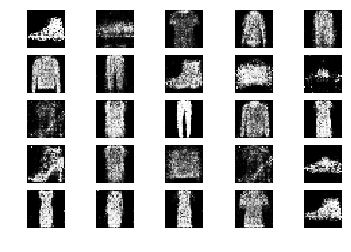

10601 [Discriminator loss: 0.650428, acc.: 62.50%] [Generator loss: 0.880403]
10602 [Discriminator loss: 0.613503, acc.: 65.62%] [Generator loss: 0.943355]
10603 [Discriminator loss: 0.732798, acc.: 56.25%] [Generator loss: 0.882157]
10604 [Discriminator loss: 0.681979, acc.: 57.81%] [Generator loss: 0.932761]
10605 [Discriminator loss: 0.701881, acc.: 50.00%] [Generator loss: 0.933042]
10606 [Discriminator loss: 0.654624, acc.: 60.94%] [Generator loss: 0.883773]
10607 [Discriminator loss: 0.651191, acc.: 60.94%] [Generator loss: 0.948294]
10608 [Discriminator loss: 0.620183, acc.: 64.06%] [Generator loss: 0.992442]
10609 [Discriminator loss: 0.570517, acc.: 76.56%] [Generator loss: 0.950221]
10610 [Discriminator loss: 0.637868, acc.: 60.94%] [Generator loss: 0.996776]
10611 [Discriminator loss: 0.580801, acc.: 78.12%] [Generator loss: 0.895399]
10612 [Discriminator loss: 0.634742, acc.: 60.94%] [Generator loss: 0.955705]
10613 [Discriminator loss: 0.642836, acc.: 70.31%] [Generator lo

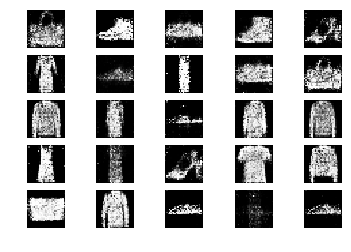

10701 [Discriminator loss: 0.651152, acc.: 67.19%] [Generator loss: 0.906572]
10702 [Discriminator loss: 0.556483, acc.: 76.56%] [Generator loss: 0.935325]
10703 [Discriminator loss: 0.685845, acc.: 56.25%] [Generator loss: 0.886561]
10704 [Discriminator loss: 0.681427, acc.: 60.94%] [Generator loss: 0.985279]
10705 [Discriminator loss: 0.566745, acc.: 71.88%] [Generator loss: 1.024824]
10706 [Discriminator loss: 0.656728, acc.: 60.94%] [Generator loss: 0.975656]
10707 [Discriminator loss: 0.654829, acc.: 62.50%] [Generator loss: 0.909688]
10708 [Discriminator loss: 0.703416, acc.: 51.56%] [Generator loss: 0.968236]
10709 [Discriminator loss: 0.705904, acc.: 56.25%] [Generator loss: 0.926943]
10710 [Discriminator loss: 0.644431, acc.: 64.06%] [Generator loss: 0.979382]
10711 [Discriminator loss: 0.585053, acc.: 75.00%] [Generator loss: 0.937642]
10712 [Discriminator loss: 0.727462, acc.: 51.56%] [Generator loss: 0.920311]
10713 [Discriminator loss: 0.607685, acc.: 67.19%] [Generator lo

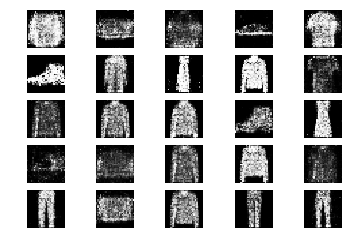

10801 [Discriminator loss: 0.644956, acc.: 65.62%] [Generator loss: 0.853287]
10802 [Discriminator loss: 0.624980, acc.: 67.19%] [Generator loss: 0.930805]
10803 [Discriminator loss: 0.737034, acc.: 51.56%] [Generator loss: 0.970634]
10804 [Discriminator loss: 0.655519, acc.: 71.88%] [Generator loss: 0.985593]
10805 [Discriminator loss: 0.665069, acc.: 56.25%] [Generator loss: 0.986473]
10806 [Discriminator loss: 0.654537, acc.: 64.06%] [Generator loss: 1.012272]
10807 [Discriminator loss: 0.701210, acc.: 56.25%] [Generator loss: 1.018658]
10808 [Discriminator loss: 0.692090, acc.: 56.25%] [Generator loss: 0.979779]
10809 [Discriminator loss: 0.637113, acc.: 65.62%] [Generator loss: 0.945918]
10810 [Discriminator loss: 0.653696, acc.: 62.50%] [Generator loss: 0.970271]
10811 [Discriminator loss: 0.612715, acc.: 71.88%] [Generator loss: 0.938567]
10812 [Discriminator loss: 0.591166, acc.: 65.62%] [Generator loss: 0.875430]
10813 [Discriminator loss: 0.663008, acc.: 57.81%] [Generator lo

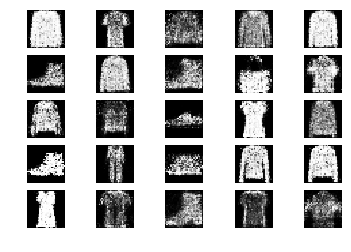

10901 [Discriminator loss: 0.670569, acc.: 57.81%] [Generator loss: 0.858202]
10902 [Discriminator loss: 0.627878, acc.: 67.19%] [Generator loss: 0.902030]
10903 [Discriminator loss: 0.653088, acc.: 57.81%] [Generator loss: 0.869026]
10904 [Discriminator loss: 0.605740, acc.: 78.12%] [Generator loss: 0.804823]
10905 [Discriminator loss: 0.669760, acc.: 53.12%] [Generator loss: 0.859684]
10906 [Discriminator loss: 0.635405, acc.: 68.75%] [Generator loss: 0.886516]
10907 [Discriminator loss: 0.639155, acc.: 59.38%] [Generator loss: 0.955197]
10908 [Discriminator loss: 0.720655, acc.: 48.44%] [Generator loss: 0.982111]
10909 [Discriminator loss: 0.626741, acc.: 65.62%] [Generator loss: 0.832445]
10910 [Discriminator loss: 0.654645, acc.: 57.81%] [Generator loss: 0.947326]
10911 [Discriminator loss: 0.620000, acc.: 57.81%] [Generator loss: 0.903315]
10912 [Discriminator loss: 0.601398, acc.: 65.62%] [Generator loss: 0.803274]
10913 [Discriminator loss: 0.652477, acc.: 59.38%] [Generator lo

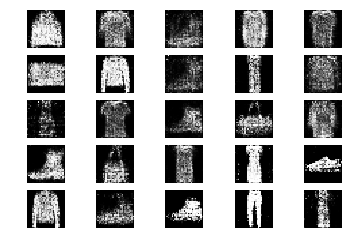

11001 [Discriminator loss: 0.668029, acc.: 57.81%] [Generator loss: 0.774108]
11002 [Discriminator loss: 0.591644, acc.: 75.00%] [Generator loss: 1.006753]
11003 [Discriminator loss: 0.723932, acc.: 53.12%] [Generator loss: 0.917152]
11004 [Discriminator loss: 0.667135, acc.: 57.81%] [Generator loss: 0.924595]
11005 [Discriminator loss: 0.685792, acc.: 57.81%] [Generator loss: 0.956739]
11006 [Discriminator loss: 0.646640, acc.: 60.94%] [Generator loss: 0.993533]
11007 [Discriminator loss: 0.668925, acc.: 62.50%] [Generator loss: 0.964783]
11008 [Discriminator loss: 0.611708, acc.: 65.62%] [Generator loss: 0.959219]
11009 [Discriminator loss: 0.666158, acc.: 56.25%] [Generator loss: 1.023461]
11010 [Discriminator loss: 0.624591, acc.: 65.62%] [Generator loss: 0.932661]
11011 [Discriminator loss: 0.716514, acc.: 53.12%] [Generator loss: 1.011539]
11012 [Discriminator loss: 0.628099, acc.: 62.50%] [Generator loss: 0.917797]
11013 [Discriminator loss: 0.701524, acc.: 50.00%] [Generator lo

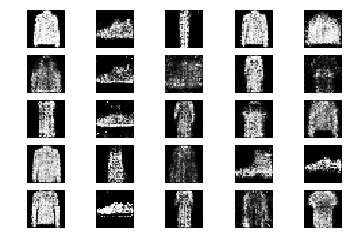

11101 [Discriminator loss: 0.616136, acc.: 65.62%] [Generator loss: 0.920778]
11102 [Discriminator loss: 0.663194, acc.: 54.69%] [Generator loss: 0.957018]
11103 [Discriminator loss: 0.621742, acc.: 65.62%] [Generator loss: 0.867777]
11104 [Discriminator loss: 0.698328, acc.: 59.38%] [Generator loss: 0.946209]
11105 [Discriminator loss: 0.652861, acc.: 60.94%] [Generator loss: 0.952669]
11106 [Discriminator loss: 0.719145, acc.: 53.12%] [Generator loss: 0.908340]
11107 [Discriminator loss: 0.659886, acc.: 59.38%] [Generator loss: 0.905923]
11108 [Discriminator loss: 0.678462, acc.: 60.94%] [Generator loss: 0.908252]
11109 [Discriminator loss: 0.632938, acc.: 64.06%] [Generator loss: 0.921431]
11110 [Discriminator loss: 0.666639, acc.: 59.38%] [Generator loss: 0.936621]
11111 [Discriminator loss: 0.599110, acc.: 71.88%] [Generator loss: 0.975908]
11112 [Discriminator loss: 0.674798, acc.: 60.94%] [Generator loss: 0.953845]
11113 [Discriminator loss: 0.632808, acc.: 57.81%] [Generator lo

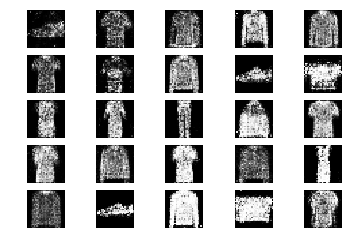

11201 [Discriminator loss: 0.675082, acc.: 54.69%] [Generator loss: 0.901508]
11202 [Discriminator loss: 0.641925, acc.: 68.75%] [Generator loss: 0.820090]
11203 [Discriminator loss: 0.646898, acc.: 59.38%] [Generator loss: 0.943827]
11204 [Discriminator loss: 0.695249, acc.: 64.06%] [Generator loss: 0.958420]
11205 [Discriminator loss: 0.768870, acc.: 51.56%] [Generator loss: 0.967244]
11206 [Discriminator loss: 0.678696, acc.: 56.25%] [Generator loss: 1.034949]
11207 [Discriminator loss: 0.667199, acc.: 53.12%] [Generator loss: 0.929922]
11208 [Discriminator loss: 0.662374, acc.: 56.25%] [Generator loss: 0.905681]
11209 [Discriminator loss: 0.650196, acc.: 64.06%] [Generator loss: 0.956247]
11210 [Discriminator loss: 0.647611, acc.: 70.31%] [Generator loss: 0.940380]
11211 [Discriminator loss: 0.631968, acc.: 65.62%] [Generator loss: 0.858802]
11212 [Discriminator loss: 0.622532, acc.: 67.19%] [Generator loss: 0.868876]
11213 [Discriminator loss: 0.664908, acc.: 54.69%] [Generator lo

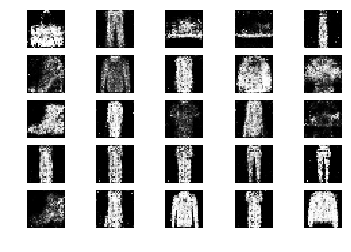

11301 [Discriminator loss: 0.668362, acc.: 57.81%] [Generator loss: 0.907923]
11302 [Discriminator loss: 0.585699, acc.: 79.69%] [Generator loss: 0.979115]
11303 [Discriminator loss: 0.647526, acc.: 59.38%] [Generator loss: 0.895038]
11304 [Discriminator loss: 0.599828, acc.: 68.75%] [Generator loss: 0.986885]
11305 [Discriminator loss: 0.629171, acc.: 60.94%] [Generator loss: 0.885394]
11306 [Discriminator loss: 0.673834, acc.: 57.81%] [Generator loss: 0.897789]
11307 [Discriminator loss: 0.641457, acc.: 70.31%] [Generator loss: 0.845012]
11308 [Discriminator loss: 0.695444, acc.: 56.25%] [Generator loss: 0.877594]
11309 [Discriminator loss: 0.689944, acc.: 59.38%] [Generator loss: 0.877501]
11310 [Discriminator loss: 0.684748, acc.: 60.94%] [Generator loss: 0.926938]
11311 [Discriminator loss: 0.638423, acc.: 56.25%] [Generator loss: 0.916584]
11312 [Discriminator loss: 0.677531, acc.: 57.81%] [Generator loss: 0.935852]
11313 [Discriminator loss: 0.615756, acc.: 67.19%] [Generator lo

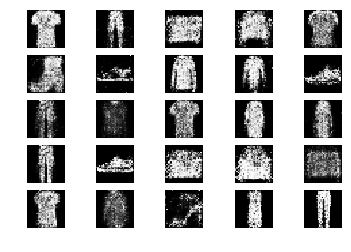

11401 [Discriminator loss: 0.679033, acc.: 59.38%] [Generator loss: 0.924055]
11402 [Discriminator loss: 0.633997, acc.: 62.50%] [Generator loss: 0.922043]
11403 [Discriminator loss: 0.660924, acc.: 56.25%] [Generator loss: 0.933153]
11404 [Discriminator loss: 0.592685, acc.: 73.44%] [Generator loss: 0.938690]
11405 [Discriminator loss: 0.603833, acc.: 68.75%] [Generator loss: 0.828723]
11406 [Discriminator loss: 0.591574, acc.: 65.62%] [Generator loss: 0.856216]
11407 [Discriminator loss: 0.681769, acc.: 59.38%] [Generator loss: 0.903662]
11408 [Discriminator loss: 0.695894, acc.: 56.25%] [Generator loss: 1.005576]
11409 [Discriminator loss: 0.554890, acc.: 73.44%] [Generator loss: 0.955754]
11410 [Discriminator loss: 0.614301, acc.: 70.31%] [Generator loss: 0.971535]
11411 [Discriminator loss: 0.657307, acc.: 59.38%] [Generator loss: 0.975880]
11412 [Discriminator loss: 0.640910, acc.: 60.94%] [Generator loss: 0.954048]
11413 [Discriminator loss: 0.601601, acc.: 65.62%] [Generator lo

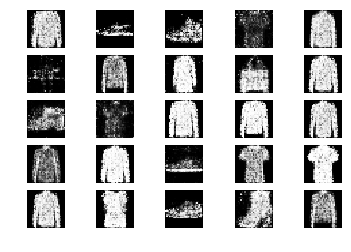

11501 [Discriminator loss: 0.608575, acc.: 62.50%] [Generator loss: 0.914281]
11502 [Discriminator loss: 0.697426, acc.: 51.56%] [Generator loss: 0.852372]
11503 [Discriminator loss: 0.653338, acc.: 62.50%] [Generator loss: 0.905965]
11504 [Discriminator loss: 0.689219, acc.: 43.75%] [Generator loss: 0.865227]
11505 [Discriminator loss: 0.688661, acc.: 54.69%] [Generator loss: 0.910515]
11506 [Discriminator loss: 0.648152, acc.: 59.38%] [Generator loss: 0.967923]
11507 [Discriminator loss: 0.663460, acc.: 56.25%] [Generator loss: 0.864587]
11508 [Discriminator loss: 0.654745, acc.: 60.94%] [Generator loss: 0.934175]
11509 [Discriminator loss: 0.673517, acc.: 59.38%] [Generator loss: 0.890570]
11510 [Discriminator loss: 0.655893, acc.: 56.25%] [Generator loss: 0.832303]
11511 [Discriminator loss: 0.651737, acc.: 67.19%] [Generator loss: 0.775266]
11512 [Discriminator loss: 0.645084, acc.: 54.69%] [Generator loss: 0.915000]
11513 [Discriminator loss: 0.664351, acc.: 62.50%] [Generator lo

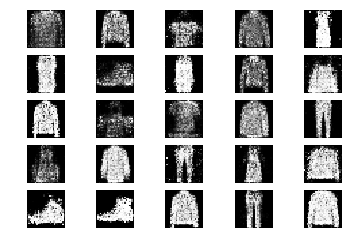

11601 [Discriminator loss: 0.632247, acc.: 64.06%] [Generator loss: 0.907565]
11602 [Discriminator loss: 0.620886, acc.: 64.06%] [Generator loss: 0.843682]
11603 [Discriminator loss: 0.635622, acc.: 62.50%] [Generator loss: 0.871774]
11604 [Discriminator loss: 0.664961, acc.: 57.81%] [Generator loss: 0.961419]
11605 [Discriminator loss: 0.653739, acc.: 56.25%] [Generator loss: 0.886327]
11606 [Discriminator loss: 0.788375, acc.: 42.19%] [Generator loss: 0.920014]
11607 [Discriminator loss: 0.666382, acc.: 67.19%] [Generator loss: 0.853007]
11608 [Discriminator loss: 0.633749, acc.: 60.94%] [Generator loss: 0.896844]
11609 [Discriminator loss: 0.526794, acc.: 78.12%] [Generator loss: 0.977705]
11610 [Discriminator loss: 0.687630, acc.: 59.38%] [Generator loss: 0.991745]
11611 [Discriminator loss: 0.645872, acc.: 64.06%] [Generator loss: 0.993340]
11612 [Discriminator loss: 0.687911, acc.: 54.69%] [Generator loss: 0.994758]
11613 [Discriminator loss: 0.631556, acc.: 65.62%] [Generator lo

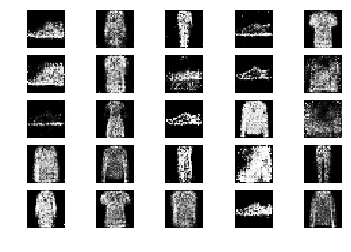

11701 [Discriminator loss: 0.701070, acc.: 50.00%] [Generator loss: 0.829167]
11702 [Discriminator loss: 0.647021, acc.: 56.25%] [Generator loss: 0.887213]
11703 [Discriminator loss: 0.683452, acc.: 57.81%] [Generator loss: 0.867407]
11704 [Discriminator loss: 0.633269, acc.: 62.50%] [Generator loss: 0.878148]
11705 [Discriminator loss: 0.607883, acc.: 68.75%] [Generator loss: 0.975489]
11706 [Discriminator loss: 0.656716, acc.: 67.19%] [Generator loss: 0.801891]
11707 [Discriminator loss: 0.642096, acc.: 59.38%] [Generator loss: 1.002333]
11708 [Discriminator loss: 0.660328, acc.: 62.50%] [Generator loss: 0.913697]
11709 [Discriminator loss: 0.676341, acc.: 62.50%] [Generator loss: 0.919654]
11710 [Discriminator loss: 0.715332, acc.: 60.94%] [Generator loss: 0.898286]
11711 [Discriminator loss: 0.595979, acc.: 67.19%] [Generator loss: 0.916671]
11712 [Discriminator loss: 0.673222, acc.: 60.94%] [Generator loss: 0.948532]
11713 [Discriminator loss: 0.607822, acc.: 64.06%] [Generator lo

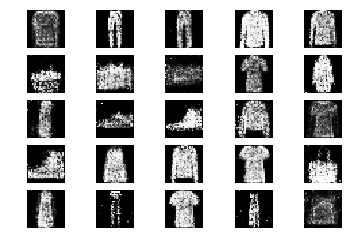

11801 [Discriminator loss: 0.623507, acc.: 68.75%] [Generator loss: 0.974038]
11802 [Discriminator loss: 0.602772, acc.: 67.19%] [Generator loss: 0.949337]
11803 [Discriminator loss: 0.635886, acc.: 64.06%] [Generator loss: 0.919668]
11804 [Discriminator loss: 0.656140, acc.: 59.38%] [Generator loss: 0.924804]
11805 [Discriminator loss: 0.701730, acc.: 56.25%] [Generator loss: 0.864067]
11806 [Discriminator loss: 0.678375, acc.: 57.81%] [Generator loss: 0.954164]
11807 [Discriminator loss: 0.640003, acc.: 53.12%] [Generator loss: 0.857962]
11808 [Discriminator loss: 0.613219, acc.: 67.19%] [Generator loss: 0.958832]
11809 [Discriminator loss: 0.594745, acc.: 73.44%] [Generator loss: 0.921343]
11810 [Discriminator loss: 0.697810, acc.: 50.00%] [Generator loss: 0.892288]
11811 [Discriminator loss: 0.665184, acc.: 59.38%] [Generator loss: 1.055462]
11812 [Discriminator loss: 0.651200, acc.: 62.50%] [Generator loss: 0.950532]
11813 [Discriminator loss: 0.707706, acc.: 48.44%] [Generator lo

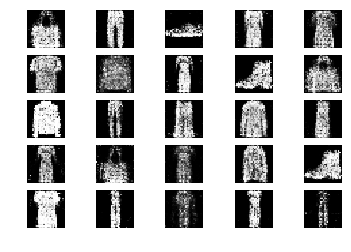

11901 [Discriminator loss: 0.682999, acc.: 60.94%] [Generator loss: 0.944531]
11902 [Discriminator loss: 0.644483, acc.: 71.88%] [Generator loss: 0.895406]
11903 [Discriminator loss: 0.642143, acc.: 67.19%] [Generator loss: 0.947423]
11904 [Discriminator loss: 0.637166, acc.: 64.06%] [Generator loss: 0.905755]
11905 [Discriminator loss: 0.656316, acc.: 59.38%] [Generator loss: 0.935468]
11906 [Discriminator loss: 0.622723, acc.: 68.75%] [Generator loss: 0.930596]
11907 [Discriminator loss: 0.588337, acc.: 68.75%] [Generator loss: 0.983680]
11908 [Discriminator loss: 0.662167, acc.: 59.38%] [Generator loss: 0.964694]
11909 [Discriminator loss: 0.618116, acc.: 65.62%] [Generator loss: 0.971323]
11910 [Discriminator loss: 0.659265, acc.: 64.06%] [Generator loss: 0.942574]
11911 [Discriminator loss: 0.635999, acc.: 60.94%] [Generator loss: 0.806492]
11912 [Discriminator loss: 0.655338, acc.: 56.25%] [Generator loss: 0.910488]
11913 [Discriminator loss: 0.602170, acc.: 70.31%] [Generator lo

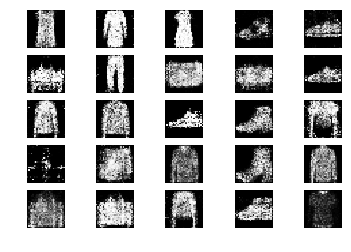

12001 [Discriminator loss: 0.638791, acc.: 62.50%] [Generator loss: 0.936880]
12002 [Discriminator loss: 0.630583, acc.: 65.62%] [Generator loss: 0.913494]
12003 [Discriminator loss: 0.600913, acc.: 67.19%] [Generator loss: 0.943912]
12004 [Discriminator loss: 0.639080, acc.: 62.50%] [Generator loss: 0.974617]
12005 [Discriminator loss: 0.690897, acc.: 51.56%] [Generator loss: 0.958046]
12006 [Discriminator loss: 0.646085, acc.: 65.62%] [Generator loss: 0.886002]
12007 [Discriminator loss: 0.763709, acc.: 53.12%] [Generator loss: 0.930165]
12008 [Discriminator loss: 0.675428, acc.: 51.56%] [Generator loss: 0.967619]
12009 [Discriminator loss: 0.674727, acc.: 64.06%] [Generator loss: 0.935746]
12010 [Discriminator loss: 0.644961, acc.: 64.06%] [Generator loss: 0.889848]
12011 [Discriminator loss: 0.613144, acc.: 71.88%] [Generator loss: 0.906983]
12012 [Discriminator loss: 0.679577, acc.: 54.69%] [Generator loss: 0.917296]
12013 [Discriminator loss: 0.700420, acc.: 54.69%] [Generator lo

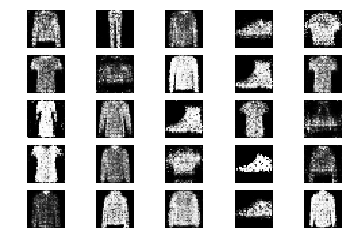

12101 [Discriminator loss: 0.770074, acc.: 42.19%] [Generator loss: 0.897301]
12102 [Discriminator loss: 0.685021, acc.: 53.12%] [Generator loss: 0.878133]
12103 [Discriminator loss: 0.683625, acc.: 57.81%] [Generator loss: 0.967553]
12104 [Discriminator loss: 0.664384, acc.: 59.38%] [Generator loss: 0.918590]
12105 [Discriminator loss: 0.666900, acc.: 59.38%] [Generator loss: 0.886253]
12106 [Discriminator loss: 0.649436, acc.: 54.69%] [Generator loss: 0.862563]
12107 [Discriminator loss: 0.628447, acc.: 65.62%] [Generator loss: 0.993544]
12108 [Discriminator loss: 0.662204, acc.: 54.69%] [Generator loss: 0.841094]
12109 [Discriminator loss: 0.615086, acc.: 65.62%] [Generator loss: 0.928593]
12110 [Discriminator loss: 0.667752, acc.: 51.56%] [Generator loss: 0.888784]
12111 [Discriminator loss: 0.657745, acc.: 64.06%] [Generator loss: 0.891163]
12112 [Discriminator loss: 0.640987, acc.: 65.62%] [Generator loss: 0.869822]
12113 [Discriminator loss: 0.649581, acc.: 62.50%] [Generator lo

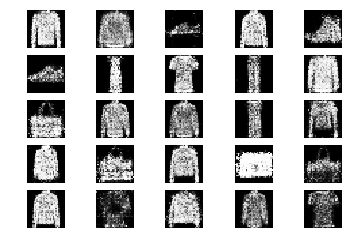

12201 [Discriminator loss: 0.675065, acc.: 54.69%] [Generator loss: 0.920100]
12202 [Discriminator loss: 0.655786, acc.: 60.94%] [Generator loss: 0.831412]
12203 [Discriminator loss: 0.671303, acc.: 60.94%] [Generator loss: 0.870148]
12204 [Discriminator loss: 0.670772, acc.: 54.69%] [Generator loss: 0.777454]
12205 [Discriminator loss: 0.673620, acc.: 54.69%] [Generator loss: 0.860431]
12206 [Discriminator loss: 0.684741, acc.: 64.06%] [Generator loss: 0.969104]
12207 [Discriminator loss: 0.615461, acc.: 67.19%] [Generator loss: 0.944574]
12208 [Discriminator loss: 0.659347, acc.: 57.81%] [Generator loss: 0.930467]
12209 [Discriminator loss: 0.647120, acc.: 57.81%] [Generator loss: 0.939896]
12210 [Discriminator loss: 0.672298, acc.: 60.94%] [Generator loss: 0.929794]
12211 [Discriminator loss: 0.688288, acc.: 53.12%] [Generator loss: 0.929065]
12212 [Discriminator loss: 0.707470, acc.: 57.81%] [Generator loss: 0.944960]
12213 [Discriminator loss: 0.617679, acc.: 64.06%] [Generator lo

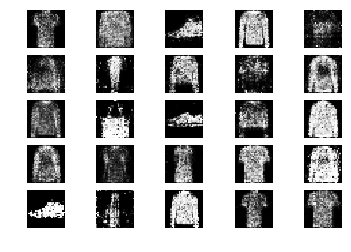

12301 [Discriminator loss: 0.667500, acc.: 59.38%] [Generator loss: 0.826034]
12302 [Discriminator loss: 0.601595, acc.: 73.44%] [Generator loss: 0.868150]
12303 [Discriminator loss: 0.691841, acc.: 54.69%] [Generator loss: 0.884879]
12304 [Discriminator loss: 0.606711, acc.: 70.31%] [Generator loss: 0.944456]
12305 [Discriminator loss: 0.600146, acc.: 70.31%] [Generator loss: 0.971720]
12306 [Discriminator loss: 0.640552, acc.: 59.38%] [Generator loss: 0.960149]
12307 [Discriminator loss: 0.669731, acc.: 54.69%] [Generator loss: 0.966122]
12308 [Discriminator loss: 0.657409, acc.: 65.62%] [Generator loss: 0.941571]
12309 [Discriminator loss: 0.685868, acc.: 51.56%] [Generator loss: 0.921212]
12310 [Discriminator loss: 0.699449, acc.: 50.00%] [Generator loss: 0.882579]
12311 [Discriminator loss: 0.667017, acc.: 50.00%] [Generator loss: 0.890879]
12312 [Discriminator loss: 0.685238, acc.: 57.81%] [Generator loss: 0.898287]
12313 [Discriminator loss: 0.729086, acc.: 53.12%] [Generator lo

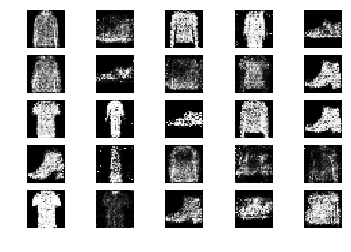

12401 [Discriminator loss: 0.592194, acc.: 76.56%] [Generator loss: 0.939206]
12402 [Discriminator loss: 0.645978, acc.: 56.25%] [Generator loss: 0.975565]
12403 [Discriminator loss: 0.629029, acc.: 64.06%] [Generator loss: 0.900837]
12404 [Discriminator loss: 0.694266, acc.: 53.12%] [Generator loss: 0.946217]
12405 [Discriminator loss: 0.618528, acc.: 68.75%] [Generator loss: 0.959085]
12406 [Discriminator loss: 0.702842, acc.: 50.00%] [Generator loss: 0.930158]
12407 [Discriminator loss: 0.647619, acc.: 62.50%] [Generator loss: 0.862782]
12408 [Discriminator loss: 0.669478, acc.: 59.38%] [Generator loss: 0.873994]
12409 [Discriminator loss: 0.698668, acc.: 54.69%] [Generator loss: 0.893316]
12410 [Discriminator loss: 0.645759, acc.: 65.62%] [Generator loss: 1.011217]
12411 [Discriminator loss: 0.665596, acc.: 62.50%] [Generator loss: 1.110064]
12412 [Discriminator loss: 0.656343, acc.: 62.50%] [Generator loss: 1.064628]
12413 [Discriminator loss: 0.690357, acc.: 53.12%] [Generator lo

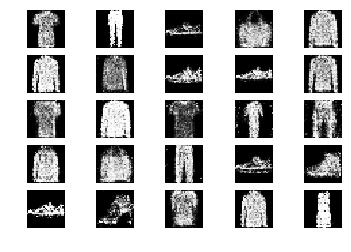

12501 [Discriminator loss: 0.622779, acc.: 57.81%] [Generator loss: 0.912027]
12502 [Discriminator loss: 0.649163, acc.: 57.81%] [Generator loss: 0.914586]
12503 [Discriminator loss: 0.612251, acc.: 71.88%] [Generator loss: 0.855851]
12504 [Discriminator loss: 0.638347, acc.: 62.50%] [Generator loss: 0.883746]
12505 [Discriminator loss: 0.681766, acc.: 62.50%] [Generator loss: 0.932502]
12506 [Discriminator loss: 0.603897, acc.: 67.19%] [Generator loss: 1.000767]
12507 [Discriminator loss: 0.672630, acc.: 57.81%] [Generator loss: 0.883197]
12508 [Discriminator loss: 0.679582, acc.: 51.56%] [Generator loss: 0.819333]
12509 [Discriminator loss: 0.650148, acc.: 64.06%] [Generator loss: 0.871154]
12510 [Discriminator loss: 0.738600, acc.: 51.56%] [Generator loss: 0.845555]
12511 [Discriminator loss: 0.632006, acc.: 59.38%] [Generator loss: 0.852443]
12512 [Discriminator loss: 0.689702, acc.: 59.38%] [Generator loss: 0.885415]
12513 [Discriminator loss: 0.694707, acc.: 60.94%] [Generator lo

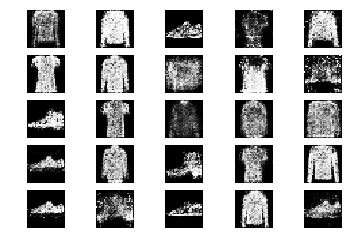

12601 [Discriminator loss: 0.604777, acc.: 68.75%] [Generator loss: 0.870934]
12602 [Discriminator loss: 0.645087, acc.: 62.50%] [Generator loss: 0.925325]
12603 [Discriminator loss: 0.698319, acc.: 56.25%] [Generator loss: 0.906753]
12604 [Discriminator loss: 0.611121, acc.: 64.06%] [Generator loss: 0.861498]
12605 [Discriminator loss: 0.663400, acc.: 62.50%] [Generator loss: 0.872924]
12606 [Discriminator loss: 0.695807, acc.: 57.81%] [Generator loss: 0.856126]
12607 [Discriminator loss: 0.632980, acc.: 68.75%] [Generator loss: 0.822527]
12608 [Discriminator loss: 0.727219, acc.: 53.12%] [Generator loss: 0.887323]
12609 [Discriminator loss: 0.700509, acc.: 62.50%] [Generator loss: 0.921444]
12610 [Discriminator loss: 0.597344, acc.: 67.19%] [Generator loss: 0.881692]
12611 [Discriminator loss: 0.644976, acc.: 62.50%] [Generator loss: 0.915321]
12612 [Discriminator loss: 0.670431, acc.: 60.94%] [Generator loss: 0.900417]
12613 [Discriminator loss: 0.704837, acc.: 54.69%] [Generator lo

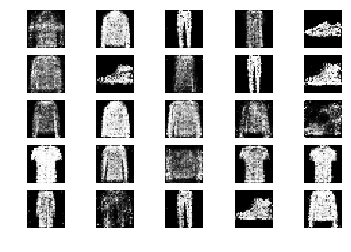

12701 [Discriminator loss: 0.658196, acc.: 56.25%] [Generator loss: 0.856024]
12702 [Discriminator loss: 0.636254, acc.: 62.50%] [Generator loss: 0.805884]
12703 [Discriminator loss: 0.653286, acc.: 64.06%] [Generator loss: 0.921248]
12704 [Discriminator loss: 0.618945, acc.: 65.62%] [Generator loss: 0.952520]
12705 [Discriminator loss: 0.583915, acc.: 71.88%] [Generator loss: 0.866497]
12706 [Discriminator loss: 0.631651, acc.: 64.06%] [Generator loss: 0.893828]
12707 [Discriminator loss: 0.545623, acc.: 76.56%] [Generator loss: 1.012528]
12708 [Discriminator loss: 0.670536, acc.: 54.69%] [Generator loss: 0.887171]
12709 [Discriminator loss: 0.738778, acc.: 53.12%] [Generator loss: 0.946516]
12710 [Discriminator loss: 0.661451, acc.: 64.06%] [Generator loss: 0.960159]
12711 [Discriminator loss: 0.685403, acc.: 54.69%] [Generator loss: 0.944599]
12712 [Discriminator loss: 0.606580, acc.: 68.75%] [Generator loss: 0.857003]
12713 [Discriminator loss: 0.596204, acc.: 70.31%] [Generator lo

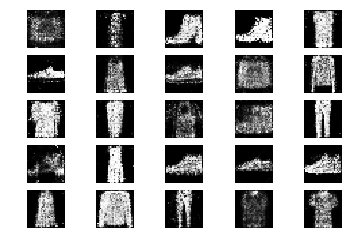

12801 [Discriminator loss: 0.719294, acc.: 51.56%] [Generator loss: 0.960469]
12802 [Discriminator loss: 0.658791, acc.: 59.38%] [Generator loss: 0.873777]
12803 [Discriminator loss: 0.659347, acc.: 62.50%] [Generator loss: 0.871099]
12804 [Discriminator loss: 0.654577, acc.: 59.38%] [Generator loss: 0.900494]
12805 [Discriminator loss: 0.662293, acc.: 60.94%] [Generator loss: 0.855626]
12806 [Discriminator loss: 0.615647, acc.: 59.38%] [Generator loss: 0.866931]
12807 [Discriminator loss: 0.681426, acc.: 50.00%] [Generator loss: 0.970953]
12808 [Discriminator loss: 0.605788, acc.: 68.75%] [Generator loss: 0.951928]
12809 [Discriminator loss: 0.677463, acc.: 62.50%] [Generator loss: 0.873505]
12810 [Discriminator loss: 0.654279, acc.: 62.50%] [Generator loss: 0.834047]
12811 [Discriminator loss: 0.639454, acc.: 68.75%] [Generator loss: 0.914458]
12812 [Discriminator loss: 0.695484, acc.: 51.56%] [Generator loss: 1.039708]
12813 [Discriminator loss: 0.617632, acc.: 65.62%] [Generator lo

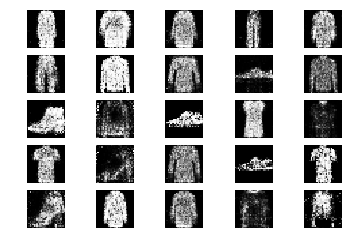

12901 [Discriminator loss: 0.685014, acc.: 60.94%] [Generator loss: 0.752173]
12902 [Discriminator loss: 0.626387, acc.: 62.50%] [Generator loss: 0.833793]
12903 [Discriminator loss: 0.569972, acc.: 73.44%] [Generator loss: 0.929515]
12904 [Discriminator loss: 0.636044, acc.: 65.62%] [Generator loss: 0.975446]
12905 [Discriminator loss: 0.624590, acc.: 60.94%] [Generator loss: 0.930780]
12906 [Discriminator loss: 0.615901, acc.: 64.06%] [Generator loss: 0.970502]
12907 [Discriminator loss: 0.693553, acc.: 50.00%] [Generator loss: 0.891958]
12908 [Discriminator loss: 0.592016, acc.: 70.31%] [Generator loss: 0.991786]
12909 [Discriminator loss: 0.658001, acc.: 59.38%] [Generator loss: 0.982381]
12910 [Discriminator loss: 0.711071, acc.: 51.56%] [Generator loss: 1.061180]
12911 [Discriminator loss: 0.642575, acc.: 64.06%] [Generator loss: 0.938766]
12912 [Discriminator loss: 0.704902, acc.: 50.00%] [Generator loss: 0.897350]
12913 [Discriminator loss: 0.657507, acc.: 59.38%] [Generator lo

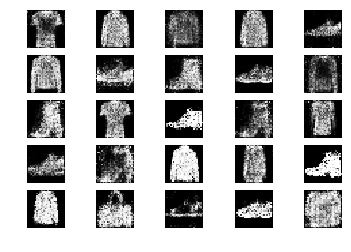

13001 [Discriminator loss: 0.648613, acc.: 64.06%] [Generator loss: 0.932373]
13002 [Discriminator loss: 0.639438, acc.: 62.50%] [Generator loss: 0.872748]
13003 [Discriminator loss: 0.627029, acc.: 62.50%] [Generator loss: 0.944136]
13004 [Discriminator loss: 0.607165, acc.: 65.62%] [Generator loss: 0.939858]
13005 [Discriminator loss: 0.657397, acc.: 65.62%] [Generator loss: 0.898996]
13006 [Discriminator loss: 0.708806, acc.: 54.69%] [Generator loss: 0.933634]
13007 [Discriminator loss: 0.668620, acc.: 64.06%] [Generator loss: 1.022653]
13008 [Discriminator loss: 0.624057, acc.: 67.19%] [Generator loss: 1.019233]
13009 [Discriminator loss: 0.658291, acc.: 57.81%] [Generator loss: 0.966021]
13010 [Discriminator loss: 0.664031, acc.: 60.94%] [Generator loss: 0.962036]
13011 [Discriminator loss: 0.698176, acc.: 48.44%] [Generator loss: 0.973281]
13012 [Discriminator loss: 0.684267, acc.: 57.81%] [Generator loss: 0.887827]
13013 [Discriminator loss: 0.653554, acc.: 60.94%] [Generator lo

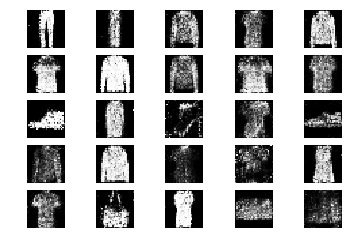

13101 [Discriminator loss: 0.603893, acc.: 71.88%] [Generator loss: 0.868100]
13102 [Discriminator loss: 0.673608, acc.: 56.25%] [Generator loss: 0.915686]
13103 [Discriminator loss: 0.605082, acc.: 64.06%] [Generator loss: 0.858766]
13104 [Discriminator loss: 0.695194, acc.: 53.12%] [Generator loss: 0.888627]
13105 [Discriminator loss: 0.646884, acc.: 65.62%] [Generator loss: 0.915487]
13106 [Discriminator loss: 0.653094, acc.: 64.06%] [Generator loss: 0.864952]
13107 [Discriminator loss: 0.685927, acc.: 57.81%] [Generator loss: 0.965525]
13108 [Discriminator loss: 0.684072, acc.: 60.94%] [Generator loss: 0.922585]
13109 [Discriminator loss: 0.608421, acc.: 65.62%] [Generator loss: 0.981604]
13110 [Discriminator loss: 0.676751, acc.: 59.38%] [Generator loss: 0.965435]
13111 [Discriminator loss: 0.597017, acc.: 68.75%] [Generator loss: 0.819040]
13112 [Discriminator loss: 0.719905, acc.: 50.00%] [Generator loss: 0.804898]
13113 [Discriminator loss: 0.709653, acc.: 53.12%] [Generator lo

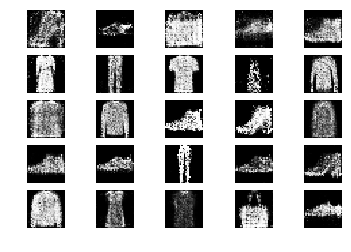

13201 [Discriminator loss: 0.626227, acc.: 67.19%] [Generator loss: 1.002335]
13202 [Discriminator loss: 0.679198, acc.: 62.50%] [Generator loss: 0.965769]
13203 [Discriminator loss: 0.691476, acc.: 57.81%] [Generator loss: 0.941773]
13204 [Discriminator loss: 0.654537, acc.: 59.38%] [Generator loss: 0.934313]
13205 [Discriminator loss: 0.710379, acc.: 45.31%] [Generator loss: 0.849822]
13206 [Discriminator loss: 0.708644, acc.: 53.12%] [Generator loss: 0.938006]
13207 [Discriminator loss: 0.695337, acc.: 59.38%] [Generator loss: 0.952506]
13208 [Discriminator loss: 0.621382, acc.: 64.06%] [Generator loss: 1.006169]
13209 [Discriminator loss: 0.659884, acc.: 60.94%] [Generator loss: 0.930740]
13210 [Discriminator loss: 0.697358, acc.: 56.25%] [Generator loss: 0.926444]
13211 [Discriminator loss: 0.635853, acc.: 68.75%] [Generator loss: 0.952553]
13212 [Discriminator loss: 0.664651, acc.: 57.81%] [Generator loss: 0.869505]
13213 [Discriminator loss: 0.576894, acc.: 70.31%] [Generator lo

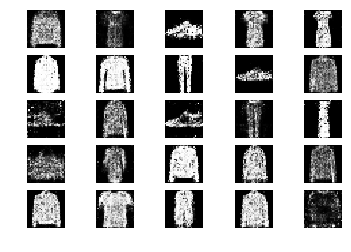

13301 [Discriminator loss: 0.650130, acc.: 67.19%] [Generator loss: 0.913186]
13302 [Discriminator loss: 0.642653, acc.: 64.06%] [Generator loss: 1.080802]
13303 [Discriminator loss: 0.656542, acc.: 56.25%] [Generator loss: 0.918087]
13304 [Discriminator loss: 0.733393, acc.: 46.88%] [Generator loss: 0.835260]
13305 [Discriminator loss: 0.707421, acc.: 50.00%] [Generator loss: 0.760432]
13306 [Discriminator loss: 0.655701, acc.: 62.50%] [Generator loss: 0.884329]
13307 [Discriminator loss: 0.635509, acc.: 62.50%] [Generator loss: 0.963832]
13308 [Discriminator loss: 0.673999, acc.: 54.69%] [Generator loss: 0.895468]
13309 [Discriminator loss: 0.621057, acc.: 67.19%] [Generator loss: 0.898615]
13310 [Discriminator loss: 0.660788, acc.: 53.12%] [Generator loss: 0.834878]
13311 [Discriminator loss: 0.586138, acc.: 70.31%] [Generator loss: 0.910067]
13312 [Discriminator loss: 0.691063, acc.: 59.38%] [Generator loss: 0.916865]
13313 [Discriminator loss: 0.685373, acc.: 60.94%] [Generator lo

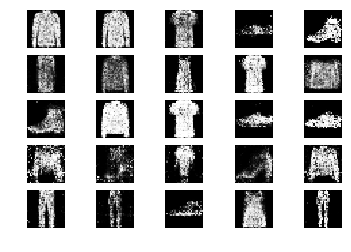

13401 [Discriminator loss: 0.691258, acc.: 56.25%] [Generator loss: 0.851609]
13402 [Discriminator loss: 0.640532, acc.: 67.19%] [Generator loss: 0.919509]
13403 [Discriminator loss: 0.679459, acc.: 57.81%] [Generator loss: 1.013779]
13404 [Discriminator loss: 0.643928, acc.: 71.88%] [Generator loss: 0.959174]
13405 [Discriminator loss: 0.628866, acc.: 68.75%] [Generator loss: 0.993861]
13406 [Discriminator loss: 0.684517, acc.: 53.12%] [Generator loss: 0.889653]
13407 [Discriminator loss: 0.671531, acc.: 50.00%] [Generator loss: 0.847703]
13408 [Discriminator loss: 0.679438, acc.: 56.25%] [Generator loss: 0.958610]
13409 [Discriminator loss: 0.644080, acc.: 62.50%] [Generator loss: 0.902206]
13410 [Discriminator loss: 0.629526, acc.: 62.50%] [Generator loss: 0.945985]
13411 [Discriminator loss: 0.707912, acc.: 51.56%] [Generator loss: 1.015880]
13412 [Discriminator loss: 0.644471, acc.: 56.25%] [Generator loss: 0.998446]
13413 [Discriminator loss: 0.619396, acc.: 67.19%] [Generator lo

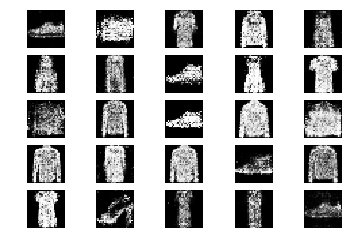

13501 [Discriminator loss: 0.695397, acc.: 62.50%] [Generator loss: 0.888897]
13502 [Discriminator loss: 0.731020, acc.: 54.69%] [Generator loss: 0.936120]
13503 [Discriminator loss: 0.598145, acc.: 65.62%] [Generator loss: 0.985948]
13504 [Discriminator loss: 0.659846, acc.: 62.50%] [Generator loss: 0.863549]
13505 [Discriminator loss: 0.700836, acc.: 51.56%] [Generator loss: 0.798357]
13506 [Discriminator loss: 0.683416, acc.: 53.12%] [Generator loss: 0.874765]
13507 [Discriminator loss: 0.665102, acc.: 59.38%] [Generator loss: 0.880865]
13508 [Discriminator loss: 0.612601, acc.: 68.75%] [Generator loss: 0.847056]
13509 [Discriminator loss: 0.582059, acc.: 73.44%] [Generator loss: 0.927413]
13510 [Discriminator loss: 0.653809, acc.: 64.06%] [Generator loss: 0.995873]
13511 [Discriminator loss: 0.680496, acc.: 59.38%] [Generator loss: 0.935112]
13512 [Discriminator loss: 0.658250, acc.: 64.06%] [Generator loss: 0.851835]
13513 [Discriminator loss: 0.714693, acc.: 53.12%] [Generator lo

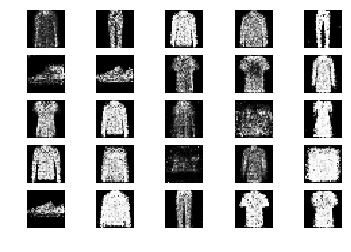

13601 [Discriminator loss: 0.611731, acc.: 67.19%] [Generator loss: 0.872223]
13602 [Discriminator loss: 0.697878, acc.: 53.12%] [Generator loss: 0.871106]
13603 [Discriminator loss: 0.652025, acc.: 53.12%] [Generator loss: 0.895454]
13604 [Discriminator loss: 0.691244, acc.: 64.06%] [Generator loss: 0.908979]
13605 [Discriminator loss: 0.666077, acc.: 57.81%] [Generator loss: 0.911707]
13606 [Discriminator loss: 0.691027, acc.: 51.56%] [Generator loss: 1.034879]
13607 [Discriminator loss: 0.695756, acc.: 59.38%] [Generator loss: 0.937092]
13608 [Discriminator loss: 0.669809, acc.: 57.81%] [Generator loss: 0.907078]
13609 [Discriminator loss: 0.707666, acc.: 51.56%] [Generator loss: 0.968085]
13610 [Discriminator loss: 0.586384, acc.: 70.31%] [Generator loss: 0.987349]
13611 [Discriminator loss: 0.615170, acc.: 64.06%] [Generator loss: 0.955887]
13612 [Discriminator loss: 0.660636, acc.: 62.50%] [Generator loss: 0.796476]
13613 [Discriminator loss: 0.616787, acc.: 75.00%] [Generator lo

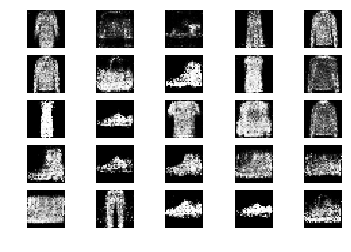

13701 [Discriminator loss: 0.697407, acc.: 59.38%] [Generator loss: 0.838390]
13702 [Discriminator loss: 0.622902, acc.: 62.50%] [Generator loss: 0.782273]
13703 [Discriminator loss: 0.621546, acc.: 67.19%] [Generator loss: 0.877520]
13704 [Discriminator loss: 0.664739, acc.: 67.19%] [Generator loss: 0.905919]
13705 [Discriminator loss: 0.658823, acc.: 62.50%] [Generator loss: 0.906021]
13706 [Discriminator loss: 0.630875, acc.: 57.81%] [Generator loss: 0.807864]
13707 [Discriminator loss: 0.670810, acc.: 62.50%] [Generator loss: 0.925842]
13708 [Discriminator loss: 0.642064, acc.: 57.81%] [Generator loss: 0.919435]
13709 [Discriminator loss: 0.594125, acc.: 67.19%] [Generator loss: 1.064902]
13710 [Discriminator loss: 0.634219, acc.: 57.81%] [Generator loss: 0.955766]
13711 [Discriminator loss: 0.719516, acc.: 56.25%] [Generator loss: 0.830874]
13712 [Discriminator loss: 0.570329, acc.: 71.88%] [Generator loss: 0.836822]
13713 [Discriminator loss: 0.563018, acc.: 76.56%] [Generator lo

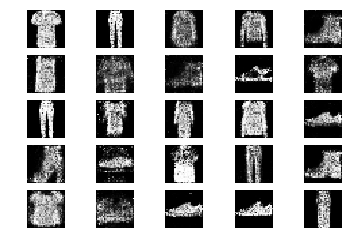

13801 [Discriminator loss: 0.683536, acc.: 54.69%] [Generator loss: 0.969716]
13802 [Discriminator loss: 0.689856, acc.: 51.56%] [Generator loss: 0.883053]
13803 [Discriminator loss: 0.639513, acc.: 62.50%] [Generator loss: 0.887752]
13804 [Discriminator loss: 0.654672, acc.: 59.38%] [Generator loss: 0.817798]
13805 [Discriminator loss: 0.615288, acc.: 70.31%] [Generator loss: 0.873046]
13806 [Discriminator loss: 0.648166, acc.: 56.25%] [Generator loss: 0.849846]
13807 [Discriminator loss: 0.657098, acc.: 56.25%] [Generator loss: 0.923475]
13808 [Discriminator loss: 0.579461, acc.: 73.44%] [Generator loss: 0.943721]
13809 [Discriminator loss: 0.607358, acc.: 65.62%] [Generator loss: 1.007931]
13810 [Discriminator loss: 0.651601, acc.: 67.19%] [Generator loss: 0.910700]
13811 [Discriminator loss: 0.680279, acc.: 57.81%] [Generator loss: 0.985222]
13812 [Discriminator loss: 0.640577, acc.: 59.38%] [Generator loss: 0.907593]
13813 [Discriminator loss: 0.663467, acc.: 54.69%] [Generator lo

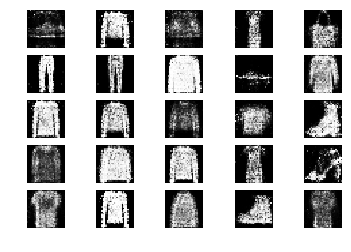

13901 [Discriminator loss: 0.620101, acc.: 68.75%] [Generator loss: 0.896218]
13902 [Discriminator loss: 0.647555, acc.: 59.38%] [Generator loss: 0.948270]
13903 [Discriminator loss: 0.645157, acc.: 68.75%] [Generator loss: 0.925241]
13904 [Discriminator loss: 0.640473, acc.: 60.94%] [Generator loss: 0.892951]
13905 [Discriminator loss: 0.651132, acc.: 68.75%] [Generator loss: 0.936762]
13906 [Discriminator loss: 0.730784, acc.: 50.00%] [Generator loss: 0.906489]
13907 [Discriminator loss: 0.664056, acc.: 59.38%] [Generator loss: 0.933971]
13908 [Discriminator loss: 0.683898, acc.: 50.00%] [Generator loss: 0.917538]
13909 [Discriminator loss: 0.703763, acc.: 53.12%] [Generator loss: 0.932073]
13910 [Discriminator loss: 0.633586, acc.: 68.75%] [Generator loss: 1.030249]
13911 [Discriminator loss: 0.619956, acc.: 70.31%] [Generator loss: 1.013945]
13912 [Discriminator loss: 0.660100, acc.: 60.94%] [Generator loss: 1.016831]
13913 [Discriminator loss: 0.606490, acc.: 59.38%] [Generator lo

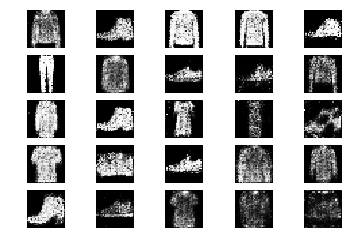

14001 [Discriminator loss: 0.612321, acc.: 68.75%] [Generator loss: 0.920912]
14002 [Discriminator loss: 0.676640, acc.: 59.38%] [Generator loss: 0.861601]
14003 [Discriminator loss: 0.646151, acc.: 64.06%] [Generator loss: 0.944259]
14004 [Discriminator loss: 0.631112, acc.: 62.50%] [Generator loss: 0.937048]
14005 [Discriminator loss: 0.632242, acc.: 67.19%] [Generator loss: 0.834520]
14006 [Discriminator loss: 0.682810, acc.: 56.25%] [Generator loss: 0.868694]
14007 [Discriminator loss: 0.674083, acc.: 57.81%] [Generator loss: 0.862426]
14008 [Discriminator loss: 0.661179, acc.: 56.25%] [Generator loss: 1.006295]
14009 [Discriminator loss: 0.662661, acc.: 57.81%] [Generator loss: 0.983023]
14010 [Discriminator loss: 0.638778, acc.: 59.38%] [Generator loss: 1.022029]
14011 [Discriminator loss: 0.685420, acc.: 60.94%] [Generator loss: 0.930561]
14012 [Discriminator loss: 0.628825, acc.: 60.94%] [Generator loss: 0.998237]
14013 [Discriminator loss: 0.666165, acc.: 54.69%] [Generator lo

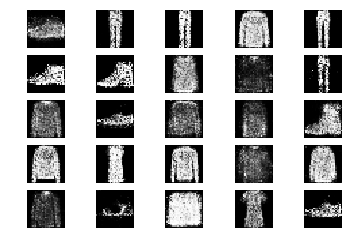

14101 [Discriminator loss: 0.610310, acc.: 65.62%] [Generator loss: 1.013275]
14102 [Discriminator loss: 0.664885, acc.: 54.69%] [Generator loss: 0.830623]
14103 [Discriminator loss: 0.635856, acc.: 67.19%] [Generator loss: 0.880020]
14104 [Discriminator loss: 0.649090, acc.: 62.50%] [Generator loss: 0.941427]
14105 [Discriminator loss: 0.634038, acc.: 62.50%] [Generator loss: 0.915307]
14106 [Discriminator loss: 0.642805, acc.: 67.19%] [Generator loss: 0.974826]
14107 [Discriminator loss: 0.671564, acc.: 48.44%] [Generator loss: 0.923703]
14108 [Discriminator loss: 0.605236, acc.: 70.31%] [Generator loss: 0.908525]
14109 [Discriminator loss: 0.674387, acc.: 64.06%] [Generator loss: 0.884863]
14110 [Discriminator loss: 0.672957, acc.: 59.38%] [Generator loss: 0.956444]
14111 [Discriminator loss: 0.685424, acc.: 62.50%] [Generator loss: 0.959049]
14112 [Discriminator loss: 0.655362, acc.: 62.50%] [Generator loss: 0.919704]
14113 [Discriminator loss: 0.665380, acc.: 56.25%] [Generator lo

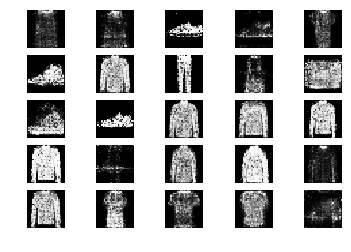

14201 [Discriminator loss: 0.613759, acc.: 64.06%] [Generator loss: 0.892695]
14202 [Discriminator loss: 0.638262, acc.: 60.94%] [Generator loss: 0.977659]
14203 [Discriminator loss: 0.627698, acc.: 70.31%] [Generator loss: 1.010173]
14204 [Discriminator loss: 0.582830, acc.: 65.62%] [Generator loss: 0.985430]
14205 [Discriminator loss: 0.632479, acc.: 65.62%] [Generator loss: 0.968439]
14206 [Discriminator loss: 0.640899, acc.: 67.19%] [Generator loss: 0.977187]
14207 [Discriminator loss: 0.734176, acc.: 50.00%] [Generator loss: 0.935897]
14208 [Discriminator loss: 0.669822, acc.: 56.25%] [Generator loss: 0.856938]
14209 [Discriminator loss: 0.620959, acc.: 68.75%] [Generator loss: 0.807570]
14210 [Discriminator loss: 0.638340, acc.: 59.38%] [Generator loss: 0.964299]
14211 [Discriminator loss: 0.664348, acc.: 62.50%] [Generator loss: 0.977607]
14212 [Discriminator loss: 0.602331, acc.: 71.88%] [Generator loss: 0.853426]
14213 [Discriminator loss: 0.720307, acc.: 56.25%] [Generator lo

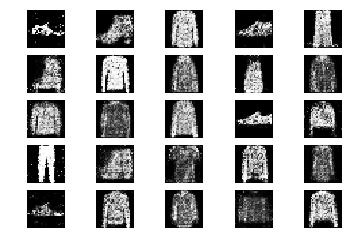

14301 [Discriminator loss: 0.671843, acc.: 65.62%] [Generator loss: 0.991364]
14302 [Discriminator loss: 0.635178, acc.: 68.75%] [Generator loss: 0.983803]
14303 [Discriminator loss: 0.671775, acc.: 59.38%] [Generator loss: 0.975269]
14304 [Discriminator loss: 0.666187, acc.: 62.50%] [Generator loss: 0.962575]
14305 [Discriminator loss: 0.657777, acc.: 62.50%] [Generator loss: 0.851319]
14306 [Discriminator loss: 0.627068, acc.: 68.75%] [Generator loss: 0.911080]
14307 [Discriminator loss: 0.653500, acc.: 67.19%] [Generator loss: 0.853351]
14308 [Discriminator loss: 0.650578, acc.: 60.94%] [Generator loss: 0.814291]
14309 [Discriminator loss: 0.640389, acc.: 62.50%] [Generator loss: 0.891109]
14310 [Discriminator loss: 0.641943, acc.: 60.94%] [Generator loss: 0.973466]
14311 [Discriminator loss: 0.630293, acc.: 64.06%] [Generator loss: 0.929192]
14312 [Discriminator loss: 0.633551, acc.: 65.62%] [Generator loss: 0.822173]
14313 [Discriminator loss: 0.673656, acc.: 59.38%] [Generator lo

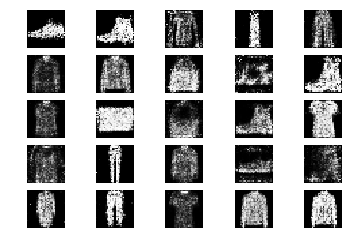

14401 [Discriminator loss: 0.630216, acc.: 65.62%] [Generator loss: 0.929644]
14402 [Discriminator loss: 0.653999, acc.: 59.38%] [Generator loss: 0.927261]
14403 [Discriminator loss: 0.664531, acc.: 59.38%] [Generator loss: 0.946946]
14404 [Discriminator loss: 0.682772, acc.: 59.38%] [Generator loss: 0.891988]
14405 [Discriminator loss: 0.667427, acc.: 64.06%] [Generator loss: 0.888178]
14406 [Discriminator loss: 0.648589, acc.: 62.50%] [Generator loss: 0.875298]
14407 [Discriminator loss: 0.674499, acc.: 59.38%] [Generator loss: 1.009139]
14408 [Discriminator loss: 0.659793, acc.: 54.69%] [Generator loss: 0.981728]
14409 [Discriminator loss: 0.615512, acc.: 70.31%] [Generator loss: 0.839757]
14410 [Discriminator loss: 0.786291, acc.: 40.62%] [Generator loss: 0.923065]
14411 [Discriminator loss: 0.663524, acc.: 59.38%] [Generator loss: 0.875435]
14412 [Discriminator loss: 0.633664, acc.: 60.94%] [Generator loss: 0.935173]
14413 [Discriminator loss: 0.594891, acc.: 71.88%] [Generator lo

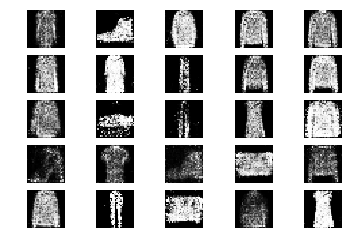

14501 [Discriminator loss: 0.706005, acc.: 53.12%] [Generator loss: 0.932112]
14502 [Discriminator loss: 0.687791, acc.: 54.69%] [Generator loss: 0.944106]
14503 [Discriminator loss: 0.663696, acc.: 56.25%] [Generator loss: 0.961182]
14504 [Discriminator loss: 0.701124, acc.: 59.38%] [Generator loss: 0.898576]
14505 [Discriminator loss: 0.705613, acc.: 53.12%] [Generator loss: 0.911580]
14506 [Discriminator loss: 0.617388, acc.: 59.38%] [Generator loss: 0.903517]
14507 [Discriminator loss: 0.724779, acc.: 46.88%] [Generator loss: 0.988629]
14508 [Discriminator loss: 0.636013, acc.: 65.62%] [Generator loss: 1.036419]
14509 [Discriminator loss: 0.634100, acc.: 65.62%] [Generator loss: 0.905124]
14510 [Discriminator loss: 0.642925, acc.: 64.06%] [Generator loss: 0.873409]
14511 [Discriminator loss: 0.588690, acc.: 67.19%] [Generator loss: 0.881947]
14512 [Discriminator loss: 0.698398, acc.: 59.38%] [Generator loss: 0.957256]
14513 [Discriminator loss: 0.617387, acc.: 59.38%] [Generator lo

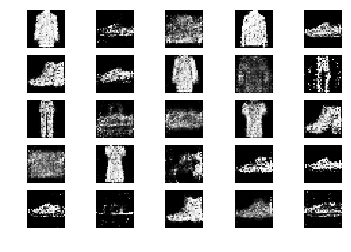

14601 [Discriminator loss: 0.672256, acc.: 54.69%] [Generator loss: 0.965710]
14602 [Discriminator loss: 0.685687, acc.: 54.69%] [Generator loss: 1.012764]
14603 [Discriminator loss: 0.705552, acc.: 57.81%] [Generator loss: 0.921578]
14604 [Discriminator loss: 0.640489, acc.: 65.62%] [Generator loss: 0.957650]
14605 [Discriminator loss: 0.627023, acc.: 56.25%] [Generator loss: 0.915703]
14606 [Discriminator loss: 0.624237, acc.: 68.75%] [Generator loss: 0.838613]
14607 [Discriminator loss: 0.667159, acc.: 57.81%] [Generator loss: 0.757277]
14608 [Discriminator loss: 0.682775, acc.: 54.69%] [Generator loss: 0.840979]
14609 [Discriminator loss: 0.706290, acc.: 53.12%] [Generator loss: 0.870901]
14610 [Discriminator loss: 0.655889, acc.: 59.38%] [Generator loss: 0.922338]
14611 [Discriminator loss: 0.640425, acc.: 68.75%] [Generator loss: 0.847248]
14612 [Discriminator loss: 0.653584, acc.: 56.25%] [Generator loss: 0.891513]
14613 [Discriminator loss: 0.654644, acc.: 68.75%] [Generator lo

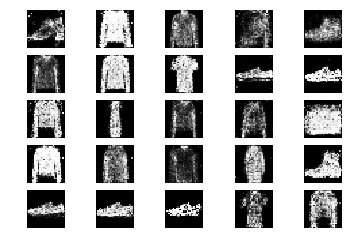

14701 [Discriminator loss: 0.644789, acc.: 65.62%] [Generator loss: 0.834934]
14702 [Discriminator loss: 0.680935, acc.: 54.69%] [Generator loss: 0.913784]
14703 [Discriminator loss: 0.630251, acc.: 64.06%] [Generator loss: 0.886279]
14704 [Discriminator loss: 0.666256, acc.: 51.56%] [Generator loss: 0.906555]
14705 [Discriminator loss: 0.654463, acc.: 64.06%] [Generator loss: 0.923037]
14706 [Discriminator loss: 0.642678, acc.: 57.81%] [Generator loss: 0.870222]
14707 [Discriminator loss: 0.658013, acc.: 67.19%] [Generator loss: 0.837863]
14708 [Discriminator loss: 0.616735, acc.: 67.19%] [Generator loss: 0.984976]
14709 [Discriminator loss: 0.611035, acc.: 70.31%] [Generator loss: 0.931182]
14710 [Discriminator loss: 0.614232, acc.: 64.06%] [Generator loss: 0.944418]
14711 [Discriminator loss: 0.718977, acc.: 53.12%] [Generator loss: 0.811578]
14712 [Discriminator loss: 0.639675, acc.: 65.62%] [Generator loss: 0.837634]
14713 [Discriminator loss: 0.714363, acc.: 53.12%] [Generator lo

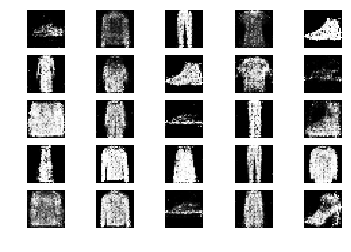

14801 [Discriminator loss: 0.680588, acc.: 64.06%] [Generator loss: 0.946116]
14802 [Discriminator loss: 0.656979, acc.: 64.06%] [Generator loss: 0.952578]
14803 [Discriminator loss: 0.702073, acc.: 56.25%] [Generator loss: 0.896102]
14804 [Discriminator loss: 0.663426, acc.: 56.25%] [Generator loss: 1.015853]
14805 [Discriminator loss: 0.601271, acc.: 65.62%] [Generator loss: 0.901807]
14806 [Discriminator loss: 0.672025, acc.: 54.69%] [Generator loss: 0.973220]
14807 [Discriminator loss: 0.581698, acc.: 73.44%] [Generator loss: 0.892438]
14808 [Discriminator loss: 0.714574, acc.: 53.12%] [Generator loss: 0.926856]
14809 [Discriminator loss: 0.664266, acc.: 59.38%] [Generator loss: 1.001424]
14810 [Discriminator loss: 0.636416, acc.: 56.25%] [Generator loss: 0.822400]
14811 [Discriminator loss: 0.615408, acc.: 68.75%] [Generator loss: 0.979201]
14812 [Discriminator loss: 0.649258, acc.: 60.94%] [Generator loss: 0.968539]
14813 [Discriminator loss: 0.636650, acc.: 62.50%] [Generator lo

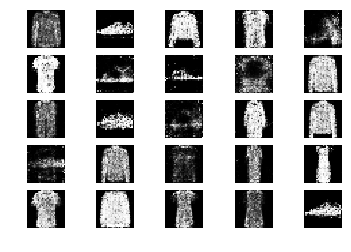

14901 [Discriminator loss: 0.669785, acc.: 67.19%] [Generator loss: 0.949369]
14902 [Discriminator loss: 0.696544, acc.: 57.81%] [Generator loss: 0.952443]
14903 [Discriminator loss: 0.660843, acc.: 64.06%] [Generator loss: 0.888198]
14904 [Discriminator loss: 0.654379, acc.: 64.06%] [Generator loss: 0.898426]
14905 [Discriminator loss: 0.629543, acc.: 71.88%] [Generator loss: 0.970267]
14906 [Discriminator loss: 0.614208, acc.: 67.19%] [Generator loss: 0.856521]
14907 [Discriminator loss: 0.759419, acc.: 50.00%] [Generator loss: 0.861203]
14908 [Discriminator loss: 0.623158, acc.: 60.94%] [Generator loss: 0.888587]
14909 [Discriminator loss: 0.602905, acc.: 71.88%] [Generator loss: 0.990605]
14910 [Discriminator loss: 0.588646, acc.: 70.31%] [Generator loss: 0.904814]
14911 [Discriminator loss: 0.589886, acc.: 65.62%] [Generator loss: 0.919898]
14912 [Discriminator loss: 0.610218, acc.: 53.12%] [Generator loss: 1.001722]
14913 [Discriminator loss: 0.642075, acc.: 60.94%] [Generator lo

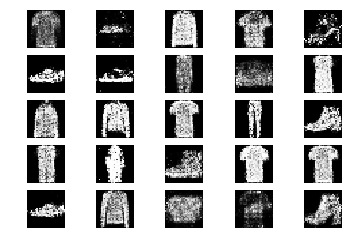

15001 [Discriminator loss: 0.669899, acc.: 56.25%] [Generator loss: 0.913211]
15002 [Discriminator loss: 0.552307, acc.: 70.31%] [Generator loss: 0.922947]
15003 [Discriminator loss: 0.659602, acc.: 65.62%] [Generator loss: 0.926778]
15004 [Discriminator loss: 0.628290, acc.: 65.62%] [Generator loss: 0.977263]
15005 [Discriminator loss: 0.648303, acc.: 60.94%] [Generator loss: 0.988061]
15006 [Discriminator loss: 0.682016, acc.: 54.69%] [Generator loss: 0.989176]
15007 [Discriminator loss: 0.631734, acc.: 67.19%] [Generator loss: 0.883709]
15008 [Discriminator loss: 0.618582, acc.: 64.06%] [Generator loss: 0.988100]
15009 [Discriminator loss: 0.635152, acc.: 67.19%] [Generator loss: 0.859988]
15010 [Discriminator loss: 0.630853, acc.: 60.94%] [Generator loss: 0.827463]
15011 [Discriminator loss: 0.667466, acc.: 57.81%] [Generator loss: 0.919049]
15012 [Discriminator loss: 0.723801, acc.: 45.31%] [Generator loss: 0.988065]
15013 [Discriminator loss: 0.634277, acc.: 68.75%] [Generator lo

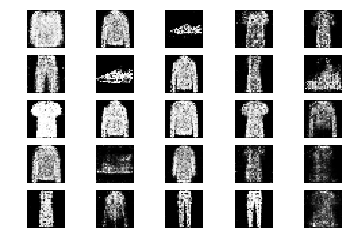

15101 [Discriminator loss: 0.598674, acc.: 78.12%] [Generator loss: 1.005688]
15102 [Discriminator loss: 0.596651, acc.: 62.50%] [Generator loss: 0.939789]
15103 [Discriminator loss: 0.699818, acc.: 54.69%] [Generator loss: 0.913290]
15104 [Discriminator loss: 0.643036, acc.: 67.19%] [Generator loss: 0.952088]
15105 [Discriminator loss: 0.725531, acc.: 57.81%] [Generator loss: 0.892911]
15106 [Discriminator loss: 0.615564, acc.: 59.38%] [Generator loss: 0.870815]
15107 [Discriminator loss: 0.647085, acc.: 64.06%] [Generator loss: 0.912534]
15108 [Discriminator loss: 0.663795, acc.: 64.06%] [Generator loss: 0.822894]
15109 [Discriminator loss: 0.617919, acc.: 62.50%] [Generator loss: 0.963162]
15110 [Discriminator loss: 0.664596, acc.: 67.19%] [Generator loss: 1.012225]
15111 [Discriminator loss: 0.672324, acc.: 57.81%] [Generator loss: 0.915956]
15112 [Discriminator loss: 0.611662, acc.: 64.06%] [Generator loss: 0.892742]
15113 [Discriminator loss: 0.704351, acc.: 53.12%] [Generator lo

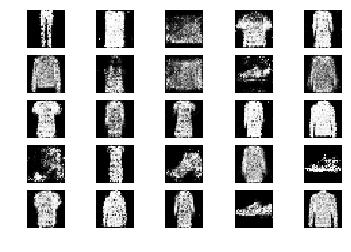

15201 [Discriminator loss: 0.682363, acc.: 60.94%] [Generator loss: 0.933760]
15202 [Discriminator loss: 0.624163, acc.: 62.50%] [Generator loss: 0.957680]
15203 [Discriminator loss: 0.685310, acc.: 54.69%] [Generator loss: 0.995548]
15204 [Discriminator loss: 0.634956, acc.: 65.62%] [Generator loss: 0.849681]
15205 [Discriminator loss: 0.683677, acc.: 62.50%] [Generator loss: 0.886495]
15206 [Discriminator loss: 0.658037, acc.: 54.69%] [Generator loss: 0.889733]
15207 [Discriminator loss: 0.569240, acc.: 73.44%] [Generator loss: 0.941882]
15208 [Discriminator loss: 0.641626, acc.: 56.25%] [Generator loss: 0.982154]
15209 [Discriminator loss: 0.707841, acc.: 46.88%] [Generator loss: 0.918283]
15210 [Discriminator loss: 0.720403, acc.: 45.31%] [Generator loss: 0.916451]
15211 [Discriminator loss: 0.633810, acc.: 64.06%] [Generator loss: 0.874969]
15212 [Discriminator loss: 0.605099, acc.: 67.19%] [Generator loss: 0.881601]
15213 [Discriminator loss: 0.702457, acc.: 56.25%] [Generator lo

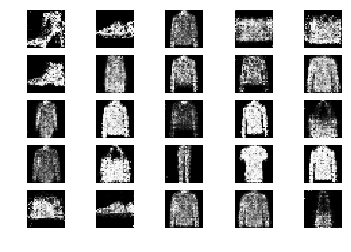

15301 [Discriminator loss: 0.567979, acc.: 71.88%] [Generator loss: 0.905314]
15302 [Discriminator loss: 0.649971, acc.: 62.50%] [Generator loss: 0.932354]
15303 [Discriminator loss: 0.683137, acc.: 59.38%] [Generator loss: 0.841689]
15304 [Discriminator loss: 0.673008, acc.: 62.50%] [Generator loss: 0.903466]
15305 [Discriminator loss: 0.655167, acc.: 57.81%] [Generator loss: 0.850632]
15306 [Discriminator loss: 0.725326, acc.: 53.12%] [Generator loss: 0.809288]
15307 [Discriminator loss: 0.652766, acc.: 53.12%] [Generator loss: 0.914244]
15308 [Discriminator loss: 0.649739, acc.: 60.94%] [Generator loss: 0.926388]
15309 [Discriminator loss: 0.638513, acc.: 71.88%] [Generator loss: 0.860351]
15310 [Discriminator loss: 0.664817, acc.: 57.81%] [Generator loss: 0.860304]
15311 [Discriminator loss: 0.662667, acc.: 60.94%] [Generator loss: 0.950145]
15312 [Discriminator loss: 0.643510, acc.: 68.75%] [Generator loss: 0.870853]
15313 [Discriminator loss: 0.707423, acc.: 57.81%] [Generator lo

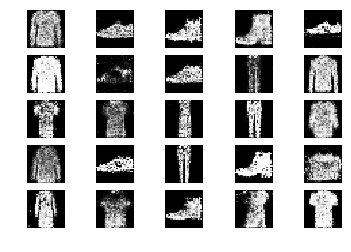

15401 [Discriminator loss: 0.644099, acc.: 62.50%] [Generator loss: 0.829629]
15402 [Discriminator loss: 0.714342, acc.: 54.69%] [Generator loss: 0.926727]
15403 [Discriminator loss: 0.625594, acc.: 65.62%] [Generator loss: 0.880567]
15404 [Discriminator loss: 0.633228, acc.: 62.50%] [Generator loss: 0.932664]
15405 [Discriminator loss: 0.595910, acc.: 73.44%] [Generator loss: 1.047356]
15406 [Discriminator loss: 0.687554, acc.: 54.69%] [Generator loss: 0.953411]
15407 [Discriminator loss: 0.651521, acc.: 59.38%] [Generator loss: 0.964892]
15408 [Discriminator loss: 0.695366, acc.: 57.81%] [Generator loss: 0.862893]
15409 [Discriminator loss: 0.609260, acc.: 67.19%] [Generator loss: 0.872279]
15410 [Discriminator loss: 0.676841, acc.: 59.38%] [Generator loss: 0.884778]
15411 [Discriminator loss: 0.661308, acc.: 68.75%] [Generator loss: 0.873631]
15412 [Discriminator loss: 0.669599, acc.: 60.94%] [Generator loss: 0.875170]
15413 [Discriminator loss: 0.719094, acc.: 54.69%] [Generator lo

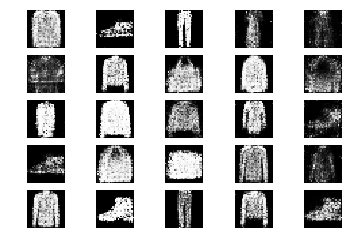

15501 [Discriminator loss: 0.645610, acc.: 64.06%] [Generator loss: 0.961031]
15502 [Discriminator loss: 0.683223, acc.: 62.50%] [Generator loss: 0.899318]
15503 [Discriminator loss: 0.685673, acc.: 48.44%] [Generator loss: 0.865261]
15504 [Discriminator loss: 0.665846, acc.: 56.25%] [Generator loss: 0.871972]
15505 [Discriminator loss: 0.629663, acc.: 70.31%] [Generator loss: 0.927072]
15506 [Discriminator loss: 0.670435, acc.: 62.50%] [Generator loss: 0.915444]
15507 [Discriminator loss: 0.688267, acc.: 62.50%] [Generator loss: 0.852323]
15508 [Discriminator loss: 0.675437, acc.: 51.56%] [Generator loss: 0.898992]
15509 [Discriminator loss: 0.578452, acc.: 73.44%] [Generator loss: 0.934253]
15510 [Discriminator loss: 0.624431, acc.: 62.50%] [Generator loss: 0.946612]
15511 [Discriminator loss: 0.700465, acc.: 51.56%] [Generator loss: 0.873217]
15512 [Discriminator loss: 0.653393, acc.: 59.38%] [Generator loss: 0.944006]
15513 [Discriminator loss: 0.658768, acc.: 64.06%] [Generator lo

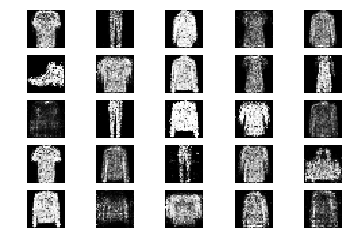

15601 [Discriminator loss: 0.618168, acc.: 62.50%] [Generator loss: 0.903461]
15602 [Discriminator loss: 0.673659, acc.: 57.81%] [Generator loss: 0.908066]
15603 [Discriminator loss: 0.660098, acc.: 59.38%] [Generator loss: 0.906556]
15604 [Discriminator loss: 0.663532, acc.: 67.19%] [Generator loss: 0.958235]
15605 [Discriminator loss: 0.649192, acc.: 64.06%] [Generator loss: 0.908525]
15606 [Discriminator loss: 0.652438, acc.: 62.50%] [Generator loss: 0.884521]
15607 [Discriminator loss: 0.641246, acc.: 65.62%] [Generator loss: 0.853145]
15608 [Discriminator loss: 0.650196, acc.: 64.06%] [Generator loss: 0.809629]
15609 [Discriminator loss: 0.732101, acc.: 53.12%] [Generator loss: 0.833048]
15610 [Discriminator loss: 0.688964, acc.: 57.81%] [Generator loss: 0.960338]
15611 [Discriminator loss: 0.657242, acc.: 54.69%] [Generator loss: 1.058434]
15612 [Discriminator loss: 0.621614, acc.: 65.62%] [Generator loss: 1.084782]
15613 [Discriminator loss: 0.644356, acc.: 65.62%] [Generator lo

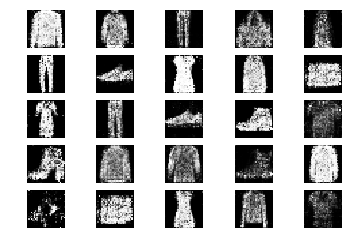

15701 [Discriminator loss: 0.628237, acc.: 68.75%] [Generator loss: 0.946228]
15702 [Discriminator loss: 0.651342, acc.: 56.25%] [Generator loss: 0.914073]
15703 [Discriminator loss: 0.628147, acc.: 62.50%] [Generator loss: 0.885225]
15704 [Discriminator loss: 0.671106, acc.: 51.56%] [Generator loss: 0.973371]
15705 [Discriminator loss: 0.619165, acc.: 67.19%] [Generator loss: 0.908598]
15706 [Discriminator loss: 0.657743, acc.: 62.50%] [Generator loss: 0.932584]
15707 [Discriminator loss: 0.636006, acc.: 60.94%] [Generator loss: 0.917560]
15708 [Discriminator loss: 0.613955, acc.: 67.19%] [Generator loss: 0.861217]
15709 [Discriminator loss: 0.656426, acc.: 64.06%] [Generator loss: 0.953982]
15710 [Discriminator loss: 0.680985, acc.: 54.69%] [Generator loss: 0.988135]
15711 [Discriminator loss: 0.639727, acc.: 64.06%] [Generator loss: 0.951231]
15712 [Discriminator loss: 0.637989, acc.: 60.94%] [Generator loss: 0.856289]
15713 [Discriminator loss: 0.692304, acc.: 56.25%] [Generator lo

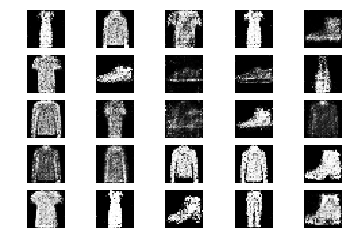

15801 [Discriminator loss: 0.635290, acc.: 62.50%] [Generator loss: 0.992378]
15802 [Discriminator loss: 0.587265, acc.: 64.06%] [Generator loss: 1.003101]
15803 [Discriminator loss: 0.665365, acc.: 60.94%] [Generator loss: 1.001703]
15804 [Discriminator loss: 0.649435, acc.: 64.06%] [Generator loss: 1.004648]
15805 [Discriminator loss: 0.644647, acc.: 64.06%] [Generator loss: 0.870796]
15806 [Discriminator loss: 0.595762, acc.: 71.88%] [Generator loss: 0.932248]
15807 [Discriminator loss: 0.625541, acc.: 60.94%] [Generator loss: 0.974384]
15808 [Discriminator loss: 0.626703, acc.: 68.75%] [Generator loss: 0.995555]
15809 [Discriminator loss: 0.609072, acc.: 70.31%] [Generator loss: 0.968854]
15810 [Discriminator loss: 0.594663, acc.: 67.19%] [Generator loss: 0.950525]
15811 [Discriminator loss: 0.640849, acc.: 64.06%] [Generator loss: 0.927897]
15812 [Discriminator loss: 0.697487, acc.: 51.56%] [Generator loss: 0.878091]
15813 [Discriminator loss: 0.640802, acc.: 70.31%] [Generator lo

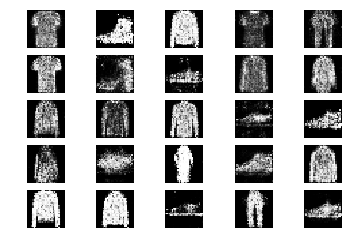

15901 [Discriminator loss: 0.647947, acc.: 60.94%] [Generator loss: 0.956775]
15902 [Discriminator loss: 0.625982, acc.: 64.06%] [Generator loss: 0.906331]
15903 [Discriminator loss: 0.649468, acc.: 64.06%] [Generator loss: 0.860524]
15904 [Discriminator loss: 0.724956, acc.: 43.75%] [Generator loss: 0.797997]
15905 [Discriminator loss: 0.687180, acc.: 51.56%] [Generator loss: 0.918398]
15906 [Discriminator loss: 0.630828, acc.: 64.06%] [Generator loss: 0.915530]
15907 [Discriminator loss: 0.591757, acc.: 71.88%] [Generator loss: 0.884294]
15908 [Discriminator loss: 0.615613, acc.: 64.06%] [Generator loss: 0.887486]
15909 [Discriminator loss: 0.628861, acc.: 65.62%] [Generator loss: 1.009880]
15910 [Discriminator loss: 0.760323, acc.: 53.12%] [Generator loss: 0.933121]
15911 [Discriminator loss: 0.692932, acc.: 60.94%] [Generator loss: 0.969987]
15912 [Discriminator loss: 0.567307, acc.: 71.88%] [Generator loss: 1.023508]
15913 [Discriminator loss: 0.681647, acc.: 57.81%] [Generator lo

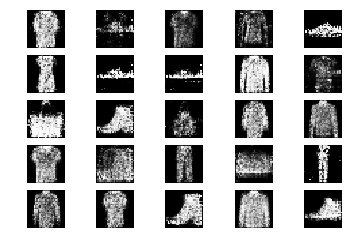

16001 [Discriminator loss: 0.690763, acc.: 53.12%] [Generator loss: 1.015121]
16002 [Discriminator loss: 0.641725, acc.: 62.50%] [Generator loss: 0.936865]
16003 [Discriminator loss: 0.636916, acc.: 62.50%] [Generator loss: 0.986773]
16004 [Discriminator loss: 0.673393, acc.: 54.69%] [Generator loss: 0.998510]
16005 [Discriminator loss: 0.713589, acc.: 57.81%] [Generator loss: 0.936272]
16006 [Discriminator loss: 0.626428, acc.: 67.19%] [Generator loss: 0.985007]
16007 [Discriminator loss: 0.637523, acc.: 64.06%] [Generator loss: 1.022012]
16008 [Discriminator loss: 0.718486, acc.: 53.12%] [Generator loss: 1.003335]
16009 [Discriminator loss: 0.641804, acc.: 65.62%] [Generator loss: 0.996951]
16010 [Discriminator loss: 0.636567, acc.: 60.94%] [Generator loss: 0.997980]
16011 [Discriminator loss: 0.675319, acc.: 60.94%] [Generator loss: 1.001099]
16012 [Discriminator loss: 0.651635, acc.: 64.06%] [Generator loss: 0.960137]
16013 [Discriminator loss: 0.660674, acc.: 57.81%] [Generator lo

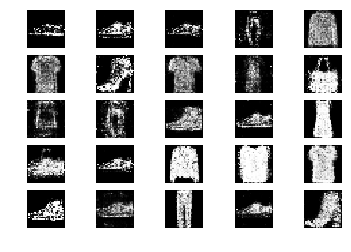

16101 [Discriminator loss: 0.576305, acc.: 70.31%] [Generator loss: 1.033086]
16102 [Discriminator loss: 0.611350, acc.: 65.62%] [Generator loss: 0.951982]
16103 [Discriminator loss: 0.711707, acc.: 53.12%] [Generator loss: 0.887280]
16104 [Discriminator loss: 0.608491, acc.: 64.06%] [Generator loss: 0.822066]
16105 [Discriminator loss: 0.738181, acc.: 54.69%] [Generator loss: 0.939632]
16106 [Discriminator loss: 0.717756, acc.: 53.12%] [Generator loss: 1.026838]
16107 [Discriminator loss: 0.696703, acc.: 54.69%] [Generator loss: 0.988929]
16108 [Discriminator loss: 0.649535, acc.: 56.25%] [Generator loss: 0.955423]
16109 [Discriminator loss: 0.574726, acc.: 73.44%] [Generator loss: 0.900872]
16110 [Discriminator loss: 0.645105, acc.: 64.06%] [Generator loss: 0.936488]
16111 [Discriminator loss: 0.624133, acc.: 68.75%] [Generator loss: 0.893507]
16112 [Discriminator loss: 0.671829, acc.: 59.38%] [Generator loss: 0.949637]
16113 [Discriminator loss: 0.690789, acc.: 56.25%] [Generator lo

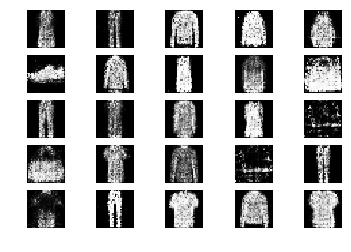

16201 [Discriminator loss: 0.619859, acc.: 67.19%] [Generator loss: 0.991264]
16202 [Discriminator loss: 0.682266, acc.: 51.56%] [Generator loss: 0.900588]
16203 [Discriminator loss: 0.635404, acc.: 65.62%] [Generator loss: 0.886107]
16204 [Discriminator loss: 0.660321, acc.: 54.69%] [Generator loss: 0.924000]
16205 [Discriminator loss: 0.602069, acc.: 70.31%] [Generator loss: 0.955734]
16206 [Discriminator loss: 0.696207, acc.: 64.06%] [Generator loss: 0.941925]
16207 [Discriminator loss: 0.604160, acc.: 70.31%] [Generator loss: 0.911043]
16208 [Discriminator loss: 0.745893, acc.: 46.88%] [Generator loss: 0.821172]
16209 [Discriminator loss: 0.616711, acc.: 70.31%] [Generator loss: 0.887670]
16210 [Discriminator loss: 0.657027, acc.: 60.94%] [Generator loss: 0.888237]
16211 [Discriminator loss: 0.635124, acc.: 65.62%] [Generator loss: 0.837808]
16212 [Discriminator loss: 0.666911, acc.: 54.69%] [Generator loss: 0.868371]
16213 [Discriminator loss: 0.702165, acc.: 59.38%] [Generator lo

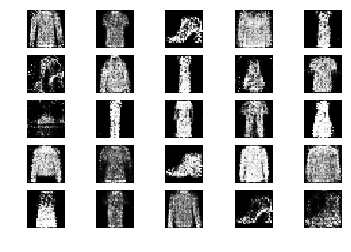

16301 [Discriminator loss: 0.653003, acc.: 60.94%] [Generator loss: 0.846082]
16302 [Discriminator loss: 0.676011, acc.: 60.94%] [Generator loss: 0.947794]
16303 [Discriminator loss: 0.726573, acc.: 54.69%] [Generator loss: 0.958165]
16304 [Discriminator loss: 0.678416, acc.: 51.56%] [Generator loss: 0.903095]
16305 [Discriminator loss: 0.720015, acc.: 46.88%] [Generator loss: 0.952241]
16306 [Discriminator loss: 0.624097, acc.: 71.88%] [Generator loss: 0.919861]
16307 [Discriminator loss: 0.698913, acc.: 54.69%] [Generator loss: 0.783890]
16308 [Discriminator loss: 0.659135, acc.: 56.25%] [Generator loss: 0.954892]
16309 [Discriminator loss: 0.679554, acc.: 59.38%] [Generator loss: 0.901990]
16310 [Discriminator loss: 0.661767, acc.: 56.25%] [Generator loss: 0.895162]
16311 [Discriminator loss: 0.644359, acc.: 60.94%] [Generator loss: 0.956638]
16312 [Discriminator loss: 0.646214, acc.: 67.19%] [Generator loss: 0.873112]
16313 [Discriminator loss: 0.659181, acc.: 56.25%] [Generator lo

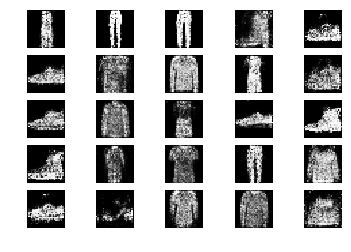

16401 [Discriminator loss: 0.614636, acc.: 70.31%] [Generator loss: 0.913868]
16402 [Discriminator loss: 0.691604, acc.: 50.00%] [Generator loss: 0.898992]
16403 [Discriminator loss: 0.662868, acc.: 54.69%] [Generator loss: 0.918658]
16404 [Discriminator loss: 0.676898, acc.: 65.62%] [Generator loss: 0.905471]
16405 [Discriminator loss: 0.587379, acc.: 71.88%] [Generator loss: 0.955716]
16406 [Discriminator loss: 0.723183, acc.: 53.12%] [Generator loss: 0.994225]
16407 [Discriminator loss: 0.605876, acc.: 68.75%] [Generator loss: 0.954128]
16408 [Discriminator loss: 0.692630, acc.: 54.69%] [Generator loss: 0.941113]
16409 [Discriminator loss: 0.660118, acc.: 60.94%] [Generator loss: 0.912446]
16410 [Discriminator loss: 0.650304, acc.: 56.25%] [Generator loss: 0.944220]
16411 [Discriminator loss: 0.671109, acc.: 64.06%] [Generator loss: 0.897389]
16412 [Discriminator loss: 0.685757, acc.: 54.69%] [Generator loss: 0.914705]
16413 [Discriminator loss: 0.650761, acc.: 57.81%] [Generator lo

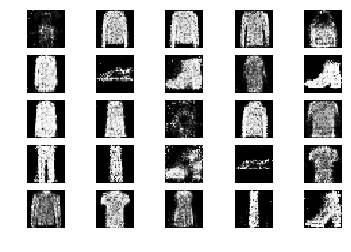

16501 [Discriminator loss: 0.609767, acc.: 68.75%] [Generator loss: 0.956111]
16502 [Discriminator loss: 0.654128, acc.: 54.69%] [Generator loss: 0.945681]
16503 [Discriminator loss: 0.627456, acc.: 64.06%] [Generator loss: 0.956954]
16504 [Discriminator loss: 0.655391, acc.: 62.50%] [Generator loss: 0.903624]
16505 [Discriminator loss: 0.654667, acc.: 67.19%] [Generator loss: 0.959292]
16506 [Discriminator loss: 0.611822, acc.: 59.38%] [Generator loss: 0.878579]
16507 [Discriminator loss: 0.649061, acc.: 64.06%] [Generator loss: 0.818836]
16508 [Discriminator loss: 0.664146, acc.: 57.81%] [Generator loss: 0.874234]
16509 [Discriminator loss: 0.715882, acc.: 45.31%] [Generator loss: 0.975091]
16510 [Discriminator loss: 0.635801, acc.: 59.38%] [Generator loss: 0.957438]
16511 [Discriminator loss: 0.673526, acc.: 53.12%] [Generator loss: 0.982174]
16512 [Discriminator loss: 0.645845, acc.: 59.38%] [Generator loss: 0.904971]
16513 [Discriminator loss: 0.697758, acc.: 57.81%] [Generator lo

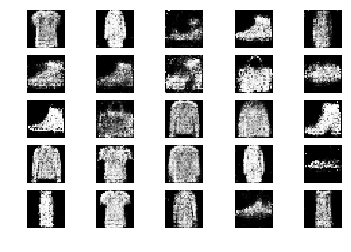

16601 [Discriminator loss: 0.565769, acc.: 76.56%] [Generator loss: 0.970855]
16602 [Discriminator loss: 0.668348, acc.: 56.25%] [Generator loss: 0.974102]
16603 [Discriminator loss: 0.660706, acc.: 64.06%] [Generator loss: 1.009438]
16604 [Discriminator loss: 0.652737, acc.: 60.94%] [Generator loss: 0.922101]
16605 [Discriminator loss: 0.664914, acc.: 62.50%] [Generator loss: 0.917711]
16606 [Discriminator loss: 0.660876, acc.: 60.94%] [Generator loss: 0.928866]
16607 [Discriminator loss: 0.645542, acc.: 57.81%] [Generator loss: 0.933150]
16608 [Discriminator loss: 0.642523, acc.: 67.19%] [Generator loss: 0.883966]
16609 [Discriminator loss: 0.709061, acc.: 51.56%] [Generator loss: 0.899166]
16610 [Discriminator loss: 0.633384, acc.: 59.38%] [Generator loss: 0.815959]
16611 [Discriminator loss: 0.642481, acc.: 57.81%] [Generator loss: 0.877460]
16612 [Discriminator loss: 0.671354, acc.: 64.06%] [Generator loss: 0.959906]
16613 [Discriminator loss: 0.639654, acc.: 59.38%] [Generator lo

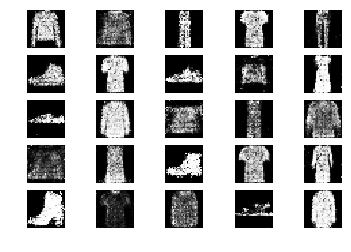

16701 [Discriminator loss: 0.706101, acc.: 54.69%] [Generator loss: 0.903317]
16702 [Discriminator loss: 0.609251, acc.: 68.75%] [Generator loss: 0.955900]
16703 [Discriminator loss: 0.686647, acc.: 53.12%] [Generator loss: 0.990972]
16704 [Discriminator loss: 0.652138, acc.: 56.25%] [Generator loss: 1.001099]
16705 [Discriminator loss: 0.645523, acc.: 65.62%] [Generator loss: 1.009103]
16706 [Discriminator loss: 0.571995, acc.: 68.75%] [Generator loss: 0.920878]
16707 [Discriminator loss: 0.635862, acc.: 62.50%] [Generator loss: 1.005974]
16708 [Discriminator loss: 0.584049, acc.: 70.31%] [Generator loss: 0.905640]
16709 [Discriminator loss: 0.651714, acc.: 59.38%] [Generator loss: 0.938299]
16710 [Discriminator loss: 0.685723, acc.: 59.38%] [Generator loss: 0.908132]
16711 [Discriminator loss: 0.657968, acc.: 60.94%] [Generator loss: 0.991865]
16712 [Discriminator loss: 0.665786, acc.: 56.25%] [Generator loss: 0.960466]
16713 [Discriminator loss: 0.634767, acc.: 59.38%] [Generator lo

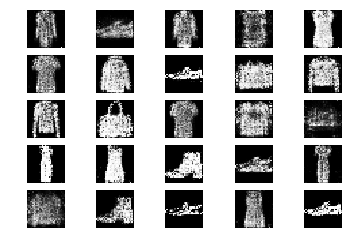

16801 [Discriminator loss: 0.620216, acc.: 67.19%] [Generator loss: 0.949908]
16802 [Discriminator loss: 0.585656, acc.: 67.19%] [Generator loss: 0.966799]
16803 [Discriminator loss: 0.682782, acc.: 65.62%] [Generator loss: 0.991535]
16804 [Discriminator loss: 0.562621, acc.: 71.88%] [Generator loss: 0.956495]
16805 [Discriminator loss: 0.559880, acc.: 70.31%] [Generator loss: 0.943283]
16806 [Discriminator loss: 0.674906, acc.: 54.69%] [Generator loss: 0.953289]
16807 [Discriminator loss: 0.568868, acc.: 76.56%] [Generator loss: 0.988152]
16808 [Discriminator loss: 0.709568, acc.: 59.38%] [Generator loss: 0.925503]
16809 [Discriminator loss: 0.569318, acc.: 79.69%] [Generator loss: 0.947129]
16810 [Discriminator loss: 0.638342, acc.: 67.19%] [Generator loss: 0.985325]
16811 [Discriminator loss: 0.656695, acc.: 59.38%] [Generator loss: 0.967536]
16812 [Discriminator loss: 0.677001, acc.: 60.94%] [Generator loss: 0.851874]
16813 [Discriminator loss: 0.639063, acc.: 62.50%] [Generator lo

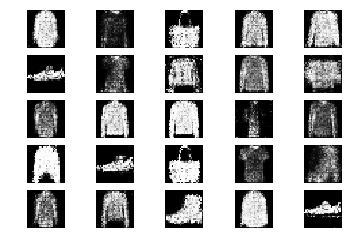

16901 [Discriminator loss: 0.649613, acc.: 65.62%] [Generator loss: 0.956521]
16902 [Discriminator loss: 0.665777, acc.: 57.81%] [Generator loss: 0.931445]
16903 [Discriminator loss: 0.641663, acc.: 64.06%] [Generator loss: 0.929236]
16904 [Discriminator loss: 0.645056, acc.: 59.38%] [Generator loss: 0.955610]
16905 [Discriminator loss: 0.592338, acc.: 68.75%] [Generator loss: 1.043589]
16906 [Discriminator loss: 0.625858, acc.: 67.19%] [Generator loss: 1.051020]
16907 [Discriminator loss: 0.677305, acc.: 60.94%] [Generator loss: 0.949086]
16908 [Discriminator loss: 0.660564, acc.: 67.19%] [Generator loss: 0.960406]
16909 [Discriminator loss: 0.650012, acc.: 71.88%] [Generator loss: 0.942974]
16910 [Discriminator loss: 0.594942, acc.: 68.75%] [Generator loss: 0.945807]
16911 [Discriminator loss: 0.640806, acc.: 57.81%] [Generator loss: 0.897196]
16912 [Discriminator loss: 0.605564, acc.: 68.75%] [Generator loss: 0.904601]
16913 [Discriminator loss: 0.672941, acc.: 56.25%] [Generator lo

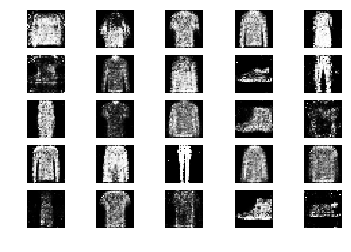

17001 [Discriminator loss: 0.619755, acc.: 68.75%] [Generator loss: 0.880267]
17002 [Discriminator loss: 0.648678, acc.: 65.62%] [Generator loss: 0.820223]
17003 [Discriminator loss: 0.625140, acc.: 65.62%] [Generator loss: 0.883218]
17004 [Discriminator loss: 0.690068, acc.: 50.00%] [Generator loss: 0.940423]
17005 [Discriminator loss: 0.638227, acc.: 67.19%] [Generator loss: 0.940928]
17006 [Discriminator loss: 0.595029, acc.: 67.19%] [Generator loss: 0.984652]
17007 [Discriminator loss: 0.622980, acc.: 71.88%] [Generator loss: 0.873194]
17008 [Discriminator loss: 0.664745, acc.: 65.62%] [Generator loss: 0.887518]
17009 [Discriminator loss: 0.678872, acc.: 64.06%] [Generator loss: 0.930230]
17010 [Discriminator loss: 0.580346, acc.: 68.75%] [Generator loss: 0.975978]
17011 [Discriminator loss: 0.618538, acc.: 71.88%] [Generator loss: 0.935357]
17012 [Discriminator loss: 0.602181, acc.: 67.19%] [Generator loss: 0.931164]
17013 [Discriminator loss: 0.646420, acc.: 60.94%] [Generator lo

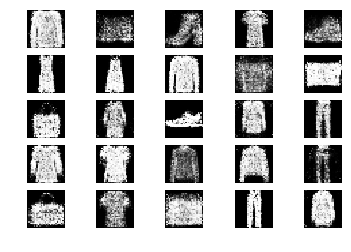

17101 [Discriminator loss: 0.631160, acc.: 64.06%] [Generator loss: 0.887038]
17102 [Discriminator loss: 0.696224, acc.: 57.81%] [Generator loss: 0.901785]
17103 [Discriminator loss: 0.595922, acc.: 65.62%] [Generator loss: 0.919476]
17104 [Discriminator loss: 0.574327, acc.: 73.44%] [Generator loss: 0.952783]
17105 [Discriminator loss: 0.612487, acc.: 68.75%] [Generator loss: 0.983116]
17106 [Discriminator loss: 0.668890, acc.: 59.38%] [Generator loss: 0.863074]
17107 [Discriminator loss: 0.606750, acc.: 64.06%] [Generator loss: 0.855403]
17108 [Discriminator loss: 0.599780, acc.: 64.06%] [Generator loss: 0.848703]
17109 [Discriminator loss: 0.610255, acc.: 68.75%] [Generator loss: 0.849386]
17110 [Discriminator loss: 0.672274, acc.: 59.38%] [Generator loss: 0.907398]
17111 [Discriminator loss: 0.677693, acc.: 60.94%] [Generator loss: 1.010785]
17112 [Discriminator loss: 0.655797, acc.: 59.38%] [Generator loss: 1.031220]
17113 [Discriminator loss: 0.630324, acc.: 70.31%] [Generator lo

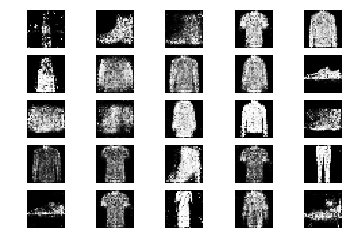

17201 [Discriminator loss: 0.691344, acc.: 56.25%] [Generator loss: 0.881167]
17202 [Discriminator loss: 0.670983, acc.: 65.62%] [Generator loss: 0.863813]
17203 [Discriminator loss: 0.723265, acc.: 51.56%] [Generator loss: 0.933958]
17204 [Discriminator loss: 0.629907, acc.: 65.62%] [Generator loss: 0.955278]
17205 [Discriminator loss: 0.759637, acc.: 48.44%] [Generator loss: 0.843081]
17206 [Discriminator loss: 0.643900, acc.: 68.75%] [Generator loss: 0.863453]
17207 [Discriminator loss: 0.704151, acc.: 57.81%] [Generator loss: 0.933144]
17208 [Discriminator loss: 0.675797, acc.: 62.50%] [Generator loss: 0.926371]
17209 [Discriminator loss: 0.646306, acc.: 57.81%] [Generator loss: 0.965102]
17210 [Discriminator loss: 0.718884, acc.: 45.31%] [Generator loss: 0.937404]
17211 [Discriminator loss: 0.679936, acc.: 57.81%] [Generator loss: 0.923509]
17212 [Discriminator loss: 0.685076, acc.: 51.56%] [Generator loss: 0.938304]
17213 [Discriminator loss: 0.650726, acc.: 57.81%] [Generator lo

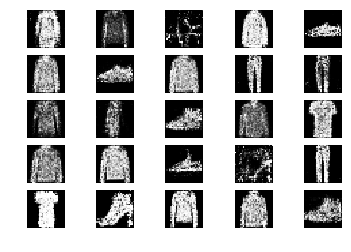

17301 [Discriminator loss: 0.639748, acc.: 62.50%] [Generator loss: 0.851568]
17302 [Discriminator loss: 0.664156, acc.: 60.94%] [Generator loss: 0.910545]
17303 [Discriminator loss: 0.658134, acc.: 59.38%] [Generator loss: 0.896373]
17304 [Discriminator loss: 0.719557, acc.: 50.00%] [Generator loss: 1.002406]
17305 [Discriminator loss: 0.648856, acc.: 56.25%] [Generator loss: 0.955213]
17306 [Discriminator loss: 0.616458, acc.: 67.19%] [Generator loss: 0.930373]
17307 [Discriminator loss: 0.646955, acc.: 56.25%] [Generator loss: 0.826424]
17308 [Discriminator loss: 0.670609, acc.: 60.94%] [Generator loss: 0.914798]
17309 [Discriminator loss: 0.628652, acc.: 68.75%] [Generator loss: 0.815405]
17310 [Discriminator loss: 0.730176, acc.: 50.00%] [Generator loss: 0.986324]
17311 [Discriminator loss: 0.715668, acc.: 48.44%] [Generator loss: 0.874505]
17312 [Discriminator loss: 0.636218, acc.: 71.88%] [Generator loss: 0.926131]
17313 [Discriminator loss: 0.633557, acc.: 65.62%] [Generator lo

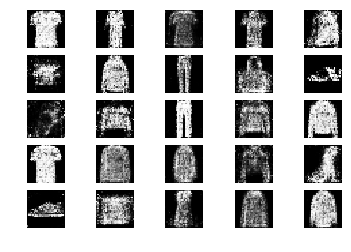

17401 [Discriminator loss: 0.625071, acc.: 70.31%] [Generator loss: 0.982054]
17402 [Discriminator loss: 0.572712, acc.: 71.88%] [Generator loss: 0.910928]
17403 [Discriminator loss: 0.585782, acc.: 67.19%] [Generator loss: 0.917198]
17404 [Discriminator loss: 0.610541, acc.: 64.06%] [Generator loss: 0.917303]
17405 [Discriminator loss: 0.653926, acc.: 65.62%] [Generator loss: 1.008410]
17406 [Discriminator loss: 0.698738, acc.: 54.69%] [Generator loss: 0.901512]
17407 [Discriminator loss: 0.635302, acc.: 64.06%] [Generator loss: 0.945114]
17408 [Discriminator loss: 0.612545, acc.: 73.44%] [Generator loss: 0.940077]
17409 [Discriminator loss: 0.625193, acc.: 73.44%] [Generator loss: 0.930397]
17410 [Discriminator loss: 0.671003, acc.: 60.94%] [Generator loss: 0.918783]
17411 [Discriminator loss: 0.686882, acc.: 64.06%] [Generator loss: 0.914163]
17412 [Discriminator loss: 0.618976, acc.: 70.31%] [Generator loss: 0.978452]
17413 [Discriminator loss: 0.698706, acc.: 48.44%] [Generator lo

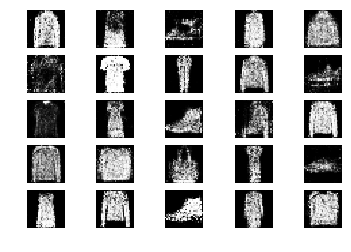

17501 [Discriminator loss: 0.622494, acc.: 65.62%] [Generator loss: 0.951022]
17502 [Discriminator loss: 0.665461, acc.: 62.50%] [Generator loss: 0.998641]
17503 [Discriminator loss: 0.625443, acc.: 68.75%] [Generator loss: 0.914966]
17504 [Discriminator loss: 0.639305, acc.: 60.94%] [Generator loss: 1.003436]
17505 [Discriminator loss: 0.691962, acc.: 54.69%] [Generator loss: 0.970160]
17506 [Discriminator loss: 0.639404, acc.: 65.62%] [Generator loss: 0.959318]
17507 [Discriminator loss: 0.667995, acc.: 60.94%] [Generator loss: 0.986884]
17508 [Discriminator loss: 0.649391, acc.: 59.38%] [Generator loss: 0.860602]
17509 [Discriminator loss: 0.600378, acc.: 71.88%] [Generator loss: 0.929884]
17510 [Discriminator loss: 0.611527, acc.: 60.94%] [Generator loss: 0.865447]
17511 [Discriminator loss: 0.683977, acc.: 51.56%] [Generator loss: 0.955097]
17512 [Discriminator loss: 0.655275, acc.: 67.19%] [Generator loss: 0.860855]
17513 [Discriminator loss: 0.638591, acc.: 64.06%] [Generator lo

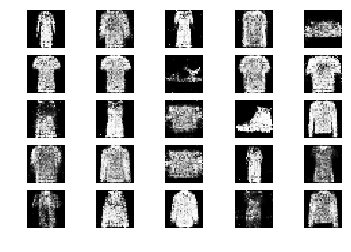

17601 [Discriminator loss: 0.662515, acc.: 53.12%] [Generator loss: 1.019873]
17602 [Discriminator loss: 0.602941, acc.: 65.62%] [Generator loss: 0.946875]
17603 [Discriminator loss: 0.691443, acc.: 59.38%] [Generator loss: 0.982422]
17604 [Discriminator loss: 0.641871, acc.: 53.12%] [Generator loss: 1.026387]
17605 [Discriminator loss: 0.645728, acc.: 59.38%] [Generator loss: 0.951905]
17606 [Discriminator loss: 0.619829, acc.: 70.31%] [Generator loss: 1.050255]
17607 [Discriminator loss: 0.631402, acc.: 62.50%] [Generator loss: 0.893934]
17608 [Discriminator loss: 0.649946, acc.: 65.62%] [Generator loss: 0.801096]
17609 [Discriminator loss: 0.648417, acc.: 60.94%] [Generator loss: 0.905406]
17610 [Discriminator loss: 0.616299, acc.: 68.75%] [Generator loss: 0.825330]
17611 [Discriminator loss: 0.588109, acc.: 73.44%] [Generator loss: 0.904909]
17612 [Discriminator loss: 0.710163, acc.: 53.12%] [Generator loss: 0.904290]
17613 [Discriminator loss: 0.585136, acc.: 71.88%] [Generator lo

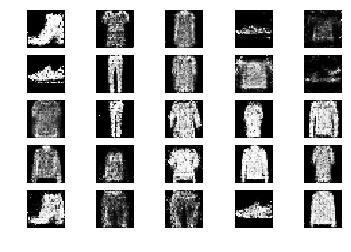

17701 [Discriminator loss: 0.655094, acc.: 60.94%] [Generator loss: 0.793784]
17702 [Discriminator loss: 0.646958, acc.: 57.81%] [Generator loss: 0.949903]
17703 [Discriminator loss: 0.625275, acc.: 64.06%] [Generator loss: 0.858028]
17704 [Discriminator loss: 0.650364, acc.: 60.94%] [Generator loss: 0.871934]
17705 [Discriminator loss: 0.710811, acc.: 53.12%] [Generator loss: 0.906254]
17706 [Discriminator loss: 0.662877, acc.: 57.81%] [Generator loss: 0.813846]
17707 [Discriminator loss: 0.693641, acc.: 56.25%] [Generator loss: 0.998729]
17708 [Discriminator loss: 0.676533, acc.: 59.38%] [Generator loss: 0.838106]
17709 [Discriminator loss: 0.664512, acc.: 59.38%] [Generator loss: 0.990543]
17710 [Discriminator loss: 0.636201, acc.: 62.50%] [Generator loss: 0.902885]
17711 [Discriminator loss: 0.700897, acc.: 62.50%] [Generator loss: 0.977911]
17712 [Discriminator loss: 0.647601, acc.: 64.06%] [Generator loss: 0.863472]
17713 [Discriminator loss: 0.675983, acc.: 59.38%] [Generator lo

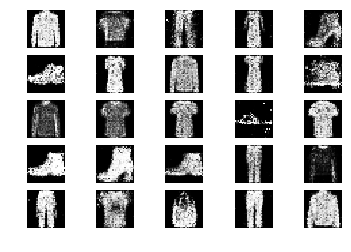

17801 [Discriminator loss: 0.617458, acc.: 68.75%] [Generator loss: 0.925260]
17802 [Discriminator loss: 0.654659, acc.: 56.25%] [Generator loss: 0.887976]
17803 [Discriminator loss: 0.650368, acc.: 54.69%] [Generator loss: 1.005546]
17804 [Discriminator loss: 0.726199, acc.: 54.69%] [Generator loss: 1.012304]
17805 [Discriminator loss: 0.630517, acc.: 68.75%] [Generator loss: 0.885791]
17806 [Discriminator loss: 0.664745, acc.: 53.12%] [Generator loss: 1.026405]
17807 [Discriminator loss: 0.709198, acc.: 54.69%] [Generator loss: 0.911277]
17808 [Discriminator loss: 0.703592, acc.: 50.00%] [Generator loss: 0.875749]
17809 [Discriminator loss: 0.638128, acc.: 62.50%] [Generator loss: 0.920568]
17810 [Discriminator loss: 0.679230, acc.: 59.38%] [Generator loss: 0.864747]
17811 [Discriminator loss: 0.692397, acc.: 62.50%] [Generator loss: 0.972464]
17812 [Discriminator loss: 0.683363, acc.: 64.06%] [Generator loss: 0.894751]
17813 [Discriminator loss: 0.636805, acc.: 60.94%] [Generator lo

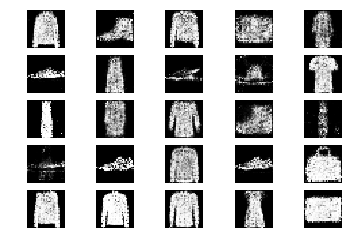

17901 [Discriminator loss: 0.698922, acc.: 62.50%] [Generator loss: 0.892927]
17902 [Discriminator loss: 0.743822, acc.: 40.62%] [Generator loss: 0.959661]
17903 [Discriminator loss: 0.617509, acc.: 70.31%] [Generator loss: 0.907146]
17904 [Discriminator loss: 0.657226, acc.: 62.50%] [Generator loss: 0.921903]
17905 [Discriminator loss: 0.638101, acc.: 64.06%] [Generator loss: 0.937852]
17906 [Discriminator loss: 0.636931, acc.: 64.06%] [Generator loss: 0.918489]
17907 [Discriminator loss: 0.657080, acc.: 57.81%] [Generator loss: 0.936419]
17908 [Discriminator loss: 0.617562, acc.: 73.44%] [Generator loss: 0.895298]
17909 [Discriminator loss: 0.687972, acc.: 62.50%] [Generator loss: 0.909141]
17910 [Discriminator loss: 0.665299, acc.: 60.94%] [Generator loss: 0.970140]
17911 [Discriminator loss: 0.657862, acc.: 65.62%] [Generator loss: 1.027911]
17912 [Discriminator loss: 0.659602, acc.: 60.94%] [Generator loss: 0.928886]
17913 [Discriminator loss: 0.659964, acc.: 57.81%] [Generator lo

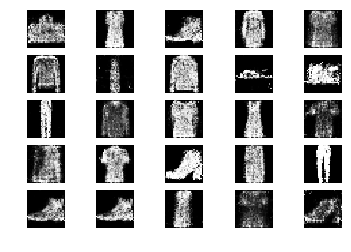

18001 [Discriminator loss: 0.650787, acc.: 57.81%] [Generator loss: 1.030030]
18002 [Discriminator loss: 0.714330, acc.: 54.69%] [Generator loss: 1.071327]
18003 [Discriminator loss: 0.613400, acc.: 62.50%] [Generator loss: 1.018615]
18004 [Discriminator loss: 0.608869, acc.: 67.19%] [Generator loss: 0.912911]
18005 [Discriminator loss: 0.624612, acc.: 65.62%] [Generator loss: 0.952367]
18006 [Discriminator loss: 0.686256, acc.: 62.50%] [Generator loss: 0.884988]
18007 [Discriminator loss: 0.745524, acc.: 40.62%] [Generator loss: 0.931416]
18008 [Discriminator loss: 0.608189, acc.: 67.19%] [Generator loss: 0.963633]
18009 [Discriminator loss: 0.653096, acc.: 68.75%] [Generator loss: 0.917483]
18010 [Discriminator loss: 0.642083, acc.: 57.81%] [Generator loss: 0.866922]
18011 [Discriminator loss: 0.567187, acc.: 70.31%] [Generator loss: 0.897349]
18012 [Discriminator loss: 0.593710, acc.: 76.56%] [Generator loss: 1.009207]
18013 [Discriminator loss: 0.573232, acc.: 76.56%] [Generator lo

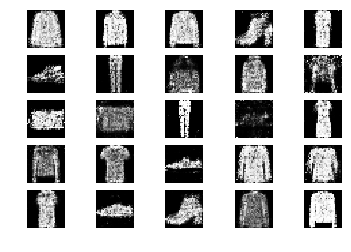

18101 [Discriminator loss: 0.701423, acc.: 48.44%] [Generator loss: 0.871570]
18102 [Discriminator loss: 0.645744, acc.: 64.06%] [Generator loss: 0.934559]
18103 [Discriminator loss: 0.620944, acc.: 68.75%] [Generator loss: 0.919887]
18104 [Discriminator loss: 0.660005, acc.: 60.94%] [Generator loss: 0.956479]
18105 [Discriminator loss: 0.694656, acc.: 57.81%] [Generator loss: 1.027544]
18106 [Discriminator loss: 0.698949, acc.: 50.00%] [Generator loss: 1.006439]
18107 [Discriminator loss: 0.689494, acc.: 54.69%] [Generator loss: 0.884309]
18108 [Discriminator loss: 0.690422, acc.: 57.81%] [Generator loss: 0.905631]
18109 [Discriminator loss: 0.653341, acc.: 59.38%] [Generator loss: 0.927205]
18110 [Discriminator loss: 0.634501, acc.: 65.62%] [Generator loss: 0.881871]
18111 [Discriminator loss: 0.654349, acc.: 62.50%] [Generator loss: 0.936971]
18112 [Discriminator loss: 0.613613, acc.: 70.31%] [Generator loss: 0.863740]
18113 [Discriminator loss: 0.598036, acc.: 68.75%] [Generator lo

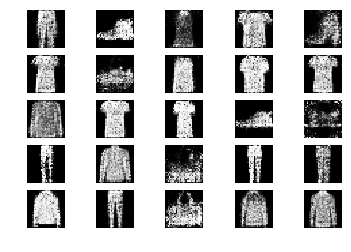

18201 [Discriminator loss: 0.626642, acc.: 64.06%] [Generator loss: 0.945771]
18202 [Discriminator loss: 0.601947, acc.: 67.19%] [Generator loss: 0.910544]
18203 [Discriminator loss: 0.665599, acc.: 57.81%] [Generator loss: 0.951926]
18204 [Discriminator loss: 0.642868, acc.: 64.06%] [Generator loss: 0.976742]
18205 [Discriminator loss: 0.689842, acc.: 59.38%] [Generator loss: 0.884822]
18206 [Discriminator loss: 0.667026, acc.: 60.94%] [Generator loss: 0.955592]
18207 [Discriminator loss: 0.681293, acc.: 60.94%] [Generator loss: 0.969779]
18208 [Discriminator loss: 0.629922, acc.: 65.62%] [Generator loss: 0.917987]
18209 [Discriminator loss: 0.628934, acc.: 59.38%] [Generator loss: 0.927062]
18210 [Discriminator loss: 0.654824, acc.: 64.06%] [Generator loss: 0.975896]
18211 [Discriminator loss: 0.561456, acc.: 71.88%] [Generator loss: 0.865704]
18212 [Discriminator loss: 0.635993, acc.: 57.81%] [Generator loss: 0.866771]
18213 [Discriminator loss: 0.689200, acc.: 64.06%] [Generator lo

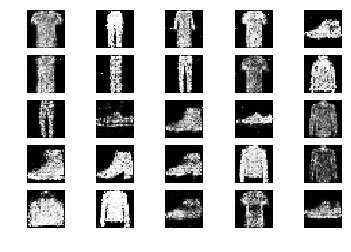

18301 [Discriminator loss: 0.622366, acc.: 70.31%] [Generator loss: 0.986442]
18302 [Discriminator loss: 0.671107, acc.: 65.62%] [Generator loss: 0.908322]
18303 [Discriminator loss: 0.654778, acc.: 60.94%] [Generator loss: 0.923354]
18304 [Discriminator loss: 0.691099, acc.: 51.56%] [Generator loss: 0.923088]
18305 [Discriminator loss: 0.652340, acc.: 59.38%] [Generator loss: 0.915157]
18306 [Discriminator loss: 0.650156, acc.: 60.94%] [Generator loss: 0.883505]
18307 [Discriminator loss: 0.662813, acc.: 56.25%] [Generator loss: 0.900232]
18308 [Discriminator loss: 0.682645, acc.: 54.69%] [Generator loss: 0.859973]
18309 [Discriminator loss: 0.596638, acc.: 73.44%] [Generator loss: 0.793359]
18310 [Discriminator loss: 0.603756, acc.: 68.75%] [Generator loss: 0.934259]
18311 [Discriminator loss: 0.630289, acc.: 62.50%] [Generator loss: 0.976336]
18312 [Discriminator loss: 0.660019, acc.: 59.38%] [Generator loss: 0.938545]
18313 [Discriminator loss: 0.604325, acc.: 68.75%] [Generator lo

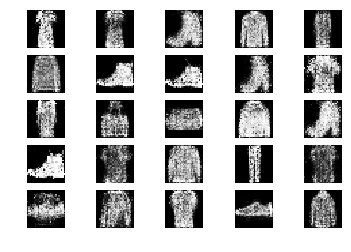

18401 [Discriminator loss: 0.646108, acc.: 67.19%] [Generator loss: 0.958146]
18402 [Discriminator loss: 0.662522, acc.: 57.81%] [Generator loss: 0.908854]
18403 [Discriminator loss: 0.658713, acc.: 62.50%] [Generator loss: 0.959698]
18404 [Discriminator loss: 0.568142, acc.: 75.00%] [Generator loss: 0.904769]
18405 [Discriminator loss: 0.641841, acc.: 64.06%] [Generator loss: 0.890626]
18406 [Discriminator loss: 0.623312, acc.: 65.62%] [Generator loss: 0.861755]
18407 [Discriminator loss: 0.638101, acc.: 64.06%] [Generator loss: 0.917984]
18408 [Discriminator loss: 0.647356, acc.: 60.94%] [Generator loss: 0.882511]
18409 [Discriminator loss: 0.640935, acc.: 60.94%] [Generator loss: 0.867826]
18410 [Discriminator loss: 0.644638, acc.: 67.19%] [Generator loss: 0.881762]
18411 [Discriminator loss: 0.691906, acc.: 59.38%] [Generator loss: 0.825678]
18412 [Discriminator loss: 0.620150, acc.: 59.38%] [Generator loss: 0.949076]
18413 [Discriminator loss: 0.604710, acc.: 70.31%] [Generator lo

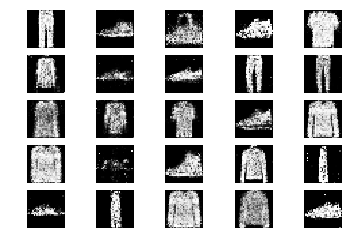

18501 [Discriminator loss: 0.653363, acc.: 70.31%] [Generator loss: 0.994760]
18502 [Discriminator loss: 0.668997, acc.: 60.94%] [Generator loss: 0.946148]
18503 [Discriminator loss: 0.622528, acc.: 71.88%] [Generator loss: 0.900200]
18504 [Discriminator loss: 0.608289, acc.: 65.62%] [Generator loss: 0.976160]
18505 [Discriminator loss: 0.628479, acc.: 62.50%] [Generator loss: 0.934640]
18506 [Discriminator loss: 0.590891, acc.: 64.06%] [Generator loss: 0.935608]
18507 [Discriminator loss: 0.583504, acc.: 67.19%] [Generator loss: 0.905972]
18508 [Discriminator loss: 0.702485, acc.: 54.69%] [Generator loss: 0.902426]
18509 [Discriminator loss: 0.672497, acc.: 54.69%] [Generator loss: 0.936966]
18510 [Discriminator loss: 0.601461, acc.: 71.88%] [Generator loss: 0.926172]
18511 [Discriminator loss: 0.632318, acc.: 65.62%] [Generator loss: 0.926616]
18512 [Discriminator loss: 0.637025, acc.: 65.62%] [Generator loss: 0.980981]
18513 [Discriminator loss: 0.612999, acc.: 64.06%] [Generator lo

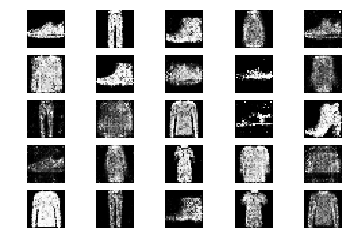

18601 [Discriminator loss: 0.572338, acc.: 75.00%] [Generator loss: 0.999103]
18602 [Discriminator loss: 0.717248, acc.: 48.44%] [Generator loss: 0.873664]
18603 [Discriminator loss: 0.613626, acc.: 67.19%] [Generator loss: 0.871771]
18604 [Discriminator loss: 0.622382, acc.: 60.94%] [Generator loss: 0.934885]
18605 [Discriminator loss: 0.606134, acc.: 70.31%] [Generator loss: 0.949330]
18606 [Discriminator loss: 0.662123, acc.: 60.94%] [Generator loss: 0.946239]
18607 [Discriminator loss: 0.650235, acc.: 60.94%] [Generator loss: 0.996787]
18608 [Discriminator loss: 0.603813, acc.: 70.31%] [Generator loss: 0.989609]
18609 [Discriminator loss: 0.682916, acc.: 59.38%] [Generator loss: 0.966107]
18610 [Discriminator loss: 0.593367, acc.: 70.31%] [Generator loss: 0.908678]
18611 [Discriminator loss: 0.690871, acc.: 56.25%] [Generator loss: 0.918493]
18612 [Discriminator loss: 0.645451, acc.: 64.06%] [Generator loss: 0.938277]
18613 [Discriminator loss: 0.703615, acc.: 54.69%] [Generator lo

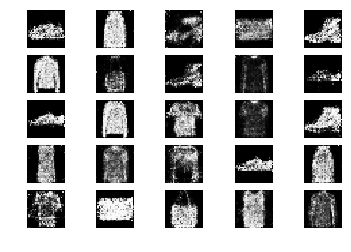

18701 [Discriminator loss: 0.674614, acc.: 60.94%] [Generator loss: 0.795032]
18702 [Discriminator loss: 0.716423, acc.: 51.56%] [Generator loss: 0.876425]
18703 [Discriminator loss: 0.621589, acc.: 64.06%] [Generator loss: 0.890980]
18704 [Discriminator loss: 0.670108, acc.: 57.81%] [Generator loss: 0.871070]
18705 [Discriminator loss: 0.591346, acc.: 70.31%] [Generator loss: 0.834682]
18706 [Discriminator loss: 0.653546, acc.: 57.81%] [Generator loss: 1.034239]
18707 [Discriminator loss: 0.607921, acc.: 65.62%] [Generator loss: 0.947406]
18708 [Discriminator loss: 0.613291, acc.: 62.50%] [Generator loss: 0.893385]
18709 [Discriminator loss: 0.645786, acc.: 64.06%] [Generator loss: 0.945978]
18710 [Discriminator loss: 0.547081, acc.: 75.00%] [Generator loss: 0.962070]
18711 [Discriminator loss: 0.655957, acc.: 57.81%] [Generator loss: 1.037715]
18712 [Discriminator loss: 0.611473, acc.: 64.06%] [Generator loss: 0.941646]
18713 [Discriminator loss: 0.681430, acc.: 54.69%] [Generator lo

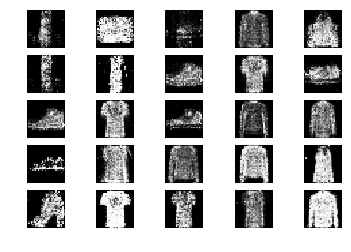

18801 [Discriminator loss: 0.604670, acc.: 67.19%] [Generator loss: 0.999103]
18802 [Discriminator loss: 0.722786, acc.: 48.44%] [Generator loss: 1.001766]
18803 [Discriminator loss: 0.676902, acc.: 57.81%] [Generator loss: 0.909291]
18804 [Discriminator loss: 0.640633, acc.: 56.25%] [Generator loss: 0.931336]
18805 [Discriminator loss: 0.695699, acc.: 53.12%] [Generator loss: 0.937543]
18806 [Discriminator loss: 0.680074, acc.: 54.69%] [Generator loss: 0.983265]
18807 [Discriminator loss: 0.573015, acc.: 75.00%] [Generator loss: 0.944052]
18808 [Discriminator loss: 0.648617, acc.: 62.50%] [Generator loss: 0.921873]
18809 [Discriminator loss: 0.631171, acc.: 70.31%] [Generator loss: 0.896201]
18810 [Discriminator loss: 0.622403, acc.: 60.94%] [Generator loss: 1.000885]
18811 [Discriminator loss: 0.698806, acc.: 57.81%] [Generator loss: 1.001873]
18812 [Discriminator loss: 0.668397, acc.: 56.25%] [Generator loss: 0.998428]
18813 [Discriminator loss: 0.641507, acc.: 62.50%] [Generator lo

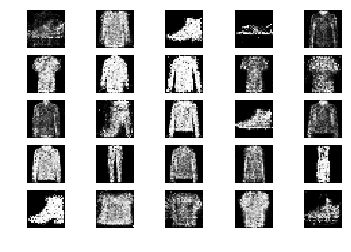

18901 [Discriminator loss: 0.638503, acc.: 67.19%] [Generator loss: 0.882968]
18902 [Discriminator loss: 0.640109, acc.: 67.19%] [Generator loss: 0.853656]
18903 [Discriminator loss: 0.609025, acc.: 68.75%] [Generator loss: 0.840464]
18904 [Discriminator loss: 0.572515, acc.: 71.88%] [Generator loss: 0.879316]
18905 [Discriminator loss: 0.576948, acc.: 62.50%] [Generator loss: 0.869280]
18906 [Discriminator loss: 0.627256, acc.: 68.75%] [Generator loss: 0.973137]
18907 [Discriminator loss: 0.648567, acc.: 60.94%] [Generator loss: 1.001893]
18908 [Discriminator loss: 0.645817, acc.: 57.81%] [Generator loss: 0.846442]
18909 [Discriminator loss: 0.675221, acc.: 56.25%] [Generator loss: 0.931903]
18910 [Discriminator loss: 0.647436, acc.: 60.94%] [Generator loss: 0.888262]
18911 [Discriminator loss: 0.615058, acc.: 67.19%] [Generator loss: 0.979332]
18912 [Discriminator loss: 0.719819, acc.: 54.69%] [Generator loss: 0.989885]
18913 [Discriminator loss: 0.717215, acc.: 48.44%] [Generator lo

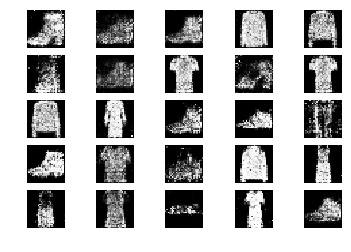

19001 [Discriminator loss: 0.629221, acc.: 57.81%] [Generator loss: 0.912563]
19002 [Discriminator loss: 0.721620, acc.: 56.25%] [Generator loss: 0.993666]
19003 [Discriminator loss: 0.720284, acc.: 59.38%] [Generator loss: 1.023724]
19004 [Discriminator loss: 0.718347, acc.: 57.81%] [Generator loss: 0.999019]
19005 [Discriminator loss: 0.669905, acc.: 56.25%] [Generator loss: 0.924627]
19006 [Discriminator loss: 0.680524, acc.: 57.81%] [Generator loss: 0.938250]
19007 [Discriminator loss: 0.699077, acc.: 54.69%] [Generator loss: 0.992928]
19008 [Discriminator loss: 0.663200, acc.: 60.94%] [Generator loss: 1.015767]
19009 [Discriminator loss: 0.695360, acc.: 54.69%] [Generator loss: 1.010584]
19010 [Discriminator loss: 0.607249, acc.: 71.88%] [Generator loss: 1.006103]
19011 [Discriminator loss: 0.619546, acc.: 71.88%] [Generator loss: 1.049312]
19012 [Discriminator loss: 0.714256, acc.: 53.12%] [Generator loss: 0.885693]
19013 [Discriminator loss: 0.650938, acc.: 54.69%] [Generator lo

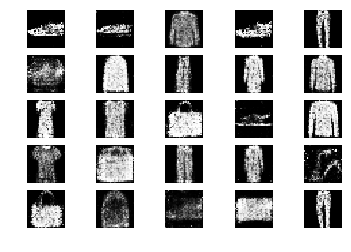

19101 [Discriminator loss: 0.647948, acc.: 60.94%] [Generator loss: 0.942192]
19102 [Discriminator loss: 0.667928, acc.: 60.94%] [Generator loss: 0.964758]
19103 [Discriminator loss: 0.639530, acc.: 62.50%] [Generator loss: 0.948924]
19104 [Discriminator loss: 0.582508, acc.: 70.31%] [Generator loss: 0.919273]
19105 [Discriminator loss: 0.560193, acc.: 68.75%] [Generator loss: 1.020962]
19106 [Discriminator loss: 0.642570, acc.: 57.81%] [Generator loss: 0.882044]
19107 [Discriminator loss: 0.607858, acc.: 67.19%] [Generator loss: 0.912024]
19108 [Discriminator loss: 0.668861, acc.: 64.06%] [Generator loss: 0.949071]
19109 [Discriminator loss: 0.707051, acc.: 57.81%] [Generator loss: 0.938434]
19110 [Discriminator loss: 0.687616, acc.: 56.25%] [Generator loss: 0.884783]
19111 [Discriminator loss: 0.662042, acc.: 56.25%] [Generator loss: 0.955336]
19112 [Discriminator loss: 0.590642, acc.: 70.31%] [Generator loss: 0.945874]
19113 [Discriminator loss: 0.613802, acc.: 68.75%] [Generator lo

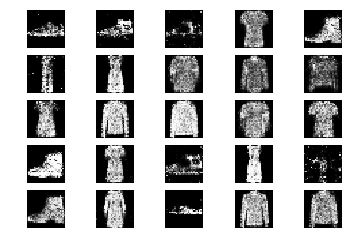

19201 [Discriminator loss: 0.727969, acc.: 51.56%] [Generator loss: 0.959481]
19202 [Discriminator loss: 0.629619, acc.: 62.50%] [Generator loss: 0.965325]
19203 [Discriminator loss: 0.623042, acc.: 68.75%] [Generator loss: 0.991046]
19204 [Discriminator loss: 0.624060, acc.: 57.81%] [Generator loss: 0.915660]
19205 [Discriminator loss: 0.683866, acc.: 56.25%] [Generator loss: 0.947730]
19206 [Discriminator loss: 0.658836, acc.: 59.38%] [Generator loss: 0.913525]
19207 [Discriminator loss: 0.634139, acc.: 67.19%] [Generator loss: 0.982486]
19208 [Discriminator loss: 0.632750, acc.: 67.19%] [Generator loss: 0.931467]
19209 [Discriminator loss: 0.622205, acc.: 64.06%] [Generator loss: 1.052849]
19210 [Discriminator loss: 0.651890, acc.: 57.81%] [Generator loss: 0.873039]
19211 [Discriminator loss: 0.621660, acc.: 67.19%] [Generator loss: 1.048037]
19212 [Discriminator loss: 0.623061, acc.: 64.06%] [Generator loss: 1.098041]
19213 [Discriminator loss: 0.674338, acc.: 64.06%] [Generator lo

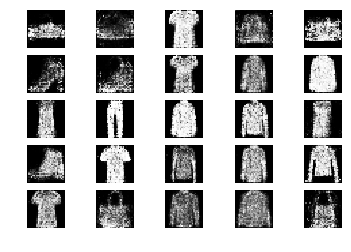

19301 [Discriminator loss: 0.688871, acc.: 56.25%] [Generator loss: 0.985623]
19302 [Discriminator loss: 0.626096, acc.: 60.94%] [Generator loss: 0.922254]
19303 [Discriminator loss: 0.635836, acc.: 59.38%] [Generator loss: 0.928458]
19304 [Discriminator loss: 0.575423, acc.: 67.19%] [Generator loss: 0.916828]
19305 [Discriminator loss: 0.624279, acc.: 64.06%] [Generator loss: 0.967927]
19306 [Discriminator loss: 0.691427, acc.: 56.25%] [Generator loss: 0.994439]
19307 [Discriminator loss: 0.720095, acc.: 57.81%] [Generator loss: 1.055822]
19308 [Discriminator loss: 0.614711, acc.: 65.62%] [Generator loss: 1.004985]
19309 [Discriminator loss: 0.621480, acc.: 65.62%] [Generator loss: 0.966105]
19310 [Discriminator loss: 0.657574, acc.: 56.25%] [Generator loss: 0.926665]
19311 [Discriminator loss: 0.663186, acc.: 54.69%] [Generator loss: 0.941293]
19312 [Discriminator loss: 0.647875, acc.: 60.94%] [Generator loss: 0.922320]
19313 [Discriminator loss: 0.573273, acc.: 75.00%] [Generator lo

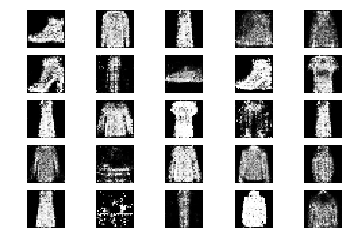

19401 [Discriminator loss: 0.610758, acc.: 64.06%] [Generator loss: 0.986122]
19402 [Discriminator loss: 0.689819, acc.: 56.25%] [Generator loss: 0.934692]
19403 [Discriminator loss: 0.677057, acc.: 59.38%] [Generator loss: 0.963858]
19404 [Discriminator loss: 0.671081, acc.: 62.50%] [Generator loss: 0.940241]
19405 [Discriminator loss: 0.631066, acc.: 67.19%] [Generator loss: 0.974643]
19406 [Discriminator loss: 0.641938, acc.: 62.50%] [Generator loss: 1.010015]
19407 [Discriminator loss: 0.722326, acc.: 51.56%] [Generator loss: 1.092157]
19408 [Discriminator loss: 0.671821, acc.: 57.81%] [Generator loss: 0.980029]
19409 [Discriminator loss: 0.643460, acc.: 67.19%] [Generator loss: 0.913970]
19410 [Discriminator loss: 0.684141, acc.: 59.38%] [Generator loss: 0.873405]
19411 [Discriminator loss: 0.608677, acc.: 67.19%] [Generator loss: 0.943949]
19412 [Discriminator loss: 0.659921, acc.: 62.50%] [Generator loss: 1.027778]
19413 [Discriminator loss: 0.639551, acc.: 64.06%] [Generator lo

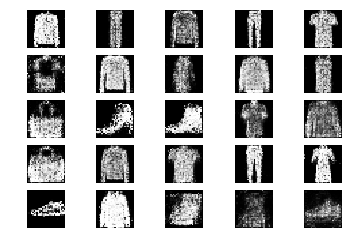

19501 [Discriminator loss: 0.638759, acc.: 67.19%] [Generator loss: 0.960776]
19502 [Discriminator loss: 0.665521, acc.: 65.62%] [Generator loss: 0.842765]
19503 [Discriminator loss: 0.688901, acc.: 53.12%] [Generator loss: 0.964933]
19504 [Discriminator loss: 0.677990, acc.: 54.69%] [Generator loss: 1.034680]
19505 [Discriminator loss: 0.665860, acc.: 65.62%] [Generator loss: 0.986610]
19506 [Discriminator loss: 0.676416, acc.: 64.06%] [Generator loss: 0.882826]
19507 [Discriminator loss: 0.634180, acc.: 65.62%] [Generator loss: 0.938726]
19508 [Discriminator loss: 0.607806, acc.: 64.06%] [Generator loss: 0.980452]
19509 [Discriminator loss: 0.613527, acc.: 64.06%] [Generator loss: 1.045738]
19510 [Discriminator loss: 0.665837, acc.: 60.94%] [Generator loss: 1.125308]
19511 [Discriminator loss: 0.614813, acc.: 70.31%] [Generator loss: 1.048457]
19512 [Discriminator loss: 0.608610, acc.: 64.06%] [Generator loss: 0.936477]
19513 [Discriminator loss: 0.605781, acc.: 62.50%] [Generator lo

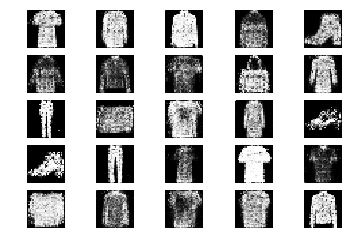

19601 [Discriminator loss: 0.685457, acc.: 59.38%] [Generator loss: 0.810365]
19602 [Discriminator loss: 0.662503, acc.: 59.38%] [Generator loss: 1.046253]
19603 [Discriminator loss: 0.640956, acc.: 64.06%] [Generator loss: 0.964877]
19604 [Discriminator loss: 0.659941, acc.: 54.69%] [Generator loss: 1.031601]
19605 [Discriminator loss: 0.688858, acc.: 59.38%] [Generator loss: 1.006612]
19606 [Discriminator loss: 0.624789, acc.: 62.50%] [Generator loss: 0.967457]
19607 [Discriminator loss: 0.700818, acc.: 42.19%] [Generator loss: 1.066283]
19608 [Discriminator loss: 0.625760, acc.: 65.62%] [Generator loss: 0.978539]
19609 [Discriminator loss: 0.661001, acc.: 62.50%] [Generator loss: 0.966170]
19610 [Discriminator loss: 0.670553, acc.: 57.81%] [Generator loss: 0.904633]
19611 [Discriminator loss: 0.650588, acc.: 59.38%] [Generator loss: 0.799665]
19612 [Discriminator loss: 0.696786, acc.: 54.69%] [Generator loss: 0.963191]
19613 [Discriminator loss: 0.693945, acc.: 53.12%] [Generator lo

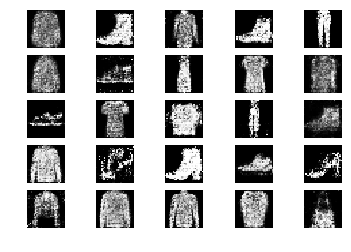

19701 [Discriminator loss: 0.612495, acc.: 62.50%] [Generator loss: 0.891354]
19702 [Discriminator loss: 0.629253, acc.: 62.50%] [Generator loss: 0.876791]
19703 [Discriminator loss: 0.591915, acc.: 68.75%] [Generator loss: 1.013719]
19704 [Discriminator loss: 0.627505, acc.: 62.50%] [Generator loss: 0.987676]
19705 [Discriminator loss: 0.652178, acc.: 57.81%] [Generator loss: 0.960093]
19706 [Discriminator loss: 0.608047, acc.: 68.75%] [Generator loss: 0.986747]
19707 [Discriminator loss: 0.695688, acc.: 54.69%] [Generator loss: 0.935378]
19708 [Discriminator loss: 0.575632, acc.: 76.56%] [Generator loss: 0.974275]
19709 [Discriminator loss: 0.565360, acc.: 71.88%] [Generator loss: 0.880537]
19710 [Discriminator loss: 0.702591, acc.: 51.56%] [Generator loss: 1.046154]
19711 [Discriminator loss: 0.577077, acc.: 67.19%] [Generator loss: 1.019770]
19712 [Discriminator loss: 0.687086, acc.: 57.81%] [Generator loss: 0.974793]
19713 [Discriminator loss: 0.686754, acc.: 60.94%] [Generator lo

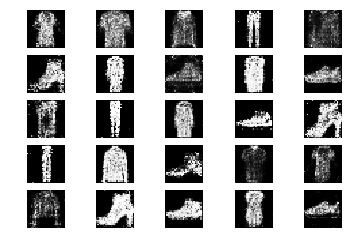

19801 [Discriminator loss: 0.628234, acc.: 65.62%] [Generator loss: 0.942811]
19802 [Discriminator loss: 0.615974, acc.: 65.62%] [Generator loss: 0.968349]
19803 [Discriminator loss: 0.639882, acc.: 64.06%] [Generator loss: 0.955382]
19804 [Discriminator loss: 0.733076, acc.: 48.44%] [Generator loss: 0.870188]
19805 [Discriminator loss: 0.637596, acc.: 60.94%] [Generator loss: 1.023014]
19806 [Discriminator loss: 0.651052, acc.: 62.50%] [Generator loss: 0.862254]
19807 [Discriminator loss: 0.622041, acc.: 70.31%] [Generator loss: 0.862479]
19808 [Discriminator loss: 0.655774, acc.: 60.94%] [Generator loss: 0.971506]
19809 [Discriminator loss: 0.569358, acc.: 71.88%] [Generator loss: 0.883871]
19810 [Discriminator loss: 0.672766, acc.: 65.62%] [Generator loss: 0.912686]
19811 [Discriminator loss: 0.703251, acc.: 64.06%] [Generator loss: 0.925436]
19812 [Discriminator loss: 0.614807, acc.: 65.62%] [Generator loss: 1.021441]
19813 [Discriminator loss: 0.599671, acc.: 70.31%] [Generator lo

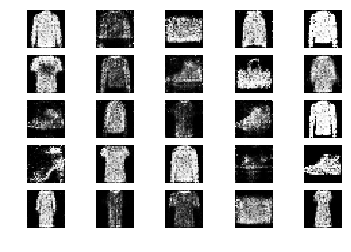

19901 [Discriminator loss: 0.670942, acc.: 59.38%] [Generator loss: 1.024149]
19902 [Discriminator loss: 0.643953, acc.: 59.38%] [Generator loss: 0.981624]
19903 [Discriminator loss: 0.649781, acc.: 56.25%] [Generator loss: 0.864984]
19904 [Discriminator loss: 0.629145, acc.: 64.06%] [Generator loss: 0.827913]
19905 [Discriminator loss: 0.644874, acc.: 54.69%] [Generator loss: 0.936982]
19906 [Discriminator loss: 0.664739, acc.: 60.94%] [Generator loss: 0.956144]
19907 [Discriminator loss: 0.604812, acc.: 70.31%] [Generator loss: 0.945548]
19908 [Discriminator loss: 0.683981, acc.: 57.81%] [Generator loss: 0.922900]
19909 [Discriminator loss: 0.601867, acc.: 75.00%] [Generator loss: 0.951752]
19910 [Discriminator loss: 0.617000, acc.: 71.88%] [Generator loss: 1.031285]
19911 [Discriminator loss: 0.647770, acc.: 60.94%] [Generator loss: 0.881239]
19912 [Discriminator loss: 0.603482, acc.: 70.31%] [Generator loss: 0.985110]
19913 [Discriminator loss: 0.634807, acc.: 60.94%] [Generator lo

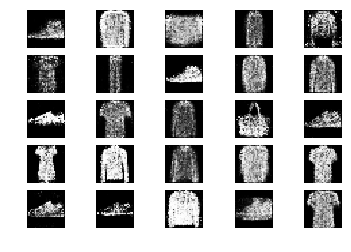

20001 [Discriminator loss: 0.708394, acc.: 53.12%] [Generator loss: 0.977574]
20002 [Discriminator loss: 0.641382, acc.: 54.69%] [Generator loss: 1.148223]
20003 [Discriminator loss: 0.632674, acc.: 65.62%] [Generator loss: 0.960089]
20004 [Discriminator loss: 0.640443, acc.: 56.25%] [Generator loss: 0.910383]
20005 [Discriminator loss: 0.642304, acc.: 67.19%] [Generator loss: 0.960420]
20006 [Discriminator loss: 0.647849, acc.: 62.50%] [Generator loss: 0.930055]
20007 [Discriminator loss: 0.693460, acc.: 54.69%] [Generator loss: 0.969605]
20008 [Discriminator loss: 0.623333, acc.: 65.62%] [Generator loss: 0.940803]
20009 [Discriminator loss: 0.607105, acc.: 75.00%] [Generator loss: 0.870497]
20010 [Discriminator loss: 0.706380, acc.: 57.81%] [Generator loss: 0.893003]
20011 [Discriminator loss: 0.610000, acc.: 75.00%] [Generator loss: 0.950016]
20012 [Discriminator loss: 0.609192, acc.: 68.75%] [Generator loss: 0.895287]
20013 [Discriminator loss: 0.651108, acc.: 65.62%] [Generator lo

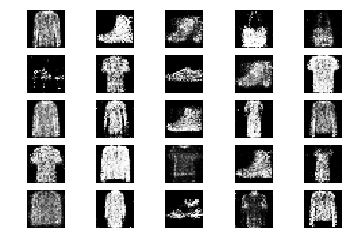

20101 [Discriminator loss: 0.664410, acc.: 60.94%] [Generator loss: 0.856595]
20102 [Discriminator loss: 0.657716, acc.: 57.81%] [Generator loss: 0.992734]
20103 [Discriminator loss: 0.544471, acc.: 76.56%] [Generator loss: 0.901021]
20104 [Discriminator loss: 0.593459, acc.: 67.19%] [Generator loss: 0.788955]
20105 [Discriminator loss: 0.666423, acc.: 59.38%] [Generator loss: 0.906201]
20106 [Discriminator loss: 0.665675, acc.: 64.06%] [Generator loss: 0.960180]
20107 [Discriminator loss: 0.535241, acc.: 78.12%] [Generator loss: 0.907559]
20108 [Discriminator loss: 0.649403, acc.: 64.06%] [Generator loss: 0.867210]
20109 [Discriminator loss: 0.735099, acc.: 51.56%] [Generator loss: 0.921443]
20110 [Discriminator loss: 0.635159, acc.: 65.62%] [Generator loss: 0.876396]
20111 [Discriminator loss: 0.648899, acc.: 64.06%] [Generator loss: 0.929333]
20112 [Discriminator loss: 0.650545, acc.: 64.06%] [Generator loss: 0.959662]
20113 [Discriminator loss: 0.618189, acc.: 68.75%] [Generator lo

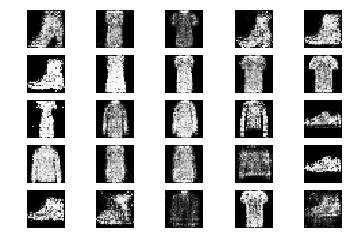

20201 [Discriminator loss: 0.672807, acc.: 60.94%] [Generator loss: 1.035846]
20202 [Discriminator loss: 0.591932, acc.: 70.31%] [Generator loss: 0.979370]
20203 [Discriminator loss: 0.595128, acc.: 71.88%] [Generator loss: 0.929255]
20204 [Discriminator loss: 0.612692, acc.: 67.19%] [Generator loss: 0.921358]
20205 [Discriminator loss: 0.629303, acc.: 62.50%] [Generator loss: 0.907643]
20206 [Discriminator loss: 0.554937, acc.: 73.44%] [Generator loss: 0.971276]
20207 [Discriminator loss: 0.605240, acc.: 71.88%] [Generator loss: 0.966018]
20208 [Discriminator loss: 0.593187, acc.: 62.50%] [Generator loss: 0.921343]
20209 [Discriminator loss: 0.689291, acc.: 57.81%] [Generator loss: 0.987338]
20210 [Discriminator loss: 0.630206, acc.: 65.62%] [Generator loss: 1.005022]
20211 [Discriminator loss: 0.633727, acc.: 62.50%] [Generator loss: 0.936221]
20212 [Discriminator loss: 0.665587, acc.: 59.38%] [Generator loss: 1.029490]
20213 [Discriminator loss: 0.672095, acc.: 54.69%] [Generator lo

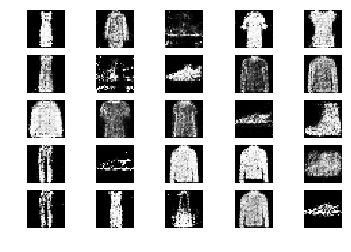

20301 [Discriminator loss: 0.629996, acc.: 64.06%] [Generator loss: 0.976528]
20302 [Discriminator loss: 0.648364, acc.: 65.62%] [Generator loss: 1.081707]
20303 [Discriminator loss: 0.648018, acc.: 57.81%] [Generator loss: 1.037904]
20304 [Discriminator loss: 0.626433, acc.: 65.62%] [Generator loss: 0.984995]
20305 [Discriminator loss: 0.636122, acc.: 59.38%] [Generator loss: 1.027930]
20306 [Discriminator loss: 0.632741, acc.: 68.75%] [Generator loss: 0.938749]
20307 [Discriminator loss: 0.616748, acc.: 73.44%] [Generator loss: 0.941039]
20308 [Discriminator loss: 0.681509, acc.: 57.81%] [Generator loss: 0.958143]
20309 [Discriminator loss: 0.651181, acc.: 57.81%] [Generator loss: 0.938676]
20310 [Discriminator loss: 0.634160, acc.: 59.38%] [Generator loss: 0.866592]
20311 [Discriminator loss: 0.586588, acc.: 67.19%] [Generator loss: 1.025229]
20312 [Discriminator loss: 0.649852, acc.: 62.50%] [Generator loss: 0.912066]
20313 [Discriminator loss: 0.588463, acc.: 73.44%] [Generator lo

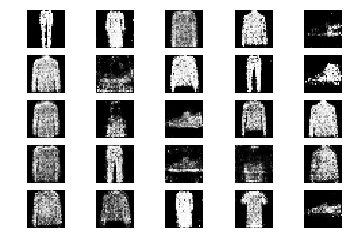

20401 [Discriminator loss: 0.646839, acc.: 59.38%] [Generator loss: 1.033221]
20402 [Discriminator loss: 0.649593, acc.: 60.94%] [Generator loss: 0.957968]
20403 [Discriminator loss: 0.620701, acc.: 65.62%] [Generator loss: 0.931684]
20404 [Discriminator loss: 0.684749, acc.: 57.81%] [Generator loss: 1.019300]
20405 [Discriminator loss: 0.576122, acc.: 71.88%] [Generator loss: 1.005937]
20406 [Discriminator loss: 0.645233, acc.: 62.50%] [Generator loss: 0.968675]
20407 [Discriminator loss: 0.699717, acc.: 53.12%] [Generator loss: 0.925282]
20408 [Discriminator loss: 0.661924, acc.: 53.12%] [Generator loss: 0.925287]
20409 [Discriminator loss: 0.623758, acc.: 62.50%] [Generator loss: 1.043915]
20410 [Discriminator loss: 0.725525, acc.: 48.44%] [Generator loss: 0.950571]
20411 [Discriminator loss: 0.650633, acc.: 57.81%] [Generator loss: 1.002108]
20412 [Discriminator loss: 0.671364, acc.: 57.81%] [Generator loss: 0.906461]
20413 [Discriminator loss: 0.669097, acc.: 57.81%] [Generator lo

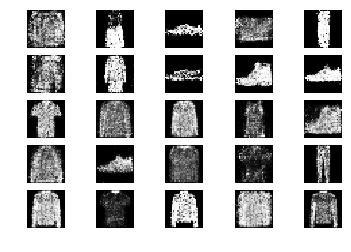

20501 [Discriminator loss: 0.672358, acc.: 60.94%] [Generator loss: 0.910246]
20502 [Discriminator loss: 0.686998, acc.: 59.38%] [Generator loss: 0.893999]
20503 [Discriminator loss: 0.612773, acc.: 68.75%] [Generator loss: 0.981482]
20504 [Discriminator loss: 0.688839, acc.: 54.69%] [Generator loss: 0.962795]
20505 [Discriminator loss: 0.665143, acc.: 60.94%] [Generator loss: 0.960676]
20506 [Discriminator loss: 0.673153, acc.: 59.38%] [Generator loss: 0.897170]
20507 [Discriminator loss: 0.638396, acc.: 60.94%] [Generator loss: 0.903440]
20508 [Discriminator loss: 0.681013, acc.: 59.38%] [Generator loss: 0.884761]
20509 [Discriminator loss: 0.680843, acc.: 56.25%] [Generator loss: 0.949049]
20510 [Discriminator loss: 0.598681, acc.: 67.19%] [Generator loss: 0.919937]
20511 [Discriminator loss: 0.609593, acc.: 65.62%] [Generator loss: 0.919012]
20512 [Discriminator loss: 0.569516, acc.: 73.44%] [Generator loss: 0.984492]
20513 [Discriminator loss: 0.545059, acc.: 75.00%] [Generator lo

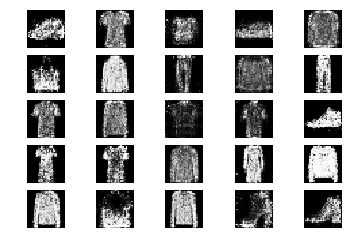

20601 [Discriminator loss: 0.640721, acc.: 59.38%] [Generator loss: 0.905279]
20602 [Discriminator loss: 0.712507, acc.: 50.00%] [Generator loss: 0.813983]
20603 [Discriminator loss: 0.614056, acc.: 64.06%] [Generator loss: 0.869026]
20604 [Discriminator loss: 0.566261, acc.: 67.19%] [Generator loss: 1.047005]
20605 [Discriminator loss: 0.698353, acc.: 54.69%] [Generator loss: 0.852815]
20606 [Discriminator loss: 0.650223, acc.: 59.38%] [Generator loss: 0.844439]
20607 [Discriminator loss: 0.625323, acc.: 64.06%] [Generator loss: 0.936404]
20608 [Discriminator loss: 0.610982, acc.: 64.06%] [Generator loss: 0.962096]
20609 [Discriminator loss: 0.644549, acc.: 64.06%] [Generator loss: 0.916253]
20610 [Discriminator loss: 0.627397, acc.: 67.19%] [Generator loss: 0.885265]
20611 [Discriminator loss: 0.616121, acc.: 65.62%] [Generator loss: 0.884389]
20612 [Discriminator loss: 0.712614, acc.: 54.69%] [Generator loss: 0.827484]
20613 [Discriminator loss: 0.668821, acc.: 54.69%] [Generator lo

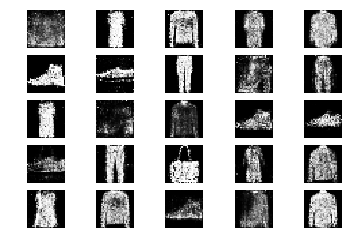

20701 [Discriminator loss: 0.588027, acc.: 70.31%] [Generator loss: 1.132977]
20702 [Discriminator loss: 0.629821, acc.: 70.31%] [Generator loss: 0.978511]
20703 [Discriminator loss: 0.657922, acc.: 64.06%] [Generator loss: 0.992215]
20704 [Discriminator loss: 0.628543, acc.: 68.75%] [Generator loss: 0.863664]
20705 [Discriminator loss: 0.623339, acc.: 70.31%] [Generator loss: 0.964839]
20706 [Discriminator loss: 0.616728, acc.: 65.62%] [Generator loss: 0.961589]
20707 [Discriminator loss: 0.631402, acc.: 60.94%] [Generator loss: 0.943457]
20708 [Discriminator loss: 0.669337, acc.: 60.94%] [Generator loss: 0.936578]
20709 [Discriminator loss: 0.640247, acc.: 70.31%] [Generator loss: 0.882356]
20710 [Discriminator loss: 0.603191, acc.: 70.31%] [Generator loss: 0.860890]
20711 [Discriminator loss: 0.581459, acc.: 65.62%] [Generator loss: 0.992790]
20712 [Discriminator loss: 0.629849, acc.: 65.62%] [Generator loss: 0.984681]
20713 [Discriminator loss: 0.622593, acc.: 59.38%] [Generator lo

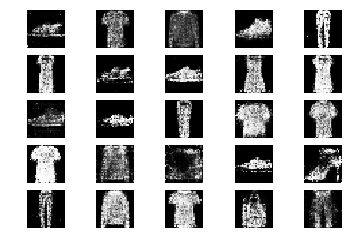

20801 [Discriminator loss: 0.683429, acc.: 59.38%] [Generator loss: 0.959816]
20802 [Discriminator loss: 0.618856, acc.: 67.19%] [Generator loss: 1.034366]
20803 [Discriminator loss: 0.674650, acc.: 62.50%] [Generator loss: 0.888673]
20804 [Discriminator loss: 0.629716, acc.: 68.75%] [Generator loss: 0.963213]
20805 [Discriminator loss: 0.709992, acc.: 50.00%] [Generator loss: 1.040462]
20806 [Discriminator loss: 0.599230, acc.: 68.75%] [Generator loss: 0.917386]
20807 [Discriminator loss: 0.679626, acc.: 60.94%] [Generator loss: 0.886774]
20808 [Discriminator loss: 0.548070, acc.: 82.81%] [Generator loss: 0.853465]
20809 [Discriminator loss: 0.609447, acc.: 59.38%] [Generator loss: 0.956200]
20810 [Discriminator loss: 0.594960, acc.: 62.50%] [Generator loss: 0.921114]
20811 [Discriminator loss: 0.655230, acc.: 60.94%] [Generator loss: 0.922428]
20812 [Discriminator loss: 0.649108, acc.: 64.06%] [Generator loss: 0.910814]
20813 [Discriminator loss: 0.578524, acc.: 71.88%] [Generator lo

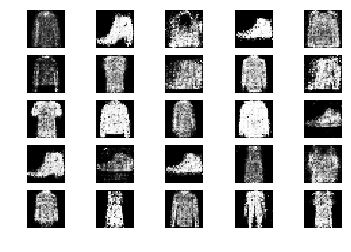

20901 [Discriminator loss: 0.669360, acc.: 60.94%] [Generator loss: 1.029901]
20902 [Discriminator loss: 0.588108, acc.: 68.75%] [Generator loss: 1.068410]
20903 [Discriminator loss: 0.650621, acc.: 56.25%] [Generator loss: 1.072909]
20904 [Discriminator loss: 0.692715, acc.: 59.38%] [Generator loss: 0.907220]
20905 [Discriminator loss: 0.647083, acc.: 64.06%] [Generator loss: 1.008129]
20906 [Discriminator loss: 0.651908, acc.: 59.38%] [Generator loss: 0.858891]
20907 [Discriminator loss: 0.750218, acc.: 45.31%] [Generator loss: 0.906340]
20908 [Discriminator loss: 0.625602, acc.: 62.50%] [Generator loss: 0.836790]
20909 [Discriminator loss: 0.660907, acc.: 57.81%] [Generator loss: 0.858389]
20910 [Discriminator loss: 0.627910, acc.: 65.62%] [Generator loss: 0.941611]
20911 [Discriminator loss: 0.671638, acc.: 60.94%] [Generator loss: 0.988359]
20912 [Discriminator loss: 0.569039, acc.: 75.00%] [Generator loss: 0.921821]
20913 [Discriminator loss: 0.621913, acc.: 60.94%] [Generator lo

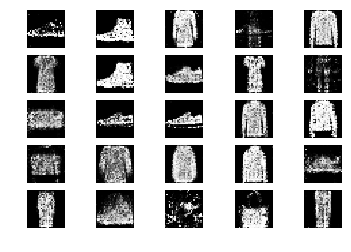

21001 [Discriminator loss: 0.622162, acc.: 64.06%] [Generator loss: 0.887947]
21002 [Discriminator loss: 0.654544, acc.: 56.25%] [Generator loss: 1.001014]
21003 [Discriminator loss: 0.604672, acc.: 67.19%] [Generator loss: 1.017798]
21004 [Discriminator loss: 0.643471, acc.: 54.69%] [Generator loss: 0.897165]
21005 [Discriminator loss: 0.625030, acc.: 64.06%] [Generator loss: 0.956976]
21006 [Discriminator loss: 0.593068, acc.: 68.75%] [Generator loss: 0.888761]
21007 [Discriminator loss: 0.661062, acc.: 62.50%] [Generator loss: 0.921633]
21008 [Discriminator loss: 0.644922, acc.: 64.06%] [Generator loss: 0.947576]
21009 [Discriminator loss: 0.628770, acc.: 64.06%] [Generator loss: 0.997761]
21010 [Discriminator loss: 0.732694, acc.: 53.12%] [Generator loss: 0.922781]
21011 [Discriminator loss: 0.723490, acc.: 48.44%] [Generator loss: 0.875317]
21012 [Discriminator loss: 0.626445, acc.: 60.94%] [Generator loss: 1.017592]
21013 [Discriminator loss: 0.672357, acc.: 56.25%] [Generator lo

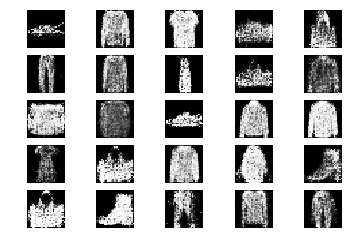

21101 [Discriminator loss: 0.595140, acc.: 70.31%] [Generator loss: 0.915397]
21102 [Discriminator loss: 0.622847, acc.: 64.06%] [Generator loss: 0.974687]
21103 [Discriminator loss: 0.695743, acc.: 60.94%] [Generator loss: 0.951399]
21104 [Discriminator loss: 0.630330, acc.: 67.19%] [Generator loss: 0.998248]
21105 [Discriminator loss: 0.638928, acc.: 67.19%] [Generator loss: 0.987729]
21106 [Discriminator loss: 0.692067, acc.: 56.25%] [Generator loss: 0.903566]
21107 [Discriminator loss: 0.703479, acc.: 48.44%] [Generator loss: 0.856638]
21108 [Discriminator loss: 0.626941, acc.: 76.56%] [Generator loss: 0.941753]
21109 [Discriminator loss: 0.688436, acc.: 54.69%] [Generator loss: 0.910693]
21110 [Discriminator loss: 0.719251, acc.: 51.56%] [Generator loss: 0.850894]
21111 [Discriminator loss: 0.582137, acc.: 75.00%] [Generator loss: 0.898495]
21112 [Discriminator loss: 0.632978, acc.: 65.62%] [Generator loss: 0.925572]
21113 [Discriminator loss: 0.672556, acc.: 60.94%] [Generator lo

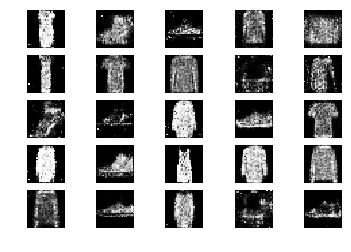

21201 [Discriminator loss: 0.627331, acc.: 62.50%] [Generator loss: 0.967357]
21202 [Discriminator loss: 0.572974, acc.: 75.00%] [Generator loss: 1.011150]
21203 [Discriminator loss: 0.590609, acc.: 67.19%] [Generator loss: 0.907480]
21204 [Discriminator loss: 0.616380, acc.: 64.06%] [Generator loss: 0.909588]
21205 [Discriminator loss: 0.702288, acc.: 53.12%] [Generator loss: 0.897272]
21206 [Discriminator loss: 0.657262, acc.: 68.75%] [Generator loss: 0.942230]
21207 [Discriminator loss: 0.620789, acc.: 65.62%] [Generator loss: 0.982150]
21208 [Discriminator loss: 0.674765, acc.: 51.56%] [Generator loss: 0.910069]
21209 [Discriminator loss: 0.653469, acc.: 56.25%] [Generator loss: 0.964182]
21210 [Discriminator loss: 0.626873, acc.: 70.31%] [Generator loss: 0.925563]
21211 [Discriminator loss: 0.606451, acc.: 67.19%] [Generator loss: 0.932438]
21212 [Discriminator loss: 0.598915, acc.: 68.75%] [Generator loss: 0.954878]
21213 [Discriminator loss: 0.694209, acc.: 54.69%] [Generator lo

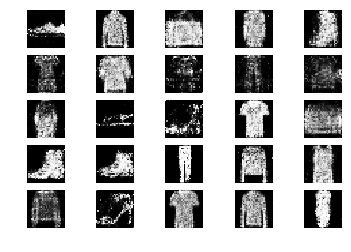

21301 [Discriminator loss: 0.655290, acc.: 59.38%] [Generator loss: 0.996716]
21302 [Discriminator loss: 0.690701, acc.: 54.69%] [Generator loss: 0.972415]
21303 [Discriminator loss: 0.604252, acc.: 62.50%] [Generator loss: 0.791435]
21304 [Discriminator loss: 0.630553, acc.: 65.62%] [Generator loss: 0.852417]
21305 [Discriminator loss: 0.638968, acc.: 57.81%] [Generator loss: 0.883447]
21306 [Discriminator loss: 0.752564, acc.: 45.31%] [Generator loss: 0.879734]
21307 [Discriminator loss: 0.624486, acc.: 64.06%] [Generator loss: 0.973258]
21308 [Discriminator loss: 0.668483, acc.: 59.38%] [Generator loss: 0.934304]
21309 [Discriminator loss: 0.663946, acc.: 59.38%] [Generator loss: 0.942700]
21310 [Discriminator loss: 0.654928, acc.: 62.50%] [Generator loss: 0.885001]
21311 [Discriminator loss: 0.696317, acc.: 54.69%] [Generator loss: 0.861416]
21312 [Discriminator loss: 0.752248, acc.: 50.00%] [Generator loss: 0.919513]
21313 [Discriminator loss: 0.631753, acc.: 62.50%] [Generator lo

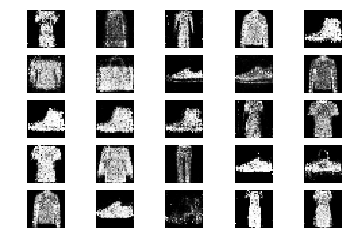

21401 [Discriminator loss: 0.630090, acc.: 62.50%] [Generator loss: 0.920615]
21402 [Discriminator loss: 0.657992, acc.: 65.62%] [Generator loss: 0.954747]
21403 [Discriminator loss: 0.744906, acc.: 40.62%] [Generator loss: 0.942788]
21404 [Discriminator loss: 0.651479, acc.: 56.25%] [Generator loss: 1.000935]
21405 [Discriminator loss: 0.582765, acc.: 73.44%] [Generator loss: 0.980028]
21406 [Discriminator loss: 0.717786, acc.: 51.56%] [Generator loss: 0.936839]
21407 [Discriminator loss: 0.629637, acc.: 71.88%] [Generator loss: 0.968028]
21408 [Discriminator loss: 0.578260, acc.: 68.75%] [Generator loss: 1.040851]
21409 [Discriminator loss: 0.583454, acc.: 68.75%] [Generator loss: 0.914282]
21410 [Discriminator loss: 0.584077, acc.: 68.75%] [Generator loss: 0.969220]
21411 [Discriminator loss: 0.672574, acc.: 57.81%] [Generator loss: 0.958791]
21412 [Discriminator loss: 0.636963, acc.: 54.69%] [Generator loss: 0.997849]
21413 [Discriminator loss: 0.662119, acc.: 60.94%] [Generator lo

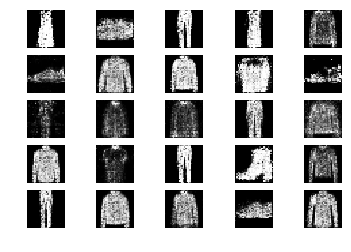

21501 [Discriminator loss: 0.632703, acc.: 60.94%] [Generator loss: 0.928454]
21502 [Discriminator loss: 0.665206, acc.: 54.69%] [Generator loss: 0.965158]
21503 [Discriminator loss: 0.665076, acc.: 56.25%] [Generator loss: 1.006557]
21504 [Discriminator loss: 0.599724, acc.: 68.75%] [Generator loss: 0.930596]
21505 [Discriminator loss: 0.535673, acc.: 81.25%] [Generator loss: 1.001907]
21506 [Discriminator loss: 0.600461, acc.: 68.75%] [Generator loss: 1.089143]
21507 [Discriminator loss: 0.635257, acc.: 64.06%] [Generator loss: 0.975317]
21508 [Discriminator loss: 0.640054, acc.: 56.25%] [Generator loss: 0.989054]
21509 [Discriminator loss: 0.632708, acc.: 62.50%] [Generator loss: 0.974247]
21510 [Discriminator loss: 0.643533, acc.: 65.62%] [Generator loss: 0.940572]
21511 [Discriminator loss: 0.654670, acc.: 64.06%] [Generator loss: 0.844170]
21512 [Discriminator loss: 0.658330, acc.: 62.50%] [Generator loss: 0.909354]
21513 [Discriminator loss: 0.663700, acc.: 56.25%] [Generator lo

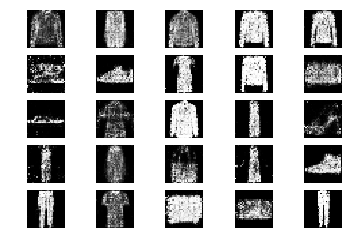

21601 [Discriminator loss: 0.613119, acc.: 67.19%] [Generator loss: 0.913045]
21602 [Discriminator loss: 0.588875, acc.: 70.31%] [Generator loss: 1.100438]
21603 [Discriminator loss: 0.652386, acc.: 56.25%] [Generator loss: 1.005704]
21604 [Discriminator loss: 0.682366, acc.: 56.25%] [Generator loss: 1.038769]
21605 [Discriminator loss: 0.678977, acc.: 60.94%] [Generator loss: 0.918659]
21606 [Discriminator loss: 0.698169, acc.: 57.81%] [Generator loss: 0.901237]
21607 [Discriminator loss: 0.671236, acc.: 54.69%] [Generator loss: 0.974682]
21608 [Discriminator loss: 0.589822, acc.: 64.06%] [Generator loss: 1.009823]
21609 [Discriminator loss: 0.601327, acc.: 73.44%] [Generator loss: 0.967080]
21610 [Discriminator loss: 0.620573, acc.: 67.19%] [Generator loss: 0.932969]
21611 [Discriminator loss: 0.630771, acc.: 68.75%] [Generator loss: 1.012661]
21612 [Discriminator loss: 0.585803, acc.: 71.88%] [Generator loss: 1.100233]
21613 [Discriminator loss: 0.612450, acc.: 60.94%] [Generator lo

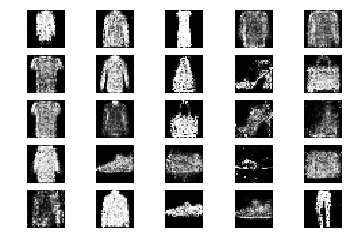

21701 [Discriminator loss: 0.587103, acc.: 73.44%] [Generator loss: 0.891666]
21702 [Discriminator loss: 0.684684, acc.: 50.00%] [Generator loss: 0.925555]
21703 [Discriminator loss: 0.653553, acc.: 59.38%] [Generator loss: 0.912460]
21704 [Discriminator loss: 0.665653, acc.: 57.81%] [Generator loss: 0.896368]
21705 [Discriminator loss: 0.647525, acc.: 59.38%] [Generator loss: 0.942266]
21706 [Discriminator loss: 0.631135, acc.: 64.06%] [Generator loss: 0.927133]
21707 [Discriminator loss: 0.717978, acc.: 53.12%] [Generator loss: 0.909763]
21708 [Discriminator loss: 0.630969, acc.: 64.06%] [Generator loss: 0.952161]
21709 [Discriminator loss: 0.611771, acc.: 68.75%] [Generator loss: 0.918490]
21710 [Discriminator loss: 0.647711, acc.: 67.19%] [Generator loss: 0.887912]
21711 [Discriminator loss: 0.682586, acc.: 56.25%] [Generator loss: 0.914503]
21712 [Discriminator loss: 0.634530, acc.: 62.50%] [Generator loss: 0.916610]
21713 [Discriminator loss: 0.660995, acc.: 59.38%] [Generator lo

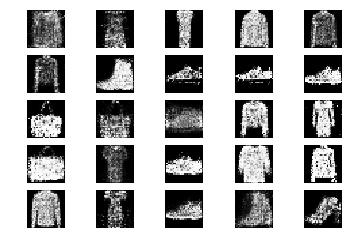

21801 [Discriminator loss: 0.662501, acc.: 57.81%] [Generator loss: 0.891986]
21802 [Discriminator loss: 0.588381, acc.: 71.88%] [Generator loss: 0.934601]
21803 [Discriminator loss: 0.700215, acc.: 56.25%] [Generator loss: 0.942139]
21804 [Discriminator loss: 0.625633, acc.: 60.94%] [Generator loss: 0.924074]
21805 [Discriminator loss: 0.584692, acc.: 65.62%] [Generator loss: 0.927629]
21806 [Discriminator loss: 0.636506, acc.: 67.19%] [Generator loss: 0.977721]
21807 [Discriminator loss: 0.660173, acc.: 64.06%] [Generator loss: 0.934034]
21808 [Discriminator loss: 0.660443, acc.: 60.94%] [Generator loss: 0.899691]
21809 [Discriminator loss: 0.681742, acc.: 57.81%] [Generator loss: 0.925320]
21810 [Discriminator loss: 0.610891, acc.: 67.19%] [Generator loss: 0.991760]
21811 [Discriminator loss: 0.717523, acc.: 54.69%] [Generator loss: 0.994705]
21812 [Discriminator loss: 0.622904, acc.: 64.06%] [Generator loss: 0.980421]
21813 [Discriminator loss: 0.678351, acc.: 53.12%] [Generator lo

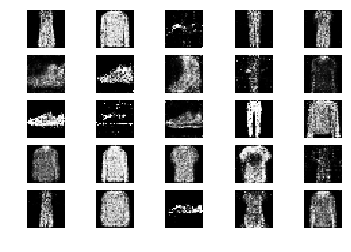

21901 [Discriminator loss: 0.632170, acc.: 71.88%] [Generator loss: 0.952326]
21902 [Discriminator loss: 0.645929, acc.: 64.06%] [Generator loss: 0.890156]
21903 [Discriminator loss: 0.595861, acc.: 71.88%] [Generator loss: 0.928934]
21904 [Discriminator loss: 0.713551, acc.: 48.44%] [Generator loss: 0.933919]
21905 [Discriminator loss: 0.664626, acc.: 53.12%] [Generator loss: 0.821448]
21906 [Discriminator loss: 0.667645, acc.: 59.38%] [Generator loss: 0.793126]
21907 [Discriminator loss: 0.714435, acc.: 57.81%] [Generator loss: 0.845061]
21908 [Discriminator loss: 0.608590, acc.: 75.00%] [Generator loss: 0.943999]
21909 [Discriminator loss: 0.671148, acc.: 53.12%] [Generator loss: 0.983810]
21910 [Discriminator loss: 0.688975, acc.: 53.12%] [Generator loss: 0.928164]
21911 [Discriminator loss: 0.683946, acc.: 60.94%] [Generator loss: 0.938831]
21912 [Discriminator loss: 0.665176, acc.: 57.81%] [Generator loss: 1.087248]
21913 [Discriminator loss: 0.658574, acc.: 54.69%] [Generator lo

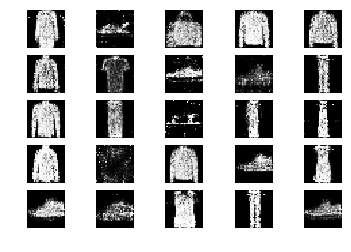

22001 [Discriminator loss: 0.678382, acc.: 56.25%] [Generator loss: 0.938133]
22002 [Discriminator loss: 0.639297, acc.: 64.06%] [Generator loss: 1.007895]
22003 [Discriminator loss: 0.633287, acc.: 70.31%] [Generator loss: 0.947590]
22004 [Discriminator loss: 0.588030, acc.: 67.19%] [Generator loss: 0.993726]
22005 [Discriminator loss: 0.658740, acc.: 57.81%] [Generator loss: 0.983913]
22006 [Discriminator loss: 0.642014, acc.: 59.38%] [Generator loss: 1.040852]
22007 [Discriminator loss: 0.679266, acc.: 60.94%] [Generator loss: 0.977225]
22008 [Discriminator loss: 0.608553, acc.: 68.75%] [Generator loss: 1.075494]
22009 [Discriminator loss: 0.646055, acc.: 59.38%] [Generator loss: 0.979605]
22010 [Discriminator loss: 0.631417, acc.: 64.06%] [Generator loss: 0.994870]
22011 [Discriminator loss: 0.733920, acc.: 51.56%] [Generator loss: 0.850229]
22012 [Discriminator loss: 0.635165, acc.: 62.50%] [Generator loss: 0.924759]
22013 [Discriminator loss: 0.593803, acc.: 67.19%] [Generator lo

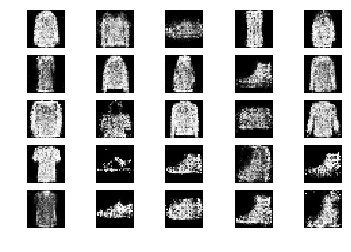

22101 [Discriminator loss: 0.674431, acc.: 54.69%] [Generator loss: 0.949365]
22102 [Discriminator loss: 0.620624, acc.: 67.19%] [Generator loss: 0.988615]
22103 [Discriminator loss: 0.625489, acc.: 67.19%] [Generator loss: 0.938298]
22104 [Discriminator loss: 0.596225, acc.: 71.88%] [Generator loss: 1.047169]
22105 [Discriminator loss: 0.656818, acc.: 54.69%] [Generator loss: 0.965444]
22106 [Discriminator loss: 0.587516, acc.: 65.62%] [Generator loss: 0.884422]
22107 [Discriminator loss: 0.614141, acc.: 70.31%] [Generator loss: 0.883381]
22108 [Discriminator loss: 0.592390, acc.: 68.75%] [Generator loss: 0.930115]
22109 [Discriminator loss: 0.620140, acc.: 67.19%] [Generator loss: 0.952440]
22110 [Discriminator loss: 0.606942, acc.: 67.19%] [Generator loss: 1.010555]
22111 [Discriminator loss: 0.687347, acc.: 57.81%] [Generator loss: 1.031940]
22112 [Discriminator loss: 0.627250, acc.: 67.19%] [Generator loss: 0.909732]
22113 [Discriminator loss: 0.689999, acc.: 57.81%] [Generator lo

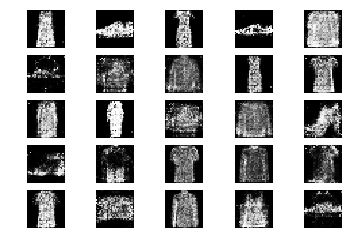

22201 [Discriminator loss: 0.634159, acc.: 67.19%] [Generator loss: 0.847846]
22202 [Discriminator loss: 0.671913, acc.: 57.81%] [Generator loss: 1.015544]
22203 [Discriminator loss: 0.639634, acc.: 62.50%] [Generator loss: 1.064534]
22204 [Discriminator loss: 0.597212, acc.: 70.31%] [Generator loss: 1.086038]
22205 [Discriminator loss: 0.634749, acc.: 65.62%] [Generator loss: 1.138910]
22206 [Discriminator loss: 0.670132, acc.: 59.38%] [Generator loss: 1.078732]
22207 [Discriminator loss: 0.666081, acc.: 56.25%] [Generator loss: 0.919912]
22208 [Discriminator loss: 0.651912, acc.: 64.06%] [Generator loss: 0.997838]
22209 [Discriminator loss: 0.624821, acc.: 65.62%] [Generator loss: 1.045686]
22210 [Discriminator loss: 0.658976, acc.: 56.25%] [Generator loss: 0.989957]
22211 [Discriminator loss: 0.601752, acc.: 73.44%] [Generator loss: 1.074147]
22212 [Discriminator loss: 0.702851, acc.: 60.94%] [Generator loss: 0.936081]
22213 [Discriminator loss: 0.624931, acc.: 67.19%] [Generator lo

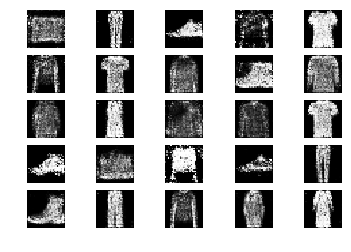

22301 [Discriminator loss: 0.665001, acc.: 56.25%] [Generator loss: 0.969185]
22302 [Discriminator loss: 0.664055, acc.: 62.50%] [Generator loss: 0.786646]
22303 [Discriminator loss: 0.670468, acc.: 59.38%] [Generator loss: 0.864114]
22304 [Discriminator loss: 0.697393, acc.: 56.25%] [Generator loss: 0.884201]
22305 [Discriminator loss: 0.657411, acc.: 59.38%] [Generator loss: 0.836983]
22306 [Discriminator loss: 0.656059, acc.: 62.50%] [Generator loss: 0.866270]
22307 [Discriminator loss: 0.656114, acc.: 62.50%] [Generator loss: 0.961855]
22308 [Discriminator loss: 0.649987, acc.: 60.94%] [Generator loss: 1.000271]
22309 [Discriminator loss: 0.617576, acc.: 68.75%] [Generator loss: 1.073771]
22310 [Discriminator loss: 0.592890, acc.: 70.31%] [Generator loss: 1.050196]
22311 [Discriminator loss: 0.697446, acc.: 53.12%] [Generator loss: 1.079226]
22312 [Discriminator loss: 0.658027, acc.: 59.38%] [Generator loss: 1.028824]
22313 [Discriminator loss: 0.627729, acc.: 60.94%] [Generator lo

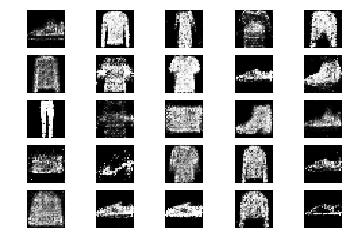

22401 [Discriminator loss: 0.622639, acc.: 68.75%] [Generator loss: 1.031490]
22402 [Discriminator loss: 0.575570, acc.: 71.88%] [Generator loss: 0.931065]
22403 [Discriminator loss: 0.685714, acc.: 62.50%] [Generator loss: 1.023121]
22404 [Discriminator loss: 0.624998, acc.: 70.31%] [Generator loss: 1.008972]
22405 [Discriminator loss: 0.676898, acc.: 57.81%] [Generator loss: 0.970669]
22406 [Discriminator loss: 0.624734, acc.: 65.62%] [Generator loss: 0.966325]
22407 [Discriminator loss: 0.620114, acc.: 64.06%] [Generator loss: 0.969885]
22408 [Discriminator loss: 0.647263, acc.: 62.50%] [Generator loss: 1.025650]
22409 [Discriminator loss: 0.562051, acc.: 76.56%] [Generator loss: 0.887007]
22410 [Discriminator loss: 0.632075, acc.: 51.56%] [Generator loss: 0.830521]
22411 [Discriminator loss: 0.697784, acc.: 56.25%] [Generator loss: 0.893327]
22412 [Discriminator loss: 0.721286, acc.: 56.25%] [Generator loss: 0.871215]
22413 [Discriminator loss: 0.634304, acc.: 64.06%] [Generator lo

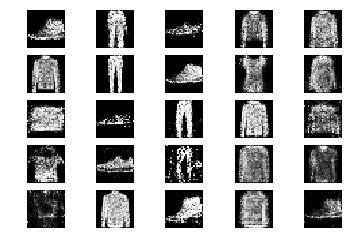

22501 [Discriminator loss: 0.623104, acc.: 62.50%] [Generator loss: 1.074400]
22502 [Discriminator loss: 0.659617, acc.: 60.94%] [Generator loss: 1.034183]
22503 [Discriminator loss: 0.629844, acc.: 64.06%] [Generator loss: 1.007859]
22504 [Discriminator loss: 0.658601, acc.: 56.25%] [Generator loss: 1.007641]
22505 [Discriminator loss: 0.642666, acc.: 64.06%] [Generator loss: 0.928054]
22506 [Discriminator loss: 0.628638, acc.: 64.06%] [Generator loss: 0.966836]
22507 [Discriminator loss: 0.628507, acc.: 65.62%] [Generator loss: 0.985134]
22508 [Discriminator loss: 0.644459, acc.: 67.19%] [Generator loss: 0.990294]
22509 [Discriminator loss: 0.614077, acc.: 70.31%] [Generator loss: 0.984960]
22510 [Discriminator loss: 0.610846, acc.: 60.94%] [Generator loss: 0.956956]
22511 [Discriminator loss: 0.642205, acc.: 59.38%] [Generator loss: 0.923815]
22512 [Discriminator loss: 0.683362, acc.: 57.81%] [Generator loss: 1.034080]
22513 [Discriminator loss: 0.643234, acc.: 62.50%] [Generator lo

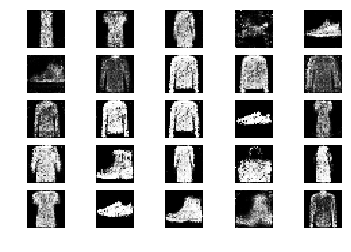

22601 [Discriminator loss: 0.643238, acc.: 62.50%] [Generator loss: 0.923819]
22602 [Discriminator loss: 0.517819, acc.: 85.94%] [Generator loss: 0.885131]
22603 [Discriminator loss: 0.666950, acc.: 56.25%] [Generator loss: 0.913518]
22604 [Discriminator loss: 0.634826, acc.: 62.50%] [Generator loss: 0.881820]
22605 [Discriminator loss: 0.618279, acc.: 65.62%] [Generator loss: 1.029985]
22606 [Discriminator loss: 0.609937, acc.: 67.19%] [Generator loss: 1.073908]
22607 [Discriminator loss: 0.610633, acc.: 70.31%] [Generator loss: 0.955479]
22608 [Discriminator loss: 0.673629, acc.: 51.56%] [Generator loss: 0.968506]
22609 [Discriminator loss: 0.710649, acc.: 48.44%] [Generator loss: 0.952455]
22610 [Discriminator loss: 0.685694, acc.: 59.38%] [Generator loss: 0.969809]
22611 [Discriminator loss: 0.672462, acc.: 59.38%] [Generator loss: 0.907528]
22612 [Discriminator loss: 0.600847, acc.: 73.44%] [Generator loss: 0.911739]
22613 [Discriminator loss: 0.629921, acc.: 64.06%] [Generator lo

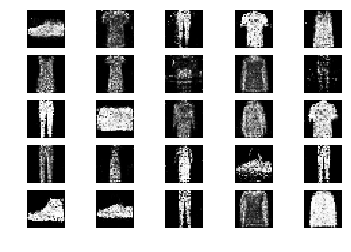

22701 [Discriminator loss: 0.678264, acc.: 65.62%] [Generator loss: 0.886442]
22702 [Discriminator loss: 0.746262, acc.: 56.25%] [Generator loss: 0.993773]
22703 [Discriminator loss: 0.611789, acc.: 62.50%] [Generator loss: 0.946878]
22704 [Discriminator loss: 0.639147, acc.: 62.50%] [Generator loss: 0.895344]
22705 [Discriminator loss: 0.583877, acc.: 70.31%] [Generator loss: 0.843385]
22706 [Discriminator loss: 0.639173, acc.: 62.50%] [Generator loss: 0.937574]
22707 [Discriminator loss: 0.568757, acc.: 70.31%] [Generator loss: 0.913191]
22708 [Discriminator loss: 0.694758, acc.: 56.25%] [Generator loss: 0.990293]
22709 [Discriminator loss: 0.686523, acc.: 54.69%] [Generator loss: 1.006696]
22710 [Discriminator loss: 0.654799, acc.: 60.94%] [Generator loss: 0.983277]
22711 [Discriminator loss: 0.631390, acc.: 67.19%] [Generator loss: 0.896081]
22712 [Discriminator loss: 0.716948, acc.: 51.56%] [Generator loss: 0.917002]
22713 [Discriminator loss: 0.577827, acc.: 75.00%] [Generator lo

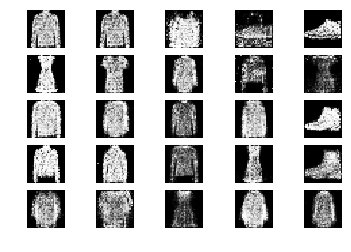

22801 [Discriminator loss: 0.650887, acc.: 67.19%] [Generator loss: 0.908738]
22802 [Discriminator loss: 0.692388, acc.: 53.12%] [Generator loss: 0.833219]
22803 [Discriminator loss: 0.625347, acc.: 57.81%] [Generator loss: 0.933780]
22804 [Discriminator loss: 0.663006, acc.: 60.94%] [Generator loss: 0.961443]
22805 [Discriminator loss: 0.574808, acc.: 70.31%] [Generator loss: 0.875731]
22806 [Discriminator loss: 0.671430, acc.: 54.69%] [Generator loss: 1.044851]
22807 [Discriminator loss: 0.693344, acc.: 57.81%] [Generator loss: 1.007010]
22808 [Discriminator loss: 0.645675, acc.: 59.38%] [Generator loss: 0.997786]
22809 [Discriminator loss: 0.664596, acc.: 56.25%] [Generator loss: 1.024311]
22810 [Discriminator loss: 0.643835, acc.: 67.19%] [Generator loss: 0.946113]
22811 [Discriminator loss: 0.669441, acc.: 57.81%] [Generator loss: 0.891033]
22812 [Discriminator loss: 0.747658, acc.: 50.00%] [Generator loss: 0.909151]
22813 [Discriminator loss: 0.622699, acc.: 70.31%] [Generator lo

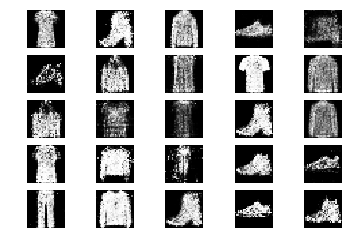

22901 [Discriminator loss: 0.630544, acc.: 64.06%] [Generator loss: 0.898399]
22902 [Discriminator loss: 0.765226, acc.: 56.25%] [Generator loss: 0.941431]
22903 [Discriminator loss: 0.760083, acc.: 53.12%] [Generator loss: 0.959098]
22904 [Discriminator loss: 0.649170, acc.: 60.94%] [Generator loss: 0.972402]
22905 [Discriminator loss: 0.631632, acc.: 54.69%] [Generator loss: 0.978776]
22906 [Discriminator loss: 0.691926, acc.: 59.38%] [Generator loss: 0.904885]
22907 [Discriminator loss: 0.623842, acc.: 67.19%] [Generator loss: 0.919839]
22908 [Discriminator loss: 0.651891, acc.: 57.81%] [Generator loss: 0.993829]
22909 [Discriminator loss: 0.547862, acc.: 76.56%] [Generator loss: 0.830392]
22910 [Discriminator loss: 0.592839, acc.: 70.31%] [Generator loss: 0.848386]
22911 [Discriminator loss: 0.599454, acc.: 68.75%] [Generator loss: 0.891619]
22912 [Discriminator loss: 0.647484, acc.: 65.62%] [Generator loss: 0.842913]
22913 [Discriminator loss: 0.692706, acc.: 59.38%] [Generator lo

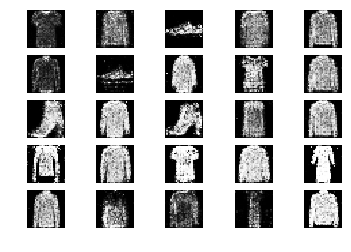

23001 [Discriminator loss: 0.666905, acc.: 62.50%] [Generator loss: 0.955865]
23002 [Discriminator loss: 0.665968, acc.: 59.38%] [Generator loss: 1.001357]
23003 [Discriminator loss: 0.697667, acc.: 57.81%] [Generator loss: 0.934209]
23004 [Discriminator loss: 0.652636, acc.: 60.94%] [Generator loss: 0.916600]
23005 [Discriminator loss: 0.622356, acc.: 67.19%] [Generator loss: 0.966980]
23006 [Discriminator loss: 0.655303, acc.: 64.06%] [Generator loss: 0.998602]
23007 [Discriminator loss: 0.655685, acc.: 62.50%] [Generator loss: 1.002833]
23008 [Discriminator loss: 0.574596, acc.: 68.75%] [Generator loss: 0.986179]
23009 [Discriminator loss: 0.693709, acc.: 56.25%] [Generator loss: 0.997744]
23010 [Discriminator loss: 0.627671, acc.: 65.62%] [Generator loss: 0.978308]
23011 [Discriminator loss: 0.635875, acc.: 64.06%] [Generator loss: 0.991497]
23012 [Discriminator loss: 0.586335, acc.: 68.75%] [Generator loss: 0.974645]
23013 [Discriminator loss: 0.617099, acc.: 70.31%] [Generator lo

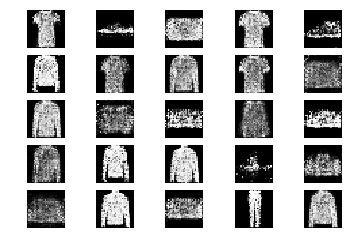

23101 [Discriminator loss: 0.657299, acc.: 56.25%] [Generator loss: 1.035007]
23102 [Discriminator loss: 0.631827, acc.: 57.81%] [Generator loss: 0.914596]
23103 [Discriminator loss: 0.745557, acc.: 57.81%] [Generator loss: 0.998975]
23104 [Discriminator loss: 0.700336, acc.: 57.81%] [Generator loss: 0.949559]
23105 [Discriminator loss: 0.644432, acc.: 59.38%] [Generator loss: 0.846957]
23106 [Discriminator loss: 0.693824, acc.: 56.25%] [Generator loss: 0.873116]
23107 [Discriminator loss: 0.625039, acc.: 68.75%] [Generator loss: 0.843462]
23108 [Discriminator loss: 0.613552, acc.: 65.62%] [Generator loss: 0.859777]
23109 [Discriminator loss: 0.654295, acc.: 67.19%] [Generator loss: 0.880307]
23110 [Discriminator loss: 0.612191, acc.: 64.06%] [Generator loss: 0.918421]
23111 [Discriminator loss: 0.579331, acc.: 70.31%] [Generator loss: 0.895834]
23112 [Discriminator loss: 0.580157, acc.: 64.06%] [Generator loss: 0.911912]
23113 [Discriminator loss: 0.612491, acc.: 67.19%] [Generator lo

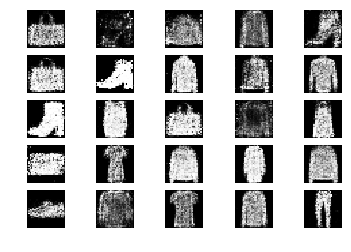

23201 [Discriminator loss: 0.639393, acc.: 65.62%] [Generator loss: 0.920330]
23202 [Discriminator loss: 0.654267, acc.: 64.06%] [Generator loss: 0.959562]
23203 [Discriminator loss: 0.601673, acc.: 70.31%] [Generator loss: 1.006944]
23204 [Discriminator loss: 0.622235, acc.: 64.06%] [Generator loss: 0.964450]
23205 [Discriminator loss: 0.635798, acc.: 60.94%] [Generator loss: 1.014444]
23206 [Discriminator loss: 0.669662, acc.: 59.38%] [Generator loss: 1.007102]
23207 [Discriminator loss: 0.711354, acc.: 54.69%] [Generator loss: 0.883543]
23208 [Discriminator loss: 0.667779, acc.: 57.81%] [Generator loss: 0.893386]
23209 [Discriminator loss: 0.688600, acc.: 62.50%] [Generator loss: 0.967244]
23210 [Discriminator loss: 0.660104, acc.: 51.56%] [Generator loss: 0.964641]
23211 [Discriminator loss: 0.616139, acc.: 64.06%] [Generator loss: 0.987837]
23212 [Discriminator loss: 0.736165, acc.: 48.44%] [Generator loss: 1.020009]
23213 [Discriminator loss: 0.627709, acc.: 59.38%] [Generator lo

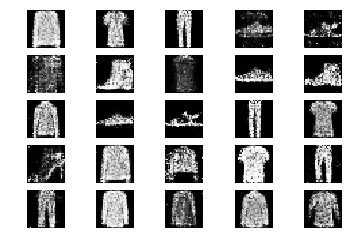

23301 [Discriminator loss: 0.677745, acc.: 57.81%] [Generator loss: 1.056017]
23302 [Discriminator loss: 0.651048, acc.: 64.06%] [Generator loss: 0.997714]
23303 [Discriminator loss: 0.624413, acc.: 67.19%] [Generator loss: 0.989948]
23304 [Discriminator loss: 0.609565, acc.: 64.06%] [Generator loss: 0.928302]
23305 [Discriminator loss: 0.611071, acc.: 73.44%] [Generator loss: 0.979774]
23306 [Discriminator loss: 0.607534, acc.: 70.31%] [Generator loss: 0.991675]
23307 [Discriminator loss: 0.649842, acc.: 65.62%] [Generator loss: 0.932227]
23308 [Discriminator loss: 0.633878, acc.: 68.75%] [Generator loss: 1.004471]
23309 [Discriminator loss: 0.694955, acc.: 48.44%] [Generator loss: 1.017700]
23310 [Discriminator loss: 0.645013, acc.: 57.81%] [Generator loss: 0.912957]
23311 [Discriminator loss: 0.641539, acc.: 64.06%] [Generator loss: 0.925972]
23312 [Discriminator loss: 0.634439, acc.: 67.19%] [Generator loss: 0.883858]
23313 [Discriminator loss: 0.650827, acc.: 64.06%] [Generator lo

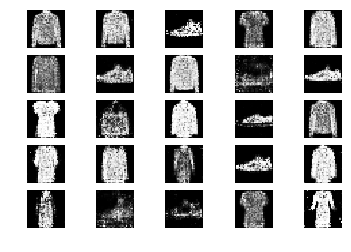

23401 [Discriminator loss: 0.608556, acc.: 65.62%] [Generator loss: 1.028071]
23402 [Discriminator loss: 0.623732, acc.: 59.38%] [Generator loss: 0.916517]
23403 [Discriminator loss: 0.656664, acc.: 57.81%] [Generator loss: 0.969000]
23404 [Discriminator loss: 0.621074, acc.: 70.31%] [Generator loss: 0.872072]
23405 [Discriminator loss: 0.584047, acc.: 62.50%] [Generator loss: 0.873521]
23406 [Discriminator loss: 0.579615, acc.: 67.19%] [Generator loss: 1.034599]
23407 [Discriminator loss: 0.642527, acc.: 67.19%] [Generator loss: 0.958037]
23408 [Discriminator loss: 0.605678, acc.: 68.75%] [Generator loss: 0.946779]
23409 [Discriminator loss: 0.621621, acc.: 67.19%] [Generator loss: 0.935534]
23410 [Discriminator loss: 0.674668, acc.: 54.69%] [Generator loss: 0.949336]
23411 [Discriminator loss: 0.662685, acc.: 57.81%] [Generator loss: 1.035275]
23412 [Discriminator loss: 0.581796, acc.: 68.75%] [Generator loss: 0.947319]
23413 [Discriminator loss: 0.608855, acc.: 64.06%] [Generator lo

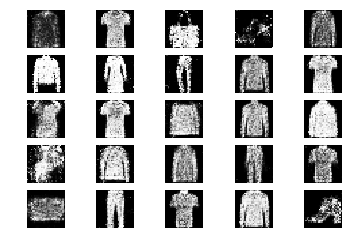

23501 [Discriminator loss: 0.599128, acc.: 67.19%] [Generator loss: 0.922898]
23502 [Discriminator loss: 0.659918, acc.: 67.19%] [Generator loss: 0.869647]
23503 [Discriminator loss: 0.658318, acc.: 60.94%] [Generator loss: 0.896507]
23504 [Discriminator loss: 0.656099, acc.: 64.06%] [Generator loss: 0.968763]
23505 [Discriminator loss: 0.648764, acc.: 62.50%] [Generator loss: 0.950217]
23506 [Discriminator loss: 0.633594, acc.: 65.62%] [Generator loss: 0.981516]
23507 [Discriminator loss: 0.653070, acc.: 57.81%] [Generator loss: 1.069096]
23508 [Discriminator loss: 0.661690, acc.: 56.25%] [Generator loss: 1.001916]
23509 [Discriminator loss: 0.639866, acc.: 64.06%] [Generator loss: 0.952973]
23510 [Discriminator loss: 0.644972, acc.: 60.94%] [Generator loss: 0.968352]
23511 [Discriminator loss: 0.607452, acc.: 70.31%] [Generator loss: 0.882760]
23512 [Discriminator loss: 0.726578, acc.: 57.81%] [Generator loss: 1.008620]
23513 [Discriminator loss: 0.634966, acc.: 68.75%] [Generator lo

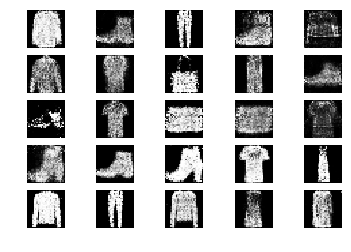

23601 [Discriminator loss: 0.653570, acc.: 67.19%] [Generator loss: 0.962509]
23602 [Discriminator loss: 0.664503, acc.: 53.12%] [Generator loss: 0.926546]
23603 [Discriminator loss: 0.654894, acc.: 64.06%] [Generator loss: 0.947168]
23604 [Discriminator loss: 0.638275, acc.: 67.19%] [Generator loss: 1.005261]
23605 [Discriminator loss: 0.612977, acc.: 68.75%] [Generator loss: 0.935086]
23606 [Discriminator loss: 0.639825, acc.: 57.81%] [Generator loss: 0.992067]
23607 [Discriminator loss: 0.649209, acc.: 62.50%] [Generator loss: 0.989889]
23608 [Discriminator loss: 0.619338, acc.: 70.31%] [Generator loss: 0.970838]
23609 [Discriminator loss: 0.642036, acc.: 62.50%] [Generator loss: 0.929070]
23610 [Discriminator loss: 0.603568, acc.: 68.75%] [Generator loss: 0.983994]
23611 [Discriminator loss: 0.614227, acc.: 64.06%] [Generator loss: 0.979849]
23612 [Discriminator loss: 0.671820, acc.: 53.12%] [Generator loss: 0.921511]
23613 [Discriminator loss: 0.615572, acc.: 65.62%] [Generator lo

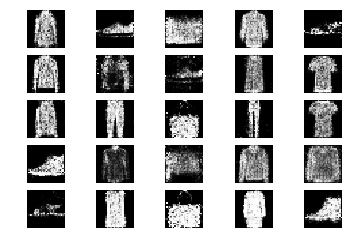

23701 [Discriminator loss: 0.705975, acc.: 46.88%] [Generator loss: 1.090637]
23702 [Discriminator loss: 0.671007, acc.: 57.81%] [Generator loss: 1.026360]
23703 [Discriminator loss: 0.614215, acc.: 64.06%] [Generator loss: 0.967035]
23704 [Discriminator loss: 0.662681, acc.: 59.38%] [Generator loss: 1.091256]
23705 [Discriminator loss: 0.599642, acc.: 71.88%] [Generator loss: 0.999252]
23706 [Discriminator loss: 0.597260, acc.: 62.50%] [Generator loss: 0.935183]
23707 [Discriminator loss: 0.579569, acc.: 68.75%] [Generator loss: 1.013112]
23708 [Discriminator loss: 0.662238, acc.: 65.62%] [Generator loss: 0.987113]
23709 [Discriminator loss: 0.649298, acc.: 59.38%] [Generator loss: 0.985840]
23710 [Discriminator loss: 0.575994, acc.: 73.44%] [Generator loss: 0.880662]
23711 [Discriminator loss: 0.638163, acc.: 65.62%] [Generator loss: 1.032434]
23712 [Discriminator loss: 0.559774, acc.: 68.75%] [Generator loss: 0.973993]
23713 [Discriminator loss: 0.675401, acc.: 59.38%] [Generator lo

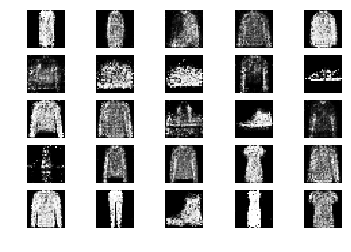

23801 [Discriminator loss: 0.615736, acc.: 68.75%] [Generator loss: 0.983651]
23802 [Discriminator loss: 0.678315, acc.: 56.25%] [Generator loss: 0.944733]
23803 [Discriminator loss: 0.622612, acc.: 60.94%] [Generator loss: 1.004827]
23804 [Discriminator loss: 0.632794, acc.: 59.38%] [Generator loss: 0.916770]
23805 [Discriminator loss: 0.653103, acc.: 62.50%] [Generator loss: 0.993901]
23806 [Discriminator loss: 0.597668, acc.: 68.75%] [Generator loss: 1.031294]
23807 [Discriminator loss: 0.685678, acc.: 56.25%] [Generator loss: 0.907522]
23808 [Discriminator loss: 0.626811, acc.: 70.31%] [Generator loss: 1.006226]
23809 [Discriminator loss: 0.589785, acc.: 67.19%] [Generator loss: 0.945606]
23810 [Discriminator loss: 0.624522, acc.: 65.62%] [Generator loss: 0.839718]
23811 [Discriminator loss: 0.633318, acc.: 65.62%] [Generator loss: 0.877338]
23812 [Discriminator loss: 0.619390, acc.: 65.62%] [Generator loss: 0.923162]
23813 [Discriminator loss: 0.769467, acc.: 48.44%] [Generator lo

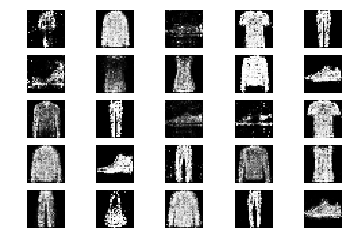

23901 [Discriminator loss: 0.646741, acc.: 64.06%] [Generator loss: 0.899342]
23902 [Discriminator loss: 0.645084, acc.: 59.38%] [Generator loss: 1.009865]
23903 [Discriminator loss: 0.676412, acc.: 59.38%] [Generator loss: 0.932049]
23904 [Discriminator loss: 0.546260, acc.: 70.31%] [Generator loss: 1.021069]
23905 [Discriminator loss: 0.590980, acc.: 67.19%] [Generator loss: 0.956572]
23906 [Discriminator loss: 0.610900, acc.: 64.06%] [Generator loss: 0.893605]
23907 [Discriminator loss: 0.637909, acc.: 71.88%] [Generator loss: 0.932434]
23908 [Discriminator loss: 0.666797, acc.: 64.06%] [Generator loss: 0.992878]
23909 [Discriminator loss: 0.576943, acc.: 71.88%] [Generator loss: 0.922977]
23910 [Discriminator loss: 0.673512, acc.: 48.44%] [Generator loss: 0.902857]
23911 [Discriminator loss: 0.670860, acc.: 64.06%] [Generator loss: 1.016443]
23912 [Discriminator loss: 0.703725, acc.: 56.25%] [Generator loss: 1.009603]
23913 [Discriminator loss: 0.635027, acc.: 59.38%] [Generator lo

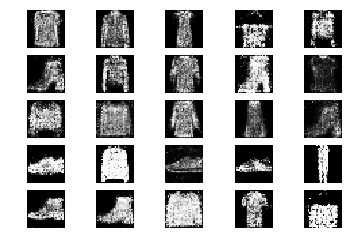

24001 [Discriminator loss: 0.656528, acc.: 65.62%] [Generator loss: 0.906899]
24002 [Discriminator loss: 0.657881, acc.: 64.06%] [Generator loss: 1.034276]
24003 [Discriminator loss: 0.620111, acc.: 64.06%] [Generator loss: 0.967273]
24004 [Discriminator loss: 0.661581, acc.: 62.50%] [Generator loss: 1.045684]
24005 [Discriminator loss: 0.607207, acc.: 60.94%] [Generator loss: 0.996173]
24006 [Discriminator loss: 0.631952, acc.: 62.50%] [Generator loss: 0.894581]
24007 [Discriminator loss: 0.564027, acc.: 76.56%] [Generator loss: 1.050049]
24008 [Discriminator loss: 0.612359, acc.: 70.31%] [Generator loss: 1.040373]
24009 [Discriminator loss: 0.659469, acc.: 59.38%] [Generator loss: 1.012521]
24010 [Discriminator loss: 0.578344, acc.: 75.00%] [Generator loss: 1.078976]
24011 [Discriminator loss: 0.627150, acc.: 67.19%] [Generator loss: 0.955946]
24012 [Discriminator loss: 0.631008, acc.: 62.50%] [Generator loss: 1.012274]
24013 [Discriminator loss: 0.609246, acc.: 65.62%] [Generator lo

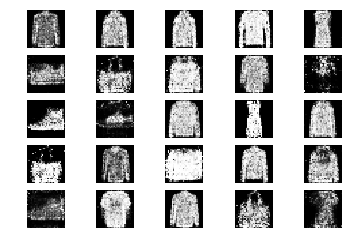

24101 [Discriminator loss: 0.669015, acc.: 60.94%] [Generator loss: 0.887925]
24102 [Discriminator loss: 0.550690, acc.: 75.00%] [Generator loss: 0.919035]
24103 [Discriminator loss: 0.542447, acc.: 78.12%] [Generator loss: 0.823767]
24104 [Discriminator loss: 0.632176, acc.: 57.81%] [Generator loss: 0.867494]
24105 [Discriminator loss: 0.627991, acc.: 67.19%] [Generator loss: 0.959822]
24106 [Discriminator loss: 0.624829, acc.: 64.06%] [Generator loss: 0.952386]
24107 [Discriminator loss: 0.656575, acc.: 65.62%] [Generator loss: 0.874212]
24108 [Discriminator loss: 0.693786, acc.: 57.81%] [Generator loss: 0.962674]
24109 [Discriminator loss: 0.718329, acc.: 45.31%] [Generator loss: 0.968396]
24110 [Discriminator loss: 0.683545, acc.: 54.69%] [Generator loss: 0.965342]
24111 [Discriminator loss: 0.570728, acc.: 67.19%] [Generator loss: 1.016495]
24112 [Discriminator loss: 0.624707, acc.: 62.50%] [Generator loss: 0.978614]
24113 [Discriminator loss: 0.707215, acc.: 57.81%] [Generator lo

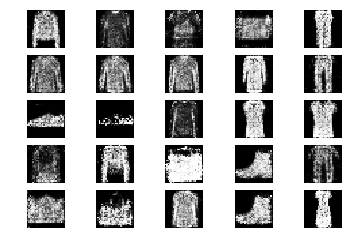

24201 [Discriminator loss: 0.699042, acc.: 53.12%] [Generator loss: 0.974731]
24202 [Discriminator loss: 0.680188, acc.: 57.81%] [Generator loss: 0.936427]
24203 [Discriminator loss: 0.615427, acc.: 70.31%] [Generator loss: 1.005283]
24204 [Discriminator loss: 0.698683, acc.: 45.31%] [Generator loss: 0.872285]
24205 [Discriminator loss: 0.601280, acc.: 65.62%] [Generator loss: 0.877072]
24206 [Discriminator loss: 0.658957, acc.: 60.94%] [Generator loss: 1.035786]
24207 [Discriminator loss: 0.587160, acc.: 70.31%] [Generator loss: 1.016276]
24208 [Discriminator loss: 0.654008, acc.: 56.25%] [Generator loss: 0.949272]
24209 [Discriminator loss: 0.664481, acc.: 57.81%] [Generator loss: 1.039458]
24210 [Discriminator loss: 0.585602, acc.: 70.31%] [Generator loss: 1.050727]
24211 [Discriminator loss: 0.649087, acc.: 67.19%] [Generator loss: 0.991493]
24212 [Discriminator loss: 0.614665, acc.: 65.62%] [Generator loss: 1.069136]
24213 [Discriminator loss: 0.629905, acc.: 67.19%] [Generator lo

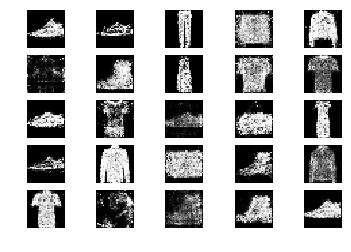

24301 [Discriminator loss: 0.623267, acc.: 67.19%] [Generator loss: 0.872840]
24302 [Discriminator loss: 0.696526, acc.: 50.00%] [Generator loss: 0.955340]
24303 [Discriminator loss: 0.694283, acc.: 59.38%] [Generator loss: 0.909710]
24304 [Discriminator loss: 0.610193, acc.: 68.75%] [Generator loss: 0.922880]
24305 [Discriminator loss: 0.742670, acc.: 46.88%] [Generator loss: 1.008483]
24306 [Discriminator loss: 0.542064, acc.: 70.31%] [Generator loss: 1.069728]
24307 [Discriminator loss: 0.687556, acc.: 51.56%] [Generator loss: 1.013179]
24308 [Discriminator loss: 0.608936, acc.: 70.31%] [Generator loss: 0.909288]
24309 [Discriminator loss: 0.648575, acc.: 62.50%] [Generator loss: 0.897657]
24310 [Discriminator loss: 0.665996, acc.: 64.06%] [Generator loss: 0.936670]
24311 [Discriminator loss: 0.731350, acc.: 51.56%] [Generator loss: 0.962917]
24312 [Discriminator loss: 0.682488, acc.: 56.25%] [Generator loss: 0.952287]
24313 [Discriminator loss: 0.696721, acc.: 48.44%] [Generator lo

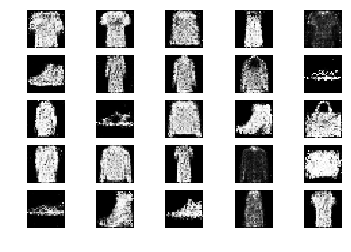

24401 [Discriminator loss: 0.623742, acc.: 68.75%] [Generator loss: 0.943034]
24402 [Discriminator loss: 0.633865, acc.: 60.94%] [Generator loss: 0.992463]
24403 [Discriminator loss: 0.696787, acc.: 60.94%] [Generator loss: 0.969769]
24404 [Discriminator loss: 0.658110, acc.: 68.75%] [Generator loss: 0.923647]
24405 [Discriminator loss: 0.670115, acc.: 67.19%] [Generator loss: 0.823878]
24406 [Discriminator loss: 0.620555, acc.: 70.31%] [Generator loss: 0.915470]
24407 [Discriminator loss: 0.637715, acc.: 70.31%] [Generator loss: 0.873021]
24408 [Discriminator loss: 0.653491, acc.: 59.38%] [Generator loss: 0.996977]
24409 [Discriminator loss: 0.668784, acc.: 57.81%] [Generator loss: 0.911796]
24410 [Discriminator loss: 0.644505, acc.: 56.25%] [Generator loss: 0.883114]
24411 [Discriminator loss: 0.679320, acc.: 51.56%] [Generator loss: 0.908967]
24412 [Discriminator loss: 0.599878, acc.: 65.62%] [Generator loss: 0.877574]
24413 [Discriminator loss: 0.664944, acc.: 60.94%] [Generator lo

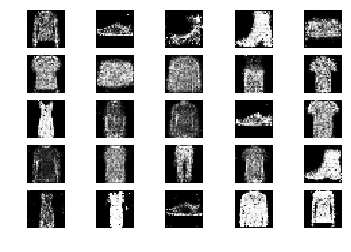

24501 [Discriminator loss: 0.676193, acc.: 50.00%] [Generator loss: 0.954696]
24502 [Discriminator loss: 0.737216, acc.: 46.88%] [Generator loss: 0.936919]
24503 [Discriminator loss: 0.631361, acc.: 67.19%] [Generator loss: 1.032120]
24504 [Discriminator loss: 0.618110, acc.: 59.38%] [Generator loss: 0.936631]
24505 [Discriminator loss: 0.633522, acc.: 73.44%] [Generator loss: 1.003395]
24506 [Discriminator loss: 0.580350, acc.: 71.88%] [Generator loss: 1.056420]
24507 [Discriminator loss: 0.630233, acc.: 68.75%] [Generator loss: 0.990080]
24508 [Discriminator loss: 0.619510, acc.: 65.62%] [Generator loss: 0.922034]
24509 [Discriminator loss: 0.672987, acc.: 53.12%] [Generator loss: 0.936129]
24510 [Discriminator loss: 0.621268, acc.: 54.69%] [Generator loss: 0.957524]
24511 [Discriminator loss: 0.657352, acc.: 56.25%] [Generator loss: 0.922852]
24512 [Discriminator loss: 0.627479, acc.: 60.94%] [Generator loss: 0.898270]
24513 [Discriminator loss: 0.639155, acc.: 59.38%] [Generator lo

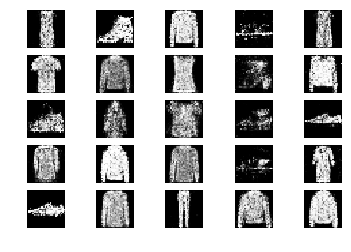

24601 [Discriminator loss: 0.657012, acc.: 54.69%] [Generator loss: 1.062740]
24602 [Discriminator loss: 0.697923, acc.: 57.81%] [Generator loss: 0.969066]
24603 [Discriminator loss: 0.682590, acc.: 60.94%] [Generator loss: 1.010051]
24604 [Discriminator loss: 0.628708, acc.: 65.62%] [Generator loss: 0.917298]
24605 [Discriminator loss: 0.603796, acc.: 64.06%] [Generator loss: 1.002395]
24606 [Discriminator loss: 0.590168, acc.: 68.75%] [Generator loss: 1.003277]
24607 [Discriminator loss: 0.758406, acc.: 42.19%] [Generator loss: 1.092790]
24608 [Discriminator loss: 0.675730, acc.: 56.25%] [Generator loss: 1.036707]
24609 [Discriminator loss: 0.654905, acc.: 65.62%] [Generator loss: 0.998115]
24610 [Discriminator loss: 0.580550, acc.: 71.88%] [Generator loss: 1.043685]
24611 [Discriminator loss: 0.620166, acc.: 65.62%] [Generator loss: 0.931329]
24612 [Discriminator loss: 0.609431, acc.: 65.62%] [Generator loss: 1.002696]
24613 [Discriminator loss: 0.563838, acc.: 76.56%] [Generator lo

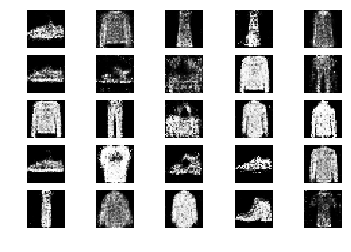

24701 [Discriminator loss: 0.629977, acc.: 57.81%] [Generator loss: 0.998980]
24702 [Discriminator loss: 0.646034, acc.: 59.38%] [Generator loss: 0.937211]
24703 [Discriminator loss: 0.689036, acc.: 54.69%] [Generator loss: 1.004560]
24704 [Discriminator loss: 0.634853, acc.: 67.19%] [Generator loss: 0.979432]
24705 [Discriminator loss: 0.609646, acc.: 60.94%] [Generator loss: 0.999825]
24706 [Discriminator loss: 0.661321, acc.: 57.81%] [Generator loss: 0.952472]
24707 [Discriminator loss: 0.634431, acc.: 64.06%] [Generator loss: 0.957348]
24708 [Discriminator loss: 0.612040, acc.: 64.06%] [Generator loss: 1.062886]
24709 [Discriminator loss: 0.538991, acc.: 75.00%] [Generator loss: 0.981690]
24710 [Discriminator loss: 0.667070, acc.: 50.00%] [Generator loss: 0.948180]
24711 [Discriminator loss: 0.639675, acc.: 68.75%] [Generator loss: 0.912898]
24712 [Discriminator loss: 0.753039, acc.: 54.69%] [Generator loss: 0.945071]
24713 [Discriminator loss: 0.586805, acc.: 76.56%] [Generator lo

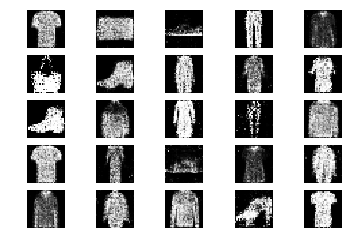

24801 [Discriminator loss: 0.628372, acc.: 65.62%] [Generator loss: 1.042387]
24802 [Discriminator loss: 0.641614, acc.: 59.38%] [Generator loss: 0.936250]
24803 [Discriminator loss: 0.601503, acc.: 67.19%] [Generator loss: 0.926179]
24804 [Discriminator loss: 0.623878, acc.: 57.81%] [Generator loss: 0.946790]
24805 [Discriminator loss: 0.596873, acc.: 68.75%] [Generator loss: 0.910459]
24806 [Discriminator loss: 0.660002, acc.: 60.94%] [Generator loss: 0.984834]
24807 [Discriminator loss: 0.638520, acc.: 60.94%] [Generator loss: 1.010662]
24808 [Discriminator loss: 0.632915, acc.: 59.38%] [Generator loss: 0.902859]
24809 [Discriminator loss: 0.652278, acc.: 56.25%] [Generator loss: 0.941558]
24810 [Discriminator loss: 0.609548, acc.: 62.50%] [Generator loss: 0.908162]
24811 [Discriminator loss: 0.652241, acc.: 65.62%] [Generator loss: 1.099771]
24812 [Discriminator loss: 0.617321, acc.: 65.62%] [Generator loss: 1.058529]
24813 [Discriminator loss: 0.644328, acc.: 62.50%] [Generator lo

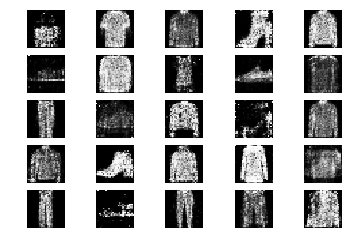

24901 [Discriminator loss: 0.621585, acc.: 62.50%] [Generator loss: 0.994356]
24902 [Discriminator loss: 0.579403, acc.: 73.44%] [Generator loss: 0.971145]
24903 [Discriminator loss: 0.670413, acc.: 53.12%] [Generator loss: 1.095151]
24904 [Discriminator loss: 0.648216, acc.: 59.38%] [Generator loss: 0.921954]
24905 [Discriminator loss: 0.712488, acc.: 53.12%] [Generator loss: 0.962872]
24906 [Discriminator loss: 0.597414, acc.: 65.62%] [Generator loss: 0.974909]
24907 [Discriminator loss: 0.556060, acc.: 75.00%] [Generator loss: 0.890885]
24908 [Discriminator loss: 0.613149, acc.: 60.94%] [Generator loss: 0.889938]
24909 [Discriminator loss: 0.618369, acc.: 73.44%] [Generator loss: 0.924884]
24910 [Discriminator loss: 0.569847, acc.: 67.19%] [Generator loss: 0.914034]
24911 [Discriminator loss: 0.641619, acc.: 59.38%] [Generator loss: 0.975754]
24912 [Discriminator loss: 0.673942, acc.: 62.50%] [Generator loss: 0.946995]
24913 [Discriminator loss: 0.648446, acc.: 60.94%] [Generator lo

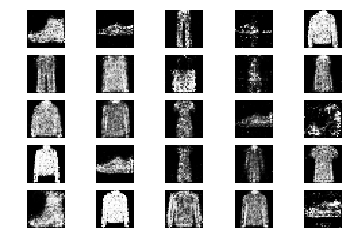

25001 [Discriminator loss: 0.622153, acc.: 67.19%] [Generator loss: 1.009330]
25002 [Discriminator loss: 0.583302, acc.: 71.88%] [Generator loss: 0.918723]
25003 [Discriminator loss: 0.673080, acc.: 64.06%] [Generator loss: 0.954034]
25004 [Discriminator loss: 0.657664, acc.: 59.38%] [Generator loss: 0.966957]
25005 [Discriminator loss: 0.618602, acc.: 67.19%] [Generator loss: 0.933441]
25006 [Discriminator loss: 0.561097, acc.: 71.88%] [Generator loss: 1.024903]
25007 [Discriminator loss: 0.630864, acc.: 67.19%] [Generator loss: 0.861991]
25008 [Discriminator loss: 0.680306, acc.: 59.38%] [Generator loss: 0.950262]
25009 [Discriminator loss: 0.665571, acc.: 51.56%] [Generator loss: 0.951532]
25010 [Discriminator loss: 0.650542, acc.: 62.50%] [Generator loss: 0.932872]
25011 [Discriminator loss: 0.629271, acc.: 57.81%] [Generator loss: 0.965359]
25012 [Discriminator loss: 0.660265, acc.: 57.81%] [Generator loss: 0.935986]
25013 [Discriminator loss: 0.633282, acc.: 57.81%] [Generator lo

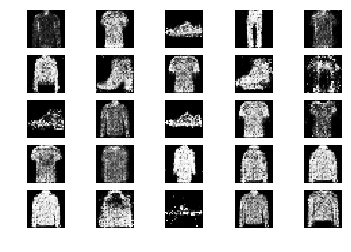

25101 [Discriminator loss: 0.662867, acc.: 60.94%] [Generator loss: 0.930802]
25102 [Discriminator loss: 0.600843, acc.: 62.50%] [Generator loss: 0.929043]
25103 [Discriminator loss: 0.690371, acc.: 50.00%] [Generator loss: 1.069878]
25104 [Discriminator loss: 0.697031, acc.: 62.50%] [Generator loss: 0.911168]
25105 [Discriminator loss: 0.590900, acc.: 68.75%] [Generator loss: 1.021171]
25106 [Discriminator loss: 0.618790, acc.: 70.31%] [Generator loss: 0.931470]
25107 [Discriminator loss: 0.611648, acc.: 67.19%] [Generator loss: 0.979795]
25108 [Discriminator loss: 0.655964, acc.: 60.94%] [Generator loss: 0.945590]
25109 [Discriminator loss: 0.620893, acc.: 71.88%] [Generator loss: 0.929314]
25110 [Discriminator loss: 0.637241, acc.: 65.62%] [Generator loss: 0.958463]
25111 [Discriminator loss: 0.627209, acc.: 59.38%] [Generator loss: 1.037569]
25112 [Discriminator loss: 0.603281, acc.: 75.00%] [Generator loss: 1.029665]
25113 [Discriminator loss: 0.580058, acc.: 73.44%] [Generator lo

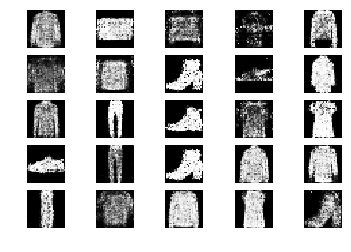

25201 [Discriminator loss: 0.693978, acc.: 53.12%] [Generator loss: 0.880677]
25202 [Discriminator loss: 0.655844, acc.: 56.25%] [Generator loss: 0.800946]
25203 [Discriminator loss: 0.675755, acc.: 60.94%] [Generator loss: 0.868538]
25204 [Discriminator loss: 0.615417, acc.: 60.94%] [Generator loss: 0.973026]
25205 [Discriminator loss: 0.641027, acc.: 64.06%] [Generator loss: 0.951315]
25206 [Discriminator loss: 0.735260, acc.: 51.56%] [Generator loss: 0.938582]
25207 [Discriminator loss: 0.663835, acc.: 62.50%] [Generator loss: 0.961339]
25208 [Discriminator loss: 0.597517, acc.: 70.31%] [Generator loss: 1.033678]
25209 [Discriminator loss: 0.639342, acc.: 57.81%] [Generator loss: 0.937900]
25210 [Discriminator loss: 0.670937, acc.: 62.50%] [Generator loss: 0.981531]
25211 [Discriminator loss: 0.679591, acc.: 56.25%] [Generator loss: 0.979609]
25212 [Discriminator loss: 0.626843, acc.: 65.62%] [Generator loss: 0.984434]
25213 [Discriminator loss: 0.643393, acc.: 64.06%] [Generator lo

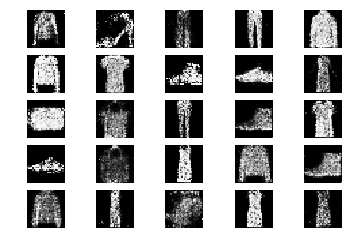

25301 [Discriminator loss: 0.624945, acc.: 68.75%] [Generator loss: 0.918490]
25302 [Discriminator loss: 0.616942, acc.: 67.19%] [Generator loss: 0.876707]
25303 [Discriminator loss: 0.697056, acc.: 56.25%] [Generator loss: 0.950096]
25304 [Discriminator loss: 0.643958, acc.: 57.81%] [Generator loss: 0.913325]
25305 [Discriminator loss: 0.641605, acc.: 62.50%] [Generator loss: 0.996206]
25306 [Discriminator loss: 0.710482, acc.: 46.88%] [Generator loss: 0.949060]
25307 [Discriminator loss: 0.705143, acc.: 56.25%] [Generator loss: 0.903657]
25308 [Discriminator loss: 0.730804, acc.: 46.88%] [Generator loss: 0.886483]
25309 [Discriminator loss: 0.610635, acc.: 67.19%] [Generator loss: 0.857310]
25310 [Discriminator loss: 0.599394, acc.: 70.31%] [Generator loss: 0.850364]
25311 [Discriminator loss: 0.604762, acc.: 68.75%] [Generator loss: 0.848161]
25312 [Discriminator loss: 0.626596, acc.: 64.06%] [Generator loss: 0.848900]
25313 [Discriminator loss: 0.699901, acc.: 53.12%] [Generator lo

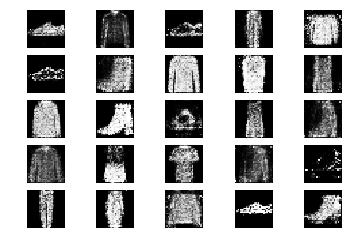

25401 [Discriminator loss: 0.647970, acc.: 60.94%] [Generator loss: 1.017002]
25402 [Discriminator loss: 0.617063, acc.: 64.06%] [Generator loss: 0.953132]
25403 [Discriminator loss: 0.658293, acc.: 62.50%] [Generator loss: 0.923716]
25404 [Discriminator loss: 0.682860, acc.: 53.12%] [Generator loss: 0.889916]
25405 [Discriminator loss: 0.621261, acc.: 62.50%] [Generator loss: 0.876494]
25406 [Discriminator loss: 0.621989, acc.: 67.19%] [Generator loss: 0.913086]
25407 [Discriminator loss: 0.568995, acc.: 68.75%] [Generator loss: 1.028666]
25408 [Discriminator loss: 0.633770, acc.: 67.19%] [Generator loss: 0.996983]
25409 [Discriminator loss: 0.568212, acc.: 75.00%] [Generator loss: 0.916520]
25410 [Discriminator loss: 0.630520, acc.: 60.94%] [Generator loss: 0.935582]
25411 [Discriminator loss: 0.652526, acc.: 53.12%] [Generator loss: 1.061424]
25412 [Discriminator loss: 0.623895, acc.: 65.62%] [Generator loss: 0.993284]
25413 [Discriminator loss: 0.629000, acc.: 67.19%] [Generator lo

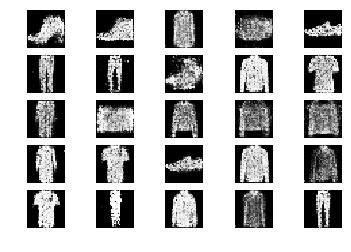

25501 [Discriminator loss: 0.573330, acc.: 71.88%] [Generator loss: 1.036974]
25502 [Discriminator loss: 0.635216, acc.: 59.38%] [Generator loss: 1.059379]
25503 [Discriminator loss: 0.733372, acc.: 53.12%] [Generator loss: 0.982865]
25504 [Discriminator loss: 0.644464, acc.: 64.06%] [Generator loss: 0.981976]
25505 [Discriminator loss: 0.707998, acc.: 51.56%] [Generator loss: 1.053558]
25506 [Discriminator loss: 0.602256, acc.: 67.19%] [Generator loss: 0.916994]
25507 [Discriminator loss: 0.558254, acc.: 73.44%] [Generator loss: 0.951989]
25508 [Discriminator loss: 0.707101, acc.: 50.00%] [Generator loss: 0.938197]
25509 [Discriminator loss: 0.564572, acc.: 70.31%] [Generator loss: 0.861510]
25510 [Discriminator loss: 0.593498, acc.: 65.62%] [Generator loss: 0.920314]
25511 [Discriminator loss: 0.572650, acc.: 68.75%] [Generator loss: 0.949009]
25512 [Discriminator loss: 0.558051, acc.: 73.44%] [Generator loss: 0.967029]
25513 [Discriminator loss: 0.602144, acc.: 67.19%] [Generator lo

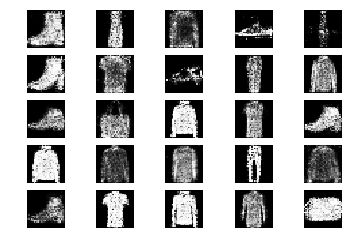

25601 [Discriminator loss: 0.667954, acc.: 62.50%] [Generator loss: 0.967114]
25602 [Discriminator loss: 0.729750, acc.: 51.56%] [Generator loss: 0.889260]
25603 [Discriminator loss: 0.658135, acc.: 60.94%] [Generator loss: 0.950855]
25604 [Discriminator loss: 0.613315, acc.: 67.19%] [Generator loss: 0.910137]
25605 [Discriminator loss: 0.644270, acc.: 60.94%] [Generator loss: 0.922113]
25606 [Discriminator loss: 0.632764, acc.: 67.19%] [Generator loss: 0.959787]
25607 [Discriminator loss: 0.675324, acc.: 56.25%] [Generator loss: 0.934597]
25608 [Discriminator loss: 0.629329, acc.: 68.75%] [Generator loss: 0.941210]
25609 [Discriminator loss: 0.690413, acc.: 53.12%] [Generator loss: 0.849062]
25610 [Discriminator loss: 0.696811, acc.: 51.56%] [Generator loss: 1.004913]
25611 [Discriminator loss: 0.691553, acc.: 60.94%] [Generator loss: 1.009640]
25612 [Discriminator loss: 0.677297, acc.: 62.50%] [Generator loss: 0.924703]
25613 [Discriminator loss: 0.656991, acc.: 60.94%] [Generator lo

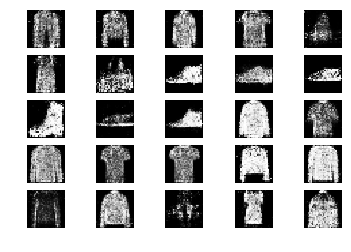

25701 [Discriminator loss: 0.593403, acc.: 68.75%] [Generator loss: 0.968318]
25702 [Discriminator loss: 0.683788, acc.: 57.81%] [Generator loss: 1.021332]
25703 [Discriminator loss: 0.690351, acc.: 57.81%] [Generator loss: 0.964716]
25704 [Discriminator loss: 0.625943, acc.: 54.69%] [Generator loss: 1.022595]
25705 [Discriminator loss: 0.742956, acc.: 50.00%] [Generator loss: 0.863135]
25706 [Discriminator loss: 0.615819, acc.: 65.62%] [Generator loss: 0.891769]
25707 [Discriminator loss: 0.587802, acc.: 70.31%] [Generator loss: 0.865413]
25708 [Discriminator loss: 0.659383, acc.: 57.81%] [Generator loss: 0.974322]
25709 [Discriminator loss: 0.681287, acc.: 62.50%] [Generator loss: 0.968947]
25710 [Discriminator loss: 0.556273, acc.: 75.00%] [Generator loss: 1.057624]
25711 [Discriminator loss: 0.604927, acc.: 71.88%] [Generator loss: 1.038727]
25712 [Discriminator loss: 0.662915, acc.: 60.94%] [Generator loss: 1.026822]
25713 [Discriminator loss: 0.587137, acc.: 67.19%] [Generator lo

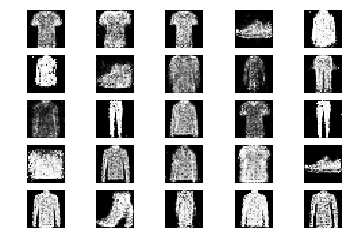

25801 [Discriminator loss: 0.658818, acc.: 64.06%] [Generator loss: 0.963038]
25802 [Discriminator loss: 0.579825, acc.: 65.62%] [Generator loss: 0.901591]
25803 [Discriminator loss: 0.664268, acc.: 65.62%] [Generator loss: 0.912169]
25804 [Discriminator loss: 0.709005, acc.: 57.81%] [Generator loss: 1.022273]
25805 [Discriminator loss: 0.619116, acc.: 64.06%] [Generator loss: 0.921619]
25806 [Discriminator loss: 0.610151, acc.: 65.62%] [Generator loss: 0.917016]
25807 [Discriminator loss: 0.690199, acc.: 53.12%] [Generator loss: 0.938108]
25808 [Discriminator loss: 0.632623, acc.: 67.19%] [Generator loss: 0.955432]
25809 [Discriminator loss: 0.604425, acc.: 57.81%] [Generator loss: 0.996943]
25810 [Discriminator loss: 0.706488, acc.: 57.81%] [Generator loss: 0.940394]
25811 [Discriminator loss: 0.618423, acc.: 68.75%] [Generator loss: 0.966891]
25812 [Discriminator loss: 0.593541, acc.: 70.31%] [Generator loss: 1.200073]
25813 [Discriminator loss: 0.634125, acc.: 56.25%] [Generator lo

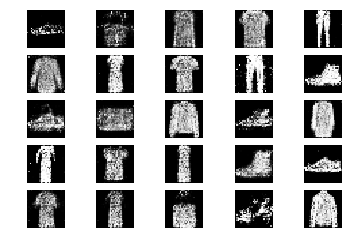

25901 [Discriminator loss: 0.614951, acc.: 62.50%] [Generator loss: 0.993046]
25902 [Discriminator loss: 0.568420, acc.: 73.44%] [Generator loss: 0.936454]
25903 [Discriminator loss: 0.665396, acc.: 59.38%] [Generator loss: 1.012902]
25904 [Discriminator loss: 0.614181, acc.: 71.88%] [Generator loss: 0.924336]
25905 [Discriminator loss: 0.603488, acc.: 67.19%] [Generator loss: 0.929764]
25906 [Discriminator loss: 0.570187, acc.: 65.62%] [Generator loss: 0.944196]
25907 [Discriminator loss: 0.612161, acc.: 70.31%] [Generator loss: 0.964862]
25908 [Discriminator loss: 0.641104, acc.: 65.62%] [Generator loss: 1.010390]
25909 [Discriminator loss: 0.604486, acc.: 68.75%] [Generator loss: 0.921411]
25910 [Discriminator loss: 0.676572, acc.: 65.62%] [Generator loss: 1.048150]
25911 [Discriminator loss: 0.607261, acc.: 70.31%] [Generator loss: 1.078961]
25912 [Discriminator loss: 0.710914, acc.: 53.12%] [Generator loss: 1.014515]
25913 [Discriminator loss: 0.666733, acc.: 53.12%] [Generator lo

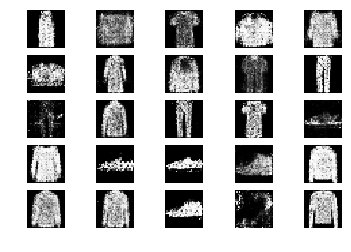

26001 [Discriminator loss: 0.599433, acc.: 73.44%] [Generator loss: 0.949666]
26002 [Discriminator loss: 0.597835, acc.: 60.94%] [Generator loss: 1.011395]
26003 [Discriminator loss: 0.601613, acc.: 71.88%] [Generator loss: 1.049365]
26004 [Discriminator loss: 0.616815, acc.: 78.12%] [Generator loss: 1.033478]
26005 [Discriminator loss: 0.659312, acc.: 59.38%] [Generator loss: 1.031948]
26006 [Discriminator loss: 0.735536, acc.: 51.56%] [Generator loss: 0.950387]
26007 [Discriminator loss: 0.624303, acc.: 65.62%] [Generator loss: 1.055413]
26008 [Discriminator loss: 0.623543, acc.: 65.62%] [Generator loss: 0.898435]
26009 [Discriminator loss: 0.629627, acc.: 62.50%] [Generator loss: 0.977700]
26010 [Discriminator loss: 0.738032, acc.: 48.44%] [Generator loss: 0.979117]
26011 [Discriminator loss: 0.601929, acc.: 67.19%] [Generator loss: 1.065746]
26012 [Discriminator loss: 0.645529, acc.: 62.50%] [Generator loss: 0.997370]
26013 [Discriminator loss: 0.628732, acc.: 68.75%] [Generator lo

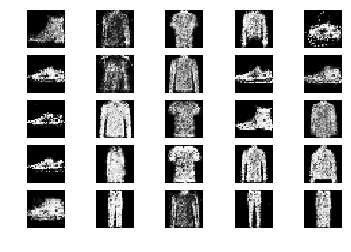

26101 [Discriminator loss: 0.568051, acc.: 71.88%] [Generator loss: 1.110154]
26102 [Discriminator loss: 0.645658, acc.: 67.19%] [Generator loss: 1.041726]
26103 [Discriminator loss: 0.637599, acc.: 64.06%] [Generator loss: 0.924121]
26104 [Discriminator loss: 0.684509, acc.: 56.25%] [Generator loss: 0.981260]
26105 [Discriminator loss: 0.651254, acc.: 65.62%] [Generator loss: 1.049314]
26106 [Discriminator loss: 0.649755, acc.: 64.06%] [Generator loss: 0.910953]
26107 [Discriminator loss: 0.578537, acc.: 70.31%] [Generator loss: 0.960470]
26108 [Discriminator loss: 0.611384, acc.: 64.06%] [Generator loss: 0.878065]
26109 [Discriminator loss: 0.623388, acc.: 62.50%] [Generator loss: 0.971540]
26110 [Discriminator loss: 0.635103, acc.: 57.81%] [Generator loss: 0.850617]
26111 [Discriminator loss: 0.677432, acc.: 59.38%] [Generator loss: 1.070598]
26112 [Discriminator loss: 0.612239, acc.: 65.62%] [Generator loss: 0.945034]
26113 [Discriminator loss: 0.604998, acc.: 68.75%] [Generator lo

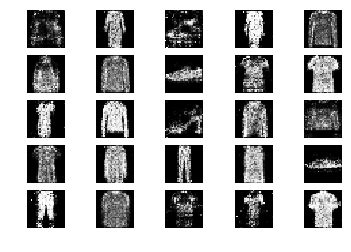

26201 [Discriminator loss: 0.645193, acc.: 62.50%] [Generator loss: 0.972604]
26202 [Discriminator loss: 0.627750, acc.: 64.06%] [Generator loss: 0.942383]
26203 [Discriminator loss: 0.606986, acc.: 62.50%] [Generator loss: 0.880936]
26204 [Discriminator loss: 0.670369, acc.: 56.25%] [Generator loss: 1.051332]
26205 [Discriminator loss: 0.670325, acc.: 62.50%] [Generator loss: 0.927400]
26206 [Discriminator loss: 0.708025, acc.: 59.38%] [Generator loss: 0.930114]
26207 [Discriminator loss: 0.587459, acc.: 68.75%] [Generator loss: 1.037012]
26208 [Discriminator loss: 0.635708, acc.: 57.81%] [Generator loss: 0.871360]
26209 [Discriminator loss: 0.675317, acc.: 57.81%] [Generator loss: 0.938336]
26210 [Discriminator loss: 0.700599, acc.: 64.06%] [Generator loss: 0.911962]
26211 [Discriminator loss: 0.659858, acc.: 62.50%] [Generator loss: 0.961649]
26212 [Discriminator loss: 0.618535, acc.: 70.31%] [Generator loss: 1.037112]
26213 [Discriminator loss: 0.641106, acc.: 67.19%] [Generator lo

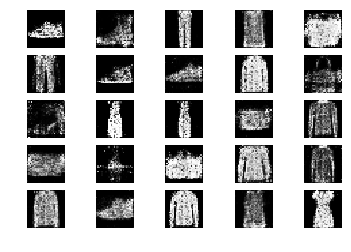

26301 [Discriminator loss: 0.576924, acc.: 71.88%] [Generator loss: 1.037892]
26302 [Discriminator loss: 0.605099, acc.: 70.31%] [Generator loss: 1.093261]
26303 [Discriminator loss: 0.595598, acc.: 73.44%] [Generator loss: 1.107439]
26304 [Discriminator loss: 0.656050, acc.: 64.06%] [Generator loss: 1.069539]
26305 [Discriminator loss: 0.705401, acc.: 54.69%] [Generator loss: 0.989744]
26306 [Discriminator loss: 0.616595, acc.: 65.62%] [Generator loss: 1.010625]
26307 [Discriminator loss: 0.663295, acc.: 51.56%] [Generator loss: 0.966026]
26308 [Discriminator loss: 0.670071, acc.: 54.69%] [Generator loss: 0.864359]
26309 [Discriminator loss: 0.726346, acc.: 48.44%] [Generator loss: 0.913442]
26310 [Discriminator loss: 0.576756, acc.: 68.75%] [Generator loss: 0.955103]
26311 [Discriminator loss: 0.616938, acc.: 68.75%] [Generator loss: 0.958678]
26312 [Discriminator loss: 0.620238, acc.: 65.62%] [Generator loss: 1.063512]
26313 [Discriminator loss: 0.612715, acc.: 68.75%] [Generator lo

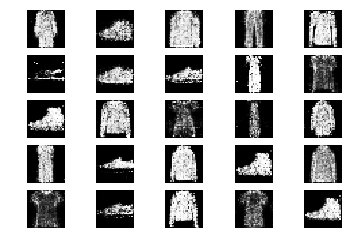

26401 [Discriminator loss: 0.647513, acc.: 60.94%] [Generator loss: 1.029667]
26402 [Discriminator loss: 0.653310, acc.: 60.94%] [Generator loss: 0.990298]
26403 [Discriminator loss: 0.603482, acc.: 68.75%] [Generator loss: 0.970329]
26404 [Discriminator loss: 0.586712, acc.: 65.62%] [Generator loss: 0.979759]
26405 [Discriminator loss: 0.652382, acc.: 59.38%] [Generator loss: 0.941499]
26406 [Discriminator loss: 0.712233, acc.: 53.12%] [Generator loss: 0.889856]
26407 [Discriminator loss: 0.634548, acc.: 56.25%] [Generator loss: 0.864770]
26408 [Discriminator loss: 0.667617, acc.: 67.19%] [Generator loss: 0.953189]
26409 [Discriminator loss: 0.650674, acc.: 62.50%] [Generator loss: 1.035530]
26410 [Discriminator loss: 0.640638, acc.: 59.38%] [Generator loss: 1.007154]
26411 [Discriminator loss: 0.629895, acc.: 62.50%] [Generator loss: 0.959019]
26412 [Discriminator loss: 0.601631, acc.: 75.00%] [Generator loss: 0.909594]
26413 [Discriminator loss: 0.576644, acc.: 70.31%] [Generator lo

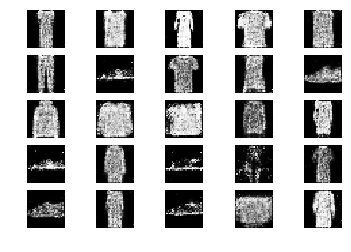

26501 [Discriminator loss: 0.657670, acc.: 62.50%] [Generator loss: 0.889449]
26502 [Discriminator loss: 0.628118, acc.: 65.62%] [Generator loss: 0.914097]
26503 [Discriminator loss: 0.628871, acc.: 68.75%] [Generator loss: 0.945072]
26504 [Discriminator loss: 0.582758, acc.: 71.88%] [Generator loss: 0.953144]
26505 [Discriminator loss: 0.784520, acc.: 51.56%] [Generator loss: 0.927699]
26506 [Discriminator loss: 0.603674, acc.: 65.62%] [Generator loss: 1.008160]
26507 [Discriminator loss: 0.733529, acc.: 54.69%] [Generator loss: 1.012064]
26508 [Discriminator loss: 0.645646, acc.: 60.94%] [Generator loss: 1.009132]
26509 [Discriminator loss: 0.612941, acc.: 68.75%] [Generator loss: 1.078724]
26510 [Discriminator loss: 0.628548, acc.: 64.06%] [Generator loss: 0.998965]
26511 [Discriminator loss: 0.664378, acc.: 60.94%] [Generator loss: 0.874108]
26512 [Discriminator loss: 0.623812, acc.: 56.25%] [Generator loss: 0.860598]
26513 [Discriminator loss: 0.676246, acc.: 51.56%] [Generator lo

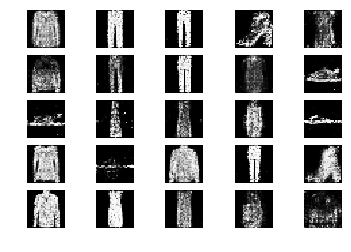

26601 [Discriminator loss: 0.661887, acc.: 57.81%] [Generator loss: 0.896179]
26602 [Discriminator loss: 0.593171, acc.: 71.88%] [Generator loss: 0.980487]
26603 [Discriminator loss: 0.649645, acc.: 57.81%] [Generator loss: 1.006869]
26604 [Discriminator loss: 0.648733, acc.: 67.19%] [Generator loss: 0.827780]
26605 [Discriminator loss: 0.651531, acc.: 65.62%] [Generator loss: 0.839550]
26606 [Discriminator loss: 0.618986, acc.: 65.62%] [Generator loss: 0.913171]
26607 [Discriminator loss: 0.641229, acc.: 64.06%] [Generator loss: 0.886162]
26608 [Discriminator loss: 0.667270, acc.: 59.38%] [Generator loss: 0.839877]
26609 [Discriminator loss: 0.590217, acc.: 73.44%] [Generator loss: 0.883343]
26610 [Discriminator loss: 0.716309, acc.: 53.12%] [Generator loss: 0.879647]
26611 [Discriminator loss: 0.606456, acc.: 65.62%] [Generator loss: 1.019321]
26612 [Discriminator loss: 0.619381, acc.: 64.06%] [Generator loss: 1.002231]
26613 [Discriminator loss: 0.718033, acc.: 51.56%] [Generator lo

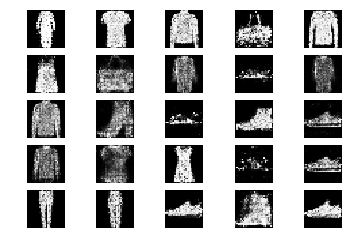

26701 [Discriminator loss: 0.737276, acc.: 60.94%] [Generator loss: 1.007406]
26702 [Discriminator loss: 0.666715, acc.: 54.69%] [Generator loss: 0.869962]
26703 [Discriminator loss: 0.672848, acc.: 59.38%] [Generator loss: 0.976152]
26704 [Discriminator loss: 0.654039, acc.: 64.06%] [Generator loss: 0.835914]
26705 [Discriminator loss: 0.626880, acc.: 65.62%] [Generator loss: 0.928951]
26706 [Discriminator loss: 0.700145, acc.: 50.00%] [Generator loss: 0.972300]
26707 [Discriminator loss: 0.625686, acc.: 68.75%] [Generator loss: 1.044660]
26708 [Discriminator loss: 0.618372, acc.: 65.62%] [Generator loss: 1.069014]
26709 [Discriminator loss: 0.586520, acc.: 75.00%] [Generator loss: 1.063859]
26710 [Discriminator loss: 0.621115, acc.: 62.50%] [Generator loss: 0.959708]
26711 [Discriminator loss: 0.685497, acc.: 54.69%] [Generator loss: 1.031835]
26712 [Discriminator loss: 0.625650, acc.: 64.06%] [Generator loss: 0.920271]
26713 [Discriminator loss: 0.582788, acc.: 73.44%] [Generator lo

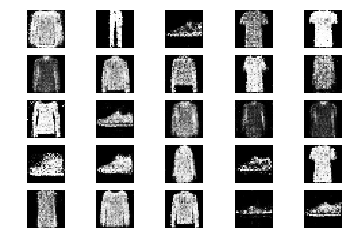

26801 [Discriminator loss: 0.614192, acc.: 67.19%] [Generator loss: 1.108328]
26802 [Discriminator loss: 0.598641, acc.: 71.88%] [Generator loss: 1.032672]
26803 [Discriminator loss: 0.759315, acc.: 45.31%] [Generator loss: 1.049128]
26804 [Discriminator loss: 0.601096, acc.: 65.62%] [Generator loss: 0.992700]
26805 [Discriminator loss: 0.687903, acc.: 60.94%] [Generator loss: 1.009131]
26806 [Discriminator loss: 0.661009, acc.: 53.12%] [Generator loss: 0.896654]
26807 [Discriminator loss: 0.687634, acc.: 51.56%] [Generator loss: 1.053846]
26808 [Discriminator loss: 0.612044, acc.: 68.75%] [Generator loss: 0.979565]
26809 [Discriminator loss: 0.692486, acc.: 54.69%] [Generator loss: 0.993283]
26810 [Discriminator loss: 0.671900, acc.: 59.38%] [Generator loss: 0.980706]
26811 [Discriminator loss: 0.619871, acc.: 70.31%] [Generator loss: 1.016149]
26812 [Discriminator loss: 0.535743, acc.: 76.56%] [Generator loss: 1.016701]
26813 [Discriminator loss: 0.580129, acc.: 71.88%] [Generator lo

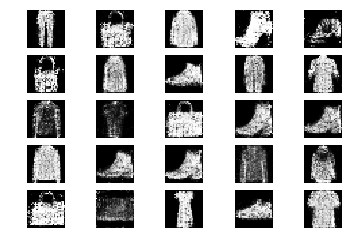

26901 [Discriminator loss: 0.656095, acc.: 57.81%] [Generator loss: 1.030975]
26902 [Discriminator loss: 0.615937, acc.: 64.06%] [Generator loss: 1.010228]
26903 [Discriminator loss: 0.607584, acc.: 70.31%] [Generator loss: 0.895898]
26904 [Discriminator loss: 0.650945, acc.: 70.31%] [Generator loss: 1.055935]
26905 [Discriminator loss: 0.616951, acc.: 68.75%] [Generator loss: 0.934167]
26906 [Discriminator loss: 0.694951, acc.: 56.25%] [Generator loss: 0.942391]
26907 [Discriminator loss: 0.638508, acc.: 64.06%] [Generator loss: 0.930648]
26908 [Discriminator loss: 0.690759, acc.: 56.25%] [Generator loss: 0.958898]
26909 [Discriminator loss: 0.655291, acc.: 62.50%] [Generator loss: 0.982411]
26910 [Discriminator loss: 0.633206, acc.: 71.88%] [Generator loss: 1.032979]
26911 [Discriminator loss: 0.606266, acc.: 65.62%] [Generator loss: 0.979534]
26912 [Discriminator loss: 0.620169, acc.: 60.94%] [Generator loss: 0.983584]
26913 [Discriminator loss: 0.562197, acc.: 75.00%] [Generator lo

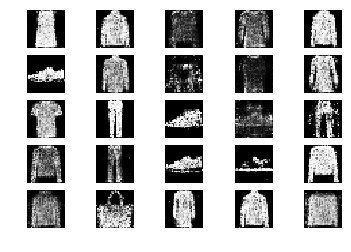

27001 [Discriminator loss: 0.673259, acc.: 62.50%] [Generator loss: 0.949443]
27002 [Discriminator loss: 0.598321, acc.: 67.19%] [Generator loss: 1.048903]
27003 [Discriminator loss: 0.575507, acc.: 67.19%] [Generator loss: 1.010168]
27004 [Discriminator loss: 0.710765, acc.: 59.38%] [Generator loss: 0.962186]
27005 [Discriminator loss: 0.721836, acc.: 54.69%] [Generator loss: 0.984594]
27006 [Discriminator loss: 0.659778, acc.: 54.69%] [Generator loss: 1.022107]
27007 [Discriminator loss: 0.706326, acc.: 57.81%] [Generator loss: 0.914856]
27008 [Discriminator loss: 0.644157, acc.: 60.94%] [Generator loss: 1.010275]
27009 [Discriminator loss: 0.599010, acc.: 71.88%] [Generator loss: 0.964972]
27010 [Discriminator loss: 0.612168, acc.: 70.31%] [Generator loss: 0.872802]
27011 [Discriminator loss: 0.722493, acc.: 50.00%] [Generator loss: 0.953984]
27012 [Discriminator loss: 0.681789, acc.: 64.06%] [Generator loss: 0.856800]
27013 [Discriminator loss: 0.612688, acc.: 67.19%] [Generator lo

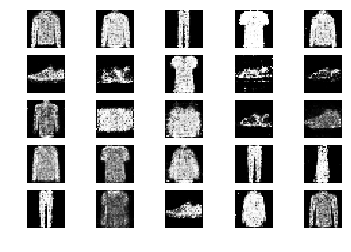

27101 [Discriminator loss: 0.633989, acc.: 65.62%] [Generator loss: 0.940295]
27102 [Discriminator loss: 0.593504, acc.: 71.88%] [Generator loss: 0.939445]
27103 [Discriminator loss: 0.628634, acc.: 60.94%] [Generator loss: 0.939641]
27104 [Discriminator loss: 0.713138, acc.: 60.94%] [Generator loss: 0.979020]
27105 [Discriminator loss: 0.654796, acc.: 60.94%] [Generator loss: 0.945088]
27106 [Discriminator loss: 0.638174, acc.: 62.50%] [Generator loss: 0.823597]
27107 [Discriminator loss: 0.681753, acc.: 53.12%] [Generator loss: 0.972529]
27108 [Discriminator loss: 0.595876, acc.: 64.06%] [Generator loss: 1.000814]
27109 [Discriminator loss: 0.586667, acc.: 70.31%] [Generator loss: 0.977294]
27110 [Discriminator loss: 0.623021, acc.: 68.75%] [Generator loss: 0.945468]
27111 [Discriminator loss: 0.653910, acc.: 67.19%] [Generator loss: 0.970778]
27112 [Discriminator loss: 0.696486, acc.: 51.56%] [Generator loss: 0.973917]
27113 [Discriminator loss: 0.641358, acc.: 60.94%] [Generator lo

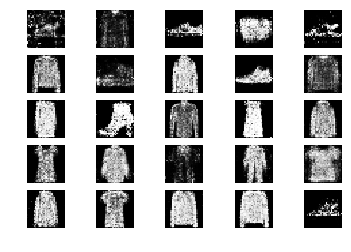

27201 [Discriminator loss: 0.587403, acc.: 67.19%] [Generator loss: 0.941640]
27202 [Discriminator loss: 0.630727, acc.: 64.06%] [Generator loss: 0.944621]
27203 [Discriminator loss: 0.642222, acc.: 68.75%] [Generator loss: 0.980082]
27204 [Discriminator loss: 0.652018, acc.: 62.50%] [Generator loss: 0.767174]
27205 [Discriminator loss: 0.650252, acc.: 51.56%] [Generator loss: 0.908137]
27206 [Discriminator loss: 0.588236, acc.: 70.31%] [Generator loss: 1.006535]
27207 [Discriminator loss: 0.587978, acc.: 73.44%] [Generator loss: 1.055102]
27208 [Discriminator loss: 0.645149, acc.: 60.94%] [Generator loss: 1.030004]
27209 [Discriminator loss: 0.645615, acc.: 64.06%] [Generator loss: 1.013580]
27210 [Discriminator loss: 0.640701, acc.: 70.31%] [Generator loss: 1.013239]
27211 [Discriminator loss: 0.629029, acc.: 65.62%] [Generator loss: 0.942106]
27212 [Discriminator loss: 0.653438, acc.: 71.88%] [Generator loss: 0.993898]
27213 [Discriminator loss: 0.527087, acc.: 76.56%] [Generator lo

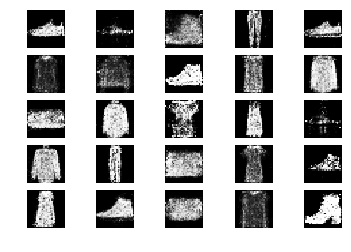

27301 [Discriminator loss: 0.627337, acc.: 60.94%] [Generator loss: 1.097810]
27302 [Discriminator loss: 0.628350, acc.: 67.19%] [Generator loss: 1.042461]
27303 [Discriminator loss: 0.726274, acc.: 57.81%] [Generator loss: 0.904148]
27304 [Discriminator loss: 0.560896, acc.: 71.88%] [Generator loss: 0.804122]
27305 [Discriminator loss: 0.564830, acc.: 67.19%] [Generator loss: 1.066155]
27306 [Discriminator loss: 0.614302, acc.: 60.94%] [Generator loss: 0.967934]
27307 [Discriminator loss: 0.717502, acc.: 54.69%] [Generator loss: 1.088188]
27308 [Discriminator loss: 0.752310, acc.: 53.12%] [Generator loss: 1.067664]
27309 [Discriminator loss: 0.733156, acc.: 45.31%] [Generator loss: 0.845541]
27310 [Discriminator loss: 0.652784, acc.: 64.06%] [Generator loss: 0.944222]
27311 [Discriminator loss: 0.576875, acc.: 71.88%] [Generator loss: 0.922525]
27312 [Discriminator loss: 0.624567, acc.: 64.06%] [Generator loss: 0.909418]
27313 [Discriminator loss: 0.602164, acc.: 65.62%] [Generator lo

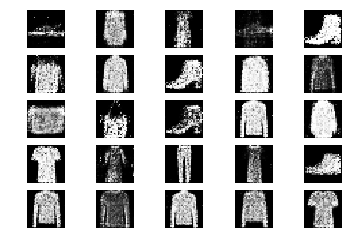

27401 [Discriminator loss: 0.694249, acc.: 53.12%] [Generator loss: 0.929522]
27402 [Discriminator loss: 0.597299, acc.: 70.31%] [Generator loss: 0.971983]
27403 [Discriminator loss: 0.594818, acc.: 67.19%] [Generator loss: 0.922847]
27404 [Discriminator loss: 0.620633, acc.: 60.94%] [Generator loss: 1.014790]
27405 [Discriminator loss: 0.681649, acc.: 54.69%] [Generator loss: 0.935642]
27406 [Discriminator loss: 0.681130, acc.: 59.38%] [Generator loss: 0.915747]
27407 [Discriminator loss: 0.636343, acc.: 64.06%] [Generator loss: 0.954666]
27408 [Discriminator loss: 0.718022, acc.: 48.44%] [Generator loss: 0.899169]
27409 [Discriminator loss: 0.664268, acc.: 53.12%] [Generator loss: 0.911482]
27410 [Discriminator loss: 0.670997, acc.: 56.25%] [Generator loss: 0.843884]
27411 [Discriminator loss: 0.577020, acc.: 67.19%] [Generator loss: 0.900495]
27412 [Discriminator loss: 0.656622, acc.: 62.50%] [Generator loss: 1.010213]
27413 [Discriminator loss: 0.610418, acc.: 65.62%] [Generator lo

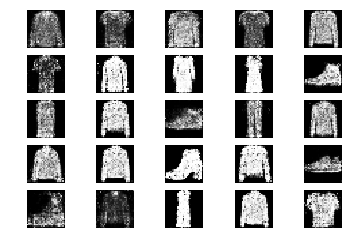

27501 [Discriminator loss: 0.622052, acc.: 60.94%] [Generator loss: 0.837536]
27502 [Discriminator loss: 0.640922, acc.: 60.94%] [Generator loss: 0.887206]
27503 [Discriminator loss: 0.541818, acc.: 78.12%] [Generator loss: 0.964512]
27504 [Discriminator loss: 0.634538, acc.: 64.06%] [Generator loss: 0.971978]
27505 [Discriminator loss: 0.623680, acc.: 70.31%] [Generator loss: 1.154909]
27506 [Discriminator loss: 0.585171, acc.: 76.56%] [Generator loss: 1.091058]
27507 [Discriminator loss: 0.676698, acc.: 57.81%] [Generator loss: 1.060128]
27508 [Discriminator loss: 0.577722, acc.: 68.75%] [Generator loss: 1.039860]
27509 [Discriminator loss: 0.606887, acc.: 67.19%] [Generator loss: 1.006924]
27510 [Discriminator loss: 0.560700, acc.: 71.88%] [Generator loss: 0.924349]
27511 [Discriminator loss: 0.644687, acc.: 59.38%] [Generator loss: 0.947249]
27512 [Discriminator loss: 0.629517, acc.: 56.25%] [Generator loss: 0.958760]
27513 [Discriminator loss: 0.626008, acc.: 65.62%] [Generator lo

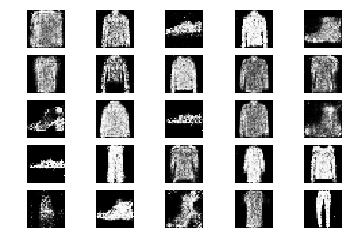

27601 [Discriminator loss: 0.686998, acc.: 59.38%] [Generator loss: 0.943583]
27602 [Discriminator loss: 0.612228, acc.: 67.19%] [Generator loss: 1.007237]
27603 [Discriminator loss: 0.624252, acc.: 62.50%] [Generator loss: 1.064611]
27604 [Discriminator loss: 0.693570, acc.: 62.50%] [Generator loss: 0.976611]
27605 [Discriminator loss: 0.605311, acc.: 67.19%] [Generator loss: 0.877811]
27606 [Discriminator loss: 0.651048, acc.: 62.50%] [Generator loss: 0.914396]
27607 [Discriminator loss: 0.578610, acc.: 70.31%] [Generator loss: 0.976877]
27608 [Discriminator loss: 0.755242, acc.: 53.12%] [Generator loss: 0.941992]
27609 [Discriminator loss: 0.617445, acc.: 64.06%] [Generator loss: 0.897792]
27610 [Discriminator loss: 0.622544, acc.: 62.50%] [Generator loss: 1.089429]
27611 [Discriminator loss: 0.674486, acc.: 54.69%] [Generator loss: 1.055112]
27612 [Discriminator loss: 0.651747, acc.: 59.38%] [Generator loss: 1.094938]
27613 [Discriminator loss: 0.627146, acc.: 62.50%] [Generator lo

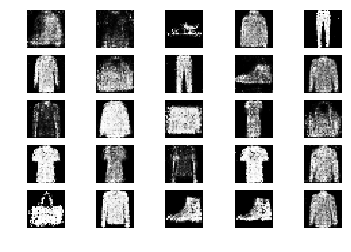

27701 [Discriminator loss: 0.620758, acc.: 65.62%] [Generator loss: 0.851611]
27702 [Discriminator loss: 0.650684, acc.: 62.50%] [Generator loss: 1.000085]
27703 [Discriminator loss: 0.669743, acc.: 54.69%] [Generator loss: 0.977491]
27704 [Discriminator loss: 0.670893, acc.: 59.38%] [Generator loss: 1.010106]
27705 [Discriminator loss: 0.646831, acc.: 64.06%] [Generator loss: 0.943691]
27706 [Discriminator loss: 0.592758, acc.: 67.19%] [Generator loss: 0.923021]
27707 [Discriminator loss: 0.659011, acc.: 64.06%] [Generator loss: 0.934376]
27708 [Discriminator loss: 0.607969, acc.: 70.31%] [Generator loss: 1.100660]
27709 [Discriminator loss: 0.649649, acc.: 60.94%] [Generator loss: 0.884780]
27710 [Discriminator loss: 0.622246, acc.: 64.06%] [Generator loss: 0.976519]
27711 [Discriminator loss: 0.678297, acc.: 59.38%] [Generator loss: 0.976387]
27712 [Discriminator loss: 0.688274, acc.: 57.81%] [Generator loss: 0.979228]
27713 [Discriminator loss: 0.611679, acc.: 64.06%] [Generator lo

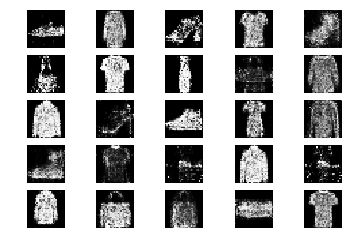

27801 [Discriminator loss: 0.674328, acc.: 59.38%] [Generator loss: 0.950712]
27802 [Discriminator loss: 0.606570, acc.: 73.44%] [Generator loss: 0.975875]
27803 [Discriminator loss: 0.657340, acc.: 57.81%] [Generator loss: 0.882377]
27804 [Discriminator loss: 0.717002, acc.: 53.12%] [Generator loss: 0.902644]
27805 [Discriminator loss: 0.639452, acc.: 64.06%] [Generator loss: 0.942977]
27806 [Discriminator loss: 0.632602, acc.: 62.50%] [Generator loss: 1.018536]
27807 [Discriminator loss: 0.651822, acc.: 60.94%] [Generator loss: 0.909276]
27808 [Discriminator loss: 0.667965, acc.: 57.81%] [Generator loss: 1.006456]
27809 [Discriminator loss: 0.685282, acc.: 56.25%] [Generator loss: 0.986528]
27810 [Discriminator loss: 0.581056, acc.: 68.75%] [Generator loss: 1.031112]
27811 [Discriminator loss: 0.687687, acc.: 65.62%] [Generator loss: 0.997785]
27812 [Discriminator loss: 0.639190, acc.: 62.50%] [Generator loss: 1.077420]
27813 [Discriminator loss: 0.662895, acc.: 59.38%] [Generator lo

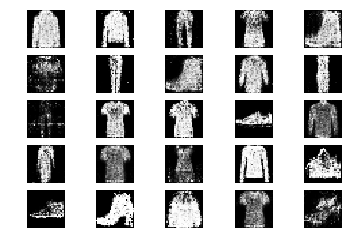

27901 [Discriminator loss: 0.705277, acc.: 50.00%] [Generator loss: 1.004160]
27902 [Discriminator loss: 0.630190, acc.: 64.06%] [Generator loss: 0.950111]
27903 [Discriminator loss: 0.616552, acc.: 65.62%] [Generator loss: 1.068527]
27904 [Discriminator loss: 0.657228, acc.: 67.19%] [Generator loss: 0.946287]
27905 [Discriminator loss: 0.617497, acc.: 62.50%] [Generator loss: 0.973142]
27906 [Discriminator loss: 0.636598, acc.: 62.50%] [Generator loss: 1.087641]
27907 [Discriminator loss: 0.595406, acc.: 71.88%] [Generator loss: 0.946715]
27908 [Discriminator loss: 0.690270, acc.: 56.25%] [Generator loss: 1.029792]
27909 [Discriminator loss: 0.654667, acc.: 62.50%] [Generator loss: 0.947587]
27910 [Discriminator loss: 0.626976, acc.: 67.19%] [Generator loss: 0.987259]
27911 [Discriminator loss: 0.689134, acc.: 62.50%] [Generator loss: 1.024798]
27912 [Discriminator loss: 0.627696, acc.: 68.75%] [Generator loss: 1.018318]
27913 [Discriminator loss: 0.642241, acc.: 65.62%] [Generator lo

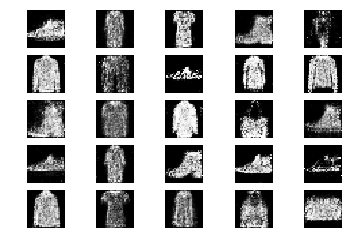

28001 [Discriminator loss: 0.602691, acc.: 68.75%] [Generator loss: 0.991685]
28002 [Discriminator loss: 0.685787, acc.: 53.12%] [Generator loss: 1.006047]
28003 [Discriminator loss: 0.615362, acc.: 59.38%] [Generator loss: 0.988998]
28004 [Discriminator loss: 0.647520, acc.: 64.06%] [Generator loss: 1.017287]
28005 [Discriminator loss: 0.680149, acc.: 62.50%] [Generator loss: 0.968140]
28006 [Discriminator loss: 0.579389, acc.: 70.31%] [Generator loss: 0.926638]
28007 [Discriminator loss: 0.648106, acc.: 60.94%] [Generator loss: 0.973858]
28008 [Discriminator loss: 0.662427, acc.: 56.25%] [Generator loss: 0.969498]
28009 [Discriminator loss: 0.663965, acc.: 57.81%] [Generator loss: 0.999158]
28010 [Discriminator loss: 0.661622, acc.: 56.25%] [Generator loss: 0.959790]
28011 [Discriminator loss: 0.711256, acc.: 53.12%] [Generator loss: 0.940759]
28012 [Discriminator loss: 0.630561, acc.: 54.69%] [Generator loss: 1.032571]
28013 [Discriminator loss: 0.638364, acc.: 65.62%] [Generator lo

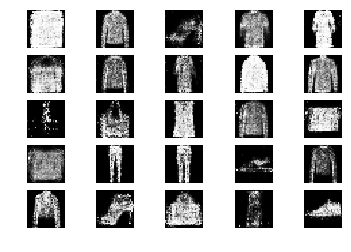

28101 [Discriminator loss: 0.615164, acc.: 68.75%] [Generator loss: 1.017474]
28102 [Discriminator loss: 0.611489, acc.: 71.88%] [Generator loss: 0.970354]
28103 [Discriminator loss: 0.623537, acc.: 62.50%] [Generator loss: 1.015663]
28104 [Discriminator loss: 0.623889, acc.: 64.06%] [Generator loss: 1.071705]
28105 [Discriminator loss: 0.633376, acc.: 64.06%] [Generator loss: 0.952818]
28106 [Discriminator loss: 0.595548, acc.: 70.31%] [Generator loss: 1.109085]
28107 [Discriminator loss: 0.670379, acc.: 59.38%] [Generator loss: 0.983093]
28108 [Discriminator loss: 0.685543, acc.: 60.94%] [Generator loss: 1.012433]
28109 [Discriminator loss: 0.620247, acc.: 64.06%] [Generator loss: 0.886844]
28110 [Discriminator loss: 0.640410, acc.: 62.50%] [Generator loss: 0.903184]
28111 [Discriminator loss: 0.619096, acc.: 68.75%] [Generator loss: 1.002747]
28112 [Discriminator loss: 0.609432, acc.: 75.00%] [Generator loss: 0.871065]
28113 [Discriminator loss: 0.600068, acc.: 67.19%] [Generator lo

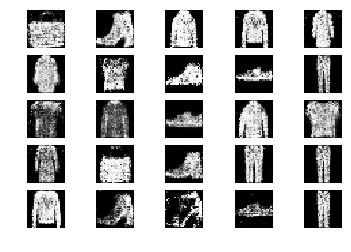

28201 [Discriminator loss: 0.629720, acc.: 64.06%] [Generator loss: 1.031375]
28202 [Discriminator loss: 0.575508, acc.: 70.31%] [Generator loss: 1.119296]
28203 [Discriminator loss: 0.703913, acc.: 53.12%] [Generator loss: 1.052964]
28204 [Discriminator loss: 0.641194, acc.: 57.81%] [Generator loss: 1.049579]
28205 [Discriminator loss: 0.623483, acc.: 67.19%] [Generator loss: 0.960425]
28206 [Discriminator loss: 0.574574, acc.: 71.88%] [Generator loss: 0.978959]
28207 [Discriminator loss: 0.648166, acc.: 70.31%] [Generator loss: 0.979200]
28208 [Discriminator loss: 0.643072, acc.: 64.06%] [Generator loss: 0.970049]
28209 [Discriminator loss: 0.663236, acc.: 57.81%] [Generator loss: 0.934082]
28210 [Discriminator loss: 0.658804, acc.: 60.94%] [Generator loss: 1.001786]
28211 [Discriminator loss: 0.682668, acc.: 64.06%] [Generator loss: 0.912814]
28212 [Discriminator loss: 0.584255, acc.: 67.19%] [Generator loss: 1.019105]
28213 [Discriminator loss: 0.646418, acc.: 60.94%] [Generator lo

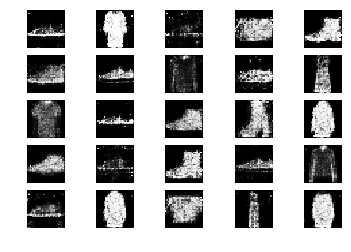

28301 [Discriminator loss: 0.590181, acc.: 64.06%] [Generator loss: 0.941935]
28302 [Discriminator loss: 0.621756, acc.: 67.19%] [Generator loss: 0.871871]
28303 [Discriminator loss: 0.605913, acc.: 70.31%] [Generator loss: 0.974527]
28304 [Discriminator loss: 0.578409, acc.: 78.12%] [Generator loss: 0.983717]
28305 [Discriminator loss: 0.644021, acc.: 62.50%] [Generator loss: 0.886185]
28306 [Discriminator loss: 0.540125, acc.: 75.00%] [Generator loss: 0.996294]
28307 [Discriminator loss: 0.629831, acc.: 60.94%] [Generator loss: 0.929935]
28308 [Discriminator loss: 0.632091, acc.: 62.50%] [Generator loss: 0.937621]
28309 [Discriminator loss: 0.607446, acc.: 64.06%] [Generator loss: 0.848484]
28310 [Discriminator loss: 0.621993, acc.: 67.19%] [Generator loss: 0.886737]
28311 [Discriminator loss: 0.662252, acc.: 57.81%] [Generator loss: 0.929405]
28312 [Discriminator loss: 0.614216, acc.: 65.62%] [Generator loss: 0.980814]
28313 [Discriminator loss: 0.586164, acc.: 73.44%] [Generator lo

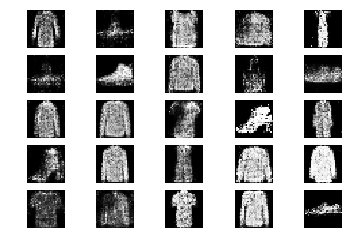

28401 [Discriminator loss: 0.569260, acc.: 70.31%] [Generator loss: 0.901382]
28402 [Discriminator loss: 0.643646, acc.: 62.50%] [Generator loss: 0.941480]
28403 [Discriminator loss: 0.619682, acc.: 64.06%] [Generator loss: 0.864348]
28404 [Discriminator loss: 0.668068, acc.: 54.69%] [Generator loss: 0.970448]
28405 [Discriminator loss: 0.649315, acc.: 62.50%] [Generator loss: 0.951570]
28406 [Discriminator loss: 0.640007, acc.: 65.62%] [Generator loss: 1.089098]
28407 [Discriminator loss: 0.730588, acc.: 48.44%] [Generator loss: 0.932393]
28408 [Discriminator loss: 0.596725, acc.: 65.62%] [Generator loss: 0.940549]
28409 [Discriminator loss: 0.602277, acc.: 73.44%] [Generator loss: 0.973892]
28410 [Discriminator loss: 0.695729, acc.: 56.25%] [Generator loss: 0.856940]
28411 [Discriminator loss: 0.547203, acc.: 70.31%] [Generator loss: 1.019507]
28412 [Discriminator loss: 0.681059, acc.: 60.94%] [Generator loss: 0.868936]
28413 [Discriminator loss: 0.592780, acc.: 67.19%] [Generator lo

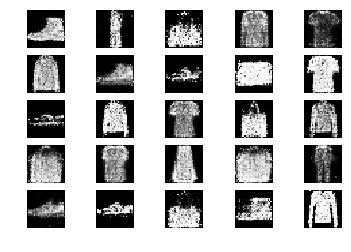

28501 [Discriminator loss: 0.650500, acc.: 62.50%] [Generator loss: 1.000384]
28502 [Discriminator loss: 0.608330, acc.: 62.50%] [Generator loss: 0.927493]
28503 [Discriminator loss: 0.607750, acc.: 57.81%] [Generator loss: 1.010405]
28504 [Discriminator loss: 0.646217, acc.: 57.81%] [Generator loss: 1.125245]
28505 [Discriminator loss: 0.627266, acc.: 71.88%] [Generator loss: 1.010468]
28506 [Discriminator loss: 0.593615, acc.: 71.88%] [Generator loss: 1.022674]
28507 [Discriminator loss: 0.633170, acc.: 62.50%] [Generator loss: 0.968402]
28508 [Discriminator loss: 0.592202, acc.: 65.62%] [Generator loss: 0.957958]
28509 [Discriminator loss: 0.634354, acc.: 65.62%] [Generator loss: 0.995018]
28510 [Discriminator loss: 0.612577, acc.: 70.31%] [Generator loss: 0.958928]
28511 [Discriminator loss: 0.635721, acc.: 59.38%] [Generator loss: 0.959645]
28512 [Discriminator loss: 0.623526, acc.: 65.62%] [Generator loss: 0.895100]
28513 [Discriminator loss: 0.672924, acc.: 51.56%] [Generator lo

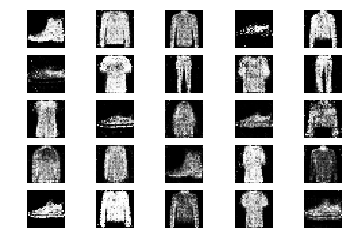

28601 [Discriminator loss: 0.575060, acc.: 71.88%] [Generator loss: 0.983065]
28602 [Discriminator loss: 0.703396, acc.: 57.81%] [Generator loss: 0.916675]
28603 [Discriminator loss: 0.605392, acc.: 56.25%] [Generator loss: 0.919093]
28604 [Discriminator loss: 0.620159, acc.: 65.62%] [Generator loss: 1.056787]
28605 [Discriminator loss: 0.559614, acc.: 68.75%] [Generator loss: 0.868966]
28606 [Discriminator loss: 0.665807, acc.: 57.81%] [Generator loss: 1.002075]
28607 [Discriminator loss: 0.604633, acc.: 73.44%] [Generator loss: 0.912274]
28608 [Discriminator loss: 0.677051, acc.: 54.69%] [Generator loss: 0.928341]
28609 [Discriminator loss: 0.689776, acc.: 57.81%] [Generator loss: 0.938584]
28610 [Discriminator loss: 0.610420, acc.: 65.62%] [Generator loss: 0.976452]
28611 [Discriminator loss: 0.660277, acc.: 60.94%] [Generator loss: 0.940256]
28612 [Discriminator loss: 0.585643, acc.: 68.75%] [Generator loss: 0.868210]
28613 [Discriminator loss: 0.690078, acc.: 60.94%] [Generator lo

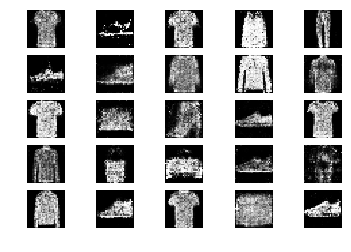

28701 [Discriminator loss: 0.598996, acc.: 70.31%] [Generator loss: 1.043003]
28702 [Discriminator loss: 0.710536, acc.: 56.25%] [Generator loss: 0.967395]
28703 [Discriminator loss: 0.715871, acc.: 51.56%] [Generator loss: 0.985984]
28704 [Discriminator loss: 0.648256, acc.: 62.50%] [Generator loss: 1.099958]
28705 [Discriminator loss: 0.620650, acc.: 70.31%] [Generator loss: 1.034994]
28706 [Discriminator loss: 0.673247, acc.: 57.81%] [Generator loss: 1.011032]
28707 [Discriminator loss: 0.627591, acc.: 67.19%] [Generator loss: 1.073864]
28708 [Discriminator loss: 0.631196, acc.: 65.62%] [Generator loss: 0.981439]
28709 [Discriminator loss: 0.611928, acc.: 68.75%] [Generator loss: 0.958620]
28710 [Discriminator loss: 0.733819, acc.: 50.00%] [Generator loss: 1.018157]
28711 [Discriminator loss: 0.643537, acc.: 59.38%] [Generator loss: 1.001213]
28712 [Discriminator loss: 0.609740, acc.: 60.94%] [Generator loss: 0.992674]
28713 [Discriminator loss: 0.637748, acc.: 65.62%] [Generator lo

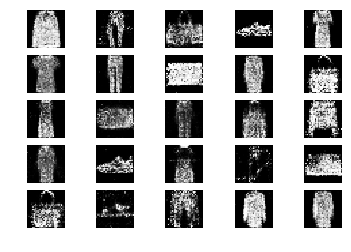

28801 [Discriminator loss: 0.627196, acc.: 67.19%] [Generator loss: 1.076604]
28802 [Discriminator loss: 0.621233, acc.: 67.19%] [Generator loss: 1.039596]
28803 [Discriminator loss: 0.602923, acc.: 68.75%] [Generator loss: 1.071264]
28804 [Discriminator loss: 0.694226, acc.: 50.00%] [Generator loss: 1.049326]
28805 [Discriminator loss: 0.588633, acc.: 67.19%] [Generator loss: 1.001830]
28806 [Discriminator loss: 0.616931, acc.: 68.75%] [Generator loss: 0.872402]
28807 [Discriminator loss: 0.663362, acc.: 57.81%] [Generator loss: 0.977679]
28808 [Discriminator loss: 0.669797, acc.: 59.38%] [Generator loss: 0.881149]
28809 [Discriminator loss: 0.637760, acc.: 65.62%] [Generator loss: 0.836323]
28810 [Discriminator loss: 0.579826, acc.: 68.75%] [Generator loss: 0.856727]
28811 [Discriminator loss: 0.627408, acc.: 62.50%] [Generator loss: 0.938459]
28812 [Discriminator loss: 0.645030, acc.: 53.12%] [Generator loss: 0.965227]
28813 [Discriminator loss: 0.620890, acc.: 59.38%] [Generator lo

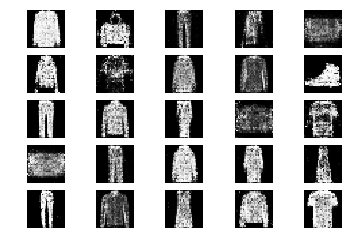

28901 [Discriminator loss: 0.619019, acc.: 68.75%] [Generator loss: 0.975329]
28902 [Discriminator loss: 0.634811, acc.: 59.38%] [Generator loss: 0.899869]
28903 [Discriminator loss: 0.617558, acc.: 70.31%] [Generator loss: 0.954768]
28904 [Discriminator loss: 0.614473, acc.: 65.62%] [Generator loss: 0.960740]
28905 [Discriminator loss: 0.638716, acc.: 65.62%] [Generator loss: 0.890728]
28906 [Discriminator loss: 0.679345, acc.: 59.38%] [Generator loss: 0.879753]
28907 [Discriminator loss: 0.614496, acc.: 64.06%] [Generator loss: 0.995968]
28908 [Discriminator loss: 0.648418, acc.: 65.62%] [Generator loss: 1.173386]
28909 [Discriminator loss: 0.676974, acc.: 64.06%] [Generator loss: 0.989590]
28910 [Discriminator loss: 0.611184, acc.: 71.88%] [Generator loss: 0.948999]
28911 [Discriminator loss: 0.575637, acc.: 71.88%] [Generator loss: 1.000879]
28912 [Discriminator loss: 0.590822, acc.: 68.75%] [Generator loss: 1.024581]
28913 [Discriminator loss: 0.548599, acc.: 75.00%] [Generator lo

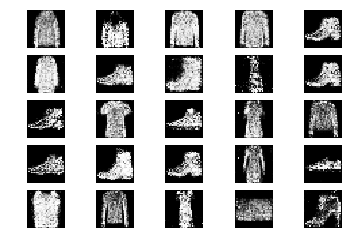

29001 [Discriminator loss: 0.694408, acc.: 60.94%] [Generator loss: 1.082499]
29002 [Discriminator loss: 0.696705, acc.: 57.81%] [Generator loss: 0.978127]
29003 [Discriminator loss: 0.656265, acc.: 62.50%] [Generator loss: 0.964813]
29004 [Discriminator loss: 0.650065, acc.: 59.38%] [Generator loss: 0.931010]
29005 [Discriminator loss: 0.610845, acc.: 70.31%] [Generator loss: 0.905202]
29006 [Discriminator loss: 0.586486, acc.: 65.62%] [Generator loss: 0.915982]
29007 [Discriminator loss: 0.629002, acc.: 62.50%] [Generator loss: 1.024248]
29008 [Discriminator loss: 0.635955, acc.: 70.31%] [Generator loss: 0.892693]
29009 [Discriminator loss: 0.632945, acc.: 60.94%] [Generator loss: 0.905966]
29010 [Discriminator loss: 0.592777, acc.: 68.75%] [Generator loss: 0.973997]
29011 [Discriminator loss: 0.600935, acc.: 70.31%] [Generator loss: 0.877259]
29012 [Discriminator loss: 0.642103, acc.: 62.50%] [Generator loss: 1.016224]
29013 [Discriminator loss: 0.623755, acc.: 62.50%] [Generator lo

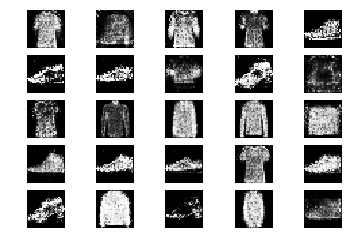

29101 [Discriminator loss: 0.635099, acc.: 60.94%] [Generator loss: 1.017349]
29102 [Discriminator loss: 0.570099, acc.: 64.06%] [Generator loss: 1.091463]
29103 [Discriminator loss: 0.641160, acc.: 65.62%] [Generator loss: 1.011781]
29104 [Discriminator loss: 0.620745, acc.: 64.06%] [Generator loss: 1.073853]
29105 [Discriminator loss: 0.581795, acc.: 70.31%] [Generator loss: 1.017856]
29106 [Discriminator loss: 0.597008, acc.: 68.75%] [Generator loss: 1.003838]
29107 [Discriminator loss: 0.645047, acc.: 65.62%] [Generator loss: 1.003967]
29108 [Discriminator loss: 0.635265, acc.: 65.62%] [Generator loss: 0.983178]
29109 [Discriminator loss: 0.610111, acc.: 68.75%] [Generator loss: 0.996616]
29110 [Discriminator loss: 0.564695, acc.: 70.31%] [Generator loss: 1.060235]
29111 [Discriminator loss: 0.705886, acc.: 59.38%] [Generator loss: 0.985206]
29112 [Discriminator loss: 0.640776, acc.: 59.38%] [Generator loss: 0.960255]
29113 [Discriminator loss: 0.510830, acc.: 79.69%] [Generator lo

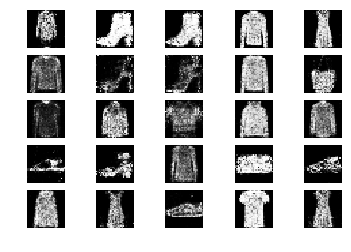

29201 [Discriminator loss: 0.657384, acc.: 59.38%] [Generator loss: 0.992753]
29202 [Discriminator loss: 0.596463, acc.: 65.62%] [Generator loss: 0.841515]
29203 [Discriminator loss: 0.664499, acc.: 62.50%] [Generator loss: 0.977870]
29204 [Discriminator loss: 0.608675, acc.: 68.75%] [Generator loss: 0.983661]
29205 [Discriminator loss: 0.634682, acc.: 57.81%] [Generator loss: 0.980644]
29206 [Discriminator loss: 0.604819, acc.: 70.31%] [Generator loss: 0.974061]
29207 [Discriminator loss: 0.665772, acc.: 57.81%] [Generator loss: 1.017912]
29208 [Discriminator loss: 0.629767, acc.: 60.94%] [Generator loss: 0.955750]
29209 [Discriminator loss: 0.563709, acc.: 67.19%] [Generator loss: 0.912189]
29210 [Discriminator loss: 0.594849, acc.: 64.06%] [Generator loss: 1.024909]
29211 [Discriminator loss: 0.706817, acc.: 46.88%] [Generator loss: 0.984969]
29212 [Discriminator loss: 0.621840, acc.: 65.62%] [Generator loss: 1.011125]
29213 [Discriminator loss: 0.628527, acc.: 67.19%] [Generator lo

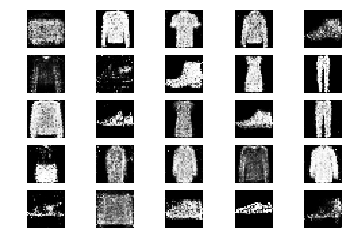

29301 [Discriminator loss: 0.661638, acc.: 59.38%] [Generator loss: 0.995734]
29302 [Discriminator loss: 0.649237, acc.: 57.81%] [Generator loss: 1.027291]
29303 [Discriminator loss: 0.566855, acc.: 78.12%] [Generator loss: 0.939478]
29304 [Discriminator loss: 0.709976, acc.: 51.56%] [Generator loss: 0.959845]
29305 [Discriminator loss: 0.598833, acc.: 64.06%] [Generator loss: 0.999390]
29306 [Discriminator loss: 0.647929, acc.: 62.50%] [Generator loss: 0.931825]
29307 [Discriminator loss: 0.633550, acc.: 65.62%] [Generator loss: 0.918572]
29308 [Discriminator loss: 0.636156, acc.: 62.50%] [Generator loss: 0.993093]
29309 [Discriminator loss: 0.664299, acc.: 64.06%] [Generator loss: 1.044186]
29310 [Discriminator loss: 0.682140, acc.: 51.56%] [Generator loss: 0.982875]
29311 [Discriminator loss: 0.571009, acc.: 75.00%] [Generator loss: 0.983268]
29312 [Discriminator loss: 0.615024, acc.: 64.06%] [Generator loss: 1.032088]
29313 [Discriminator loss: 0.636045, acc.: 64.06%] [Generator lo

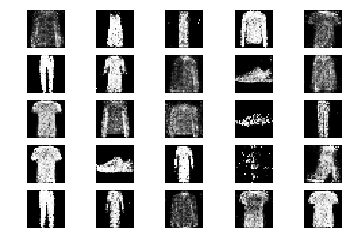

29401 [Discriminator loss: 0.614424, acc.: 67.19%] [Generator loss: 1.047588]
29402 [Discriminator loss: 0.603447, acc.: 68.75%] [Generator loss: 1.079858]
29403 [Discriminator loss: 0.635693, acc.: 64.06%] [Generator loss: 0.970792]
29404 [Discriminator loss: 0.630387, acc.: 70.31%] [Generator loss: 1.057172]
29405 [Discriminator loss: 0.642405, acc.: 68.75%] [Generator loss: 1.102702]
29406 [Discriminator loss: 0.605081, acc.: 60.94%] [Generator loss: 1.035053]
29407 [Discriminator loss: 0.584863, acc.: 67.19%] [Generator loss: 0.941604]
29408 [Discriminator loss: 0.681122, acc.: 60.94%] [Generator loss: 0.964896]
29409 [Discriminator loss: 0.592088, acc.: 70.31%] [Generator loss: 0.960495]
29410 [Discriminator loss: 0.711140, acc.: 57.81%] [Generator loss: 1.016971]
29411 [Discriminator loss: 0.586618, acc.: 71.88%] [Generator loss: 1.031817]
29412 [Discriminator loss: 0.621667, acc.: 65.62%] [Generator loss: 1.026986]
29413 [Discriminator loss: 0.599306, acc.: 57.81%] [Generator lo

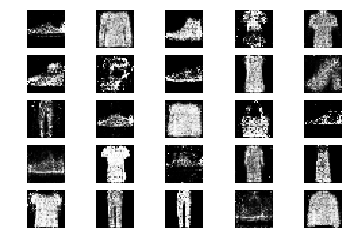

29501 [Discriminator loss: 0.605615, acc.: 64.06%] [Generator loss: 1.013015]
29502 [Discriminator loss: 0.667510, acc.: 60.94%] [Generator loss: 1.001820]
29503 [Discriminator loss: 0.629008, acc.: 67.19%] [Generator loss: 0.956735]
29504 [Discriminator loss: 0.567967, acc.: 67.19%] [Generator loss: 1.056269]
29505 [Discriminator loss: 0.616524, acc.: 67.19%] [Generator loss: 1.055263]
29506 [Discriminator loss: 0.657983, acc.: 56.25%] [Generator loss: 1.009325]
29507 [Discriminator loss: 0.606483, acc.: 64.06%] [Generator loss: 0.974081]
29508 [Discriminator loss: 0.634409, acc.: 62.50%] [Generator loss: 1.001991]
29509 [Discriminator loss: 0.689672, acc.: 56.25%] [Generator loss: 1.045186]
29510 [Discriminator loss: 0.659235, acc.: 56.25%] [Generator loss: 1.082767]
29511 [Discriminator loss: 0.628051, acc.: 67.19%] [Generator loss: 0.973380]
29512 [Discriminator loss: 0.689149, acc.: 59.38%] [Generator loss: 0.947756]
29513 [Discriminator loss: 0.665435, acc.: 59.38%] [Generator lo

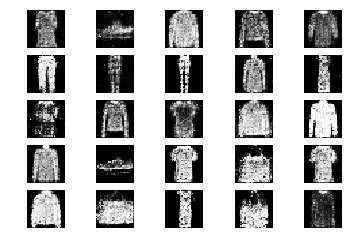

29601 [Discriminator loss: 0.633896, acc.: 64.06%] [Generator loss: 0.978572]
29602 [Discriminator loss: 0.605567, acc.: 68.75%] [Generator loss: 0.940878]
29603 [Discriminator loss: 0.591908, acc.: 71.88%] [Generator loss: 0.969523]
29604 [Discriminator loss: 0.586453, acc.: 65.62%] [Generator loss: 0.978272]
29605 [Discriminator loss: 0.649827, acc.: 64.06%] [Generator loss: 0.933808]
29606 [Discriminator loss: 0.644058, acc.: 59.38%] [Generator loss: 0.812681]
29607 [Discriminator loss: 0.669627, acc.: 59.38%] [Generator loss: 0.987834]
29608 [Discriminator loss: 0.629330, acc.: 65.62%] [Generator loss: 1.025135]
29609 [Discriminator loss: 0.607001, acc.: 67.19%] [Generator loss: 0.894707]
29610 [Discriminator loss: 0.675245, acc.: 59.38%] [Generator loss: 1.041130]
29611 [Discriminator loss: 0.607858, acc.: 68.75%] [Generator loss: 0.992482]
29612 [Discriminator loss: 0.640880, acc.: 64.06%] [Generator loss: 1.063855]
29613 [Discriminator loss: 0.701876, acc.: 60.94%] [Generator lo

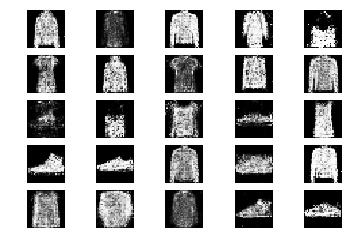

29701 [Discriminator loss: 0.696137, acc.: 54.69%] [Generator loss: 0.991444]
29702 [Discriminator loss: 0.658541, acc.: 56.25%] [Generator loss: 0.973234]
29703 [Discriminator loss: 0.648440, acc.: 67.19%] [Generator loss: 1.112032]
29704 [Discriminator loss: 0.635595, acc.: 65.62%] [Generator loss: 1.006714]
29705 [Discriminator loss: 0.637304, acc.: 70.31%] [Generator loss: 0.930270]
29706 [Discriminator loss: 0.693036, acc.: 57.81%] [Generator loss: 1.004393]
29707 [Discriminator loss: 0.603792, acc.: 62.50%] [Generator loss: 0.978820]
29708 [Discriminator loss: 0.537724, acc.: 70.31%] [Generator loss: 1.002816]
29709 [Discriminator loss: 0.637621, acc.: 62.50%] [Generator loss: 1.068750]
29710 [Discriminator loss: 0.686707, acc.: 62.50%] [Generator loss: 0.956398]
29711 [Discriminator loss: 0.653845, acc.: 59.38%] [Generator loss: 1.026616]
29712 [Discriminator loss: 0.675088, acc.: 57.81%] [Generator loss: 0.982577]
29713 [Discriminator loss: 0.608224, acc.: 71.88%] [Generator lo

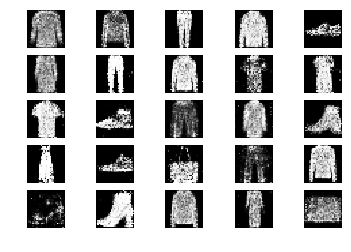

29801 [Discriminator loss: 0.685448, acc.: 56.25%] [Generator loss: 1.045920]
29802 [Discriminator loss: 0.586672, acc.: 73.44%] [Generator loss: 1.083949]
29803 [Discriminator loss: 0.696598, acc.: 57.81%] [Generator loss: 1.004529]
29804 [Discriminator loss: 0.648054, acc.: 62.50%] [Generator loss: 0.933519]
29805 [Discriminator loss: 0.608255, acc.: 65.62%] [Generator loss: 0.986194]
29806 [Discriminator loss: 0.579221, acc.: 71.88%] [Generator loss: 0.997452]
29807 [Discriminator loss: 0.640693, acc.: 73.44%] [Generator loss: 1.038741]
29808 [Discriminator loss: 0.706342, acc.: 59.38%] [Generator loss: 0.913001]
29809 [Discriminator loss: 0.684551, acc.: 53.12%] [Generator loss: 0.916568]
29810 [Discriminator loss: 0.647575, acc.: 56.25%] [Generator loss: 0.989085]
29811 [Discriminator loss: 0.632361, acc.: 57.81%] [Generator loss: 0.963881]
29812 [Discriminator loss: 0.653868, acc.: 60.94%] [Generator loss: 1.014120]
29813 [Discriminator loss: 0.674481, acc.: 59.38%] [Generator lo

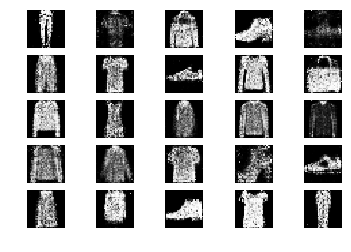

29901 [Discriminator loss: 0.607276, acc.: 60.94%] [Generator loss: 1.041147]
29902 [Discriminator loss: 0.663577, acc.: 62.50%] [Generator loss: 1.057995]
29903 [Discriminator loss: 0.636435, acc.: 59.38%] [Generator loss: 1.056112]
29904 [Discriminator loss: 0.571900, acc.: 71.88%] [Generator loss: 0.987208]
29905 [Discriminator loss: 0.665146, acc.: 65.62%] [Generator loss: 1.114537]
29906 [Discriminator loss: 0.655688, acc.: 59.38%] [Generator loss: 1.036036]
29907 [Discriminator loss: 0.661831, acc.: 59.38%] [Generator loss: 1.023611]
29908 [Discriminator loss: 0.601074, acc.: 68.75%] [Generator loss: 0.983382]
29909 [Discriminator loss: 0.633630, acc.: 71.88%] [Generator loss: 0.899663]
29910 [Discriminator loss: 0.624838, acc.: 62.50%] [Generator loss: 0.953465]
29911 [Discriminator loss: 0.570371, acc.: 76.56%] [Generator loss: 0.934736]
29912 [Discriminator loss: 0.593764, acc.: 67.19%] [Generator loss: 0.953516]
29913 [Discriminator loss: 0.657243, acc.: 59.38%] [Generator lo

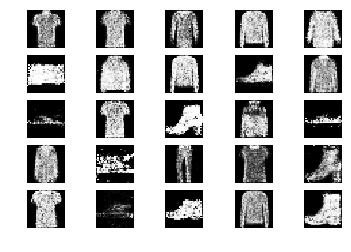

30001 [Discriminator loss: 0.575696, acc.: 62.50%] [Generator loss: 0.963740]
30002 [Discriminator loss: 0.630857, acc.: 62.50%] [Generator loss: 0.977858]
30003 [Discriminator loss: 0.648628, acc.: 68.75%] [Generator loss: 1.084255]
30004 [Discriminator loss: 0.618788, acc.: 71.88%] [Generator loss: 1.001380]
30005 [Discriminator loss: 0.673288, acc.: 60.94%] [Generator loss: 1.059329]
30006 [Discriminator loss: 0.684161, acc.: 56.25%] [Generator loss: 0.937387]
30007 [Discriminator loss: 0.649042, acc.: 62.50%] [Generator loss: 1.077978]
30008 [Discriminator loss: 0.695564, acc.: 50.00%] [Generator loss: 0.949179]
30009 [Discriminator loss: 0.554056, acc.: 76.56%] [Generator loss: 1.001559]
30010 [Discriminator loss: 0.687813, acc.: 65.62%] [Generator loss: 0.922643]
30011 [Discriminator loss: 0.585349, acc.: 73.44%] [Generator loss: 0.927365]
30012 [Discriminator loss: 0.624708, acc.: 62.50%] [Generator loss: 1.035006]
30013 [Discriminator loss: 0.704426, acc.: 59.38%] [Generator lo

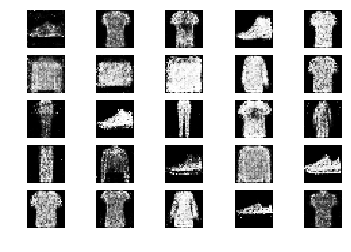

30101 [Discriminator loss: 0.574343, acc.: 65.62%] [Generator loss: 0.981014]
30102 [Discriminator loss: 0.686839, acc.: 57.81%] [Generator loss: 0.983606]
30103 [Discriminator loss: 0.655243, acc.: 67.19%] [Generator loss: 0.999784]
30104 [Discriminator loss: 0.632657, acc.: 62.50%] [Generator loss: 0.911913]
30105 [Discriminator loss: 0.698636, acc.: 56.25%] [Generator loss: 1.000868]
30106 [Discriminator loss: 0.618907, acc.: 62.50%] [Generator loss: 1.093439]
30107 [Discriminator loss: 0.597349, acc.: 62.50%] [Generator loss: 0.988570]
30108 [Discriminator loss: 0.623199, acc.: 62.50%] [Generator loss: 1.021820]
30109 [Discriminator loss: 0.717591, acc.: 53.12%] [Generator loss: 0.882886]
30110 [Discriminator loss: 0.643582, acc.: 60.94%] [Generator loss: 0.860170]
30111 [Discriminator loss: 0.647067, acc.: 60.94%] [Generator loss: 1.077188]
30112 [Discriminator loss: 0.607255, acc.: 68.75%] [Generator loss: 1.059562]
30113 [Discriminator loss: 0.661080, acc.: 59.38%] [Generator lo

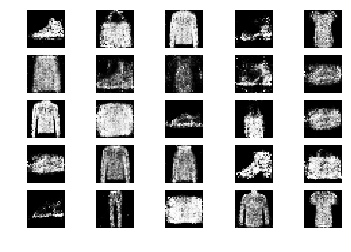

30201 [Discriminator loss: 0.597861, acc.: 75.00%] [Generator loss: 0.888443]
30202 [Discriminator loss: 0.665079, acc.: 60.94%] [Generator loss: 0.892127]
30203 [Discriminator loss: 0.626214, acc.: 64.06%] [Generator loss: 0.918700]
30204 [Discriminator loss: 0.620958, acc.: 60.94%] [Generator loss: 0.968608]
30205 [Discriminator loss: 0.699961, acc.: 60.94%] [Generator loss: 1.018032]
30206 [Discriminator loss: 0.655005, acc.: 54.69%] [Generator loss: 1.006081]
30207 [Discriminator loss: 0.625905, acc.: 64.06%] [Generator loss: 1.030440]
30208 [Discriminator loss: 0.582947, acc.: 76.56%] [Generator loss: 1.066823]
30209 [Discriminator loss: 0.669345, acc.: 62.50%] [Generator loss: 0.926689]
30210 [Discriminator loss: 0.589993, acc.: 79.69%] [Generator loss: 0.925579]
30211 [Discriminator loss: 0.594349, acc.: 71.88%] [Generator loss: 0.995233]
30212 [Discriminator loss: 0.630290, acc.: 62.50%] [Generator loss: 0.965604]
30213 [Discriminator loss: 0.684273, acc.: 60.94%] [Generator lo

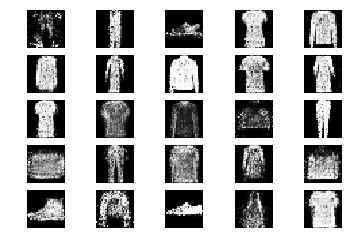

30301 [Discriminator loss: 0.664792, acc.: 60.94%] [Generator loss: 1.003169]
30302 [Discriminator loss: 0.589388, acc.: 73.44%] [Generator loss: 0.998025]
30303 [Discriminator loss: 0.608066, acc.: 68.75%] [Generator loss: 0.996837]
30304 [Discriminator loss: 0.687707, acc.: 57.81%] [Generator loss: 0.970435]
30305 [Discriminator loss: 0.583980, acc.: 70.31%] [Generator loss: 1.059832]
30306 [Discriminator loss: 0.728659, acc.: 48.44%] [Generator loss: 1.099582]
30307 [Discriminator loss: 0.704191, acc.: 54.69%] [Generator loss: 1.031489]
30308 [Discriminator loss: 0.674826, acc.: 56.25%] [Generator loss: 1.091777]
30309 [Discriminator loss: 0.669717, acc.: 65.62%] [Generator loss: 1.005716]
30310 [Discriminator loss: 0.649709, acc.: 50.00%] [Generator loss: 0.894314]
30311 [Discriminator loss: 0.681622, acc.: 57.81%] [Generator loss: 0.870595]
30312 [Discriminator loss: 0.681198, acc.: 57.81%] [Generator loss: 1.028030]
30313 [Discriminator loss: 0.623540, acc.: 67.19%] [Generator lo

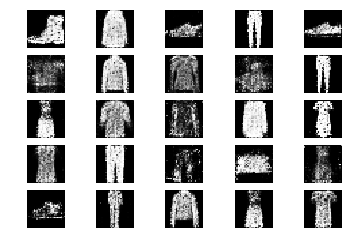

30401 [Discriminator loss: 0.631049, acc.: 70.31%] [Generator loss: 0.970302]
30402 [Discriminator loss: 0.678298, acc.: 64.06%] [Generator loss: 1.052435]
30403 [Discriminator loss: 0.605352, acc.: 73.44%] [Generator loss: 0.984584]
30404 [Discriminator loss: 0.615924, acc.: 64.06%] [Generator loss: 1.055400]
30405 [Discriminator loss: 0.588855, acc.: 65.62%] [Generator loss: 0.942863]
30406 [Discriminator loss: 0.608516, acc.: 67.19%] [Generator loss: 1.001203]
30407 [Discriminator loss: 0.585217, acc.: 71.88%] [Generator loss: 0.952822]
30408 [Discriminator loss: 0.696837, acc.: 53.12%] [Generator loss: 1.070483]
30409 [Discriminator loss: 0.709407, acc.: 54.69%] [Generator loss: 1.075079]
30410 [Discriminator loss: 0.661709, acc.: 65.62%] [Generator loss: 1.031889]
30411 [Discriminator loss: 0.587872, acc.: 68.75%] [Generator loss: 1.074925]
30412 [Discriminator loss: 0.587650, acc.: 70.31%] [Generator loss: 0.976001]
30413 [Discriminator loss: 0.713626, acc.: 57.81%] [Generator lo

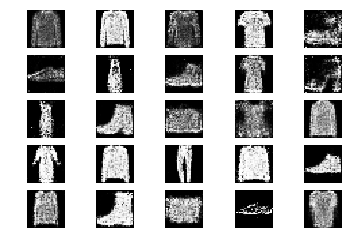

30501 [Discriminator loss: 0.687997, acc.: 51.56%] [Generator loss: 0.839047]
30502 [Discriminator loss: 0.624988, acc.: 64.06%] [Generator loss: 0.943621]
30503 [Discriminator loss: 0.657789, acc.: 56.25%] [Generator loss: 0.914391]
30504 [Discriminator loss: 0.705207, acc.: 57.81%] [Generator loss: 1.030214]
30505 [Discriminator loss: 0.619269, acc.: 65.62%] [Generator loss: 0.927591]
30506 [Discriminator loss: 0.664628, acc.: 60.94%] [Generator loss: 0.947016]
30507 [Discriminator loss: 0.660965, acc.: 62.50%] [Generator loss: 0.979779]
30508 [Discriminator loss: 0.637656, acc.: 57.81%] [Generator loss: 1.055019]
30509 [Discriminator loss: 0.667273, acc.: 65.62%] [Generator loss: 0.917951]
30510 [Discriminator loss: 0.677615, acc.: 54.69%] [Generator loss: 0.987809]
30511 [Discriminator loss: 0.709004, acc.: 57.81%] [Generator loss: 0.810113]
30512 [Discriminator loss: 0.621651, acc.: 57.81%] [Generator loss: 0.961561]
30513 [Discriminator loss: 0.663431, acc.: 53.12%] [Generator lo

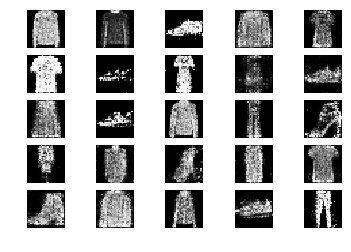

30601 [Discriminator loss: 0.575781, acc.: 75.00%] [Generator loss: 1.096588]
30602 [Discriminator loss: 0.545316, acc.: 76.56%] [Generator loss: 1.076475]
30603 [Discriminator loss: 0.664348, acc.: 62.50%] [Generator loss: 1.016873]
30604 [Discriminator loss: 0.663027, acc.: 64.06%] [Generator loss: 1.021394]
30605 [Discriminator loss: 0.633505, acc.: 64.06%] [Generator loss: 1.045208]
30606 [Discriminator loss: 0.583060, acc.: 75.00%] [Generator loss: 1.001629]
30607 [Discriminator loss: 0.622114, acc.: 64.06%] [Generator loss: 1.115448]
30608 [Discriminator loss: 0.645857, acc.: 68.75%] [Generator loss: 1.130960]
30609 [Discriminator loss: 0.609980, acc.: 68.75%] [Generator loss: 1.103239]
30610 [Discriminator loss: 0.604845, acc.: 71.88%] [Generator loss: 1.040025]
30611 [Discriminator loss: 0.607500, acc.: 60.94%] [Generator loss: 0.927902]
30612 [Discriminator loss: 0.606056, acc.: 70.31%] [Generator loss: 0.960935]
30613 [Discriminator loss: 0.615945, acc.: 67.19%] [Generator lo

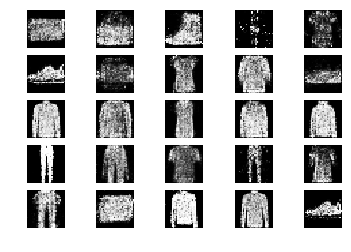

30701 [Discriminator loss: 0.624738, acc.: 62.50%] [Generator loss: 0.892681]
30702 [Discriminator loss: 0.644030, acc.: 59.38%] [Generator loss: 0.843200]
30703 [Discriminator loss: 0.623610, acc.: 60.94%] [Generator loss: 0.896193]
30704 [Discriminator loss: 0.616855, acc.: 65.62%] [Generator loss: 1.043857]
30705 [Discriminator loss: 0.566709, acc.: 70.31%] [Generator loss: 0.959750]
30706 [Discriminator loss: 0.568195, acc.: 75.00%] [Generator loss: 0.978416]
30707 [Discriminator loss: 0.653209, acc.: 64.06%] [Generator loss: 0.976903]
30708 [Discriminator loss: 0.614231, acc.: 67.19%] [Generator loss: 0.962018]
30709 [Discriminator loss: 0.717664, acc.: 57.81%] [Generator loss: 1.061778]
30710 [Discriminator loss: 0.667149, acc.: 60.94%] [Generator loss: 1.025476]
30711 [Discriminator loss: 0.625357, acc.: 67.19%] [Generator loss: 0.957699]
30712 [Discriminator loss: 0.612804, acc.: 60.94%] [Generator loss: 1.155305]
30713 [Discriminator loss: 0.629510, acc.: 65.62%] [Generator lo

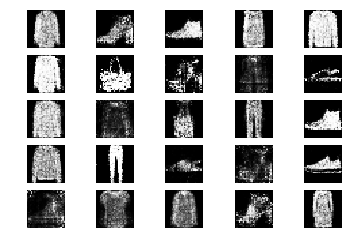

30801 [Discriminator loss: 0.657679, acc.: 60.94%] [Generator loss: 1.135423]
30802 [Discriminator loss: 0.662183, acc.: 56.25%] [Generator loss: 0.998728]
30803 [Discriminator loss: 0.682430, acc.: 60.94%] [Generator loss: 1.030299]
30804 [Discriminator loss: 0.635733, acc.: 64.06%] [Generator loss: 1.041937]
30805 [Discriminator loss: 0.561837, acc.: 75.00%] [Generator loss: 1.025800]
30806 [Discriminator loss: 0.627634, acc.: 60.94%] [Generator loss: 0.986701]
30807 [Discriminator loss: 0.712985, acc.: 53.12%] [Generator loss: 0.983563]
30808 [Discriminator loss: 0.662911, acc.: 64.06%] [Generator loss: 0.937415]
30809 [Discriminator loss: 0.621258, acc.: 62.50%] [Generator loss: 1.004024]
30810 [Discriminator loss: 0.649043, acc.: 59.38%] [Generator loss: 0.859668]
30811 [Discriminator loss: 0.635860, acc.: 64.06%] [Generator loss: 0.961061]
30812 [Discriminator loss: 0.630331, acc.: 68.75%] [Generator loss: 0.991053]
30813 [Discriminator loss: 0.658747, acc.: 53.12%] [Generator lo

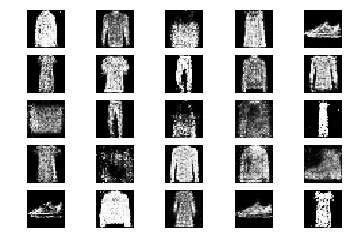

30901 [Discriminator loss: 0.678628, acc.: 57.81%] [Generator loss: 0.890387]
30902 [Discriminator loss: 0.658388, acc.: 60.94%] [Generator loss: 1.007588]
30903 [Discriminator loss: 0.678770, acc.: 59.38%] [Generator loss: 1.015269]
30904 [Discriminator loss: 0.643404, acc.: 65.62%] [Generator loss: 0.931997]
30905 [Discriminator loss: 0.614684, acc.: 65.62%] [Generator loss: 1.038420]
30906 [Discriminator loss: 0.632478, acc.: 64.06%] [Generator loss: 0.962479]
30907 [Discriminator loss: 0.623415, acc.: 68.75%] [Generator loss: 0.998736]
30908 [Discriminator loss: 0.653229, acc.: 57.81%] [Generator loss: 0.941087]
30909 [Discriminator loss: 0.557961, acc.: 71.88%] [Generator loss: 1.056211]
30910 [Discriminator loss: 0.634612, acc.: 65.62%] [Generator loss: 1.126493]
30911 [Discriminator loss: 0.676918, acc.: 59.38%] [Generator loss: 1.031994]
30912 [Discriminator loss: 0.561908, acc.: 78.12%] [Generator loss: 0.896430]
30913 [Discriminator loss: 0.702237, acc.: 57.81%] [Generator lo

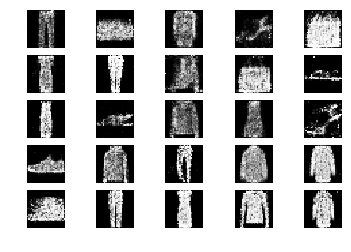

31001 [Discriminator loss: 0.539031, acc.: 75.00%] [Generator loss: 0.935771]
31002 [Discriminator loss: 0.676025, acc.: 67.19%] [Generator loss: 1.013834]
31003 [Discriminator loss: 0.599275, acc.: 65.62%] [Generator loss: 0.905652]
31004 [Discriminator loss: 0.640808, acc.: 60.94%] [Generator loss: 0.905306]
31005 [Discriminator loss: 0.776476, acc.: 45.31%] [Generator loss: 0.964106]
31006 [Discriminator loss: 0.634383, acc.: 65.62%] [Generator loss: 0.936778]
31007 [Discriminator loss: 0.644109, acc.: 62.50%] [Generator loss: 1.036635]
31008 [Discriminator loss: 0.705386, acc.: 54.69%] [Generator loss: 1.058007]
31009 [Discriminator loss: 0.583723, acc.: 65.62%] [Generator loss: 1.141431]
31010 [Discriminator loss: 0.588180, acc.: 65.62%] [Generator loss: 1.053599]
31011 [Discriminator loss: 0.701191, acc.: 54.69%] [Generator loss: 1.025017]
31012 [Discriminator loss: 0.620554, acc.: 60.94%] [Generator loss: 0.965169]
31013 [Discriminator loss: 0.668289, acc.: 62.50%] [Generator lo

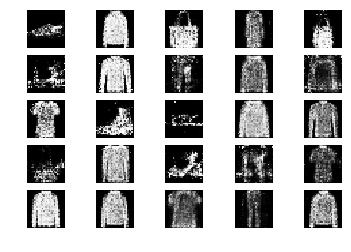

31101 [Discriminator loss: 0.521007, acc.: 79.69%] [Generator loss: 1.032959]
31102 [Discriminator loss: 0.797194, acc.: 50.00%] [Generator loss: 1.040757]
31103 [Discriminator loss: 0.582372, acc.: 68.75%] [Generator loss: 1.091959]
31104 [Discriminator loss: 0.616101, acc.: 62.50%] [Generator loss: 1.089418]
31105 [Discriminator loss: 0.637763, acc.: 65.62%] [Generator loss: 1.114176]
31106 [Discriminator loss: 0.664741, acc.: 60.94%] [Generator loss: 1.056837]
31107 [Discriminator loss: 0.596569, acc.: 65.62%] [Generator loss: 1.010820]
31108 [Discriminator loss: 0.578125, acc.: 67.19%] [Generator loss: 1.029855]
31109 [Discriminator loss: 0.654209, acc.: 62.50%] [Generator loss: 0.993042]
31110 [Discriminator loss: 0.651791, acc.: 57.81%] [Generator loss: 0.898534]
31111 [Discriminator loss: 0.675982, acc.: 59.38%] [Generator loss: 1.019830]
31112 [Discriminator loss: 0.645779, acc.: 64.06%] [Generator loss: 0.958157]
31113 [Discriminator loss: 0.604008, acc.: 64.06%] [Generator lo

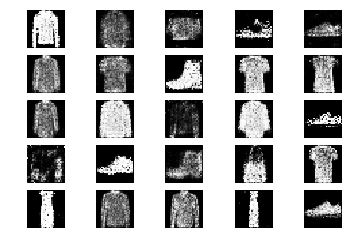

31201 [Discriminator loss: 0.563199, acc.: 76.56%] [Generator loss: 1.003722]
31202 [Discriminator loss: 0.620185, acc.: 65.62%] [Generator loss: 0.990579]
31203 [Discriminator loss: 0.630573, acc.: 60.94%] [Generator loss: 0.955630]
31204 [Discriminator loss: 0.601101, acc.: 71.88%] [Generator loss: 0.918670]
31205 [Discriminator loss: 0.585063, acc.: 71.88%] [Generator loss: 0.925789]
31206 [Discriminator loss: 0.576719, acc.: 65.62%] [Generator loss: 1.032325]
31207 [Discriminator loss: 0.656679, acc.: 54.69%] [Generator loss: 1.008398]
31208 [Discriminator loss: 0.615079, acc.: 67.19%] [Generator loss: 1.071840]
31209 [Discriminator loss: 0.653857, acc.: 53.12%] [Generator loss: 0.976592]
31210 [Discriminator loss: 0.628949, acc.: 62.50%] [Generator loss: 1.023316]
31211 [Discriminator loss: 0.633416, acc.: 65.62%] [Generator loss: 1.097797]
31212 [Discriminator loss: 0.604331, acc.: 68.75%] [Generator loss: 1.059422]
31213 [Discriminator loss: 0.632799, acc.: 60.94%] [Generator lo

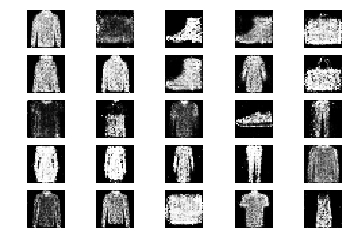

31301 [Discriminator loss: 0.680261, acc.: 59.38%] [Generator loss: 0.925896]
31302 [Discriminator loss: 0.655303, acc.: 60.94%] [Generator loss: 0.987032]
31303 [Discriminator loss: 0.607465, acc.: 67.19%] [Generator loss: 1.043512]
31304 [Discriminator loss: 0.690446, acc.: 54.69%] [Generator loss: 1.186849]
31305 [Discriminator loss: 0.623184, acc.: 64.06%] [Generator loss: 1.085492]
31306 [Discriminator loss: 0.662207, acc.: 56.25%] [Generator loss: 1.026334]
31307 [Discriminator loss: 0.684908, acc.: 56.25%] [Generator loss: 0.971797]
31308 [Discriminator loss: 0.607336, acc.: 73.44%] [Generator loss: 0.991383]
31309 [Discriminator loss: 0.519565, acc.: 78.12%] [Generator loss: 0.962146]
31310 [Discriminator loss: 0.618542, acc.: 54.69%] [Generator loss: 0.951259]
31311 [Discriminator loss: 0.674053, acc.: 56.25%] [Generator loss: 0.997097]
31312 [Discriminator loss: 0.678016, acc.: 64.06%] [Generator loss: 0.926474]
31313 [Discriminator loss: 0.646769, acc.: 59.38%] [Generator lo

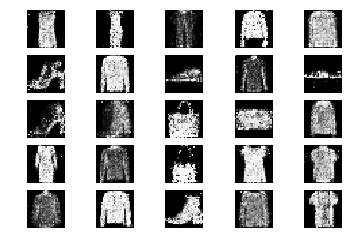

31401 [Discriminator loss: 0.651248, acc.: 62.50%] [Generator loss: 0.862758]
31402 [Discriminator loss: 0.683654, acc.: 56.25%] [Generator loss: 0.910868]
31403 [Discriminator loss: 0.628764, acc.: 62.50%] [Generator loss: 0.839924]
31404 [Discriminator loss: 0.610518, acc.: 62.50%] [Generator loss: 0.939043]
31405 [Discriminator loss: 0.656177, acc.: 65.62%] [Generator loss: 1.012260]
31406 [Discriminator loss: 0.659528, acc.: 59.38%] [Generator loss: 0.904971]
31407 [Discriminator loss: 0.677355, acc.: 60.94%] [Generator loss: 1.033525]
31408 [Discriminator loss: 0.622659, acc.: 67.19%] [Generator loss: 1.038164]
31409 [Discriminator loss: 0.577581, acc.: 73.44%] [Generator loss: 1.056786]
31410 [Discriminator loss: 0.583830, acc.: 71.88%] [Generator loss: 0.957954]
31411 [Discriminator loss: 0.586583, acc.: 65.62%] [Generator loss: 0.921831]
31412 [Discriminator loss: 0.629367, acc.: 64.06%] [Generator loss: 0.976784]
31413 [Discriminator loss: 0.568283, acc.: 65.62%] [Generator lo

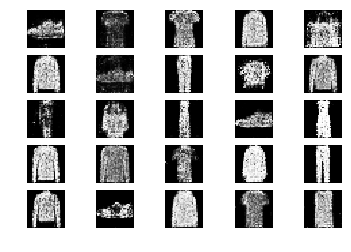

31501 [Discriminator loss: 0.604879, acc.: 65.62%] [Generator loss: 0.962996]
31502 [Discriminator loss: 0.658835, acc.: 57.81%] [Generator loss: 0.946108]
31503 [Discriminator loss: 0.658102, acc.: 51.56%] [Generator loss: 1.046874]
31504 [Discriminator loss: 0.628551, acc.: 62.50%] [Generator loss: 0.989545]
31505 [Discriminator loss: 0.650601, acc.: 53.12%] [Generator loss: 1.073861]
31506 [Discriminator loss: 0.639768, acc.: 64.06%] [Generator loss: 1.002093]
31507 [Discriminator loss: 0.709291, acc.: 60.94%] [Generator loss: 1.020844]
31508 [Discriminator loss: 0.616608, acc.: 60.94%] [Generator loss: 0.992578]
31509 [Discriminator loss: 0.688913, acc.: 56.25%] [Generator loss: 1.050713]
31510 [Discriminator loss: 0.566128, acc.: 70.31%] [Generator loss: 1.103281]
31511 [Discriminator loss: 0.608053, acc.: 68.75%] [Generator loss: 0.951581]
31512 [Discriminator loss: 0.593067, acc.: 65.62%] [Generator loss: 1.040548]
31513 [Discriminator loss: 0.604515, acc.: 64.06%] [Generator lo

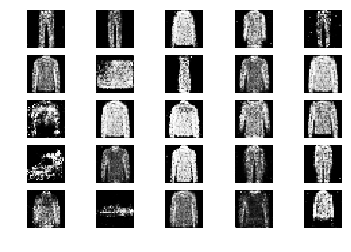

31601 [Discriminator loss: 0.631593, acc.: 60.94%] [Generator loss: 0.947932]
31602 [Discriminator loss: 0.726684, acc.: 51.56%] [Generator loss: 0.993601]
31603 [Discriminator loss: 0.715927, acc.: 51.56%] [Generator loss: 0.942777]
31604 [Discriminator loss: 0.709938, acc.: 59.38%] [Generator loss: 0.956178]
31605 [Discriminator loss: 0.627654, acc.: 65.62%] [Generator loss: 1.080806]
31606 [Discriminator loss: 0.675543, acc.: 59.38%] [Generator loss: 0.912645]
31607 [Discriminator loss: 0.639531, acc.: 64.06%] [Generator loss: 0.948793]
31608 [Discriminator loss: 0.609261, acc.: 62.50%] [Generator loss: 0.970812]
31609 [Discriminator loss: 0.630371, acc.: 62.50%] [Generator loss: 0.945579]
31610 [Discriminator loss: 0.647697, acc.: 59.38%] [Generator loss: 0.969323]
31611 [Discriminator loss: 0.652744, acc.: 54.69%] [Generator loss: 0.964013]
31612 [Discriminator loss: 0.628477, acc.: 65.62%] [Generator loss: 0.916173]
31613 [Discriminator loss: 0.616289, acc.: 65.62%] [Generator lo

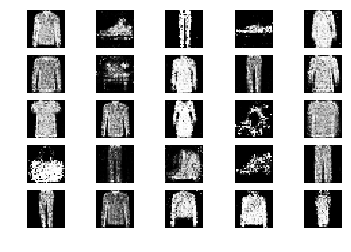

31701 [Discriminator loss: 0.615463, acc.: 68.75%] [Generator loss: 0.957484]
31702 [Discriminator loss: 0.547767, acc.: 76.56%] [Generator loss: 0.994755]
31703 [Discriminator loss: 0.604939, acc.: 62.50%] [Generator loss: 0.985686]
31704 [Discriminator loss: 0.623402, acc.: 60.94%] [Generator loss: 0.989486]
31705 [Discriminator loss: 0.617784, acc.: 60.94%] [Generator loss: 0.908618]
31706 [Discriminator loss: 0.604795, acc.: 70.31%] [Generator loss: 0.957655]
31707 [Discriminator loss: 0.634789, acc.: 67.19%] [Generator loss: 0.948975]
31708 [Discriminator loss: 0.574863, acc.: 67.19%] [Generator loss: 1.058078]
31709 [Discriminator loss: 0.624761, acc.: 62.50%] [Generator loss: 1.037652]
31710 [Discriminator loss: 0.598252, acc.: 65.62%] [Generator loss: 0.950314]
31711 [Discriminator loss: 0.567437, acc.: 68.75%] [Generator loss: 1.051743]
31712 [Discriminator loss: 0.652164, acc.: 62.50%] [Generator loss: 1.027815]
31713 [Discriminator loss: 0.691720, acc.: 53.12%] [Generator lo

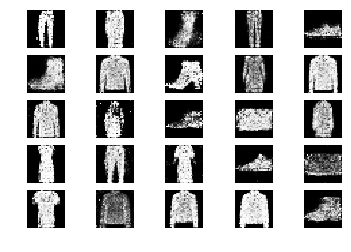

31801 [Discriminator loss: 0.680058, acc.: 54.69%] [Generator loss: 1.036475]
31802 [Discriminator loss: 0.618924, acc.: 59.38%] [Generator loss: 1.056018]
31803 [Discriminator loss: 0.629298, acc.: 59.38%] [Generator loss: 0.937142]
31804 [Discriminator loss: 0.631274, acc.: 57.81%] [Generator loss: 0.981331]
31805 [Discriminator loss: 0.623009, acc.: 67.19%] [Generator loss: 0.914042]
31806 [Discriminator loss: 0.635738, acc.: 57.81%] [Generator loss: 0.973352]
31807 [Discriminator loss: 0.597382, acc.: 65.62%] [Generator loss: 0.985313]
31808 [Discriminator loss: 0.693820, acc.: 57.81%] [Generator loss: 0.935912]
31809 [Discriminator loss: 0.705552, acc.: 51.56%] [Generator loss: 0.923390]
31810 [Discriminator loss: 0.647275, acc.: 62.50%] [Generator loss: 1.026245]
31811 [Discriminator loss: 0.643381, acc.: 62.50%] [Generator loss: 0.928807]
31812 [Discriminator loss: 0.613025, acc.: 67.19%] [Generator loss: 0.946033]
31813 [Discriminator loss: 0.646318, acc.: 64.06%] [Generator lo

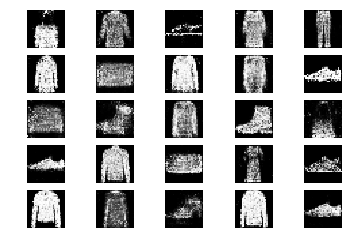

31901 [Discriminator loss: 0.718227, acc.: 51.56%] [Generator loss: 0.981383]
31902 [Discriminator loss: 0.652286, acc.: 60.94%] [Generator loss: 1.083289]
31903 [Discriminator loss: 0.626358, acc.: 64.06%] [Generator loss: 0.897063]
31904 [Discriminator loss: 0.571688, acc.: 67.19%] [Generator loss: 1.067485]
31905 [Discriminator loss: 0.613183, acc.: 67.19%] [Generator loss: 0.938137]
31906 [Discriminator loss: 0.678524, acc.: 59.38%] [Generator loss: 1.066497]
31907 [Discriminator loss: 0.597993, acc.: 65.62%] [Generator loss: 0.996376]
31908 [Discriminator loss: 0.685839, acc.: 57.81%] [Generator loss: 1.109171]
31909 [Discriminator loss: 0.580705, acc.: 67.19%] [Generator loss: 0.984546]
31910 [Discriminator loss: 0.733244, acc.: 46.88%] [Generator loss: 0.944001]
31911 [Discriminator loss: 0.587221, acc.: 70.31%] [Generator loss: 1.088886]
31912 [Discriminator loss: 0.599245, acc.: 68.75%] [Generator loss: 0.937735]
31913 [Discriminator loss: 0.612332, acc.: 68.75%] [Generator lo

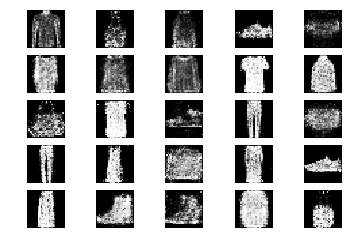

32001 [Discriminator loss: 0.599733, acc.: 70.31%] [Generator loss: 1.079608]
32002 [Discriminator loss: 0.635139, acc.: 60.94%] [Generator loss: 0.933507]
32003 [Discriminator loss: 0.707711, acc.: 62.50%] [Generator loss: 0.870506]
32004 [Discriminator loss: 0.660023, acc.: 60.94%] [Generator loss: 0.865308]
32005 [Discriminator loss: 0.606712, acc.: 68.75%] [Generator loss: 0.871699]
32006 [Discriminator loss: 0.569844, acc.: 73.44%] [Generator loss: 1.037516]
32007 [Discriminator loss: 0.690609, acc.: 53.12%] [Generator loss: 0.946923]
32008 [Discriminator loss: 0.580610, acc.: 75.00%] [Generator loss: 0.945831]
32009 [Discriminator loss: 0.684622, acc.: 56.25%] [Generator loss: 0.859877]
32010 [Discriminator loss: 0.675531, acc.: 50.00%] [Generator loss: 0.909055]
32011 [Discriminator loss: 0.654431, acc.: 67.19%] [Generator loss: 0.987782]
32012 [Discriminator loss: 0.612642, acc.: 76.56%] [Generator loss: 0.963966]
32013 [Discriminator loss: 0.621225, acc.: 57.81%] [Generator lo

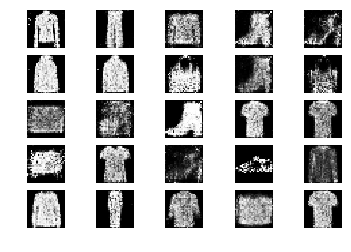

32101 [Discriminator loss: 0.650469, acc.: 59.38%] [Generator loss: 1.026235]
32102 [Discriminator loss: 0.585105, acc.: 71.88%] [Generator loss: 0.846414]
32103 [Discriminator loss: 0.717995, acc.: 60.94%] [Generator loss: 1.031551]
32104 [Discriminator loss: 0.618106, acc.: 67.19%] [Generator loss: 0.893319]
32105 [Discriminator loss: 0.655734, acc.: 60.94%] [Generator loss: 1.131737]
32106 [Discriminator loss: 0.613621, acc.: 64.06%] [Generator loss: 0.930775]
32107 [Discriminator loss: 0.624417, acc.: 75.00%] [Generator loss: 0.980067]
32108 [Discriminator loss: 0.624454, acc.: 68.75%] [Generator loss: 1.054634]
32109 [Discriminator loss: 0.646829, acc.: 56.25%] [Generator loss: 1.037017]
32110 [Discriminator loss: 0.598183, acc.: 73.44%] [Generator loss: 0.901838]
32111 [Discriminator loss: 0.613294, acc.: 65.62%] [Generator loss: 1.042370]
32112 [Discriminator loss: 0.647414, acc.: 68.75%] [Generator loss: 0.963703]
32113 [Discriminator loss: 0.679032, acc.: 57.81%] [Generator lo

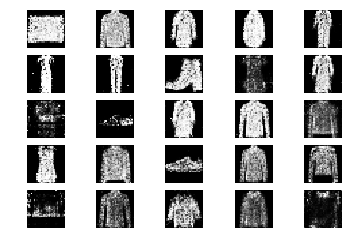

32201 [Discriminator loss: 0.702085, acc.: 59.38%] [Generator loss: 1.065152]
32202 [Discriminator loss: 0.633492, acc.: 60.94%] [Generator loss: 1.002486]
32203 [Discriminator loss: 0.613645, acc.: 67.19%] [Generator loss: 1.073139]
32204 [Discriminator loss: 0.623436, acc.: 62.50%] [Generator loss: 0.949969]
32205 [Discriminator loss: 0.630431, acc.: 65.62%] [Generator loss: 0.955668]
32206 [Discriminator loss: 0.701284, acc.: 60.94%] [Generator loss: 1.045296]
32207 [Discriminator loss: 0.646631, acc.: 64.06%] [Generator loss: 0.860267]
32208 [Discriminator loss: 0.589718, acc.: 68.75%] [Generator loss: 0.996190]
32209 [Discriminator loss: 0.632788, acc.: 57.81%] [Generator loss: 0.971886]
32210 [Discriminator loss: 0.623459, acc.: 70.31%] [Generator loss: 0.973145]
32211 [Discriminator loss: 0.658603, acc.: 65.62%] [Generator loss: 0.998879]
32212 [Discriminator loss: 0.640079, acc.: 65.62%] [Generator loss: 1.037171]
32213 [Discriminator loss: 0.565090, acc.: 67.19%] [Generator lo

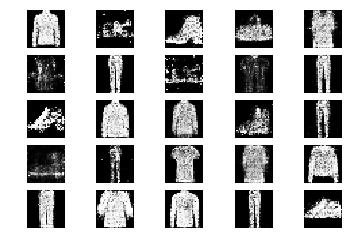

32301 [Discriminator loss: 0.632337, acc.: 67.19%] [Generator loss: 1.096933]
32302 [Discriminator loss: 0.588322, acc.: 71.88%] [Generator loss: 0.833727]
32303 [Discriminator loss: 0.592411, acc.: 64.06%] [Generator loss: 0.951529]
32304 [Discriminator loss: 0.767579, acc.: 46.88%] [Generator loss: 0.959483]
32305 [Discriminator loss: 0.682041, acc.: 59.38%] [Generator loss: 0.942381]
32306 [Discriminator loss: 0.569460, acc.: 68.75%] [Generator loss: 0.971133]
32307 [Discriminator loss: 0.574955, acc.: 68.75%] [Generator loss: 0.947522]
32308 [Discriminator loss: 0.646397, acc.: 53.12%] [Generator loss: 0.841593]
32309 [Discriminator loss: 0.647876, acc.: 57.81%] [Generator loss: 0.959246]
32310 [Discriminator loss: 0.625134, acc.: 65.62%] [Generator loss: 0.859546]
32311 [Discriminator loss: 0.655845, acc.: 62.50%] [Generator loss: 0.919005]
32312 [Discriminator loss: 0.653450, acc.: 57.81%] [Generator loss: 0.881902]
32313 [Discriminator loss: 0.625703, acc.: 57.81%] [Generator lo

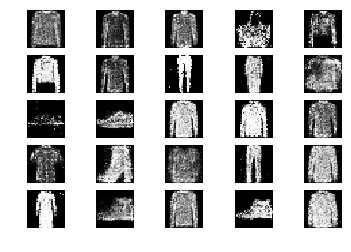

32401 [Discriminator loss: 0.608769, acc.: 70.31%] [Generator loss: 0.991116]
32402 [Discriminator loss: 0.650079, acc.: 59.38%] [Generator loss: 1.074441]
32403 [Discriminator loss: 0.643530, acc.: 56.25%] [Generator loss: 1.068218]
32404 [Discriminator loss: 0.721596, acc.: 54.69%] [Generator loss: 1.091649]
32405 [Discriminator loss: 0.669254, acc.: 59.38%] [Generator loss: 1.011938]
32406 [Discriminator loss: 0.662665, acc.: 59.38%] [Generator loss: 0.988157]
32407 [Discriminator loss: 0.681675, acc.: 54.69%] [Generator loss: 1.057342]
32408 [Discriminator loss: 0.597772, acc.: 71.88%] [Generator loss: 1.052806]
32409 [Discriminator loss: 0.592900, acc.: 68.75%] [Generator loss: 0.965377]
32410 [Discriminator loss: 0.621057, acc.: 65.62%] [Generator loss: 0.857804]
32411 [Discriminator loss: 0.666818, acc.: 65.62%] [Generator loss: 0.983248]
32412 [Discriminator loss: 0.742930, acc.: 51.56%] [Generator loss: 1.039739]
32413 [Discriminator loss: 0.612365, acc.: 67.19%] [Generator lo

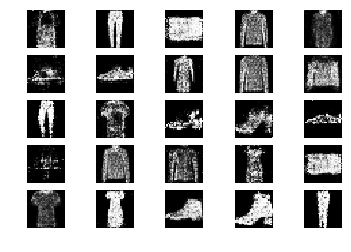

32501 [Discriminator loss: 0.648010, acc.: 62.50%] [Generator loss: 0.884687]
32502 [Discriminator loss: 0.589804, acc.: 70.31%] [Generator loss: 1.006114]
32503 [Discriminator loss: 0.648937, acc.: 59.38%] [Generator loss: 0.978127]
32504 [Discriminator loss: 0.591444, acc.: 70.31%] [Generator loss: 0.925513]
32505 [Discriminator loss: 0.605648, acc.: 65.62%] [Generator loss: 0.842797]
32506 [Discriminator loss: 0.627208, acc.: 62.50%] [Generator loss: 0.873159]
32507 [Discriminator loss: 0.620100, acc.: 71.88%] [Generator loss: 0.928352]
32508 [Discriminator loss: 0.694818, acc.: 57.81%] [Generator loss: 1.053019]
32509 [Discriminator loss: 0.607961, acc.: 71.88%] [Generator loss: 0.971025]
32510 [Discriminator loss: 0.644858, acc.: 65.62%] [Generator loss: 0.923926]
32511 [Discriminator loss: 0.657029, acc.: 54.69%] [Generator loss: 0.951314]
32512 [Discriminator loss: 0.580694, acc.: 71.88%] [Generator loss: 0.968353]
32513 [Discriminator loss: 0.684877, acc.: 56.25%] [Generator lo

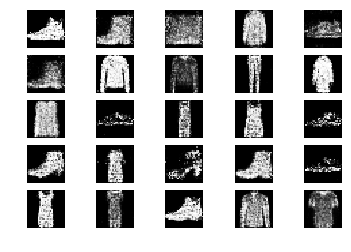

32601 [Discriminator loss: 0.602631, acc.: 68.75%] [Generator loss: 1.001525]
32602 [Discriminator loss: 0.569239, acc.: 73.44%] [Generator loss: 1.020200]
32603 [Discriminator loss: 0.650280, acc.: 59.38%] [Generator loss: 1.010906]
32604 [Discriminator loss: 0.612255, acc.: 70.31%] [Generator loss: 1.060395]
32605 [Discriminator loss: 0.621245, acc.: 62.50%] [Generator loss: 0.905616]
32606 [Discriminator loss: 0.673182, acc.: 64.06%] [Generator loss: 0.986418]
32607 [Discriminator loss: 0.683621, acc.: 51.56%] [Generator loss: 0.981753]
32608 [Discriminator loss: 0.594420, acc.: 65.62%] [Generator loss: 1.037900]
32609 [Discriminator loss: 0.646660, acc.: 64.06%] [Generator loss: 1.030885]
32610 [Discriminator loss: 0.674510, acc.: 65.62%] [Generator loss: 0.890751]
32611 [Discriminator loss: 0.660263, acc.: 62.50%] [Generator loss: 1.048107]
32612 [Discriminator loss: 0.636519, acc.: 64.06%] [Generator loss: 1.009505]
32613 [Discriminator loss: 0.672016, acc.: 60.94%] [Generator lo

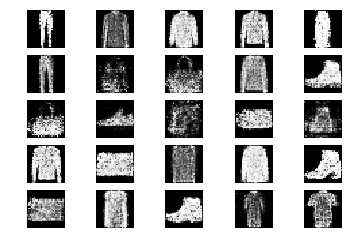

32701 [Discriminator loss: 0.599962, acc.: 67.19%] [Generator loss: 0.963428]
32702 [Discriminator loss: 0.668181, acc.: 62.50%] [Generator loss: 1.001710]
32703 [Discriminator loss: 0.624192, acc.: 64.06%] [Generator loss: 1.029273]
32704 [Discriminator loss: 0.646051, acc.: 65.62%] [Generator loss: 1.004859]
32705 [Discriminator loss: 0.682190, acc.: 62.50%] [Generator loss: 1.074500]
32706 [Discriminator loss: 0.590268, acc.: 70.31%] [Generator loss: 1.029153]
32707 [Discriminator loss: 0.712048, acc.: 60.94%] [Generator loss: 1.087536]
32708 [Discriminator loss: 0.668195, acc.: 56.25%] [Generator loss: 0.938648]
32709 [Discriminator loss: 0.630863, acc.: 70.31%] [Generator loss: 0.881884]
32710 [Discriminator loss: 0.692414, acc.: 54.69%] [Generator loss: 1.047081]
32711 [Discriminator loss: 0.630759, acc.: 68.75%] [Generator loss: 0.976565]
32712 [Discriminator loss: 0.674797, acc.: 64.06%] [Generator loss: 1.028189]
32713 [Discriminator loss: 0.652958, acc.: 64.06%] [Generator lo

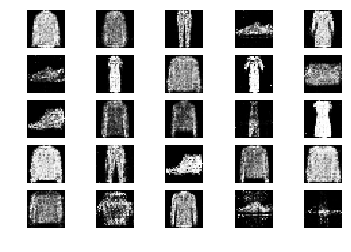

32801 [Discriminator loss: 0.671398, acc.: 54.69%] [Generator loss: 0.813524]
32802 [Discriminator loss: 0.619938, acc.: 62.50%] [Generator loss: 1.031166]
32803 [Discriminator loss: 0.663073, acc.: 62.50%] [Generator loss: 1.030225]
32804 [Discriminator loss: 0.645061, acc.: 62.50%] [Generator loss: 0.969078]
32805 [Discriminator loss: 0.602939, acc.: 70.31%] [Generator loss: 0.904226]
32806 [Discriminator loss: 0.639927, acc.: 64.06%] [Generator loss: 0.969196]
32807 [Discriminator loss: 0.596400, acc.: 68.75%] [Generator loss: 1.031531]
32808 [Discriminator loss: 0.716933, acc.: 51.56%] [Generator loss: 1.070942]
32809 [Discriminator loss: 0.645291, acc.: 59.38%] [Generator loss: 0.976630]
32810 [Discriminator loss: 0.611280, acc.: 67.19%] [Generator loss: 0.958887]
32811 [Discriminator loss: 0.561708, acc.: 67.19%] [Generator loss: 0.980102]
32812 [Discriminator loss: 0.543525, acc.: 73.44%] [Generator loss: 0.932833]
32813 [Discriminator loss: 0.615940, acc.: 60.94%] [Generator lo

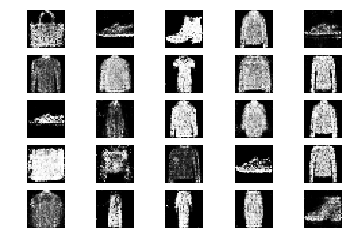

32901 [Discriminator loss: 0.625927, acc.: 57.81%] [Generator loss: 0.885591]
32902 [Discriminator loss: 0.672095, acc.: 51.56%] [Generator loss: 0.952541]
32903 [Discriminator loss: 0.603550, acc.: 70.31%] [Generator loss: 0.903639]
32904 [Discriminator loss: 0.615404, acc.: 64.06%] [Generator loss: 0.909580]
32905 [Discriminator loss: 0.631727, acc.: 62.50%] [Generator loss: 0.994687]
32906 [Discriminator loss: 0.649991, acc.: 56.25%] [Generator loss: 1.041661]
32907 [Discriminator loss: 0.647089, acc.: 64.06%] [Generator loss: 0.904485]
32908 [Discriminator loss: 0.637864, acc.: 62.50%] [Generator loss: 1.025206]
32909 [Discriminator loss: 0.713954, acc.: 51.56%] [Generator loss: 0.946387]
32910 [Discriminator loss: 0.626552, acc.: 67.19%] [Generator loss: 0.978023]
32911 [Discriminator loss: 0.642584, acc.: 67.19%] [Generator loss: 1.014946]
32912 [Discriminator loss: 0.702672, acc.: 51.56%] [Generator loss: 0.911864]
32913 [Discriminator loss: 0.621765, acc.: 71.88%] [Generator lo

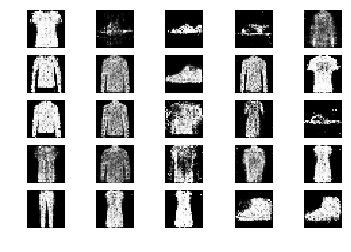

33001 [Discriminator loss: 0.760292, acc.: 59.38%] [Generator loss: 1.124684]
33002 [Discriminator loss: 0.630325, acc.: 65.62%] [Generator loss: 0.994661]
33003 [Discriminator loss: 0.598539, acc.: 68.75%] [Generator loss: 1.047102]
33004 [Discriminator loss: 0.616361, acc.: 71.88%] [Generator loss: 1.003114]
33005 [Discriminator loss: 0.601415, acc.: 70.31%] [Generator loss: 0.968804]
33006 [Discriminator loss: 0.667456, acc.: 57.81%] [Generator loss: 1.005771]
33007 [Discriminator loss: 0.685889, acc.: 56.25%] [Generator loss: 0.987351]
33008 [Discriminator loss: 0.634729, acc.: 60.94%] [Generator loss: 1.029592]
33009 [Discriminator loss: 0.665579, acc.: 62.50%] [Generator loss: 0.823712]
33010 [Discriminator loss: 0.647573, acc.: 62.50%] [Generator loss: 0.994086]
33011 [Discriminator loss: 0.578294, acc.: 65.62%] [Generator loss: 0.957630]
33012 [Discriminator loss: 0.613541, acc.: 59.38%] [Generator loss: 1.046384]
33013 [Discriminator loss: 0.572458, acc.: 68.75%] [Generator lo

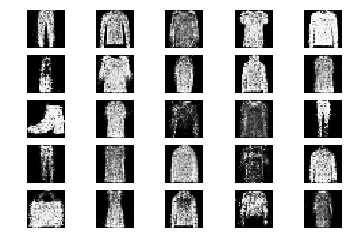

33101 [Discriminator loss: 0.716834, acc.: 51.56%] [Generator loss: 0.928954]
33102 [Discriminator loss: 0.653083, acc.: 54.69%] [Generator loss: 0.896998]
33103 [Discriminator loss: 0.656768, acc.: 62.50%] [Generator loss: 0.964525]
33104 [Discriminator loss: 0.564478, acc.: 82.81%] [Generator loss: 0.906732]
33105 [Discriminator loss: 0.643921, acc.: 65.62%] [Generator loss: 0.947894]
33106 [Discriminator loss: 0.745207, acc.: 59.38%] [Generator loss: 0.955100]
33107 [Discriminator loss: 0.651796, acc.: 62.50%] [Generator loss: 0.987444]
33108 [Discriminator loss: 0.677141, acc.: 56.25%] [Generator loss: 0.997746]
33109 [Discriminator loss: 0.636989, acc.: 59.38%] [Generator loss: 1.052943]
33110 [Discriminator loss: 0.592213, acc.: 67.19%] [Generator loss: 0.970907]
33111 [Discriminator loss: 0.662160, acc.: 62.50%] [Generator loss: 1.067223]
33112 [Discriminator loss: 0.553410, acc.: 76.56%] [Generator loss: 0.958639]
33113 [Discriminator loss: 0.677810, acc.: 62.50%] [Generator lo

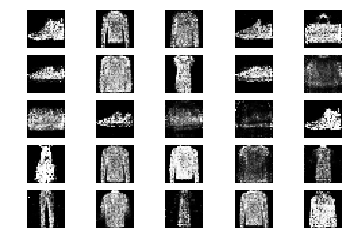

33201 [Discriminator loss: 0.625904, acc.: 59.38%] [Generator loss: 0.934754]
33202 [Discriminator loss: 0.602765, acc.: 67.19%] [Generator loss: 0.984748]
33203 [Discriminator loss: 0.621426, acc.: 65.62%] [Generator loss: 0.948844]
33204 [Discriminator loss: 0.664954, acc.: 62.50%] [Generator loss: 1.121904]
33205 [Discriminator loss: 0.552958, acc.: 78.12%] [Generator loss: 1.081297]
33206 [Discriminator loss: 0.638986, acc.: 60.94%] [Generator loss: 1.095513]
33207 [Discriminator loss: 0.578137, acc.: 70.31%] [Generator loss: 0.982087]
33208 [Discriminator loss: 0.589754, acc.: 73.44%] [Generator loss: 1.049374]
33209 [Discriminator loss: 0.694539, acc.: 54.69%] [Generator loss: 0.966749]
33210 [Discriminator loss: 0.661059, acc.: 54.69%] [Generator loss: 0.923902]
33211 [Discriminator loss: 0.575736, acc.: 71.88%] [Generator loss: 1.052277]
33212 [Discriminator loss: 0.597735, acc.: 70.31%] [Generator loss: 1.013765]
33213 [Discriminator loss: 0.605209, acc.: 68.75%] [Generator lo

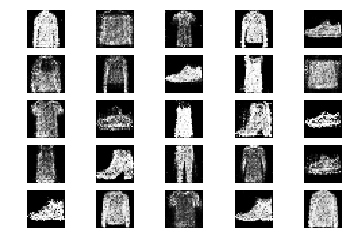

33301 [Discriminator loss: 0.615597, acc.: 70.31%] [Generator loss: 1.003893]
33302 [Discriminator loss: 0.618160, acc.: 65.62%] [Generator loss: 0.923664]
33303 [Discriminator loss: 0.684280, acc.: 54.69%] [Generator loss: 1.017681]
33304 [Discriminator loss: 0.642375, acc.: 59.38%] [Generator loss: 0.938361]
33305 [Discriminator loss: 0.672371, acc.: 59.38%] [Generator loss: 0.954108]
33306 [Discriminator loss: 0.696231, acc.: 51.56%] [Generator loss: 0.982419]
33307 [Discriminator loss: 0.646747, acc.: 65.62%] [Generator loss: 1.032447]
33308 [Discriminator loss: 0.668410, acc.: 62.50%] [Generator loss: 1.037139]
33309 [Discriminator loss: 0.654866, acc.: 59.38%] [Generator loss: 1.007222]
33310 [Discriminator loss: 0.659611, acc.: 57.81%] [Generator loss: 0.925411]
33311 [Discriminator loss: 0.551526, acc.: 76.56%] [Generator loss: 0.960284]
33312 [Discriminator loss: 0.642146, acc.: 59.38%] [Generator loss: 1.013231]
33313 [Discriminator loss: 0.697127, acc.: 54.69%] [Generator lo

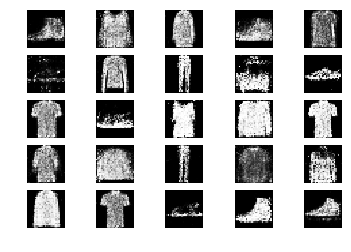

33401 [Discriminator loss: 0.640609, acc.: 60.94%] [Generator loss: 0.921141]
33402 [Discriminator loss: 0.622571, acc.: 64.06%] [Generator loss: 0.994796]
33403 [Discriminator loss: 0.628874, acc.: 64.06%] [Generator loss: 1.032163]
33404 [Discriminator loss: 0.569567, acc.: 73.44%] [Generator loss: 0.969919]
33405 [Discriminator loss: 0.595102, acc.: 64.06%] [Generator loss: 1.046214]
33406 [Discriminator loss: 0.577703, acc.: 60.94%] [Generator loss: 1.016069]
33407 [Discriminator loss: 0.655085, acc.: 59.38%] [Generator loss: 1.070218]
33408 [Discriminator loss: 0.576665, acc.: 68.75%] [Generator loss: 0.922770]
33409 [Discriminator loss: 0.652034, acc.: 60.94%] [Generator loss: 1.135393]
33410 [Discriminator loss: 0.770435, acc.: 50.00%] [Generator loss: 0.907095]
33411 [Discriminator loss: 0.632937, acc.: 62.50%] [Generator loss: 1.023714]
33412 [Discriminator loss: 0.590879, acc.: 71.88%] [Generator loss: 1.147666]
33413 [Discriminator loss: 0.637574, acc.: 59.38%] [Generator lo

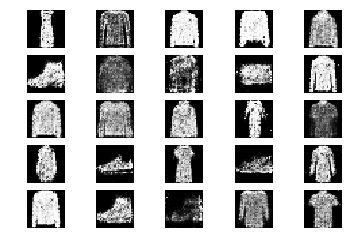

33501 [Discriminator loss: 0.640075, acc.: 64.06%] [Generator loss: 1.103569]
33502 [Discriminator loss: 0.612475, acc.: 62.50%] [Generator loss: 0.974002]
33503 [Discriminator loss: 0.603193, acc.: 62.50%] [Generator loss: 1.049237]
33504 [Discriminator loss: 0.619855, acc.: 62.50%] [Generator loss: 1.058696]
33505 [Discriminator loss: 0.622341, acc.: 65.62%] [Generator loss: 1.045754]
33506 [Discriminator loss: 0.639484, acc.: 62.50%] [Generator loss: 1.039951]
33507 [Discriminator loss: 0.642693, acc.: 65.62%] [Generator loss: 1.142803]
33508 [Discriminator loss: 0.676142, acc.: 53.12%] [Generator loss: 1.010184]
33509 [Discriminator loss: 0.740447, acc.: 46.88%] [Generator loss: 1.154181]
33510 [Discriminator loss: 0.672973, acc.: 59.38%] [Generator loss: 1.028652]
33511 [Discriminator loss: 0.636765, acc.: 60.94%] [Generator loss: 0.962132]
33512 [Discriminator loss: 0.612108, acc.: 64.06%] [Generator loss: 0.955461]
33513 [Discriminator loss: 0.596632, acc.: 65.62%] [Generator lo

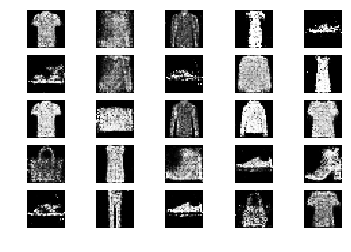

33601 [Discriminator loss: 0.610879, acc.: 60.94%] [Generator loss: 0.899079]
33602 [Discriminator loss: 0.664215, acc.: 51.56%] [Generator loss: 0.955389]
33603 [Discriminator loss: 0.639561, acc.: 59.38%] [Generator loss: 1.047953]
33604 [Discriminator loss: 0.639594, acc.: 59.38%] [Generator loss: 0.970857]
33605 [Discriminator loss: 0.667752, acc.: 57.81%] [Generator loss: 0.970534]
33606 [Discriminator loss: 0.651229, acc.: 60.94%] [Generator loss: 0.949341]
33607 [Discriminator loss: 0.629178, acc.: 64.06%] [Generator loss: 0.968590]
33608 [Discriminator loss: 0.636551, acc.: 62.50%] [Generator loss: 0.997175]
33609 [Discriminator loss: 0.641989, acc.: 70.31%] [Generator loss: 0.915182]
33610 [Discriminator loss: 0.668613, acc.: 56.25%] [Generator loss: 0.993124]
33611 [Discriminator loss: 0.574575, acc.: 75.00%] [Generator loss: 1.014004]
33612 [Discriminator loss: 0.607615, acc.: 68.75%] [Generator loss: 1.028530]
33613 [Discriminator loss: 0.608706, acc.: 67.19%] [Generator lo

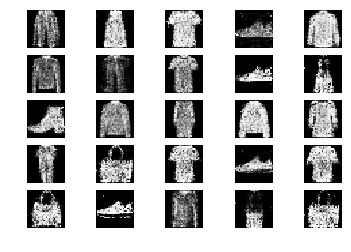

33701 [Discriminator loss: 0.689519, acc.: 57.81%] [Generator loss: 0.921478]
33702 [Discriminator loss: 0.610512, acc.: 71.88%] [Generator loss: 0.931763]
33703 [Discriminator loss: 0.701516, acc.: 56.25%] [Generator loss: 1.003402]
33704 [Discriminator loss: 0.723529, acc.: 48.44%] [Generator loss: 0.899242]
33705 [Discriminator loss: 0.645670, acc.: 65.62%] [Generator loss: 0.995381]
33706 [Discriminator loss: 0.707249, acc.: 57.81%] [Generator loss: 0.951124]
33707 [Discriminator loss: 0.640795, acc.: 62.50%] [Generator loss: 0.910614]
33708 [Discriminator loss: 0.622177, acc.: 64.06%] [Generator loss: 0.927162]
33709 [Discriminator loss: 0.657053, acc.: 62.50%] [Generator loss: 1.022852]
33710 [Discriminator loss: 0.622931, acc.: 67.19%] [Generator loss: 0.918185]
33711 [Discriminator loss: 0.586138, acc.: 70.31%] [Generator loss: 0.956035]
33712 [Discriminator loss: 0.639080, acc.: 65.62%] [Generator loss: 1.198802]
33713 [Discriminator loss: 0.550871, acc.: 73.44%] [Generator lo

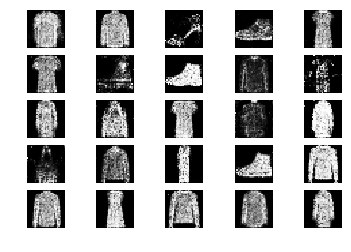

33801 [Discriminator loss: 0.620591, acc.: 68.75%] [Generator loss: 0.944594]
33802 [Discriminator loss: 0.564962, acc.: 73.44%] [Generator loss: 1.077303]
33803 [Discriminator loss: 0.613368, acc.: 67.19%] [Generator loss: 0.963862]
33804 [Discriminator loss: 0.632641, acc.: 60.94%] [Generator loss: 0.970752]
33805 [Discriminator loss: 0.595348, acc.: 68.75%] [Generator loss: 0.871355]
33806 [Discriminator loss: 0.608439, acc.: 65.62%] [Generator loss: 0.935432]
33807 [Discriminator loss: 0.625352, acc.: 62.50%] [Generator loss: 0.839283]
33808 [Discriminator loss: 0.616024, acc.: 68.75%] [Generator loss: 0.923917]
33809 [Discriminator loss: 0.648378, acc.: 60.94%] [Generator loss: 1.009447]
33810 [Discriminator loss: 0.605234, acc.: 71.88%] [Generator loss: 1.002536]
33811 [Discriminator loss: 0.659545, acc.: 59.38%] [Generator loss: 1.059332]
33812 [Discriminator loss: 0.677750, acc.: 50.00%] [Generator loss: 1.000268]
33813 [Discriminator loss: 0.741572, acc.: 50.00%] [Generator lo

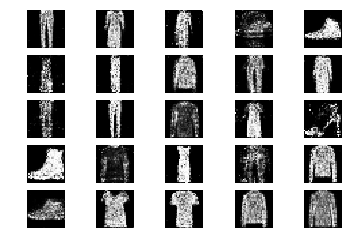

33901 [Discriminator loss: 0.622377, acc.: 62.50%] [Generator loss: 0.933660]
33902 [Discriminator loss: 0.634862, acc.: 62.50%] [Generator loss: 0.979300]
33903 [Discriminator loss: 0.661982, acc.: 60.94%] [Generator loss: 0.893057]
33904 [Discriminator loss: 0.652168, acc.: 62.50%] [Generator loss: 0.919556]
33905 [Discriminator loss: 0.623895, acc.: 67.19%] [Generator loss: 0.940309]
33906 [Discriminator loss: 0.628976, acc.: 64.06%] [Generator loss: 1.016848]
33907 [Discriminator loss: 0.622683, acc.: 64.06%] [Generator loss: 0.917367]
33908 [Discriminator loss: 0.656051, acc.: 60.94%] [Generator loss: 0.987215]
33909 [Discriminator loss: 0.555460, acc.: 76.56%] [Generator loss: 1.140167]
33910 [Discriminator loss: 0.706398, acc.: 59.38%] [Generator loss: 1.007190]
33911 [Discriminator loss: 0.698100, acc.: 48.44%] [Generator loss: 0.961381]
33912 [Discriminator loss: 0.681123, acc.: 60.94%] [Generator loss: 0.991062]
33913 [Discriminator loss: 0.651779, acc.: 54.69%] [Generator lo

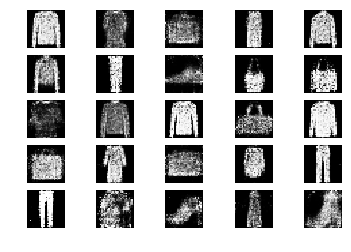

34001 [Discriminator loss: 0.671768, acc.: 64.06%] [Generator loss: 1.045075]
34002 [Discriminator loss: 0.674100, acc.: 59.38%] [Generator loss: 0.977190]
34003 [Discriminator loss: 0.640615, acc.: 57.81%] [Generator loss: 0.993724]
34004 [Discriminator loss: 0.601815, acc.: 65.62%] [Generator loss: 1.144174]
34005 [Discriminator loss: 0.616466, acc.: 65.62%] [Generator loss: 0.988752]
34006 [Discriminator loss: 0.588526, acc.: 64.06%] [Generator loss: 1.026998]
34007 [Discriminator loss: 0.634035, acc.: 62.50%] [Generator loss: 0.996683]
34008 [Discriminator loss: 0.579632, acc.: 68.75%] [Generator loss: 0.912283]
34009 [Discriminator loss: 0.571007, acc.: 71.88%] [Generator loss: 1.040259]
34010 [Discriminator loss: 0.627177, acc.: 60.94%] [Generator loss: 0.964737]
34011 [Discriminator loss: 0.652444, acc.: 68.75%] [Generator loss: 1.055150]
34012 [Discriminator loss: 0.614051, acc.: 65.62%] [Generator loss: 1.043552]
34013 [Discriminator loss: 0.730134, acc.: 57.81%] [Generator lo

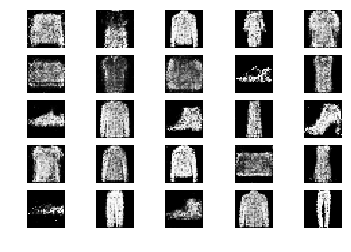

34101 [Discriminator loss: 0.591112, acc.: 65.62%] [Generator loss: 1.081189]
34102 [Discriminator loss: 0.633140, acc.: 62.50%] [Generator loss: 1.060603]
34103 [Discriminator loss: 0.647384, acc.: 64.06%] [Generator loss: 0.987379]
34104 [Discriminator loss: 0.659167, acc.: 64.06%] [Generator loss: 0.961624]
34105 [Discriminator loss: 0.638509, acc.: 60.94%] [Generator loss: 0.972465]
34106 [Discriminator loss: 0.618312, acc.: 64.06%] [Generator loss: 0.964092]
34107 [Discriminator loss: 0.638541, acc.: 56.25%] [Generator loss: 0.982451]
34108 [Discriminator loss: 0.604631, acc.: 70.31%] [Generator loss: 0.969009]
34109 [Discriminator loss: 0.544206, acc.: 73.44%] [Generator loss: 1.027213]
34110 [Discriminator loss: 0.576184, acc.: 70.31%] [Generator loss: 0.932886]
34111 [Discriminator loss: 0.681670, acc.: 62.50%] [Generator loss: 0.887893]
34112 [Discriminator loss: 0.624948, acc.: 59.38%] [Generator loss: 0.958486]
34113 [Discriminator loss: 0.669401, acc.: 59.38%] [Generator lo

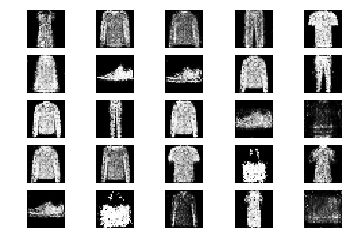

34201 [Discriminator loss: 0.653340, acc.: 60.94%] [Generator loss: 0.964388]
34202 [Discriminator loss: 0.596670, acc.: 68.75%] [Generator loss: 0.910154]
34203 [Discriminator loss: 0.632726, acc.: 65.62%] [Generator loss: 0.999107]
34204 [Discriminator loss: 0.641309, acc.: 60.94%] [Generator loss: 1.031543]
34205 [Discriminator loss: 0.709562, acc.: 56.25%] [Generator loss: 0.949753]
34206 [Discriminator loss: 0.666355, acc.: 59.38%] [Generator loss: 1.043858]
34207 [Discriminator loss: 0.609201, acc.: 68.75%] [Generator loss: 1.036151]
34208 [Discriminator loss: 0.600747, acc.: 73.44%] [Generator loss: 1.022301]
34209 [Discriminator loss: 0.619437, acc.: 71.88%] [Generator loss: 1.043381]
34210 [Discriminator loss: 0.637007, acc.: 68.75%] [Generator loss: 0.996044]
34211 [Discriminator loss: 0.675792, acc.: 64.06%] [Generator loss: 1.055800]
34212 [Discriminator loss: 0.735930, acc.: 53.12%] [Generator loss: 0.910819]
34213 [Discriminator loss: 0.695971, acc.: 53.12%] [Generator lo

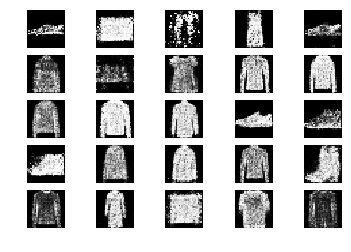

34301 [Discriminator loss: 0.703309, acc.: 57.81%] [Generator loss: 1.003073]
34302 [Discriminator loss: 0.673055, acc.: 54.69%] [Generator loss: 1.002879]
34303 [Discriminator loss: 0.564429, acc.: 71.88%] [Generator loss: 1.115595]
34304 [Discriminator loss: 0.664857, acc.: 60.94%] [Generator loss: 1.056643]
34305 [Discriminator loss: 0.708827, acc.: 54.69%] [Generator loss: 0.999326]
34306 [Discriminator loss: 0.652135, acc.: 64.06%] [Generator loss: 0.901125]
34307 [Discriminator loss: 0.709771, acc.: 51.56%] [Generator loss: 0.928773]
34308 [Discriminator loss: 0.594831, acc.: 64.06%] [Generator loss: 0.893182]
34309 [Discriminator loss: 0.616501, acc.: 59.38%] [Generator loss: 0.911192]
34310 [Discriminator loss: 0.705060, acc.: 59.38%] [Generator loss: 0.998355]
34311 [Discriminator loss: 0.634551, acc.: 65.62%] [Generator loss: 1.002834]
34312 [Discriminator loss: 0.760307, acc.: 48.44%] [Generator loss: 0.870945]
34313 [Discriminator loss: 0.661604, acc.: 60.94%] [Generator lo

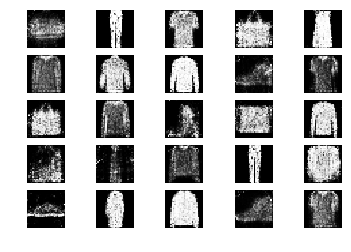

34401 [Discriminator loss: 0.627364, acc.: 64.06%] [Generator loss: 0.971201]
34402 [Discriminator loss: 0.620085, acc.: 64.06%] [Generator loss: 0.997001]
34403 [Discriminator loss: 0.547218, acc.: 73.44%] [Generator loss: 0.984358]
34404 [Discriminator loss: 0.623252, acc.: 60.94%] [Generator loss: 0.933286]
34405 [Discriminator loss: 0.594063, acc.: 67.19%] [Generator loss: 0.963679]
34406 [Discriminator loss: 0.609833, acc.: 59.38%] [Generator loss: 0.942927]
34407 [Discriminator loss: 0.610627, acc.: 73.44%] [Generator loss: 0.996506]
34408 [Discriminator loss: 0.667897, acc.: 65.62%] [Generator loss: 0.944698]
34409 [Discriminator loss: 0.654519, acc.: 64.06%] [Generator loss: 0.930794]
34410 [Discriminator loss: 0.685123, acc.: 59.38%] [Generator loss: 0.927343]
34411 [Discriminator loss: 0.644332, acc.: 62.50%] [Generator loss: 0.955979]
34412 [Discriminator loss: 0.623149, acc.: 71.88%] [Generator loss: 0.945873]
34413 [Discriminator loss: 0.658939, acc.: 59.38%] [Generator lo

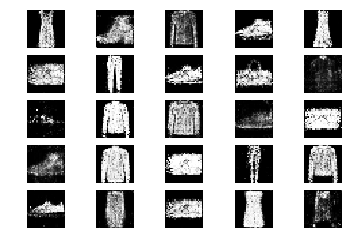

34501 [Discriminator loss: 0.624722, acc.: 56.25%] [Generator loss: 1.005420]
34502 [Discriminator loss: 0.598991, acc.: 68.75%] [Generator loss: 1.064440]
34503 [Discriminator loss: 0.587438, acc.: 71.88%] [Generator loss: 1.019829]
34504 [Discriminator loss: 0.657728, acc.: 65.62%] [Generator loss: 1.034577]
34505 [Discriminator loss: 0.626400, acc.: 60.94%] [Generator loss: 1.074447]
34506 [Discriminator loss: 0.576592, acc.: 78.12%] [Generator loss: 0.948926]
34507 [Discriminator loss: 0.635713, acc.: 64.06%] [Generator loss: 0.949379]
34508 [Discriminator loss: 0.597216, acc.: 70.31%] [Generator loss: 0.943722]
34509 [Discriminator loss: 0.601037, acc.: 70.31%] [Generator loss: 0.929353]
34510 [Discriminator loss: 0.563540, acc.: 70.31%] [Generator loss: 1.077859]
34511 [Discriminator loss: 0.627408, acc.: 68.75%] [Generator loss: 1.077156]
34512 [Discriminator loss: 0.595683, acc.: 68.75%] [Generator loss: 1.075606]
34513 [Discriminator loss: 0.616787, acc.: 67.19%] [Generator lo

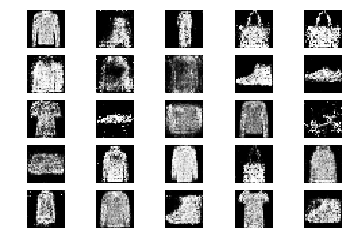

34601 [Discriminator loss: 0.585561, acc.: 75.00%] [Generator loss: 0.952969]
34602 [Discriminator loss: 0.624366, acc.: 65.62%] [Generator loss: 0.960662]
34603 [Discriminator loss: 0.628532, acc.: 59.38%] [Generator loss: 0.953158]
34604 [Discriminator loss: 0.632006, acc.: 62.50%] [Generator loss: 1.034494]
34605 [Discriminator loss: 0.633653, acc.: 67.19%] [Generator loss: 1.060575]
34606 [Discriminator loss: 0.598254, acc.: 57.81%] [Generator loss: 0.997102]
34607 [Discriminator loss: 0.668277, acc.: 59.38%] [Generator loss: 0.964828]
34608 [Discriminator loss: 0.619578, acc.: 65.62%] [Generator loss: 0.946825]
34609 [Discriminator loss: 0.622890, acc.: 60.94%] [Generator loss: 0.997408]
34610 [Discriminator loss: 0.622282, acc.: 62.50%] [Generator loss: 1.002615]
34611 [Discriminator loss: 0.676013, acc.: 53.12%] [Generator loss: 1.043655]
34612 [Discriminator loss: 0.658480, acc.: 59.38%] [Generator loss: 0.960820]
34613 [Discriminator loss: 0.728343, acc.: 54.69%] [Generator lo

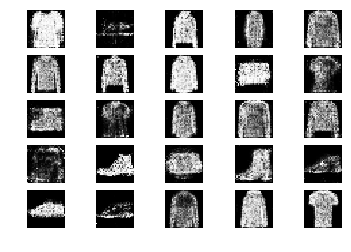

34701 [Discriminator loss: 0.613389, acc.: 65.62%] [Generator loss: 0.994566]
34702 [Discriminator loss: 0.628551, acc.: 70.31%] [Generator loss: 1.027792]
34703 [Discriminator loss: 0.549311, acc.: 75.00%] [Generator loss: 0.895847]
34704 [Discriminator loss: 0.584898, acc.: 62.50%] [Generator loss: 0.979688]
34705 [Discriminator loss: 0.678476, acc.: 60.94%] [Generator loss: 1.026874]
34706 [Discriminator loss: 0.722199, acc.: 53.12%] [Generator loss: 0.950835]
34707 [Discriminator loss: 0.640672, acc.: 64.06%] [Generator loss: 0.926336]
34708 [Discriminator loss: 0.731895, acc.: 48.44%] [Generator loss: 0.890253]
34709 [Discriminator loss: 0.607072, acc.: 64.06%] [Generator loss: 0.952992]
34710 [Discriminator loss: 0.659052, acc.: 53.12%] [Generator loss: 0.885596]
34711 [Discriminator loss: 0.637101, acc.: 70.31%] [Generator loss: 1.015854]
34712 [Discriminator loss: 0.679920, acc.: 54.69%] [Generator loss: 0.968295]
34713 [Discriminator loss: 0.624762, acc.: 60.94%] [Generator lo

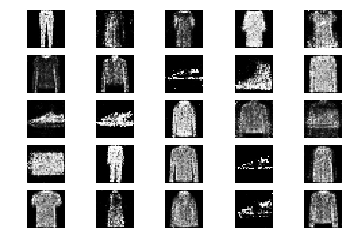

34801 [Discriminator loss: 0.585242, acc.: 70.31%] [Generator loss: 1.084003]
34802 [Discriminator loss: 0.690474, acc.: 60.94%] [Generator loss: 0.984789]
34803 [Discriminator loss: 0.706678, acc.: 57.81%] [Generator loss: 1.050351]
34804 [Discriminator loss: 0.723291, acc.: 50.00%] [Generator loss: 0.989250]
34805 [Discriminator loss: 0.617611, acc.: 70.31%] [Generator loss: 0.956456]
34806 [Discriminator loss: 0.671598, acc.: 62.50%] [Generator loss: 0.968822]
34807 [Discriminator loss: 0.706892, acc.: 53.12%] [Generator loss: 0.929704]
34808 [Discriminator loss: 0.605184, acc.: 68.75%] [Generator loss: 0.812011]
34809 [Discriminator loss: 0.589060, acc.: 73.44%] [Generator loss: 0.939091]
34810 [Discriminator loss: 0.684303, acc.: 62.50%] [Generator loss: 0.914677]
34811 [Discriminator loss: 0.569956, acc.: 76.56%] [Generator loss: 0.876622]
34812 [Discriminator loss: 0.658911, acc.: 65.62%] [Generator loss: 0.884538]
34813 [Discriminator loss: 0.696790, acc.: 62.50%] [Generator lo

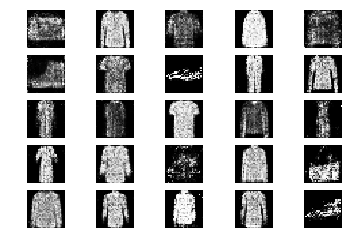

34901 [Discriminator loss: 0.551322, acc.: 73.44%] [Generator loss: 1.021527]
34902 [Discriminator loss: 0.587524, acc.: 68.75%] [Generator loss: 0.932820]
34903 [Discriminator loss: 0.627540, acc.: 64.06%] [Generator loss: 0.932129]
34904 [Discriminator loss: 0.686428, acc.: 59.38%] [Generator loss: 1.049357]
34905 [Discriminator loss: 0.695640, acc.: 56.25%] [Generator loss: 1.113946]
34906 [Discriminator loss: 0.640789, acc.: 67.19%] [Generator loss: 1.115946]
34907 [Discriminator loss: 0.542753, acc.: 71.88%] [Generator loss: 1.036234]
34908 [Discriminator loss: 0.612701, acc.: 67.19%] [Generator loss: 1.054759]
34909 [Discriminator loss: 0.614603, acc.: 62.50%] [Generator loss: 1.036556]
34910 [Discriminator loss: 0.569423, acc.: 70.31%] [Generator loss: 1.078057]
34911 [Discriminator loss: 0.598231, acc.: 64.06%] [Generator loss: 1.070917]
34912 [Discriminator loss: 0.571701, acc.: 65.62%] [Generator loss: 0.933443]
34913 [Discriminator loss: 0.644946, acc.: 64.06%] [Generator lo

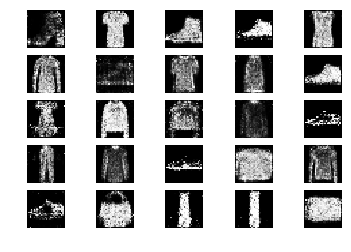

35001 [Discriminator loss: 0.634667, acc.: 67.19%] [Generator loss: 1.102625]
35002 [Discriminator loss: 0.719048, acc.: 60.94%] [Generator loss: 1.042229]
35003 [Discriminator loss: 0.650347, acc.: 67.19%] [Generator loss: 0.992744]
35004 [Discriminator loss: 0.640422, acc.: 57.81%] [Generator loss: 0.865401]
35005 [Discriminator loss: 0.589678, acc.: 68.75%] [Generator loss: 0.954521]
35006 [Discriminator loss: 0.658215, acc.: 65.62%] [Generator loss: 0.995210]
35007 [Discriminator loss: 0.628153, acc.: 67.19%] [Generator loss: 0.907558]
35008 [Discriminator loss: 0.628834, acc.: 59.38%] [Generator loss: 1.036156]
35009 [Discriminator loss: 0.694934, acc.: 54.69%] [Generator loss: 0.980650]
35010 [Discriminator loss: 0.656783, acc.: 67.19%] [Generator loss: 1.045956]
35011 [Discriminator loss: 0.606008, acc.: 60.94%] [Generator loss: 1.128069]
35012 [Discriminator loss: 0.582409, acc.: 73.44%] [Generator loss: 0.955088]
35013 [Discriminator loss: 0.620591, acc.: 67.19%] [Generator lo

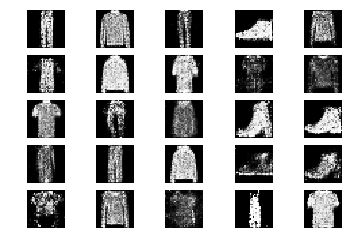

35101 [Discriminator loss: 0.597701, acc.: 62.50%] [Generator loss: 0.946465]
35102 [Discriminator loss: 0.627513, acc.: 65.62%] [Generator loss: 1.049179]
35103 [Discriminator loss: 0.651948, acc.: 62.50%] [Generator loss: 1.035826]
35104 [Discriminator loss: 0.630328, acc.: 57.81%] [Generator loss: 0.990394]
35105 [Discriminator loss: 0.660020, acc.: 64.06%] [Generator loss: 1.064611]
35106 [Discriminator loss: 0.566565, acc.: 71.88%] [Generator loss: 1.046052]
35107 [Discriminator loss: 0.635279, acc.: 64.06%] [Generator loss: 1.043657]
35108 [Discriminator loss: 0.588578, acc.: 67.19%] [Generator loss: 1.077960]
35109 [Discriminator loss: 0.637062, acc.: 65.62%] [Generator loss: 1.077770]
35110 [Discriminator loss: 0.655020, acc.: 59.38%] [Generator loss: 0.924182]
35111 [Discriminator loss: 0.544187, acc.: 70.31%] [Generator loss: 1.017218]
35112 [Discriminator loss: 0.599159, acc.: 60.94%] [Generator loss: 1.034813]
35113 [Discriminator loss: 0.570545, acc.: 73.44%] [Generator lo

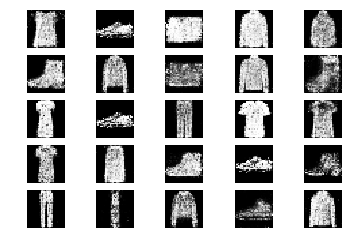

35201 [Discriminator loss: 0.616948, acc.: 67.19%] [Generator loss: 1.108991]
35202 [Discriminator loss: 0.628651, acc.: 65.62%] [Generator loss: 0.999024]
35203 [Discriminator loss: 0.630112, acc.: 64.06%] [Generator loss: 0.930534]
35204 [Discriminator loss: 0.657946, acc.: 60.94%] [Generator loss: 1.031320]
35205 [Discriminator loss: 0.614481, acc.: 60.94%] [Generator loss: 1.021717]
35206 [Discriminator loss: 0.598694, acc.: 68.75%] [Generator loss: 1.005370]
35207 [Discriminator loss: 0.699846, acc.: 56.25%] [Generator loss: 0.941986]
35208 [Discriminator loss: 0.639184, acc.: 67.19%] [Generator loss: 0.928362]
35209 [Discriminator loss: 0.669343, acc.: 54.69%] [Generator loss: 1.094911]
35210 [Discriminator loss: 0.649622, acc.: 62.50%] [Generator loss: 1.037525]
35211 [Discriminator loss: 0.639656, acc.: 67.19%] [Generator loss: 1.015854]
35212 [Discriminator loss: 0.574905, acc.: 73.44%] [Generator loss: 1.016894]
35213 [Discriminator loss: 0.572261, acc.: 62.50%] [Generator lo

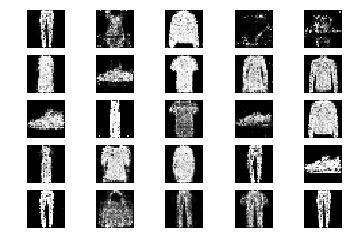

35301 [Discriminator loss: 0.649559, acc.: 56.25%] [Generator loss: 1.062222]
35302 [Discriminator loss: 0.643495, acc.: 60.94%] [Generator loss: 1.002137]
35303 [Discriminator loss: 0.590563, acc.: 71.88%] [Generator loss: 1.062587]
35304 [Discriminator loss: 0.574825, acc.: 65.62%] [Generator loss: 1.046126]
35305 [Discriminator loss: 0.649859, acc.: 57.81%] [Generator loss: 0.952224]
35306 [Discriminator loss: 0.673621, acc.: 59.38%] [Generator loss: 1.068367]
35307 [Discriminator loss: 0.624359, acc.: 59.38%] [Generator loss: 1.001394]
35308 [Discriminator loss: 0.611107, acc.: 68.75%] [Generator loss: 0.905926]
35309 [Discriminator loss: 0.621950, acc.: 62.50%] [Generator loss: 1.071552]
35310 [Discriminator loss: 0.640130, acc.: 60.94%] [Generator loss: 1.028398]
35311 [Discriminator loss: 0.688400, acc.: 59.38%] [Generator loss: 1.049747]
35312 [Discriminator loss: 0.595741, acc.: 73.44%] [Generator loss: 1.034803]
35313 [Discriminator loss: 0.642095, acc.: 57.81%] [Generator lo

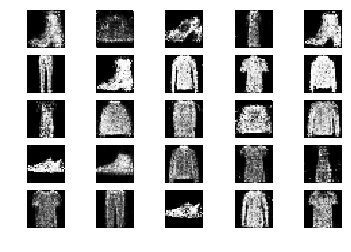

35401 [Discriminator loss: 0.569121, acc.: 73.44%] [Generator loss: 0.957705]
35402 [Discriminator loss: 0.594732, acc.: 67.19%] [Generator loss: 1.099193]
35403 [Discriminator loss: 0.665926, acc.: 62.50%] [Generator loss: 1.067561]
35404 [Discriminator loss: 0.696112, acc.: 57.81%] [Generator loss: 1.035920]
35405 [Discriminator loss: 0.655590, acc.: 65.62%] [Generator loss: 1.024258]
35406 [Discriminator loss: 0.602997, acc.: 73.44%] [Generator loss: 0.944078]
35407 [Discriminator loss: 0.695364, acc.: 51.56%] [Generator loss: 1.067069]
35408 [Discriminator loss: 0.667834, acc.: 60.94%] [Generator loss: 1.049798]
35409 [Discriminator loss: 0.619875, acc.: 57.81%] [Generator loss: 0.960457]
35410 [Discriminator loss: 0.627422, acc.: 62.50%] [Generator loss: 1.014366]
35411 [Discriminator loss: 0.592409, acc.: 71.88%] [Generator loss: 0.990860]
35412 [Discriminator loss: 0.693707, acc.: 53.12%] [Generator loss: 1.052019]
35413 [Discriminator loss: 0.637107, acc.: 60.94%] [Generator lo

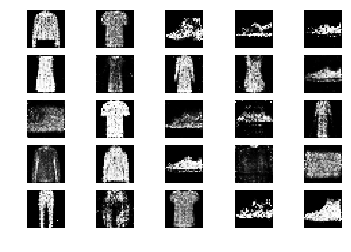

35501 [Discriminator loss: 0.648912, acc.: 54.69%] [Generator loss: 0.911681]
35502 [Discriminator loss: 0.607599, acc.: 64.06%] [Generator loss: 0.906980]
35503 [Discriminator loss: 0.657809, acc.: 56.25%] [Generator loss: 0.925925]
35504 [Discriminator loss: 0.628783, acc.: 67.19%] [Generator loss: 0.935248]
35505 [Discriminator loss: 0.615217, acc.: 64.06%] [Generator loss: 1.012269]
35506 [Discriminator loss: 0.702399, acc.: 53.12%] [Generator loss: 0.955345]
35507 [Discriminator loss: 0.608023, acc.: 68.75%] [Generator loss: 1.082654]
35508 [Discriminator loss: 0.671352, acc.: 62.50%] [Generator loss: 1.073369]
35509 [Discriminator loss: 0.715335, acc.: 56.25%] [Generator loss: 0.915038]
35510 [Discriminator loss: 0.617612, acc.: 64.06%] [Generator loss: 0.907519]
35511 [Discriminator loss: 0.613260, acc.: 62.50%] [Generator loss: 0.915065]
35512 [Discriminator loss: 0.661566, acc.: 62.50%] [Generator loss: 0.930836]
35513 [Discriminator loss: 0.623519, acc.: 60.94%] [Generator lo

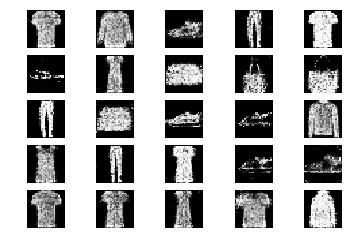

35601 [Discriminator loss: 0.654557, acc.: 59.38%] [Generator loss: 0.762521]
35602 [Discriminator loss: 0.604922, acc.: 70.31%] [Generator loss: 0.941700]
35603 [Discriminator loss: 0.626073, acc.: 68.75%] [Generator loss: 0.934618]
35604 [Discriminator loss: 0.639187, acc.: 64.06%] [Generator loss: 0.904454]
35605 [Discriminator loss: 0.628310, acc.: 59.38%] [Generator loss: 0.993494]
35606 [Discriminator loss: 0.680416, acc.: 56.25%] [Generator loss: 1.032842]
35607 [Discriminator loss: 0.751220, acc.: 53.12%] [Generator loss: 0.941618]
35608 [Discriminator loss: 0.599154, acc.: 68.75%] [Generator loss: 0.913134]
35609 [Discriminator loss: 0.582423, acc.: 75.00%] [Generator loss: 0.977855]
35610 [Discriminator loss: 0.625478, acc.: 62.50%] [Generator loss: 0.997543]
35611 [Discriminator loss: 0.631910, acc.: 67.19%] [Generator loss: 1.026765]
35612 [Discriminator loss: 0.656554, acc.: 56.25%] [Generator loss: 0.968804]
35613 [Discriminator loss: 0.557647, acc.: 71.88%] [Generator lo

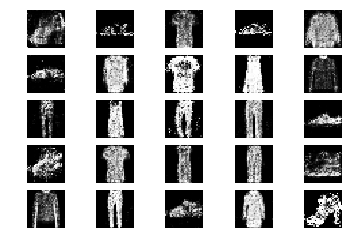

35701 [Discriminator loss: 0.667968, acc.: 57.81%] [Generator loss: 1.018708]
35702 [Discriminator loss: 0.580585, acc.: 67.19%] [Generator loss: 0.971437]
35703 [Discriminator loss: 0.695449, acc.: 51.56%] [Generator loss: 1.000452]
35704 [Discriminator loss: 0.629607, acc.: 59.38%] [Generator loss: 1.065543]
35705 [Discriminator loss: 0.653794, acc.: 59.38%] [Generator loss: 1.004982]
35706 [Discriminator loss: 0.576118, acc.: 68.75%] [Generator loss: 1.039340]
35707 [Discriminator loss: 0.652973, acc.: 60.94%] [Generator loss: 1.150075]
35708 [Discriminator loss: 0.685474, acc.: 56.25%] [Generator loss: 1.171068]
35709 [Discriminator loss: 0.546733, acc.: 73.44%] [Generator loss: 1.196469]
35710 [Discriminator loss: 0.612782, acc.: 64.06%] [Generator loss: 0.973432]
35711 [Discriminator loss: 0.591138, acc.: 68.75%] [Generator loss: 0.951628]
35712 [Discriminator loss: 0.608141, acc.: 68.75%] [Generator loss: 1.010273]
35713 [Discriminator loss: 0.564127, acc.: 75.00%] [Generator lo

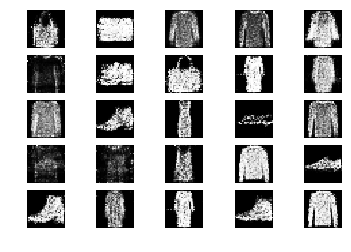

35801 [Discriminator loss: 0.602655, acc.: 65.62%] [Generator loss: 0.985274]
35802 [Discriminator loss: 0.541110, acc.: 75.00%] [Generator loss: 0.908339]
35803 [Discriminator loss: 0.655801, acc.: 62.50%] [Generator loss: 0.894102]
35804 [Discriminator loss: 0.672537, acc.: 56.25%] [Generator loss: 0.999226]
35805 [Discriminator loss: 0.620109, acc.: 68.75%] [Generator loss: 1.077216]
35806 [Discriminator loss: 0.576514, acc.: 68.75%] [Generator loss: 0.987440]
35807 [Discriminator loss: 0.619478, acc.: 60.94%] [Generator loss: 1.056109]
35808 [Discriminator loss: 0.649638, acc.: 57.81%] [Generator loss: 1.056659]
35809 [Discriminator loss: 0.659542, acc.: 57.81%] [Generator loss: 0.986192]
35810 [Discriminator loss: 0.662898, acc.: 62.50%] [Generator loss: 0.921686]
35811 [Discriminator loss: 0.562003, acc.: 73.44%] [Generator loss: 0.932091]
35812 [Discriminator loss: 0.710082, acc.: 56.25%] [Generator loss: 0.999737]
35813 [Discriminator loss: 0.713899, acc.: 51.56%] [Generator lo

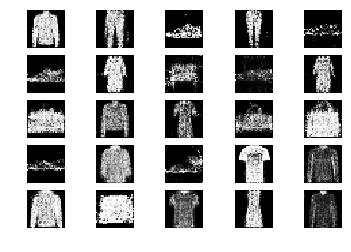

35901 [Discriminator loss: 0.529386, acc.: 76.56%] [Generator loss: 1.045089]
35902 [Discriminator loss: 0.622319, acc.: 65.62%] [Generator loss: 1.098283]
35903 [Discriminator loss: 0.600959, acc.: 68.75%] [Generator loss: 0.973754]
35904 [Discriminator loss: 0.594281, acc.: 67.19%] [Generator loss: 0.977766]
35905 [Discriminator loss: 0.689824, acc.: 64.06%] [Generator loss: 0.951213]
35906 [Discriminator loss: 0.651080, acc.: 68.75%] [Generator loss: 0.926865]
35907 [Discriminator loss: 0.621298, acc.: 65.62%] [Generator loss: 0.938785]
35908 [Discriminator loss: 0.629299, acc.: 67.19%] [Generator loss: 1.043091]
35909 [Discriminator loss: 0.636168, acc.: 65.62%] [Generator loss: 1.015464]
35910 [Discriminator loss: 0.594166, acc.: 70.31%] [Generator loss: 1.057438]
35911 [Discriminator loss: 0.606912, acc.: 68.75%] [Generator loss: 1.150284]
35912 [Discriminator loss: 0.638233, acc.: 62.50%] [Generator loss: 1.010212]
35913 [Discriminator loss: 0.656610, acc.: 62.50%] [Generator lo

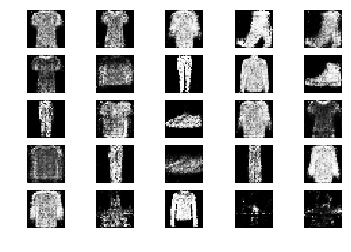

36001 [Discriminator loss: 0.662940, acc.: 60.94%] [Generator loss: 1.059090]
36002 [Discriminator loss: 0.650905, acc.: 67.19%] [Generator loss: 0.983975]
36003 [Discriminator loss: 0.622096, acc.: 67.19%] [Generator loss: 0.998457]
36004 [Discriminator loss: 0.501480, acc.: 73.44%] [Generator loss: 0.997731]
36005 [Discriminator loss: 0.652444, acc.: 65.62%] [Generator loss: 1.013761]
36006 [Discriminator loss: 0.646331, acc.: 64.06%] [Generator loss: 0.955807]
36007 [Discriminator loss: 0.721200, acc.: 53.12%] [Generator loss: 1.041919]
36008 [Discriminator loss: 0.705968, acc.: 59.38%] [Generator loss: 0.991700]
36009 [Discriminator loss: 0.652233, acc.: 64.06%] [Generator loss: 1.011534]
36010 [Discriminator loss: 0.603926, acc.: 67.19%] [Generator loss: 1.003499]
36011 [Discriminator loss: 0.598099, acc.: 71.88%] [Generator loss: 1.079652]
36012 [Discriminator loss: 0.671971, acc.: 59.38%] [Generator loss: 1.025192]
36013 [Discriminator loss: 0.607216, acc.: 65.62%] [Generator lo

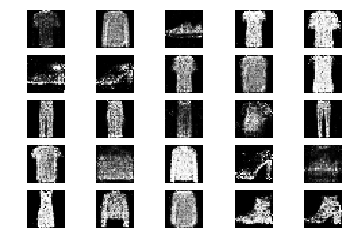

36101 [Discriminator loss: 0.650605, acc.: 65.62%] [Generator loss: 0.818912]
36102 [Discriminator loss: 0.748181, acc.: 45.31%] [Generator loss: 1.018857]
36103 [Discriminator loss: 0.664352, acc.: 51.56%] [Generator loss: 0.922617]
36104 [Discriminator loss: 0.587602, acc.: 65.62%] [Generator loss: 1.012785]
36105 [Discriminator loss: 0.593269, acc.: 71.88%] [Generator loss: 0.969458]
36106 [Discriminator loss: 0.646539, acc.: 59.38%] [Generator loss: 0.878283]
36107 [Discriminator loss: 0.612446, acc.: 67.19%] [Generator loss: 1.069137]
36108 [Discriminator loss: 0.625791, acc.: 70.31%] [Generator loss: 0.975500]
36109 [Discriminator loss: 0.648790, acc.: 70.31%] [Generator loss: 1.022761]
36110 [Discriminator loss: 0.637835, acc.: 62.50%] [Generator loss: 0.945542]
36111 [Discriminator loss: 0.658626, acc.: 54.69%] [Generator loss: 1.123177]
36112 [Discriminator loss: 0.538448, acc.: 73.44%] [Generator loss: 1.216810]
36113 [Discriminator loss: 0.643190, acc.: 65.62%] [Generator lo

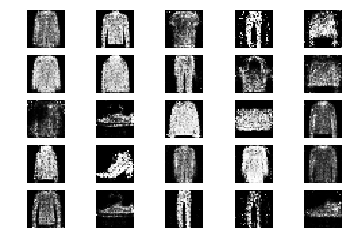

36201 [Discriminator loss: 0.722950, acc.: 56.25%] [Generator loss: 1.026535]
36202 [Discriminator loss: 0.687424, acc.: 56.25%] [Generator loss: 1.162756]
36203 [Discriminator loss: 0.581424, acc.: 67.19%] [Generator loss: 1.117292]
36204 [Discriminator loss: 0.570338, acc.: 67.19%] [Generator loss: 0.891995]
36205 [Discriminator loss: 0.684625, acc.: 64.06%] [Generator loss: 0.944764]
36206 [Discriminator loss: 0.605852, acc.: 67.19%] [Generator loss: 0.854366]
36207 [Discriminator loss: 0.761608, acc.: 45.31%] [Generator loss: 0.965142]
36208 [Discriminator loss: 0.570987, acc.: 73.44%] [Generator loss: 0.958684]
36209 [Discriminator loss: 0.714595, acc.: 57.81%] [Generator loss: 1.060953]
36210 [Discriminator loss: 0.630948, acc.: 65.62%] [Generator loss: 1.114035]
36211 [Discriminator loss: 0.655089, acc.: 59.38%] [Generator loss: 0.947790]
36212 [Discriminator loss: 0.760243, acc.: 54.69%] [Generator loss: 0.985841]
36213 [Discriminator loss: 0.673073, acc.: 65.62%] [Generator lo

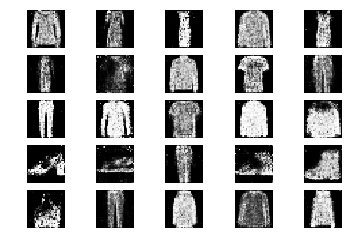

36301 [Discriminator loss: 0.596460, acc.: 73.44%] [Generator loss: 0.901321]
36302 [Discriminator loss: 0.718972, acc.: 53.12%] [Generator loss: 0.928969]
36303 [Discriminator loss: 0.567196, acc.: 75.00%] [Generator loss: 1.064716]
36304 [Discriminator loss: 0.581464, acc.: 73.44%] [Generator loss: 1.029563]
36305 [Discriminator loss: 0.617922, acc.: 60.94%] [Generator loss: 1.037267]
36306 [Discriminator loss: 0.637582, acc.: 54.69%] [Generator loss: 1.010008]
36307 [Discriminator loss: 0.630822, acc.: 67.19%] [Generator loss: 0.965925]
36308 [Discriminator loss: 0.611617, acc.: 68.75%] [Generator loss: 0.948231]
36309 [Discriminator loss: 0.700916, acc.: 54.69%] [Generator loss: 0.958519]
36310 [Discriminator loss: 0.613364, acc.: 70.31%] [Generator loss: 1.048512]
36311 [Discriminator loss: 0.692557, acc.: 57.81%] [Generator loss: 1.113915]
36312 [Discriminator loss: 0.544808, acc.: 73.44%] [Generator loss: 1.090525]
36313 [Discriminator loss: 0.538606, acc.: 79.69%] [Generator lo

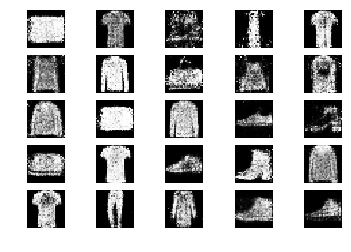

36401 [Discriminator loss: 0.722689, acc.: 54.69%] [Generator loss: 1.016075]
36402 [Discriminator loss: 0.672895, acc.: 59.38%] [Generator loss: 0.967295]
36403 [Discriminator loss: 0.591836, acc.: 67.19%] [Generator loss: 0.989643]
36404 [Discriminator loss: 0.716633, acc.: 50.00%] [Generator loss: 0.898882]
36405 [Discriminator loss: 0.697203, acc.: 54.69%] [Generator loss: 0.945417]
36406 [Discriminator loss: 0.657337, acc.: 60.94%] [Generator loss: 1.097328]
36407 [Discriminator loss: 0.656214, acc.: 53.12%] [Generator loss: 0.926769]
36408 [Discriminator loss: 0.672121, acc.: 64.06%] [Generator loss: 0.997186]
36409 [Discriminator loss: 0.577829, acc.: 70.31%] [Generator loss: 0.997546]
36410 [Discriminator loss: 0.663166, acc.: 59.38%] [Generator loss: 1.003721]
36411 [Discriminator loss: 0.599303, acc.: 71.88%] [Generator loss: 0.887296]
36412 [Discriminator loss: 0.611477, acc.: 65.62%] [Generator loss: 0.884516]
36413 [Discriminator loss: 0.678025, acc.: 59.38%] [Generator lo

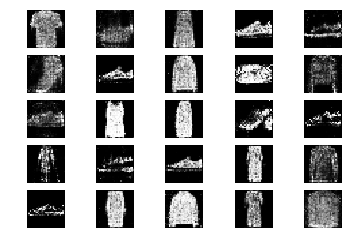

36501 [Discriminator loss: 0.541151, acc.: 71.88%] [Generator loss: 0.943285]
36502 [Discriminator loss: 0.629579, acc.: 67.19%] [Generator loss: 0.979556]
36503 [Discriminator loss: 0.611802, acc.: 70.31%] [Generator loss: 1.081667]
36504 [Discriminator loss: 0.615892, acc.: 75.00%] [Generator loss: 1.002219]
36505 [Discriminator loss: 0.503882, acc.: 79.69%] [Generator loss: 0.931001]
36506 [Discriminator loss: 0.629258, acc.: 68.75%] [Generator loss: 0.836878]
36507 [Discriminator loss: 0.600431, acc.: 67.19%] [Generator loss: 0.968424]
36508 [Discriminator loss: 0.643967, acc.: 60.94%] [Generator loss: 0.979150]
36509 [Discriminator loss: 0.569619, acc.: 71.88%] [Generator loss: 1.035151]
36510 [Discriminator loss: 0.564955, acc.: 67.19%] [Generator loss: 1.047609]
36511 [Discriminator loss: 0.627011, acc.: 67.19%] [Generator loss: 0.987308]
36512 [Discriminator loss: 0.641386, acc.: 57.81%] [Generator loss: 0.955318]
36513 [Discriminator loss: 0.749015, acc.: 57.81%] [Generator lo

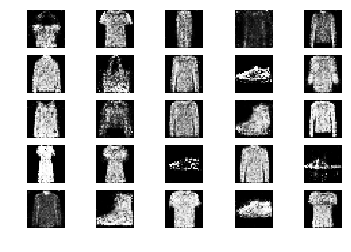

36601 [Discriminator loss: 0.588361, acc.: 73.44%] [Generator loss: 0.937692]
36602 [Discriminator loss: 0.677341, acc.: 57.81%] [Generator loss: 0.968376]
36603 [Discriminator loss: 0.706171, acc.: 50.00%] [Generator loss: 1.066363]
36604 [Discriminator loss: 0.688048, acc.: 56.25%] [Generator loss: 1.056267]
36605 [Discriminator loss: 0.603910, acc.: 67.19%] [Generator loss: 1.034949]
36606 [Discriminator loss: 0.644466, acc.: 64.06%] [Generator loss: 1.042746]
36607 [Discriminator loss: 0.620408, acc.: 64.06%] [Generator loss: 1.009610]
36608 [Discriminator loss: 0.603328, acc.: 73.44%] [Generator loss: 0.867064]
36609 [Discriminator loss: 0.657341, acc.: 59.38%] [Generator loss: 0.850635]
36610 [Discriminator loss: 0.691478, acc.: 56.25%] [Generator loss: 0.909528]
36611 [Discriminator loss: 0.632075, acc.: 67.19%] [Generator loss: 0.853267]
36612 [Discriminator loss: 0.579077, acc.: 67.19%] [Generator loss: 0.954974]
36613 [Discriminator loss: 0.545473, acc.: 73.44%] [Generator lo

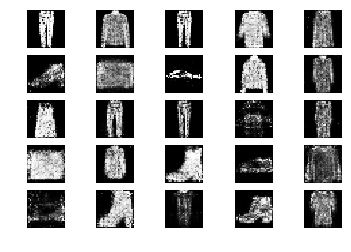

36701 [Discriminator loss: 0.625334, acc.: 62.50%] [Generator loss: 1.131781]
36702 [Discriminator loss: 0.653841, acc.: 60.94%] [Generator loss: 1.056881]
36703 [Discriminator loss: 0.589147, acc.: 68.75%] [Generator loss: 1.145068]
36704 [Discriminator loss: 0.617033, acc.: 68.75%] [Generator loss: 1.099105]
36705 [Discriminator loss: 0.708079, acc.: 54.69%] [Generator loss: 1.001372]
36706 [Discriminator loss: 0.577918, acc.: 65.62%] [Generator loss: 1.039191]
36707 [Discriminator loss: 0.561884, acc.: 64.06%] [Generator loss: 1.103684]
36708 [Discriminator loss: 0.672633, acc.: 57.81%] [Generator loss: 1.046297]
36709 [Discriminator loss: 0.607232, acc.: 68.75%] [Generator loss: 1.044962]
36710 [Discriminator loss: 0.616828, acc.: 65.62%] [Generator loss: 1.064370]
36711 [Discriminator loss: 0.626357, acc.: 65.62%] [Generator loss: 1.067493]
36712 [Discriminator loss: 0.699442, acc.: 56.25%] [Generator loss: 1.000984]
36713 [Discriminator loss: 0.619190, acc.: 67.19%] [Generator lo

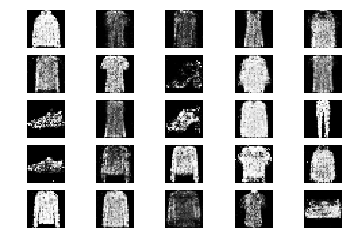

36801 [Discriminator loss: 0.642091, acc.: 62.50%] [Generator loss: 1.100660]
36802 [Discriminator loss: 0.692341, acc.: 67.19%] [Generator loss: 1.016176]
36803 [Discriminator loss: 0.594469, acc.: 68.75%] [Generator loss: 1.085083]
36804 [Discriminator loss: 0.635893, acc.: 65.62%] [Generator loss: 0.982113]
36805 [Discriminator loss: 0.685283, acc.: 59.38%] [Generator loss: 0.956680]
36806 [Discriminator loss: 0.676763, acc.: 50.00%] [Generator loss: 0.958980]
36807 [Discriminator loss: 0.549216, acc.: 71.88%] [Generator loss: 1.126979]
36808 [Discriminator loss: 0.590643, acc.: 68.75%] [Generator loss: 1.009456]
36809 [Discriminator loss: 0.579966, acc.: 73.44%] [Generator loss: 1.056882]
36810 [Discriminator loss: 0.691381, acc.: 57.81%] [Generator loss: 0.933322]
36811 [Discriminator loss: 0.748357, acc.: 56.25%] [Generator loss: 0.896734]
36812 [Discriminator loss: 0.560216, acc.: 76.56%] [Generator loss: 1.076971]
36813 [Discriminator loss: 0.521767, acc.: 78.12%] [Generator lo

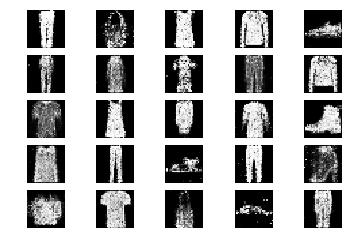

36901 [Discriminator loss: 0.603271, acc.: 65.62%] [Generator loss: 0.902980]
36902 [Discriminator loss: 0.572375, acc.: 70.31%] [Generator loss: 1.079869]
36903 [Discriminator loss: 0.658323, acc.: 57.81%] [Generator loss: 0.869990]
36904 [Discriminator loss: 0.630255, acc.: 59.38%] [Generator loss: 1.050248]
36905 [Discriminator loss: 0.519320, acc.: 81.25%] [Generator loss: 0.865041]
36906 [Discriminator loss: 0.610388, acc.: 65.62%] [Generator loss: 0.968829]
36907 [Discriminator loss: 0.689390, acc.: 57.81%] [Generator loss: 1.044615]
36908 [Discriminator loss: 0.651416, acc.: 60.94%] [Generator loss: 0.986225]
36909 [Discriminator loss: 0.664865, acc.: 56.25%] [Generator loss: 1.048771]
36910 [Discriminator loss: 0.585352, acc.: 70.31%] [Generator loss: 1.041146]
36911 [Discriminator loss: 0.617777, acc.: 67.19%] [Generator loss: 1.060761]
36912 [Discriminator loss: 0.648717, acc.: 56.25%] [Generator loss: 1.076613]
36913 [Discriminator loss: 0.640269, acc.: 62.50%] [Generator lo

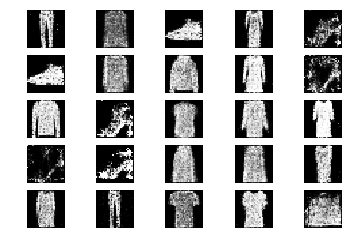

37001 [Discriminator loss: 0.639507, acc.: 59.38%] [Generator loss: 0.998873]
37002 [Discriminator loss: 0.639710, acc.: 62.50%] [Generator loss: 0.917928]
37003 [Discriminator loss: 0.628006, acc.: 56.25%] [Generator loss: 0.966009]
37004 [Discriminator loss: 0.597427, acc.: 68.75%] [Generator loss: 0.931320]
37005 [Discriminator loss: 0.608312, acc.: 65.62%] [Generator loss: 0.887631]
37006 [Discriminator loss: 0.656500, acc.: 60.94%] [Generator loss: 1.057634]
37007 [Discriminator loss: 0.645329, acc.: 60.94%] [Generator loss: 1.010193]
37008 [Discriminator loss: 0.617581, acc.: 65.62%] [Generator loss: 1.079435]
37009 [Discriminator loss: 0.580555, acc.: 67.19%] [Generator loss: 0.998961]
37010 [Discriminator loss: 0.703810, acc.: 54.69%] [Generator loss: 0.997415]
37011 [Discriminator loss: 0.656193, acc.: 60.94%] [Generator loss: 1.056006]
37012 [Discriminator loss: 0.599163, acc.: 68.75%] [Generator loss: 1.049515]
37013 [Discriminator loss: 0.651521, acc.: 59.38%] [Generator lo

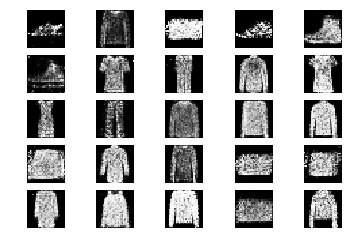

37101 [Discriminator loss: 0.621204, acc.: 62.50%] [Generator loss: 0.944875]
37102 [Discriminator loss: 0.679046, acc.: 60.94%] [Generator loss: 0.937756]
37103 [Discriminator loss: 0.622971, acc.: 64.06%] [Generator loss: 0.942668]
37104 [Discriminator loss: 0.621306, acc.: 68.75%] [Generator loss: 1.017899]
37105 [Discriminator loss: 0.599616, acc.: 68.75%] [Generator loss: 1.057193]
37106 [Discriminator loss: 0.634207, acc.: 67.19%] [Generator loss: 0.884447]
37107 [Discriminator loss: 0.677657, acc.: 57.81%] [Generator loss: 1.003482]
37108 [Discriminator loss: 0.756625, acc.: 51.56%] [Generator loss: 1.075807]
37109 [Discriminator loss: 0.604048, acc.: 68.75%] [Generator loss: 0.951020]
37110 [Discriminator loss: 0.640398, acc.: 62.50%] [Generator loss: 0.992381]
37111 [Discriminator loss: 0.714550, acc.: 53.12%] [Generator loss: 0.989317]
37112 [Discriminator loss: 0.636222, acc.: 56.25%] [Generator loss: 1.017112]
37113 [Discriminator loss: 0.613124, acc.: 70.31%] [Generator lo

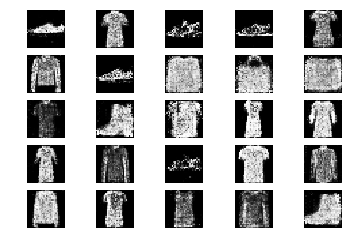

37201 [Discriminator loss: 0.619114, acc.: 68.75%] [Generator loss: 0.914093]
37202 [Discriminator loss: 0.631077, acc.: 62.50%] [Generator loss: 1.015737]
37203 [Discriminator loss: 0.606449, acc.: 62.50%] [Generator loss: 1.004371]
37204 [Discriminator loss: 0.630495, acc.: 67.19%] [Generator loss: 0.953199]
37205 [Discriminator loss: 0.603120, acc.: 71.88%] [Generator loss: 1.012406]
37206 [Discriminator loss: 0.675942, acc.: 56.25%] [Generator loss: 1.134526]
37207 [Discriminator loss: 0.529841, acc.: 75.00%] [Generator loss: 1.087611]
37208 [Discriminator loss: 0.662060, acc.: 64.06%] [Generator loss: 1.056989]
37209 [Discriminator loss: 0.627743, acc.: 56.25%] [Generator loss: 1.066339]
37210 [Discriminator loss: 0.667265, acc.: 67.19%] [Generator loss: 1.076140]
37211 [Discriminator loss: 0.613977, acc.: 60.94%] [Generator loss: 1.069942]
37212 [Discriminator loss: 0.538840, acc.: 73.44%] [Generator loss: 0.953918]
37213 [Discriminator loss: 0.675034, acc.: 57.81%] [Generator lo

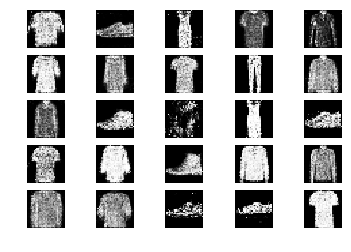

37301 [Discriminator loss: 0.604552, acc.: 71.88%] [Generator loss: 1.038072]
37302 [Discriminator loss: 0.657033, acc.: 64.06%] [Generator loss: 1.052354]
37303 [Discriminator loss: 0.633144, acc.: 60.94%] [Generator loss: 1.045682]
37304 [Discriminator loss: 0.680691, acc.: 60.94%] [Generator loss: 1.068615]
37305 [Discriminator loss: 0.644478, acc.: 67.19%] [Generator loss: 1.054135]
37306 [Discriminator loss: 0.621671, acc.: 60.94%] [Generator loss: 1.066787]
37307 [Discriminator loss: 0.631986, acc.: 59.38%] [Generator loss: 0.982182]
37308 [Discriminator loss: 0.588446, acc.: 71.88%] [Generator loss: 0.937683]
37309 [Discriminator loss: 0.595434, acc.: 64.06%] [Generator loss: 1.059139]
37310 [Discriminator loss: 0.690015, acc.: 57.81%] [Generator loss: 0.998907]
37311 [Discriminator loss: 0.616233, acc.: 65.62%] [Generator loss: 1.010818]
37312 [Discriminator loss: 0.578547, acc.: 67.19%] [Generator loss: 1.015356]
37313 [Discriminator loss: 0.610419, acc.: 67.19%] [Generator lo

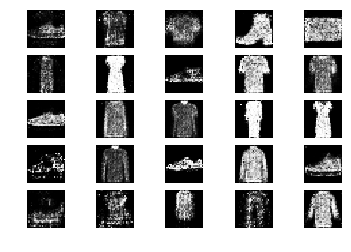

37401 [Discriminator loss: 0.637855, acc.: 57.81%] [Generator loss: 0.978864]
37402 [Discriminator loss: 0.663553, acc.: 60.94%] [Generator loss: 1.040673]
37403 [Discriminator loss: 0.671178, acc.: 56.25%] [Generator loss: 0.981171]
37404 [Discriminator loss: 0.553859, acc.: 73.44%] [Generator loss: 1.058675]
37405 [Discriminator loss: 0.691967, acc.: 59.38%] [Generator loss: 1.006663]
37406 [Discriminator loss: 0.594972, acc.: 71.88%] [Generator loss: 1.080423]
37407 [Discriminator loss: 0.665066, acc.: 62.50%] [Generator loss: 1.069897]
37408 [Discriminator loss: 0.579438, acc.: 73.44%] [Generator loss: 1.148779]
37409 [Discriminator loss: 0.647213, acc.: 53.12%] [Generator loss: 0.917324]
37410 [Discriminator loss: 0.620572, acc.: 70.31%] [Generator loss: 0.892151]
37411 [Discriminator loss: 0.665184, acc.: 53.12%] [Generator loss: 0.919326]
37412 [Discriminator loss: 0.585959, acc.: 68.75%] [Generator loss: 0.924247]
37413 [Discriminator loss: 0.640660, acc.: 70.31%] [Generator lo

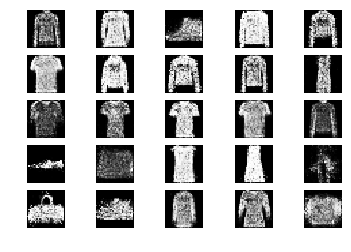

37501 [Discriminator loss: 0.606355, acc.: 64.06%] [Generator loss: 1.023264]
37502 [Discriminator loss: 0.651033, acc.: 65.62%] [Generator loss: 1.059582]
37503 [Discriminator loss: 0.672967, acc.: 56.25%] [Generator loss: 1.039554]
37504 [Discriminator loss: 0.604016, acc.: 62.50%] [Generator loss: 1.012806]
37505 [Discriminator loss: 0.598308, acc.: 65.62%] [Generator loss: 1.085600]
37506 [Discriminator loss: 0.663876, acc.: 53.12%] [Generator loss: 1.039135]
37507 [Discriminator loss: 0.572566, acc.: 67.19%] [Generator loss: 0.953913]
37508 [Discriminator loss: 0.545853, acc.: 73.44%] [Generator loss: 1.095254]
37509 [Discriminator loss: 0.595813, acc.: 62.50%] [Generator loss: 1.058844]
37510 [Discriminator loss: 0.581746, acc.: 62.50%] [Generator loss: 0.909129]
37511 [Discriminator loss: 0.640002, acc.: 59.38%] [Generator loss: 0.944464]
37512 [Discriminator loss: 0.661782, acc.: 64.06%] [Generator loss: 0.912263]
37513 [Discriminator loss: 0.629960, acc.: 67.19%] [Generator lo

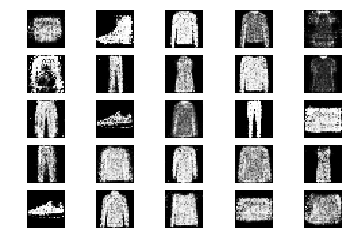

37601 [Discriminator loss: 0.632788, acc.: 70.31%] [Generator loss: 1.012056]
37602 [Discriminator loss: 0.646889, acc.: 57.81%] [Generator loss: 1.051945]
37603 [Discriminator loss: 0.598221, acc.: 68.75%] [Generator loss: 1.003260]
37604 [Discriminator loss: 0.593947, acc.: 70.31%] [Generator loss: 1.007844]
37605 [Discriminator loss: 0.661597, acc.: 59.38%] [Generator loss: 1.024410]
37606 [Discriminator loss: 0.658515, acc.: 54.69%] [Generator loss: 0.981216]
37607 [Discriminator loss: 0.637689, acc.: 67.19%] [Generator loss: 1.080755]
37608 [Discriminator loss: 0.602046, acc.: 68.75%] [Generator loss: 1.089819]
37609 [Discriminator loss: 0.643172, acc.: 64.06%] [Generator loss: 0.953955]
37610 [Discriminator loss: 0.614581, acc.: 68.75%] [Generator loss: 1.026057]
37611 [Discriminator loss: 0.595055, acc.: 65.62%] [Generator loss: 1.017649]
37612 [Discriminator loss: 0.637458, acc.: 64.06%] [Generator loss: 1.026006]
37613 [Discriminator loss: 0.676499, acc.: 60.94%] [Generator lo

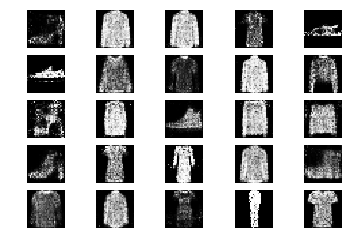

37701 [Discriminator loss: 0.556096, acc.: 68.75%] [Generator loss: 0.952134]
37702 [Discriminator loss: 0.623433, acc.: 65.62%] [Generator loss: 1.019142]
37703 [Discriminator loss: 0.604963, acc.: 65.62%] [Generator loss: 1.170136]
37704 [Discriminator loss: 0.607796, acc.: 65.62%] [Generator loss: 0.994554]
37705 [Discriminator loss: 0.594790, acc.: 62.50%] [Generator loss: 1.021531]
37706 [Discriminator loss: 0.519541, acc.: 73.44%] [Generator loss: 1.115967]
37707 [Discriminator loss: 0.611465, acc.: 57.81%] [Generator loss: 0.898975]
37708 [Discriminator loss: 0.556374, acc.: 79.69%] [Generator loss: 0.906795]
37709 [Discriminator loss: 0.608150, acc.: 62.50%] [Generator loss: 1.023211]
37710 [Discriminator loss: 0.673398, acc.: 59.38%] [Generator loss: 0.990047]
37711 [Discriminator loss: 0.659923, acc.: 62.50%] [Generator loss: 0.994738]
37712 [Discriminator loss: 0.546542, acc.: 79.69%] [Generator loss: 1.051288]
37713 [Discriminator loss: 0.559154, acc.: 70.31%] [Generator lo

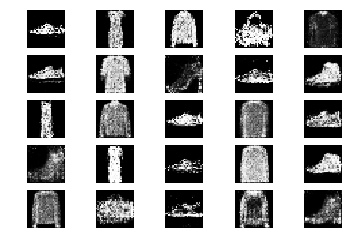

37801 [Discriminator loss: 0.657317, acc.: 65.62%] [Generator loss: 0.964450]
37802 [Discriminator loss: 0.631360, acc.: 57.81%] [Generator loss: 1.140615]
37803 [Discriminator loss: 0.587823, acc.: 68.75%] [Generator loss: 0.971324]
37804 [Discriminator loss: 0.620137, acc.: 67.19%] [Generator loss: 1.117857]
37805 [Discriminator loss: 0.668548, acc.: 54.69%] [Generator loss: 1.079989]
37806 [Discriminator loss: 0.692435, acc.: 54.69%] [Generator loss: 0.987245]
37807 [Discriminator loss: 0.650192, acc.: 62.50%] [Generator loss: 0.942511]
37808 [Discriminator loss: 0.636806, acc.: 57.81%] [Generator loss: 1.046455]
37809 [Discriminator loss: 0.717116, acc.: 53.12%] [Generator loss: 1.102927]
37810 [Discriminator loss: 0.582090, acc.: 70.31%] [Generator loss: 1.134036]
37811 [Discriminator loss: 0.699767, acc.: 57.81%] [Generator loss: 1.030068]
37812 [Discriminator loss: 0.647964, acc.: 56.25%] [Generator loss: 1.065725]
37813 [Discriminator loss: 0.627154, acc.: 67.19%] [Generator lo

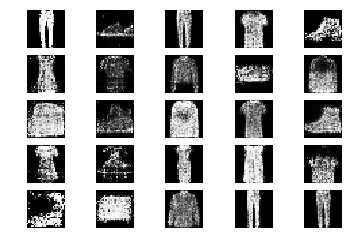

37901 [Discriminator loss: 0.573911, acc.: 70.31%] [Generator loss: 1.006993]
37902 [Discriminator loss: 0.628256, acc.: 67.19%] [Generator loss: 0.928841]
37903 [Discriminator loss: 0.619097, acc.: 65.62%] [Generator loss: 0.919011]
37904 [Discriminator loss: 0.572332, acc.: 71.88%] [Generator loss: 0.990264]
37905 [Discriminator loss: 0.604279, acc.: 73.44%] [Generator loss: 1.178130]
37906 [Discriminator loss: 0.643022, acc.: 60.94%] [Generator loss: 0.936854]
37907 [Discriminator loss: 0.563383, acc.: 73.44%] [Generator loss: 0.903992]
37908 [Discriminator loss: 0.614428, acc.: 64.06%] [Generator loss: 1.062721]
37909 [Discriminator loss: 0.583420, acc.: 64.06%] [Generator loss: 1.046036]
37910 [Discriminator loss: 0.672917, acc.: 50.00%] [Generator loss: 0.977843]
37911 [Discriminator loss: 0.635971, acc.: 67.19%] [Generator loss: 0.924909]
37912 [Discriminator loss: 0.576574, acc.: 71.88%] [Generator loss: 0.999421]
37913 [Discriminator loss: 0.697075, acc.: 54.69%] [Generator lo

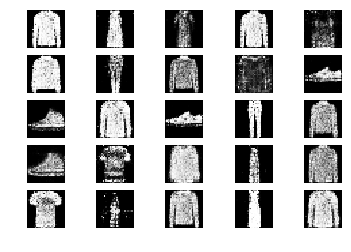

38001 [Discriminator loss: 0.605403, acc.: 65.62%] [Generator loss: 0.996757]
38002 [Discriminator loss: 0.639510, acc.: 57.81%] [Generator loss: 0.900735]
38003 [Discriminator loss: 0.637044, acc.: 64.06%] [Generator loss: 1.033728]
38004 [Discriminator loss: 0.546234, acc.: 70.31%] [Generator loss: 1.077412]
38005 [Discriminator loss: 0.595624, acc.: 67.19%] [Generator loss: 0.980355]
38006 [Discriminator loss: 0.586575, acc.: 65.62%] [Generator loss: 0.880681]
38007 [Discriminator loss: 0.603389, acc.: 65.62%] [Generator loss: 0.862840]
38008 [Discriminator loss: 0.653538, acc.: 56.25%] [Generator loss: 1.055549]
38009 [Discriminator loss: 0.617788, acc.: 59.38%] [Generator loss: 1.100520]
38010 [Discriminator loss: 0.738621, acc.: 60.94%] [Generator loss: 0.954360]
38011 [Discriminator loss: 0.663277, acc.: 59.38%] [Generator loss: 1.047144]
38012 [Discriminator loss: 0.619591, acc.: 60.94%] [Generator loss: 1.040841]
38013 [Discriminator loss: 0.614716, acc.: 71.88%] [Generator lo

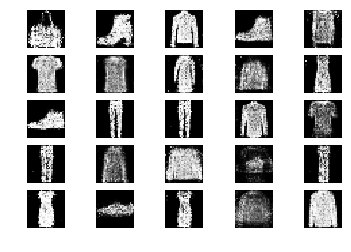

38101 [Discriminator loss: 0.637798, acc.: 67.19%] [Generator loss: 1.034797]
38102 [Discriminator loss: 0.648785, acc.: 62.50%] [Generator loss: 0.898035]
38103 [Discriminator loss: 0.591150, acc.: 70.31%] [Generator loss: 0.973068]
38104 [Discriminator loss: 0.527481, acc.: 76.56%] [Generator loss: 1.000431]
38105 [Discriminator loss: 0.632402, acc.: 62.50%] [Generator loss: 1.037295]
38106 [Discriminator loss: 0.568962, acc.: 73.44%] [Generator loss: 1.008658]
38107 [Discriminator loss: 0.645653, acc.: 65.62%] [Generator loss: 1.091827]
38108 [Discriminator loss: 0.628356, acc.: 68.75%] [Generator loss: 0.957110]
38109 [Discriminator loss: 0.606032, acc.: 64.06%] [Generator loss: 1.068128]
38110 [Discriminator loss: 0.665760, acc.: 59.38%] [Generator loss: 1.025959]
38111 [Discriminator loss: 0.579530, acc.: 71.88%] [Generator loss: 1.018822]
38112 [Discriminator loss: 0.617202, acc.: 70.31%] [Generator loss: 1.000374]
38113 [Discriminator loss: 0.660701, acc.: 60.94%] [Generator lo

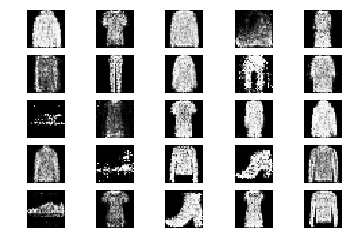

38201 [Discriminator loss: 0.588825, acc.: 75.00%] [Generator loss: 0.916197]
38202 [Discriminator loss: 0.651812, acc.: 57.81%] [Generator loss: 0.903663]
38203 [Discriminator loss: 0.671546, acc.: 62.50%] [Generator loss: 0.983546]
38204 [Discriminator loss: 0.626556, acc.: 68.75%] [Generator loss: 0.973221]
38205 [Discriminator loss: 0.658146, acc.: 64.06%] [Generator loss: 1.144860]
38206 [Discriminator loss: 0.672948, acc.: 56.25%] [Generator loss: 0.976507]
38207 [Discriminator loss: 0.601619, acc.: 68.75%] [Generator loss: 0.909847]
38208 [Discriminator loss: 0.607747, acc.: 64.06%] [Generator loss: 1.039849]
38209 [Discriminator loss: 0.682658, acc.: 57.81%] [Generator loss: 0.933923]
38210 [Discriminator loss: 0.638958, acc.: 60.94%] [Generator loss: 0.924132]
38211 [Discriminator loss: 0.699600, acc.: 50.00%] [Generator loss: 0.853282]
38212 [Discriminator loss: 0.615038, acc.: 60.94%] [Generator loss: 0.956112]
38213 [Discriminator loss: 0.598063, acc.: 65.62%] [Generator lo

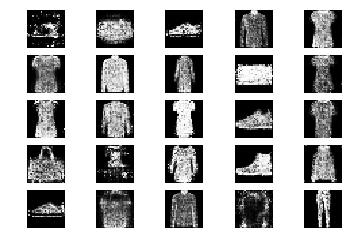

38301 [Discriminator loss: 0.659283, acc.: 65.62%] [Generator loss: 1.004844]
38302 [Discriminator loss: 0.612815, acc.: 65.62%] [Generator loss: 0.957957]
38303 [Discriminator loss: 0.577482, acc.: 71.88%] [Generator loss: 0.861677]
38304 [Discriminator loss: 0.637511, acc.: 64.06%] [Generator loss: 0.914494]
38305 [Discriminator loss: 0.595870, acc.: 70.31%] [Generator loss: 0.953167]
38306 [Discriminator loss: 0.549160, acc.: 70.31%] [Generator loss: 0.908085]
38307 [Discriminator loss: 0.689267, acc.: 59.38%] [Generator loss: 1.073459]
38308 [Discriminator loss: 0.598508, acc.: 65.62%] [Generator loss: 1.025963]
38309 [Discriminator loss: 0.721195, acc.: 53.12%] [Generator loss: 0.985385]
38310 [Discriminator loss: 0.619836, acc.: 65.62%] [Generator loss: 1.061979]
38311 [Discriminator loss: 0.625061, acc.: 65.62%] [Generator loss: 0.995296]
38312 [Discriminator loss: 0.618972, acc.: 57.81%] [Generator loss: 0.989085]
38313 [Discriminator loss: 0.651629, acc.: 54.69%] [Generator lo

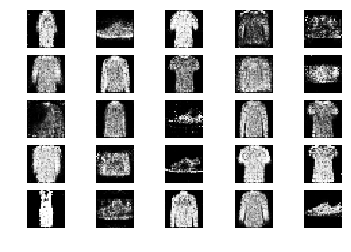

38401 [Discriminator loss: 0.643162, acc.: 67.19%] [Generator loss: 1.022852]
38402 [Discriminator loss: 0.597831, acc.: 70.31%] [Generator loss: 1.025467]
38403 [Discriminator loss: 0.669002, acc.: 57.81%] [Generator loss: 1.080726]
38404 [Discriminator loss: 0.632278, acc.: 64.06%] [Generator loss: 1.060756]
38405 [Discriminator loss: 0.592487, acc.: 73.44%] [Generator loss: 0.977965]
38406 [Discriminator loss: 0.605612, acc.: 68.75%] [Generator loss: 1.024911]
38407 [Discriminator loss: 0.676362, acc.: 62.50%] [Generator loss: 0.950443]
38408 [Discriminator loss: 0.621690, acc.: 70.31%] [Generator loss: 1.057265]
38409 [Discriminator loss: 0.551922, acc.: 71.88%] [Generator loss: 1.051037]
38410 [Discriminator loss: 0.632774, acc.: 65.62%] [Generator loss: 1.012564]
38411 [Discriminator loss: 0.578856, acc.: 70.31%] [Generator loss: 0.879083]
38412 [Discriminator loss: 0.639672, acc.: 62.50%] [Generator loss: 1.114881]
38413 [Discriminator loss: 0.645464, acc.: 62.50%] [Generator lo

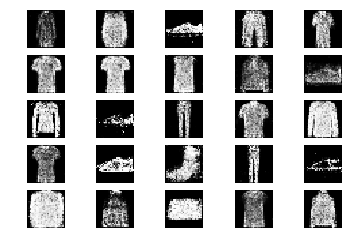

38501 [Discriminator loss: 0.641727, acc.: 64.06%] [Generator loss: 0.968325]
38502 [Discriminator loss: 0.694766, acc.: 64.06%] [Generator loss: 1.053355]
38503 [Discriminator loss: 0.648911, acc.: 65.62%] [Generator loss: 1.039872]
38504 [Discriminator loss: 0.681704, acc.: 59.38%] [Generator loss: 1.030019]
38505 [Discriminator loss: 0.650959, acc.: 57.81%] [Generator loss: 1.121704]
38506 [Discriminator loss: 0.669713, acc.: 53.12%] [Generator loss: 1.007178]
38507 [Discriminator loss: 0.689603, acc.: 56.25%] [Generator loss: 0.892602]
38508 [Discriminator loss: 0.595866, acc.: 64.06%] [Generator loss: 1.084470]
38509 [Discriminator loss: 0.575389, acc.: 73.44%] [Generator loss: 0.841787]
38510 [Discriminator loss: 0.659159, acc.: 57.81%] [Generator loss: 1.133197]
38511 [Discriminator loss: 0.618685, acc.: 64.06%] [Generator loss: 1.179946]
38512 [Discriminator loss: 0.599635, acc.: 70.31%] [Generator loss: 1.109383]
38513 [Discriminator loss: 0.595217, acc.: 67.19%] [Generator lo

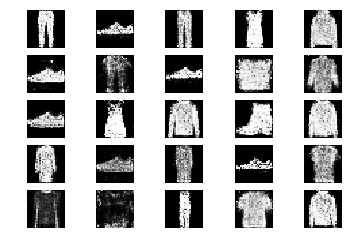

38601 [Discriminator loss: 0.606372, acc.: 65.62%] [Generator loss: 0.997772]
38602 [Discriminator loss: 0.625774, acc.: 65.62%] [Generator loss: 1.047710]
38603 [Discriminator loss: 0.591339, acc.: 71.88%] [Generator loss: 0.992335]
38604 [Discriminator loss: 0.609197, acc.: 67.19%] [Generator loss: 0.980296]
38605 [Discriminator loss: 0.667425, acc.: 56.25%] [Generator loss: 1.097130]
38606 [Discriminator loss: 0.662970, acc.: 64.06%] [Generator loss: 0.912206]
38607 [Discriminator loss: 0.669268, acc.: 62.50%] [Generator loss: 0.973354]
38608 [Discriminator loss: 0.665160, acc.: 60.94%] [Generator loss: 0.870183]
38609 [Discriminator loss: 0.675179, acc.: 54.69%] [Generator loss: 0.880602]
38610 [Discriminator loss: 0.650963, acc.: 59.38%] [Generator loss: 0.848524]
38611 [Discriminator loss: 0.668825, acc.: 60.94%] [Generator loss: 0.946240]
38612 [Discriminator loss: 0.527251, acc.: 76.56%] [Generator loss: 1.033002]
38613 [Discriminator loss: 0.608232, acc.: 59.38%] [Generator lo

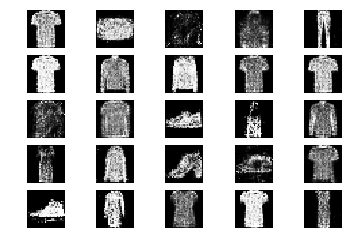

38701 [Discriminator loss: 0.691991, acc.: 53.12%] [Generator loss: 0.951767]
38702 [Discriminator loss: 0.656431, acc.: 62.50%] [Generator loss: 0.983917]
38703 [Discriminator loss: 0.643840, acc.: 68.75%] [Generator loss: 1.082501]
38704 [Discriminator loss: 0.608567, acc.: 65.62%] [Generator loss: 0.950967]
38705 [Discriminator loss: 0.660938, acc.: 65.62%] [Generator loss: 0.846436]
38706 [Discriminator loss: 0.645577, acc.: 64.06%] [Generator loss: 0.937870]
38707 [Discriminator loss: 0.612328, acc.: 62.50%] [Generator loss: 1.010828]
38708 [Discriminator loss: 0.618465, acc.: 64.06%] [Generator loss: 1.052627]
38709 [Discriminator loss: 0.604706, acc.: 71.88%] [Generator loss: 0.974778]
38710 [Discriminator loss: 0.641561, acc.: 64.06%] [Generator loss: 1.045873]
38711 [Discriminator loss: 0.712094, acc.: 53.12%] [Generator loss: 0.975085]
38712 [Discriminator loss: 0.538436, acc.: 73.44%] [Generator loss: 1.044792]
38713 [Discriminator loss: 0.623277, acc.: 60.94%] [Generator lo

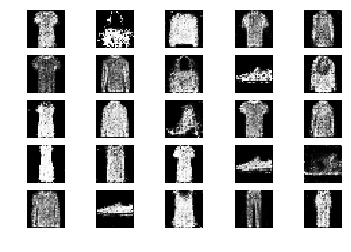

38801 [Discriminator loss: 0.561858, acc.: 73.44%] [Generator loss: 0.857614]
38802 [Discriminator loss: 0.587882, acc.: 70.31%] [Generator loss: 0.950302]
38803 [Discriminator loss: 0.675771, acc.: 57.81%] [Generator loss: 0.942550]
38804 [Discriminator loss: 0.633712, acc.: 59.38%] [Generator loss: 0.846730]
38805 [Discriminator loss: 0.651842, acc.: 60.94%] [Generator loss: 0.946248]
38806 [Discriminator loss: 0.652307, acc.: 54.69%] [Generator loss: 1.031341]
38807 [Discriminator loss: 0.713387, acc.: 56.25%] [Generator loss: 0.964696]
38808 [Discriminator loss: 0.662777, acc.: 60.94%] [Generator loss: 1.103777]
38809 [Discriminator loss: 0.665565, acc.: 62.50%] [Generator loss: 1.037038]
38810 [Discriminator loss: 0.693643, acc.: 57.81%] [Generator loss: 1.014819]
38811 [Discriminator loss: 0.534835, acc.: 73.44%] [Generator loss: 1.010246]
38812 [Discriminator loss: 0.646759, acc.: 64.06%] [Generator loss: 1.037269]
38813 [Discriminator loss: 0.636843, acc.: 64.06%] [Generator lo

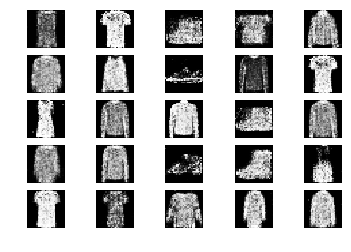

38901 [Discriminator loss: 0.752496, acc.: 50.00%] [Generator loss: 1.009093]
38902 [Discriminator loss: 0.702805, acc.: 59.38%] [Generator loss: 0.983238]
38903 [Discriminator loss: 0.642675, acc.: 57.81%] [Generator loss: 1.057068]
38904 [Discriminator loss: 0.634505, acc.: 64.06%] [Generator loss: 1.061694]
38905 [Discriminator loss: 0.632143, acc.: 68.75%] [Generator loss: 1.031908]
38906 [Discriminator loss: 0.657284, acc.: 60.94%] [Generator loss: 0.880003]
38907 [Discriminator loss: 0.634570, acc.: 57.81%] [Generator loss: 0.965382]
38908 [Discriminator loss: 0.642487, acc.: 53.12%] [Generator loss: 1.104908]
38909 [Discriminator loss: 0.661766, acc.: 62.50%] [Generator loss: 0.887091]
38910 [Discriminator loss: 0.641778, acc.: 67.19%] [Generator loss: 1.083191]
38911 [Discriminator loss: 0.646070, acc.: 64.06%] [Generator loss: 1.009707]
38912 [Discriminator loss: 0.612011, acc.: 65.62%] [Generator loss: 0.966325]
38913 [Discriminator loss: 0.582911, acc.: 68.75%] [Generator lo

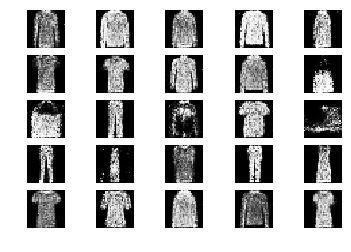

39001 [Discriminator loss: 0.611011, acc.: 62.50%] [Generator loss: 0.968702]
39002 [Discriminator loss: 0.618054, acc.: 62.50%] [Generator loss: 1.005705]
39003 [Discriminator loss: 0.653140, acc.: 60.94%] [Generator loss: 1.006804]
39004 [Discriminator loss: 0.587984, acc.: 78.12%] [Generator loss: 1.116552]
39005 [Discriminator loss: 0.628837, acc.: 60.94%] [Generator loss: 1.038239]
39006 [Discriminator loss: 0.576468, acc.: 68.75%] [Generator loss: 0.934486]
39007 [Discriminator loss: 0.648821, acc.: 64.06%] [Generator loss: 0.954123]
39008 [Discriminator loss: 0.593440, acc.: 67.19%] [Generator loss: 1.141038]
39009 [Discriminator loss: 0.587244, acc.: 70.31%] [Generator loss: 1.204441]
39010 [Discriminator loss: 0.667078, acc.: 62.50%] [Generator loss: 1.102035]
39011 [Discriminator loss: 0.554183, acc.: 68.75%] [Generator loss: 1.074933]
39012 [Discriminator loss: 0.632314, acc.: 64.06%] [Generator loss: 0.977085]
39013 [Discriminator loss: 0.721201, acc.: 54.69%] [Generator lo

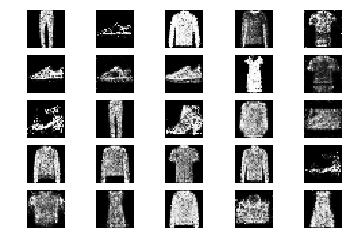

39101 [Discriminator loss: 0.576620, acc.: 67.19%] [Generator loss: 0.907206]
39102 [Discriminator loss: 0.605932, acc.: 68.75%] [Generator loss: 1.073721]
39103 [Discriminator loss: 0.587091, acc.: 68.75%] [Generator loss: 1.016694]
39104 [Discriminator loss: 0.697110, acc.: 60.94%] [Generator loss: 1.096701]
39105 [Discriminator loss: 0.713031, acc.: 59.38%] [Generator loss: 1.003885]
39106 [Discriminator loss: 0.596475, acc.: 62.50%] [Generator loss: 0.995272]
39107 [Discriminator loss: 0.631868, acc.: 62.50%] [Generator loss: 0.986842]
39108 [Discriminator loss: 0.630367, acc.: 60.94%] [Generator loss: 0.918065]
39109 [Discriminator loss: 0.628658, acc.: 57.81%] [Generator loss: 1.063269]
39110 [Discriminator loss: 0.645869, acc.: 57.81%] [Generator loss: 1.039628]
39111 [Discriminator loss: 0.656815, acc.: 62.50%] [Generator loss: 1.017393]
39112 [Discriminator loss: 0.584927, acc.: 73.44%] [Generator loss: 1.001108]
39113 [Discriminator loss: 0.664039, acc.: 62.50%] [Generator lo

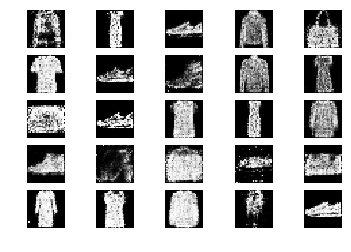

39201 [Discriminator loss: 0.581512, acc.: 68.75%] [Generator loss: 0.984860]
39202 [Discriminator loss: 0.648178, acc.: 59.38%] [Generator loss: 1.070373]
39203 [Discriminator loss: 0.607503, acc.: 76.56%] [Generator loss: 0.995939]
39204 [Discriminator loss: 0.628721, acc.: 71.88%] [Generator loss: 0.973982]
39205 [Discriminator loss: 0.650136, acc.: 57.81%] [Generator loss: 0.985677]
39206 [Discriminator loss: 0.605356, acc.: 67.19%] [Generator loss: 1.159857]
39207 [Discriminator loss: 0.546866, acc.: 75.00%] [Generator loss: 1.078149]
39208 [Discriminator loss: 0.595442, acc.: 68.75%] [Generator loss: 1.011750]
39209 [Discriminator loss: 0.569197, acc.: 70.31%] [Generator loss: 1.026118]
39210 [Discriminator loss: 0.591171, acc.: 68.75%] [Generator loss: 0.992524]
39211 [Discriminator loss: 0.618755, acc.: 73.44%] [Generator loss: 1.106837]
39212 [Discriminator loss: 0.578039, acc.: 73.44%] [Generator loss: 1.089159]
39213 [Discriminator loss: 0.678959, acc.: 59.38%] [Generator lo

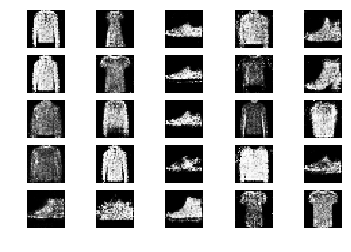

39301 [Discriminator loss: 0.630883, acc.: 60.94%] [Generator loss: 1.039361]
39302 [Discriminator loss: 0.611826, acc.: 60.94%] [Generator loss: 1.130267]
39303 [Discriminator loss: 0.690905, acc.: 53.12%] [Generator loss: 1.079677]
39304 [Discriminator loss: 0.643702, acc.: 60.94%] [Generator loss: 1.039875]
39305 [Discriminator loss: 0.713959, acc.: 54.69%] [Generator loss: 1.015798]
39306 [Discriminator loss: 0.588979, acc.: 73.44%] [Generator loss: 1.022335]
39307 [Discriminator loss: 0.674670, acc.: 57.81%] [Generator loss: 1.050660]
39308 [Discriminator loss: 0.683896, acc.: 54.69%] [Generator loss: 1.032180]
39309 [Discriminator loss: 0.597731, acc.: 65.62%] [Generator loss: 0.981603]
39310 [Discriminator loss: 0.602056, acc.: 68.75%] [Generator loss: 1.067443]
39311 [Discriminator loss: 0.608217, acc.: 68.75%] [Generator loss: 0.918240]
39312 [Discriminator loss: 0.595019, acc.: 64.06%] [Generator loss: 0.967155]
39313 [Discriminator loss: 0.584143, acc.: 73.44%] [Generator lo

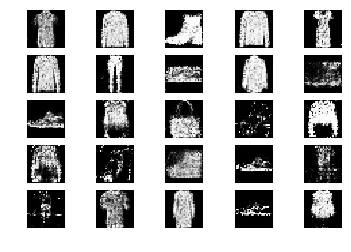

39401 [Discriminator loss: 0.610596, acc.: 60.94%] [Generator loss: 0.976772]
39402 [Discriminator loss: 0.598605, acc.: 67.19%] [Generator loss: 1.079286]
39403 [Discriminator loss: 0.579515, acc.: 65.62%] [Generator loss: 0.982680]
39404 [Discriminator loss: 0.642211, acc.: 62.50%] [Generator loss: 0.924963]
39405 [Discriminator loss: 0.604636, acc.: 64.06%] [Generator loss: 1.108548]
39406 [Discriminator loss: 0.638296, acc.: 62.50%] [Generator loss: 0.936728]
39407 [Discriminator loss: 0.572486, acc.: 67.19%] [Generator loss: 0.861711]
39408 [Discriminator loss: 0.623329, acc.: 67.19%] [Generator loss: 1.068517]
39409 [Discriminator loss: 0.574636, acc.: 73.44%] [Generator loss: 1.015205]
39410 [Discriminator loss: 0.571121, acc.: 68.75%] [Generator loss: 0.939333]
39411 [Discriminator loss: 0.632664, acc.: 65.62%] [Generator loss: 1.020244]
39412 [Discriminator loss: 0.650091, acc.: 71.88%] [Generator loss: 0.920795]
39413 [Discriminator loss: 0.576480, acc.: 65.62%] [Generator lo

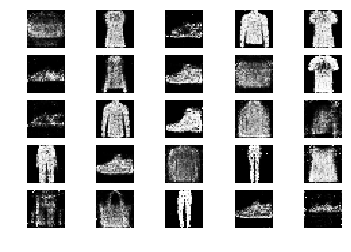

39501 [Discriminator loss: 0.677420, acc.: 60.94%] [Generator loss: 1.058378]
39502 [Discriminator loss: 0.637173, acc.: 62.50%] [Generator loss: 1.026251]
39503 [Discriminator loss: 0.606805, acc.: 70.31%] [Generator loss: 0.965499]
39504 [Discriminator loss: 0.641894, acc.: 67.19%] [Generator loss: 1.059635]
39505 [Discriminator loss: 0.607150, acc.: 73.44%] [Generator loss: 0.999373]
39506 [Discriminator loss: 0.632663, acc.: 65.62%] [Generator loss: 1.078369]
39507 [Discriminator loss: 0.584546, acc.: 71.88%] [Generator loss: 1.006097]
39508 [Discriminator loss: 0.679707, acc.: 59.38%] [Generator loss: 1.080852]
39509 [Discriminator loss: 0.670399, acc.: 57.81%] [Generator loss: 0.989224]
39510 [Discriminator loss: 0.570801, acc.: 67.19%] [Generator loss: 1.109082]
39511 [Discriminator loss: 0.555817, acc.: 64.06%] [Generator loss: 1.138562]
39512 [Discriminator loss: 0.707540, acc.: 54.69%] [Generator loss: 1.234293]
39513 [Discriminator loss: 0.612248, acc.: 68.75%] [Generator lo

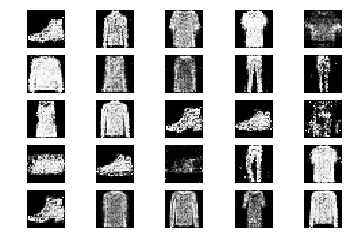

39601 [Discriminator loss: 0.714215, acc.: 60.94%] [Generator loss: 0.996229]
39602 [Discriminator loss: 0.675027, acc.: 62.50%] [Generator loss: 1.027184]
39603 [Discriminator loss: 0.612792, acc.: 60.94%] [Generator loss: 1.059093]
39604 [Discriminator loss: 0.591919, acc.: 71.88%] [Generator loss: 0.949853]
39605 [Discriminator loss: 0.624608, acc.: 71.88%] [Generator loss: 0.989310]
39606 [Discriminator loss: 0.621469, acc.: 65.62%] [Generator loss: 1.072888]
39607 [Discriminator loss: 0.588599, acc.: 68.75%] [Generator loss: 1.083114]
39608 [Discriminator loss: 0.526483, acc.: 70.31%] [Generator loss: 1.059731]
39609 [Discriminator loss: 0.693252, acc.: 51.56%] [Generator loss: 1.054659]
39610 [Discriminator loss: 0.620990, acc.: 65.62%] [Generator loss: 0.953594]
39611 [Discriminator loss: 0.566105, acc.: 73.44%] [Generator loss: 0.989945]
39612 [Discriminator loss: 0.620832, acc.: 64.06%] [Generator loss: 1.083319]
39613 [Discriminator loss: 0.573053, acc.: 64.06%] [Generator lo

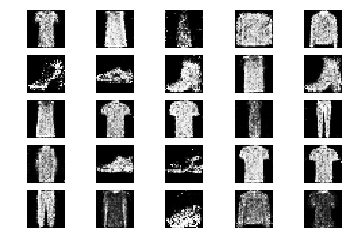

39701 [Discriminator loss: 0.621505, acc.: 65.62%] [Generator loss: 1.027357]
39702 [Discriminator loss: 0.510172, acc.: 81.25%] [Generator loss: 0.888054]
39703 [Discriminator loss: 0.593834, acc.: 71.88%] [Generator loss: 0.986109]
39704 [Discriminator loss: 0.584332, acc.: 70.31%] [Generator loss: 0.950664]
39705 [Discriminator loss: 0.709526, acc.: 54.69%] [Generator loss: 0.975447]
39706 [Discriminator loss: 0.566012, acc.: 71.88%] [Generator loss: 0.916407]
39707 [Discriminator loss: 0.701724, acc.: 64.06%] [Generator loss: 0.999504]
39708 [Discriminator loss: 0.744401, acc.: 45.31%] [Generator loss: 1.068616]
39709 [Discriminator loss: 0.574489, acc.: 68.75%] [Generator loss: 0.923601]
39710 [Discriminator loss: 0.608952, acc.: 65.62%] [Generator loss: 1.019793]
39711 [Discriminator loss: 0.567730, acc.: 68.75%] [Generator loss: 1.066536]
39712 [Discriminator loss: 0.625808, acc.: 64.06%] [Generator loss: 1.101151]
39713 [Discriminator loss: 0.697863, acc.: 64.06%] [Generator lo

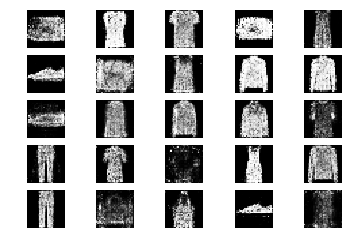

39801 [Discriminator loss: 0.570808, acc.: 67.19%] [Generator loss: 0.988684]
39802 [Discriminator loss: 0.678609, acc.: 56.25%] [Generator loss: 1.001090]
39803 [Discriminator loss: 0.597906, acc.: 65.62%] [Generator loss: 1.054348]
39804 [Discriminator loss: 0.573070, acc.: 73.44%] [Generator loss: 1.061814]
39805 [Discriminator loss: 0.620190, acc.: 67.19%] [Generator loss: 1.054966]
39806 [Discriminator loss: 0.638751, acc.: 68.75%] [Generator loss: 0.991268]
39807 [Discriminator loss: 0.565014, acc.: 68.75%] [Generator loss: 0.994380]
39808 [Discriminator loss: 0.636869, acc.: 64.06%] [Generator loss: 0.993662]
39809 [Discriminator loss: 0.628080, acc.: 65.62%] [Generator loss: 0.926313]
39810 [Discriminator loss: 0.662987, acc.: 64.06%] [Generator loss: 0.979340]
39811 [Discriminator loss: 0.598064, acc.: 67.19%] [Generator loss: 1.039411]
39812 [Discriminator loss: 0.613247, acc.: 68.75%] [Generator loss: 1.123510]
39813 [Discriminator loss: 0.655656, acc.: 68.75%] [Generator lo

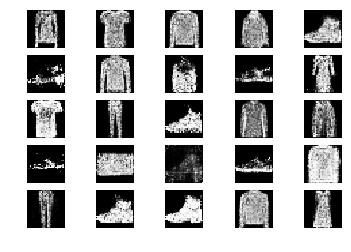

39901 [Discriminator loss: 0.639946, acc.: 60.94%] [Generator loss: 1.057290]
39902 [Discriminator loss: 0.575675, acc.: 70.31%] [Generator loss: 1.065054]
39903 [Discriminator loss: 0.659544, acc.: 59.38%] [Generator loss: 1.073872]
39904 [Discriminator loss: 0.656854, acc.: 60.94%] [Generator loss: 1.130352]
39905 [Discriminator loss: 0.577442, acc.: 67.19%] [Generator loss: 1.135877]
39906 [Discriminator loss: 0.643985, acc.: 64.06%] [Generator loss: 1.114288]
39907 [Discriminator loss: 0.612326, acc.: 65.62%] [Generator loss: 1.170102]
39908 [Discriminator loss: 0.622730, acc.: 64.06%] [Generator loss: 1.019588]
39909 [Discriminator loss: 0.602053, acc.: 68.75%] [Generator loss: 0.993075]
39910 [Discriminator loss: 0.657537, acc.: 65.62%] [Generator loss: 0.979560]
39911 [Discriminator loss: 0.632623, acc.: 59.38%] [Generator loss: 1.013858]
39912 [Discriminator loss: 0.712916, acc.: 51.56%] [Generator loss: 1.030256]
39913 [Discriminator loss: 0.579974, acc.: 70.31%] [Generator lo

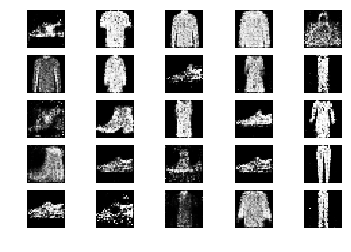

40001 [Discriminator loss: 0.625365, acc.: 64.06%] [Generator loss: 0.974723]
40002 [Discriminator loss: 0.611680, acc.: 68.75%] [Generator loss: 0.911612]
40003 [Discriminator loss: 0.551606, acc.: 76.56%] [Generator loss: 1.050032]
40004 [Discriminator loss: 0.699579, acc.: 59.38%] [Generator loss: 1.057119]
40005 [Discriminator loss: 0.627234, acc.: 59.38%] [Generator loss: 1.033527]
40006 [Discriminator loss: 0.647194, acc.: 64.06%] [Generator loss: 1.099830]
40007 [Discriminator loss: 0.576998, acc.: 67.19%] [Generator loss: 1.107973]
40008 [Discriminator loss: 0.538100, acc.: 76.56%] [Generator loss: 1.082002]
40009 [Discriminator loss: 0.522832, acc.: 78.12%] [Generator loss: 1.121054]
40010 [Discriminator loss: 0.682650, acc.: 59.38%] [Generator loss: 1.131563]
40011 [Discriminator loss: 0.591133, acc.: 62.50%] [Generator loss: 1.082890]
40012 [Discriminator loss: 0.633526, acc.: 62.50%] [Generator loss: 1.093085]
40013 [Discriminator loss: 0.618315, acc.: 60.94%] [Generator lo

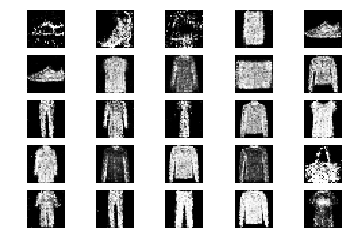

40101 [Discriminator loss: 0.657592, acc.: 62.50%] [Generator loss: 0.903118]
40102 [Discriminator loss: 0.755224, acc.: 57.81%] [Generator loss: 1.054981]
40103 [Discriminator loss: 0.657342, acc.: 62.50%] [Generator loss: 1.016063]
40104 [Discriminator loss: 0.639461, acc.: 59.38%] [Generator loss: 0.917775]
40105 [Discriminator loss: 0.541764, acc.: 75.00%] [Generator loss: 1.050560]
40106 [Discriminator loss: 0.595242, acc.: 64.06%] [Generator loss: 0.973995]
40107 [Discriminator loss: 0.591531, acc.: 62.50%] [Generator loss: 1.088710]
40108 [Discriminator loss: 0.575285, acc.: 65.62%] [Generator loss: 0.947574]
40109 [Discriminator loss: 0.561102, acc.: 70.31%] [Generator loss: 1.066739]
40110 [Discriminator loss: 0.692486, acc.: 56.25%] [Generator loss: 0.995557]
40111 [Discriminator loss: 0.656798, acc.: 60.94%] [Generator loss: 1.045090]
40112 [Discriminator loss: 0.639750, acc.: 62.50%] [Generator loss: 0.994002]
40113 [Discriminator loss: 0.625471, acc.: 67.19%] [Generator lo

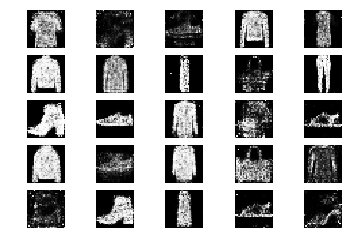

40201 [Discriminator loss: 0.605283, acc.: 65.62%] [Generator loss: 1.094758]
40202 [Discriminator loss: 0.599076, acc.: 65.62%] [Generator loss: 1.066483]
40203 [Discriminator loss: 0.627381, acc.: 60.94%] [Generator loss: 0.954849]
40204 [Discriminator loss: 0.676738, acc.: 57.81%] [Generator loss: 1.017673]
40205 [Discriminator loss: 0.669934, acc.: 62.50%] [Generator loss: 0.965819]
40206 [Discriminator loss: 0.657906, acc.: 64.06%] [Generator loss: 0.932857]
40207 [Discriminator loss: 0.591879, acc.: 64.06%] [Generator loss: 1.014933]
40208 [Discriminator loss: 0.606416, acc.: 67.19%] [Generator loss: 0.893909]
40209 [Discriminator loss: 0.614988, acc.: 65.62%] [Generator loss: 1.089859]
40210 [Discriminator loss: 0.601618, acc.: 65.62%] [Generator loss: 0.951064]
40211 [Discriminator loss: 0.629284, acc.: 62.50%] [Generator loss: 1.047610]
40212 [Discriminator loss: 0.591168, acc.: 70.31%] [Generator loss: 1.068476]
40213 [Discriminator loss: 0.623027, acc.: 64.06%] [Generator lo

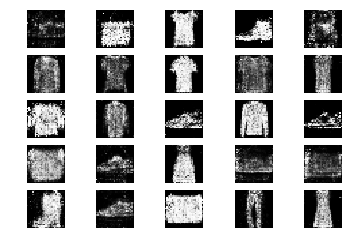

40301 [Discriminator loss: 0.590096, acc.: 67.19%] [Generator loss: 1.070203]
40302 [Discriminator loss: 0.573275, acc.: 68.75%] [Generator loss: 1.068695]
40303 [Discriminator loss: 0.592282, acc.: 71.88%] [Generator loss: 1.045284]
40304 [Discriminator loss: 0.657552, acc.: 64.06%] [Generator loss: 1.036975]
40305 [Discriminator loss: 0.567912, acc.: 68.75%] [Generator loss: 1.169813]
40306 [Discriminator loss: 0.533533, acc.: 71.88%] [Generator loss: 1.192331]
40307 [Discriminator loss: 0.598268, acc.: 73.44%] [Generator loss: 1.126529]
40308 [Discriminator loss: 0.695393, acc.: 56.25%] [Generator loss: 1.006221]
40309 [Discriminator loss: 0.540021, acc.: 65.62%] [Generator loss: 0.865479]
40310 [Discriminator loss: 0.625626, acc.: 64.06%] [Generator loss: 0.948616]
40311 [Discriminator loss: 0.549676, acc.: 78.12%] [Generator loss: 1.023832]
40312 [Discriminator loss: 0.685167, acc.: 59.38%] [Generator loss: 1.023596]
40313 [Discriminator loss: 0.621339, acc.: 60.94%] [Generator lo

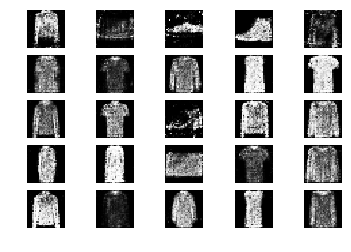

40401 [Discriminator loss: 0.704539, acc.: 57.81%] [Generator loss: 0.956503]
40402 [Discriminator loss: 0.639754, acc.: 57.81%] [Generator loss: 1.012238]
40403 [Discriminator loss: 0.642537, acc.: 56.25%] [Generator loss: 0.918864]
40404 [Discriminator loss: 0.672340, acc.: 57.81%] [Generator loss: 1.013120]
40405 [Discriminator loss: 0.649472, acc.: 67.19%] [Generator loss: 1.040964]
40406 [Discriminator loss: 0.595413, acc.: 62.50%] [Generator loss: 0.960156]
40407 [Discriminator loss: 0.606486, acc.: 70.31%] [Generator loss: 0.963651]
40408 [Discriminator loss: 0.600393, acc.: 67.19%] [Generator loss: 0.922528]
40409 [Discriminator loss: 0.641666, acc.: 64.06%] [Generator loss: 1.083949]
40410 [Discriminator loss: 0.688245, acc.: 59.38%] [Generator loss: 1.046250]
40411 [Discriminator loss: 0.697839, acc.: 53.12%] [Generator loss: 0.989429]
40412 [Discriminator loss: 0.577907, acc.: 75.00%] [Generator loss: 0.936141]
40413 [Discriminator loss: 0.678350, acc.: 54.69%] [Generator lo

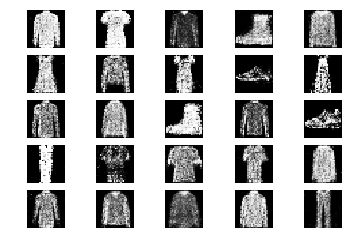

40501 [Discriminator loss: 0.640461, acc.: 57.81%] [Generator loss: 1.013834]
40502 [Discriminator loss: 0.677375, acc.: 68.75%] [Generator loss: 0.933729]
40503 [Discriminator loss: 0.594009, acc.: 70.31%] [Generator loss: 0.963045]
40504 [Discriminator loss: 0.685901, acc.: 59.38%] [Generator loss: 0.958743]
40505 [Discriminator loss: 0.622207, acc.: 64.06%] [Generator loss: 1.097547]
40506 [Discriminator loss: 0.672692, acc.: 53.12%] [Generator loss: 0.968595]
40507 [Discriminator loss: 0.593124, acc.: 64.06%] [Generator loss: 1.061041]
40508 [Discriminator loss: 0.639448, acc.: 62.50%] [Generator loss: 1.089537]
40509 [Discriminator loss: 0.671202, acc.: 59.38%] [Generator loss: 1.080097]
40510 [Discriminator loss: 0.605369, acc.: 65.62%] [Generator loss: 1.021020]
40511 [Discriminator loss: 0.610110, acc.: 64.06%] [Generator loss: 1.046562]
40512 [Discriminator loss: 0.648964, acc.: 64.06%] [Generator loss: 1.039670]
40513 [Discriminator loss: 0.651043, acc.: 54.69%] [Generator lo

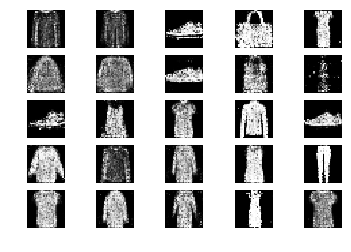

40601 [Discriminator loss: 0.612931, acc.: 67.19%] [Generator loss: 1.117208]
40602 [Discriminator loss: 0.580751, acc.: 65.62%] [Generator loss: 1.104980]
40603 [Discriminator loss: 0.552865, acc.: 68.75%] [Generator loss: 1.141879]
40604 [Discriminator loss: 0.639563, acc.: 65.62%] [Generator loss: 1.064658]
40605 [Discriminator loss: 0.563009, acc.: 70.31%] [Generator loss: 0.953518]
40606 [Discriminator loss: 0.672585, acc.: 57.81%] [Generator loss: 1.034600]
40607 [Discriminator loss: 0.658952, acc.: 62.50%] [Generator loss: 1.113037]
40608 [Discriminator loss: 0.539685, acc.: 76.56%] [Generator loss: 1.101424]
40609 [Discriminator loss: 0.648651, acc.: 65.62%] [Generator loss: 1.246873]
40610 [Discriminator loss: 0.661229, acc.: 53.12%] [Generator loss: 1.045656]
40611 [Discriminator loss: 0.600416, acc.: 67.19%] [Generator loss: 1.171272]
40612 [Discriminator loss: 0.584464, acc.: 68.75%] [Generator loss: 1.040516]
40613 [Discriminator loss: 0.589746, acc.: 64.06%] [Generator lo

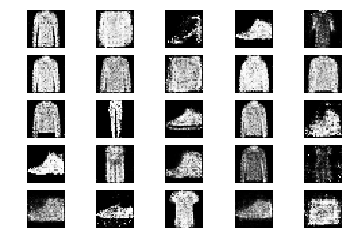

40701 [Discriminator loss: 0.615142, acc.: 62.50%] [Generator loss: 0.984251]
40702 [Discriminator loss: 0.607351, acc.: 65.62%] [Generator loss: 1.063790]
40703 [Discriminator loss: 0.620975, acc.: 59.38%] [Generator loss: 1.005052]
40704 [Discriminator loss: 0.648848, acc.: 68.75%] [Generator loss: 1.258578]
40705 [Discriminator loss: 0.609271, acc.: 68.75%] [Generator loss: 1.198286]
40706 [Discriminator loss: 0.577564, acc.: 70.31%] [Generator loss: 1.186138]
40707 [Discriminator loss: 0.604808, acc.: 70.31%] [Generator loss: 1.008301]
40708 [Discriminator loss: 0.600611, acc.: 71.88%] [Generator loss: 0.837640]
40709 [Discriminator loss: 0.611777, acc.: 67.19%] [Generator loss: 0.830247]
40710 [Discriminator loss: 0.577048, acc.: 73.44%] [Generator loss: 0.910758]
40711 [Discriminator loss: 0.623067, acc.: 70.31%] [Generator loss: 0.858117]
40712 [Discriminator loss: 0.708548, acc.: 54.69%] [Generator loss: 1.060688]
40713 [Discriminator loss: 0.646482, acc.: 59.38%] [Generator lo

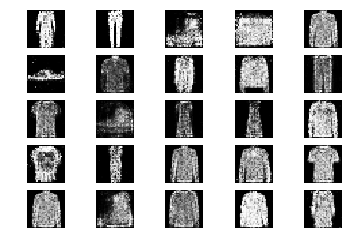

40801 [Discriminator loss: 0.533271, acc.: 76.56%] [Generator loss: 1.112532]
40802 [Discriminator loss: 0.602705, acc.: 62.50%] [Generator loss: 1.035288]
40803 [Discriminator loss: 0.671540, acc.: 64.06%] [Generator loss: 1.002383]
40804 [Discriminator loss: 0.568356, acc.: 75.00%] [Generator loss: 0.943313]
40805 [Discriminator loss: 0.672119, acc.: 60.94%] [Generator loss: 1.055931]
40806 [Discriminator loss: 0.580315, acc.: 65.62%] [Generator loss: 1.011827]
40807 [Discriminator loss: 0.565537, acc.: 70.31%] [Generator loss: 0.969057]
40808 [Discriminator loss: 0.690108, acc.: 64.06%] [Generator loss: 1.068863]
40809 [Discriminator loss: 0.631064, acc.: 60.94%] [Generator loss: 1.011654]
40810 [Discriminator loss: 0.624695, acc.: 65.62%] [Generator loss: 1.019078]
40811 [Discriminator loss: 0.694934, acc.: 59.38%] [Generator loss: 1.019372]
40812 [Discriminator loss: 0.561401, acc.: 70.31%] [Generator loss: 1.280106]
40813 [Discriminator loss: 0.685636, acc.: 59.38%] [Generator lo

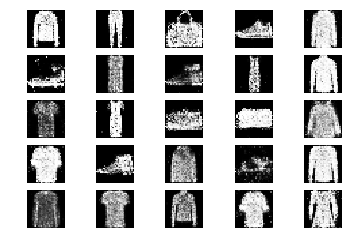

40901 [Discriminator loss: 0.664909, acc.: 56.25%] [Generator loss: 0.894546]
40902 [Discriminator loss: 0.572747, acc.: 70.31%] [Generator loss: 1.170243]
40903 [Discriminator loss: 0.618357, acc.: 64.06%] [Generator loss: 1.085223]
40904 [Discriminator loss: 0.648454, acc.: 65.62%] [Generator loss: 1.043845]
40905 [Discriminator loss: 0.658723, acc.: 64.06%] [Generator loss: 1.001829]
40906 [Discriminator loss: 0.616409, acc.: 62.50%] [Generator loss: 0.892504]
40907 [Discriminator loss: 0.641692, acc.: 59.38%] [Generator loss: 1.034381]
40908 [Discriminator loss: 0.544803, acc.: 71.88%] [Generator loss: 1.126232]
40909 [Discriminator loss: 0.752227, acc.: 53.12%] [Generator loss: 0.988910]
40910 [Discriminator loss: 0.541227, acc.: 65.62%] [Generator loss: 1.110384]
40911 [Discriminator loss: 0.606008, acc.: 68.75%] [Generator loss: 1.188750]
40912 [Discriminator loss: 0.655826, acc.: 62.50%] [Generator loss: 1.020332]
40913 [Discriminator loss: 0.583119, acc.: 76.56%] [Generator lo

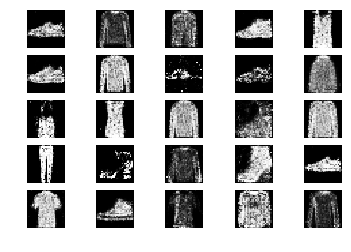

41001 [Discriminator loss: 0.616944, acc.: 68.75%] [Generator loss: 1.083555]
41002 [Discriminator loss: 0.617690, acc.: 67.19%] [Generator loss: 1.104164]
41003 [Discriminator loss: 0.621480, acc.: 60.94%] [Generator loss: 1.001806]
41004 [Discriminator loss: 0.582092, acc.: 67.19%] [Generator loss: 1.096590]
41005 [Discriminator loss: 0.638106, acc.: 70.31%] [Generator loss: 0.907697]
41006 [Discriminator loss: 0.651810, acc.: 70.31%] [Generator loss: 0.919875]
41007 [Discriminator loss: 0.581044, acc.: 70.31%] [Generator loss: 0.961929]
41008 [Discriminator loss: 0.572811, acc.: 71.88%] [Generator loss: 1.046839]
41009 [Discriminator loss: 0.659549, acc.: 57.81%] [Generator loss: 1.099730]
41010 [Discriminator loss: 0.691589, acc.: 57.81%] [Generator loss: 1.027805]
41011 [Discriminator loss: 0.693126, acc.: 57.81%] [Generator loss: 0.957778]
41012 [Discriminator loss: 0.630263, acc.: 64.06%] [Generator loss: 0.955338]
41013 [Discriminator loss: 0.661185, acc.: 56.25%] [Generator lo

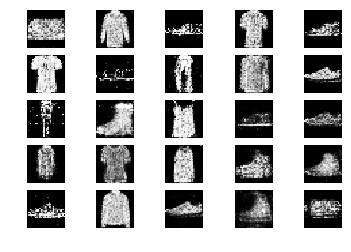

41101 [Discriminator loss: 0.739445, acc.: 48.44%] [Generator loss: 1.108263]
41102 [Discriminator loss: 0.576684, acc.: 67.19%] [Generator loss: 1.064105]
41103 [Discriminator loss: 0.638659, acc.: 59.38%] [Generator loss: 0.992795]
41104 [Discriminator loss: 0.593318, acc.: 70.31%] [Generator loss: 1.077234]
41105 [Discriminator loss: 0.600086, acc.: 73.44%] [Generator loss: 0.940064]
41106 [Discriminator loss: 0.668773, acc.: 62.50%] [Generator loss: 0.944953]
41107 [Discriminator loss: 0.754472, acc.: 45.31%] [Generator loss: 1.072876]
41108 [Discriminator loss: 0.646662, acc.: 67.19%] [Generator loss: 1.086397]
41109 [Discriminator loss: 0.623451, acc.: 65.62%] [Generator loss: 0.962553]
41110 [Discriminator loss: 0.552496, acc.: 70.31%] [Generator loss: 0.994074]
41111 [Discriminator loss: 0.682833, acc.: 57.81%] [Generator loss: 0.997111]
41112 [Discriminator loss: 0.699341, acc.: 54.69%] [Generator loss: 1.040998]
41113 [Discriminator loss: 0.641926, acc.: 64.06%] [Generator lo

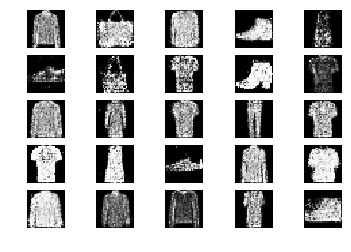

41201 [Discriminator loss: 0.599353, acc.: 71.88%] [Generator loss: 1.066862]
41202 [Discriminator loss: 0.577760, acc.: 71.88%] [Generator loss: 1.104223]
41203 [Discriminator loss: 0.680050, acc.: 60.94%] [Generator loss: 1.080815]
41204 [Discriminator loss: 0.483801, acc.: 82.81%] [Generator loss: 1.124332]
41205 [Discriminator loss: 0.567072, acc.: 70.31%] [Generator loss: 1.029566]
41206 [Discriminator loss: 0.695972, acc.: 54.69%] [Generator loss: 1.140105]
41207 [Discriminator loss: 0.622068, acc.: 62.50%] [Generator loss: 1.106170]
41208 [Discriminator loss: 0.692329, acc.: 60.94%] [Generator loss: 1.006182]
41209 [Discriminator loss: 0.587336, acc.: 65.62%] [Generator loss: 0.967775]
41210 [Discriminator loss: 0.600233, acc.: 67.19%] [Generator loss: 1.070995]
41211 [Discriminator loss: 0.714392, acc.: 50.00%] [Generator loss: 1.080303]
41212 [Discriminator loss: 0.557705, acc.: 71.88%] [Generator loss: 1.057422]
41213 [Discriminator loss: 0.583443, acc.: 76.56%] [Generator lo

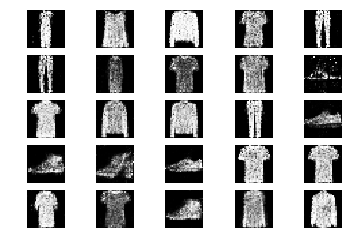

41301 [Discriminator loss: 0.657339, acc.: 62.50%] [Generator loss: 1.101948]
41302 [Discriminator loss: 0.597949, acc.: 62.50%] [Generator loss: 1.078914]
41303 [Discriminator loss: 0.579083, acc.: 73.44%] [Generator loss: 1.000694]
41304 [Discriminator loss: 0.625497, acc.: 62.50%] [Generator loss: 1.067795]
41305 [Discriminator loss: 0.575995, acc.: 64.06%] [Generator loss: 1.068907]
41306 [Discriminator loss: 0.617733, acc.: 65.62%] [Generator loss: 1.066679]
41307 [Discriminator loss: 0.648613, acc.: 59.38%] [Generator loss: 0.989041]
41308 [Discriminator loss: 0.638306, acc.: 59.38%] [Generator loss: 0.992329]
41309 [Discriminator loss: 0.624467, acc.: 67.19%] [Generator loss: 1.057990]
41310 [Discriminator loss: 0.576248, acc.: 68.75%] [Generator loss: 1.076693]
41311 [Discriminator loss: 0.558698, acc.: 76.56%] [Generator loss: 1.069493]
41312 [Discriminator loss: 0.646838, acc.: 60.94%] [Generator loss: 1.179815]
41313 [Discriminator loss: 0.654606, acc.: 60.94%] [Generator lo

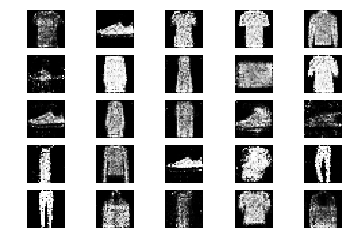

41401 [Discriminator loss: 0.644267, acc.: 59.38%] [Generator loss: 1.088199]
41402 [Discriminator loss: 0.629614, acc.: 71.88%] [Generator loss: 0.922541]
41403 [Discriminator loss: 0.539620, acc.: 75.00%] [Generator loss: 0.969435]
41404 [Discriminator loss: 0.703961, acc.: 54.69%] [Generator loss: 1.005332]
41405 [Discriminator loss: 0.586539, acc.: 70.31%] [Generator loss: 0.926675]
41406 [Discriminator loss: 0.654295, acc.: 62.50%] [Generator loss: 1.118624]
41407 [Discriminator loss: 0.615282, acc.: 65.62%] [Generator loss: 1.134117]
41408 [Discriminator loss: 0.628574, acc.: 64.06%] [Generator loss: 1.015705]
41409 [Discriminator loss: 0.693138, acc.: 54.69%] [Generator loss: 0.980975]
41410 [Discriminator loss: 0.526910, acc.: 75.00%] [Generator loss: 1.028128]
41411 [Discriminator loss: 0.551922, acc.: 73.44%] [Generator loss: 1.003516]
41412 [Discriminator loss: 0.547423, acc.: 67.19%] [Generator loss: 0.972100]
41413 [Discriminator loss: 0.657321, acc.: 59.38%] [Generator lo

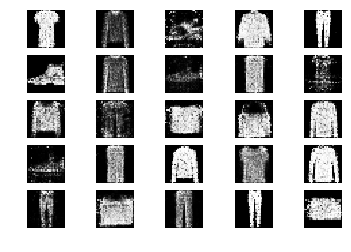

41501 [Discriminator loss: 0.640755, acc.: 60.94%] [Generator loss: 1.077096]
41502 [Discriminator loss: 0.634205, acc.: 60.94%] [Generator loss: 1.127833]
41503 [Discriminator loss: 0.692014, acc.: 57.81%] [Generator loss: 0.957490]
41504 [Discriminator loss: 0.615026, acc.: 62.50%] [Generator loss: 0.921046]
41505 [Discriminator loss: 0.587055, acc.: 73.44%] [Generator loss: 1.200070]
41506 [Discriminator loss: 0.649746, acc.: 62.50%] [Generator loss: 1.003286]
41507 [Discriminator loss: 0.647989, acc.: 67.19%] [Generator loss: 0.942185]
41508 [Discriminator loss: 0.637790, acc.: 62.50%] [Generator loss: 0.993782]
41509 [Discriminator loss: 0.638983, acc.: 56.25%] [Generator loss: 0.886217]
41510 [Discriminator loss: 0.602752, acc.: 70.31%] [Generator loss: 0.999712]
41511 [Discriminator loss: 0.613546, acc.: 65.62%] [Generator loss: 0.986122]
41512 [Discriminator loss: 0.590586, acc.: 65.62%] [Generator loss: 0.999379]
41513 [Discriminator loss: 0.660300, acc.: 64.06%] [Generator lo

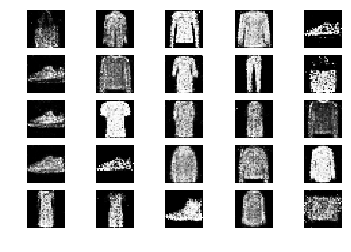

41601 [Discriminator loss: 0.590874, acc.: 64.06%] [Generator loss: 1.065998]
41602 [Discriminator loss: 0.605720, acc.: 68.75%] [Generator loss: 1.140294]
41603 [Discriminator loss: 0.639132, acc.: 60.94%] [Generator loss: 1.010974]
41604 [Discriminator loss: 0.665740, acc.: 65.62%] [Generator loss: 1.027196]
41605 [Discriminator loss: 0.618134, acc.: 71.88%] [Generator loss: 1.079939]
41606 [Discriminator loss: 0.667975, acc.: 56.25%] [Generator loss: 0.976292]
41607 [Discriminator loss: 0.651040, acc.: 65.62%] [Generator loss: 1.026606]
41608 [Discriminator loss: 0.635661, acc.: 64.06%] [Generator loss: 0.930746]
41609 [Discriminator loss: 0.694806, acc.: 59.38%] [Generator loss: 1.025007]
41610 [Discriminator loss: 0.594978, acc.: 64.06%] [Generator loss: 0.980452]
41611 [Discriminator loss: 0.613562, acc.: 67.19%] [Generator loss: 0.947551]
41612 [Discriminator loss: 0.605546, acc.: 64.06%] [Generator loss: 1.032762]
41613 [Discriminator loss: 0.681572, acc.: 56.25%] [Generator lo

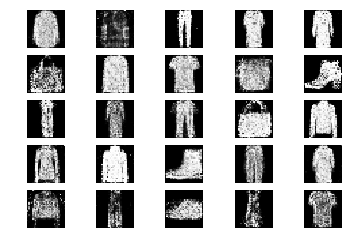

41701 [Discriminator loss: 0.552081, acc.: 71.88%] [Generator loss: 0.985967]
41702 [Discriminator loss: 0.617980, acc.: 67.19%] [Generator loss: 1.051106]
41703 [Discriminator loss: 0.595475, acc.: 64.06%] [Generator loss: 0.998026]
41704 [Discriminator loss: 0.576867, acc.: 71.88%] [Generator loss: 1.164096]
41705 [Discriminator loss: 0.636063, acc.: 59.38%] [Generator loss: 1.014167]
41706 [Discriminator loss: 0.672601, acc.: 56.25%] [Generator loss: 0.904550]
41707 [Discriminator loss: 0.649885, acc.: 64.06%] [Generator loss: 0.974330]
41708 [Discriminator loss: 0.559054, acc.: 68.75%] [Generator loss: 0.994162]
41709 [Discriminator loss: 0.601208, acc.: 67.19%] [Generator loss: 1.096625]
41710 [Discriminator loss: 0.567278, acc.: 70.31%] [Generator loss: 0.954488]
41711 [Discriminator loss: 0.609477, acc.: 64.06%] [Generator loss: 1.018563]
41712 [Discriminator loss: 0.672485, acc.: 56.25%] [Generator loss: 0.999166]
41713 [Discriminator loss: 0.595822, acc.: 73.44%] [Generator lo

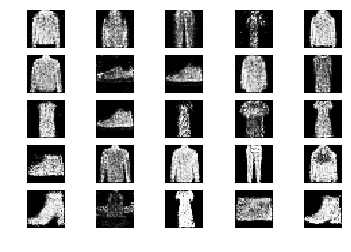

41801 [Discriminator loss: 0.682309, acc.: 62.50%] [Generator loss: 1.045015]
41802 [Discriminator loss: 0.628780, acc.: 65.62%] [Generator loss: 1.162772]
41803 [Discriminator loss: 0.659514, acc.: 64.06%] [Generator loss: 1.082556]
41804 [Discriminator loss: 0.623497, acc.: 71.88%] [Generator loss: 1.037955]
41805 [Discriminator loss: 0.601850, acc.: 59.38%] [Generator loss: 0.990653]
41806 [Discriminator loss: 0.645522, acc.: 62.50%] [Generator loss: 1.030774]
41807 [Discriminator loss: 0.620397, acc.: 70.31%] [Generator loss: 1.039194]
41808 [Discriminator loss: 0.699583, acc.: 57.81%] [Generator loss: 1.109473]
41809 [Discriminator loss: 0.603639, acc.: 70.31%] [Generator loss: 1.022499]
41810 [Discriminator loss: 0.590597, acc.: 71.88%] [Generator loss: 1.043977]
41811 [Discriminator loss: 0.638998, acc.: 59.38%] [Generator loss: 0.899122]
41812 [Discriminator loss: 0.599703, acc.: 70.31%] [Generator loss: 0.987061]
41813 [Discriminator loss: 0.554404, acc.: 75.00%] [Generator lo

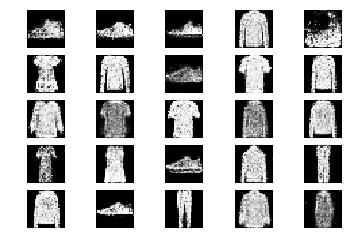

41901 [Discriminator loss: 0.658464, acc.: 62.50%] [Generator loss: 1.182661]
41902 [Discriminator loss: 0.630016, acc.: 62.50%] [Generator loss: 0.964959]
41903 [Discriminator loss: 0.673439, acc.: 54.69%] [Generator loss: 1.081441]
41904 [Discriminator loss: 0.656197, acc.: 56.25%] [Generator loss: 0.972218]
41905 [Discriminator loss: 0.700095, acc.: 51.56%] [Generator loss: 0.857414]
41906 [Discriminator loss: 0.602760, acc.: 70.31%] [Generator loss: 0.920326]
41907 [Discriminator loss: 0.640986, acc.: 56.25%] [Generator loss: 0.851023]
41908 [Discriminator loss: 0.643704, acc.: 67.19%] [Generator loss: 1.046814]
41909 [Discriminator loss: 0.569334, acc.: 76.56%] [Generator loss: 0.931313]
41910 [Discriminator loss: 0.676900, acc.: 57.81%] [Generator loss: 1.035419]
41911 [Discriminator loss: 0.660731, acc.: 57.81%] [Generator loss: 0.932372]
41912 [Discriminator loss: 0.613909, acc.: 70.31%] [Generator loss: 1.002223]
41913 [Discriminator loss: 0.651195, acc.: 62.50%] [Generator lo

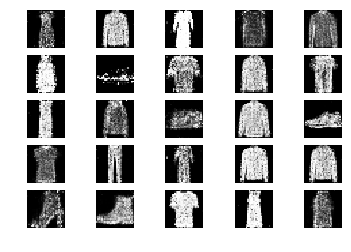

42001 [Discriminator loss: 0.587493, acc.: 71.88%] [Generator loss: 0.864998]
42002 [Discriminator loss: 0.615517, acc.: 70.31%] [Generator loss: 1.068433]
42003 [Discriminator loss: 0.528734, acc.: 81.25%] [Generator loss: 1.026769]
42004 [Discriminator loss: 0.630320, acc.: 67.19%] [Generator loss: 1.008781]
42005 [Discriminator loss: 0.509034, acc.: 78.12%] [Generator loss: 1.063827]
42006 [Discriminator loss: 0.510644, acc.: 73.44%] [Generator loss: 1.087563]
42007 [Discriminator loss: 0.627666, acc.: 62.50%] [Generator loss: 1.132692]
42008 [Discriminator loss: 0.635377, acc.: 67.19%] [Generator loss: 1.042922]
42009 [Discriminator loss: 0.650495, acc.: 60.94%] [Generator loss: 1.189009]
42010 [Discriminator loss: 0.639403, acc.: 59.38%] [Generator loss: 1.010038]
42011 [Discriminator loss: 0.699620, acc.: 62.50%] [Generator loss: 1.173908]
42012 [Discriminator loss: 0.566969, acc.: 65.62%] [Generator loss: 0.985512]
42013 [Discriminator loss: 0.648920, acc.: 64.06%] [Generator lo

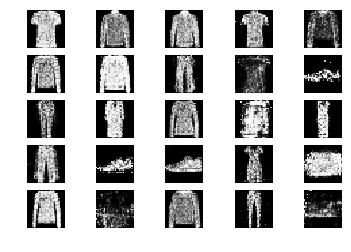

42101 [Discriminator loss: 0.575737, acc.: 68.75%] [Generator loss: 1.042099]
42102 [Discriminator loss: 0.563365, acc.: 67.19%] [Generator loss: 0.997826]
42103 [Discriminator loss: 0.620889, acc.: 60.94%] [Generator loss: 0.866585]
42104 [Discriminator loss: 0.531227, acc.: 76.56%] [Generator loss: 1.032653]
42105 [Discriminator loss: 0.658286, acc.: 56.25%] [Generator loss: 0.994147]
42106 [Discriminator loss: 0.633732, acc.: 59.38%] [Generator loss: 1.079757]
42107 [Discriminator loss: 0.675744, acc.: 60.94%] [Generator loss: 1.065747]
42108 [Discriminator loss: 0.581672, acc.: 68.75%] [Generator loss: 1.107454]
42109 [Discriminator loss: 0.659426, acc.: 57.81%] [Generator loss: 1.087833]
42110 [Discriminator loss: 0.608108, acc.: 71.88%] [Generator loss: 1.013000]
42111 [Discriminator loss: 0.594620, acc.: 68.75%] [Generator loss: 1.083019]
42112 [Discriminator loss: 0.569895, acc.: 70.31%] [Generator loss: 1.060266]
42113 [Discriminator loss: 0.579265, acc.: 65.62%] [Generator lo

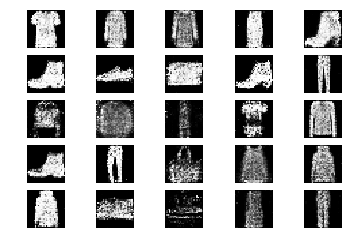

42201 [Discriminator loss: 0.582311, acc.: 70.31%] [Generator loss: 0.942078]
42202 [Discriminator loss: 0.598737, acc.: 65.62%] [Generator loss: 0.947613]
42203 [Discriminator loss: 0.672673, acc.: 62.50%] [Generator loss: 0.961118]
42204 [Discriminator loss: 0.625162, acc.: 68.75%] [Generator loss: 1.046265]
42205 [Discriminator loss: 0.697690, acc.: 62.50%] [Generator loss: 0.996624]
42206 [Discriminator loss: 0.677510, acc.: 60.94%] [Generator loss: 1.034604]
42207 [Discriminator loss: 0.651861, acc.: 56.25%] [Generator loss: 1.002220]
42208 [Discriminator loss: 0.539401, acc.: 79.69%] [Generator loss: 1.015582]
42209 [Discriminator loss: 0.613771, acc.: 64.06%] [Generator loss: 1.148179]
42210 [Discriminator loss: 0.647206, acc.: 57.81%] [Generator loss: 1.017267]
42211 [Discriminator loss: 0.628043, acc.: 64.06%] [Generator loss: 0.945606]
42212 [Discriminator loss: 0.612266, acc.: 62.50%] [Generator loss: 0.997255]
42213 [Discriminator loss: 0.623957, acc.: 64.06%] [Generator lo

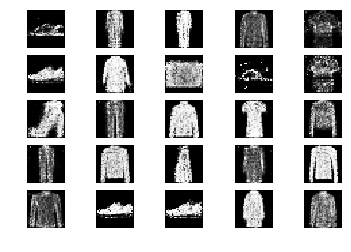

42301 [Discriminator loss: 0.561319, acc.: 75.00%] [Generator loss: 0.884593]
42302 [Discriminator loss: 0.601917, acc.: 68.75%] [Generator loss: 1.088571]
42303 [Discriminator loss: 0.614219, acc.: 62.50%] [Generator loss: 0.990666]
42304 [Discriminator loss: 0.674125, acc.: 62.50%] [Generator loss: 1.122773]
42305 [Discriminator loss: 0.623787, acc.: 62.50%] [Generator loss: 0.984504]
42306 [Discriminator loss: 0.644180, acc.: 62.50%] [Generator loss: 1.022016]
42307 [Discriminator loss: 0.664254, acc.: 67.19%] [Generator loss: 1.128705]
42308 [Discriminator loss: 0.570839, acc.: 67.19%] [Generator loss: 0.971402]
42309 [Discriminator loss: 0.596451, acc.: 71.88%] [Generator loss: 1.062936]
42310 [Discriminator loss: 0.635323, acc.: 67.19%] [Generator loss: 1.005736]
42311 [Discriminator loss: 0.616032, acc.: 65.62%] [Generator loss: 0.970594]
42312 [Discriminator loss: 0.647583, acc.: 64.06%] [Generator loss: 0.952834]
42313 [Discriminator loss: 0.673507, acc.: 64.06%] [Generator lo

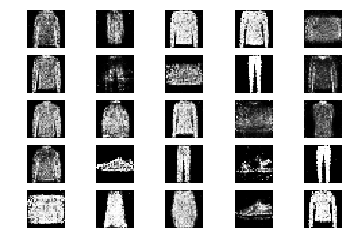

42401 [Discriminator loss: 0.592418, acc.: 68.75%] [Generator loss: 1.020684]
42402 [Discriminator loss: 0.654646, acc.: 64.06%] [Generator loss: 1.226823]
42403 [Discriminator loss: 0.709915, acc.: 53.12%] [Generator loss: 1.044970]
42404 [Discriminator loss: 0.688104, acc.: 56.25%] [Generator loss: 1.049721]
42405 [Discriminator loss: 0.607705, acc.: 68.75%] [Generator loss: 0.954457]
42406 [Discriminator loss: 0.564501, acc.: 71.88%] [Generator loss: 1.026667]
42407 [Discriminator loss: 0.614211, acc.: 62.50%] [Generator loss: 1.018696]
42408 [Discriminator loss: 0.573427, acc.: 75.00%] [Generator loss: 0.991315]
42409 [Discriminator loss: 0.546916, acc.: 68.75%] [Generator loss: 1.069078]
42410 [Discriminator loss: 0.666798, acc.: 62.50%] [Generator loss: 1.000546]
42411 [Discriminator loss: 0.549732, acc.: 78.12%] [Generator loss: 1.016717]
42412 [Discriminator loss: 0.611826, acc.: 64.06%] [Generator loss: 1.043673]
42413 [Discriminator loss: 0.600997, acc.: 65.62%] [Generator lo

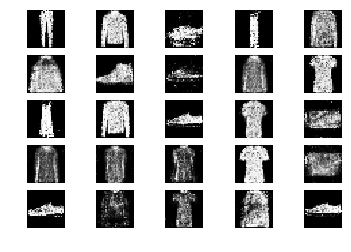

42501 [Discriminator loss: 0.643033, acc.: 59.38%] [Generator loss: 0.821911]
42502 [Discriminator loss: 0.593304, acc.: 70.31%] [Generator loss: 0.966014]
42503 [Discriminator loss: 0.608121, acc.: 64.06%] [Generator loss: 0.959183]
42504 [Discriminator loss: 0.652199, acc.: 67.19%] [Generator loss: 1.019190]
42505 [Discriminator loss: 0.631669, acc.: 68.75%] [Generator loss: 1.018851]
42506 [Discriminator loss: 0.616951, acc.: 62.50%] [Generator loss: 1.078460]
42507 [Discriminator loss: 0.639655, acc.: 68.75%] [Generator loss: 1.073389]
42508 [Discriminator loss: 0.637783, acc.: 65.62%] [Generator loss: 0.982427]
42509 [Discriminator loss: 0.780684, acc.: 53.12%] [Generator loss: 1.061810]
42510 [Discriminator loss: 0.568839, acc.: 68.75%] [Generator loss: 1.046816]
42511 [Discriminator loss: 0.668501, acc.: 53.12%] [Generator loss: 0.994833]
42512 [Discriminator loss: 0.695578, acc.: 53.12%] [Generator loss: 1.069817]
42513 [Discriminator loss: 0.653950, acc.: 64.06%] [Generator lo

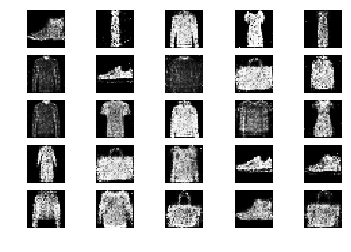

42601 [Discriminator loss: 0.619144, acc.: 60.94%] [Generator loss: 1.050983]
42602 [Discriminator loss: 0.659564, acc.: 62.50%] [Generator loss: 1.026726]
42603 [Discriminator loss: 0.627680, acc.: 62.50%] [Generator loss: 1.013789]
42604 [Discriminator loss: 0.653338, acc.: 60.94%] [Generator loss: 1.020046]
42605 [Discriminator loss: 0.616861, acc.: 54.69%] [Generator loss: 0.884866]
42606 [Discriminator loss: 0.596384, acc.: 68.75%] [Generator loss: 0.952969]
42607 [Discriminator loss: 0.605258, acc.: 60.94%] [Generator loss: 0.847512]
42608 [Discriminator loss: 0.617317, acc.: 65.62%] [Generator loss: 1.057118]
42609 [Discriminator loss: 0.559722, acc.: 73.44%] [Generator loss: 1.034623]
42610 [Discriminator loss: 0.672278, acc.: 54.69%] [Generator loss: 0.923186]
42611 [Discriminator loss: 0.602152, acc.: 65.62%] [Generator loss: 0.966589]
42612 [Discriminator loss: 0.550701, acc.: 71.88%] [Generator loss: 1.027775]
42613 [Discriminator loss: 0.625136, acc.: 70.31%] [Generator lo

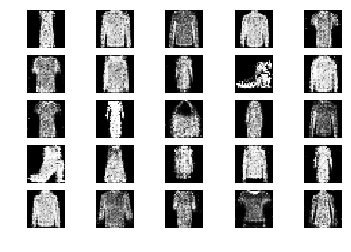

42701 [Discriminator loss: 0.639211, acc.: 57.81%] [Generator loss: 1.040529]
42702 [Discriminator loss: 0.703372, acc.: 59.38%] [Generator loss: 1.080014]
42703 [Discriminator loss: 0.713192, acc.: 51.56%] [Generator loss: 1.040811]
42704 [Discriminator loss: 0.600496, acc.: 67.19%] [Generator loss: 0.997977]
42705 [Discriminator loss: 0.564081, acc.: 73.44%] [Generator loss: 0.979993]
42706 [Discriminator loss: 0.590889, acc.: 67.19%] [Generator loss: 1.104950]
42707 [Discriminator loss: 0.645319, acc.: 65.62%] [Generator loss: 0.982752]
42708 [Discriminator loss: 0.623040, acc.: 67.19%] [Generator loss: 1.075861]
42709 [Discriminator loss: 0.618208, acc.: 65.62%] [Generator loss: 0.973360]
42710 [Discriminator loss: 0.626356, acc.: 60.94%] [Generator loss: 1.044562]
42711 [Discriminator loss: 0.587547, acc.: 70.31%] [Generator loss: 1.000439]
42712 [Discriminator loss: 0.714153, acc.: 57.81%] [Generator loss: 0.910480]
42713 [Discriminator loss: 0.596920, acc.: 65.62%] [Generator lo

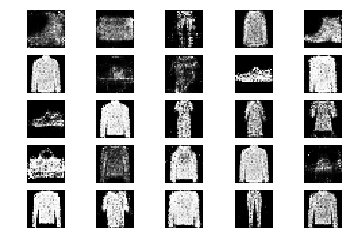

42801 [Discriminator loss: 0.674906, acc.: 57.81%] [Generator loss: 1.149084]
42802 [Discriminator loss: 0.646116, acc.: 56.25%] [Generator loss: 1.108456]
42803 [Discriminator loss: 0.606623, acc.: 65.62%] [Generator loss: 1.113268]
42804 [Discriminator loss: 0.612474, acc.: 65.62%] [Generator loss: 0.953172]
42805 [Discriminator loss: 0.565430, acc.: 71.88%] [Generator loss: 0.973061]
42806 [Discriminator loss: 0.654984, acc.: 54.69%] [Generator loss: 0.961448]
42807 [Discriminator loss: 0.584127, acc.: 67.19%] [Generator loss: 0.887148]
42808 [Discriminator loss: 0.645367, acc.: 65.62%] [Generator loss: 1.038599]
42809 [Discriminator loss: 0.524366, acc.: 78.12%] [Generator loss: 1.065435]
42810 [Discriminator loss: 0.600192, acc.: 60.94%] [Generator loss: 0.921568]
42811 [Discriminator loss: 0.684101, acc.: 60.94%] [Generator loss: 1.034613]
42812 [Discriminator loss: 0.705079, acc.: 53.12%] [Generator loss: 1.071115]
42813 [Discriminator loss: 0.600188, acc.: 68.75%] [Generator lo

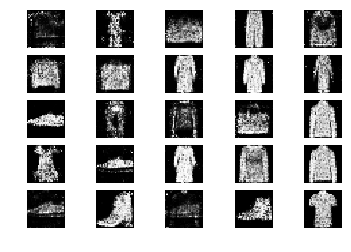

42901 [Discriminator loss: 0.597909, acc.: 67.19%] [Generator loss: 1.080726]
42902 [Discriminator loss: 0.537939, acc.: 76.56%] [Generator loss: 1.146782]
42903 [Discriminator loss: 0.688681, acc.: 62.50%] [Generator loss: 1.001877]
42904 [Discriminator loss: 0.629948, acc.: 62.50%] [Generator loss: 1.063708]
42905 [Discriminator loss: 0.612068, acc.: 64.06%] [Generator loss: 0.944086]
42906 [Discriminator loss: 0.598821, acc.: 57.81%] [Generator loss: 1.084211]
42907 [Discriminator loss: 0.594098, acc.: 65.62%] [Generator loss: 0.958917]
42908 [Discriminator loss: 0.569400, acc.: 68.75%] [Generator loss: 1.008833]
42909 [Discriminator loss: 0.642586, acc.: 59.38%] [Generator loss: 1.017363]
42910 [Discriminator loss: 0.661746, acc.: 59.38%] [Generator loss: 1.020722]
42911 [Discriminator loss: 0.621013, acc.: 60.94%] [Generator loss: 1.016419]
42912 [Discriminator loss: 0.630614, acc.: 65.62%] [Generator loss: 0.992579]
42913 [Discriminator loss: 0.644932, acc.: 64.06%] [Generator lo

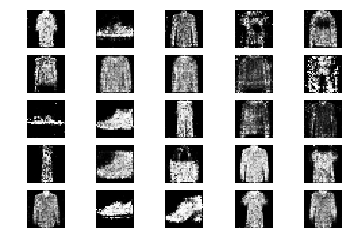

43001 [Discriminator loss: 0.612585, acc.: 64.06%] [Generator loss: 1.049917]
43002 [Discriminator loss: 0.596330, acc.: 65.62%] [Generator loss: 1.034541]
43003 [Discriminator loss: 0.582342, acc.: 70.31%] [Generator loss: 1.154650]
43004 [Discriminator loss: 0.536416, acc.: 76.56%] [Generator loss: 0.989530]
43005 [Discriminator loss: 0.615632, acc.: 65.62%] [Generator loss: 0.930736]
43006 [Discriminator loss: 0.636734, acc.: 64.06%] [Generator loss: 0.944959]
43007 [Discriminator loss: 0.685240, acc.: 59.38%] [Generator loss: 1.062529]
43008 [Discriminator loss: 0.565531, acc.: 68.75%] [Generator loss: 1.082711]
43009 [Discriminator loss: 0.557183, acc.: 71.88%] [Generator loss: 1.103601]
43010 [Discriminator loss: 0.569068, acc.: 78.12%] [Generator loss: 1.145120]
43011 [Discriminator loss: 0.589813, acc.: 71.88%] [Generator loss: 1.034280]
43012 [Discriminator loss: 0.748667, acc.: 53.12%] [Generator loss: 1.015269]
43013 [Discriminator loss: 0.636508, acc.: 62.50%] [Generator lo

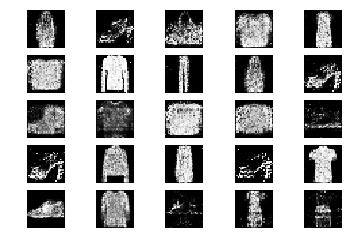

43101 [Discriminator loss: 0.666517, acc.: 59.38%] [Generator loss: 1.046876]
43102 [Discriminator loss: 0.640024, acc.: 64.06%] [Generator loss: 1.011572]
43103 [Discriminator loss: 0.757343, acc.: 51.56%] [Generator loss: 0.961419]
43104 [Discriminator loss: 0.629256, acc.: 68.75%] [Generator loss: 0.958192]
43105 [Discriminator loss: 0.625315, acc.: 62.50%] [Generator loss: 0.947924]
43106 [Discriminator loss: 0.593467, acc.: 64.06%] [Generator loss: 0.960183]
43107 [Discriminator loss: 0.521463, acc.: 75.00%] [Generator loss: 0.951528]
43108 [Discriminator loss: 0.747347, acc.: 51.56%] [Generator loss: 1.058504]
43109 [Discriminator loss: 0.588952, acc.: 73.44%] [Generator loss: 1.058466]
43110 [Discriminator loss: 0.644454, acc.: 65.62%] [Generator loss: 1.026671]
43111 [Discriminator loss: 0.605817, acc.: 64.06%] [Generator loss: 1.082431]
43112 [Discriminator loss: 0.587546, acc.: 68.75%] [Generator loss: 1.115777]
43113 [Discriminator loss: 0.694720, acc.: 56.25%] [Generator lo

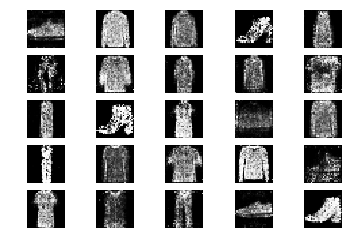

43201 [Discriminator loss: 0.632061, acc.: 65.62%] [Generator loss: 1.025204]
43202 [Discriminator loss: 0.477410, acc.: 78.12%] [Generator loss: 1.105694]
43203 [Discriminator loss: 0.578706, acc.: 70.31%] [Generator loss: 1.121666]
43204 [Discriminator loss: 0.655408, acc.: 60.94%] [Generator loss: 1.043360]
43205 [Discriminator loss: 0.731937, acc.: 54.69%] [Generator loss: 1.014268]
43206 [Discriminator loss: 0.619263, acc.: 62.50%] [Generator loss: 1.010304]
43207 [Discriminator loss: 0.676290, acc.: 60.94%] [Generator loss: 1.098197]
43208 [Discriminator loss: 0.592614, acc.: 65.62%] [Generator loss: 1.069238]
43209 [Discriminator loss: 0.670657, acc.: 53.12%] [Generator loss: 1.092960]
43210 [Discriminator loss: 0.708869, acc.: 54.69%] [Generator loss: 1.061589]
43211 [Discriminator loss: 0.578424, acc.: 67.19%] [Generator loss: 1.134314]
43212 [Discriminator loss: 0.556198, acc.: 73.44%] [Generator loss: 1.138323]
43213 [Discriminator loss: 0.685933, acc.: 56.25%] [Generator lo

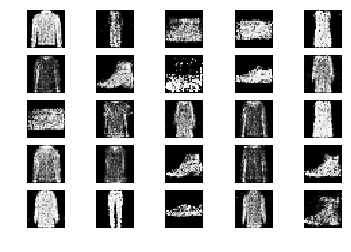

43301 [Discriminator loss: 0.566038, acc.: 73.44%] [Generator loss: 0.921597]
43302 [Discriminator loss: 0.628776, acc.: 68.75%] [Generator loss: 1.013410]
43303 [Discriminator loss: 0.552743, acc.: 70.31%] [Generator loss: 1.141346]
43304 [Discriminator loss: 0.640943, acc.: 62.50%] [Generator loss: 1.184311]
43305 [Discriminator loss: 0.553637, acc.: 67.19%] [Generator loss: 1.217237]
43306 [Discriminator loss: 0.613882, acc.: 62.50%] [Generator loss: 0.968343]
43307 [Discriminator loss: 0.501492, acc.: 70.31%] [Generator loss: 1.144422]
43308 [Discriminator loss: 0.674045, acc.: 54.69%] [Generator loss: 0.993951]
43309 [Discriminator loss: 0.675456, acc.: 60.94%] [Generator loss: 1.047431]
43310 [Discriminator loss: 0.688619, acc.: 62.50%] [Generator loss: 1.016048]
43311 [Discriminator loss: 0.610276, acc.: 65.62%] [Generator loss: 1.054120]
43312 [Discriminator loss: 0.629241, acc.: 59.38%] [Generator loss: 1.121384]
43313 [Discriminator loss: 0.547294, acc.: 71.88%] [Generator lo

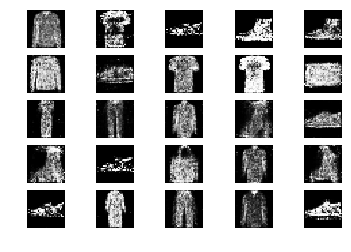

43401 [Discriminator loss: 0.603655, acc.: 65.62%] [Generator loss: 1.196393]
43402 [Discriminator loss: 0.717304, acc.: 53.12%] [Generator loss: 1.169161]
43403 [Discriminator loss: 0.722267, acc.: 57.81%] [Generator loss: 1.006138]
43404 [Discriminator loss: 0.651303, acc.: 59.38%] [Generator loss: 1.056812]
43405 [Discriminator loss: 0.623812, acc.: 62.50%] [Generator loss: 1.106784]
43406 [Discriminator loss: 0.603839, acc.: 65.62%] [Generator loss: 1.209262]
43407 [Discriminator loss: 0.562064, acc.: 68.75%] [Generator loss: 1.031665]
43408 [Discriminator loss: 0.544335, acc.: 76.56%] [Generator loss: 0.984085]
43409 [Discriminator loss: 0.503825, acc.: 79.69%] [Generator loss: 1.087836]
43410 [Discriminator loss: 0.596323, acc.: 67.19%] [Generator loss: 1.180122]
43411 [Discriminator loss: 0.642990, acc.: 64.06%] [Generator loss: 1.161407]
43412 [Discriminator loss: 0.573649, acc.: 73.44%] [Generator loss: 1.132674]
43413 [Discriminator loss: 0.565782, acc.: 65.62%] [Generator lo

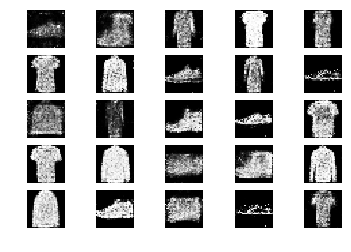

43501 [Discriminator loss: 0.635074, acc.: 62.50%] [Generator loss: 1.032530]
43502 [Discriminator loss: 0.543966, acc.: 75.00%] [Generator loss: 0.992100]
43503 [Discriminator loss: 0.655596, acc.: 62.50%] [Generator loss: 1.086239]
43504 [Discriminator loss: 0.609703, acc.: 70.31%] [Generator loss: 0.962357]
43505 [Discriminator loss: 0.724841, acc.: 59.38%] [Generator loss: 1.031086]
43506 [Discriminator loss: 0.596937, acc.: 64.06%] [Generator loss: 1.098184]
43507 [Discriminator loss: 0.568099, acc.: 71.88%] [Generator loss: 1.130365]
43508 [Discriminator loss: 0.639294, acc.: 53.12%] [Generator loss: 1.087627]
43509 [Discriminator loss: 0.612574, acc.: 64.06%] [Generator loss: 1.123476]
43510 [Discriminator loss: 0.594002, acc.: 60.94%] [Generator loss: 1.150438]
43511 [Discriminator loss: 0.631456, acc.: 62.50%] [Generator loss: 1.053758]
43512 [Discriminator loss: 0.589801, acc.: 71.88%] [Generator loss: 0.944485]
43513 [Discriminator loss: 0.637794, acc.: 60.94%] [Generator lo

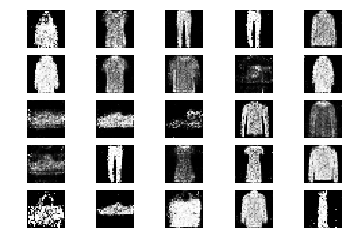

43601 [Discriminator loss: 0.631978, acc.: 62.50%] [Generator loss: 1.056681]
43602 [Discriminator loss: 0.606036, acc.: 71.88%] [Generator loss: 0.983129]
43603 [Discriminator loss: 0.712977, acc.: 51.56%] [Generator loss: 1.062791]
43604 [Discriminator loss: 0.579366, acc.: 65.62%] [Generator loss: 1.108477]
43605 [Discriminator loss: 0.681944, acc.: 64.06%] [Generator loss: 0.990889]
43606 [Discriminator loss: 0.574676, acc.: 64.06%] [Generator loss: 0.952696]
43607 [Discriminator loss: 0.577908, acc.: 68.75%] [Generator loss: 1.079831]
43608 [Discriminator loss: 0.596225, acc.: 71.88%] [Generator loss: 1.171061]
43609 [Discriminator loss: 0.715012, acc.: 62.50%] [Generator loss: 1.162038]
43610 [Discriminator loss: 0.566486, acc.: 65.62%] [Generator loss: 0.970639]
43611 [Discriminator loss: 0.553361, acc.: 76.56%] [Generator loss: 0.993948]
43612 [Discriminator loss: 0.703113, acc.: 54.69%] [Generator loss: 1.014974]
43613 [Discriminator loss: 0.578072, acc.: 75.00%] [Generator lo

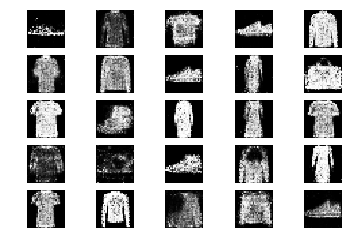

43701 [Discriminator loss: 0.710425, acc.: 53.12%] [Generator loss: 0.866527]
43702 [Discriminator loss: 0.625368, acc.: 64.06%] [Generator loss: 0.927902]
43703 [Discriminator loss: 0.672617, acc.: 60.94%] [Generator loss: 0.959665]
43704 [Discriminator loss: 0.629843, acc.: 59.38%] [Generator loss: 0.915787]
43705 [Discriminator loss: 0.664370, acc.: 56.25%] [Generator loss: 0.968862]
43706 [Discriminator loss: 0.652436, acc.: 60.94%] [Generator loss: 0.994183]
43707 [Discriminator loss: 0.573445, acc.: 70.31%] [Generator loss: 1.024615]
43708 [Discriminator loss: 0.639779, acc.: 65.62%] [Generator loss: 1.050395]
43709 [Discriminator loss: 0.662835, acc.: 60.94%] [Generator loss: 0.990043]
43710 [Discriminator loss: 0.646049, acc.: 64.06%] [Generator loss: 0.977942]
43711 [Discriminator loss: 0.540816, acc.: 73.44%] [Generator loss: 1.047401]
43712 [Discriminator loss: 0.546681, acc.: 71.88%] [Generator loss: 1.046711]
43713 [Discriminator loss: 0.637030, acc.: 67.19%] [Generator lo

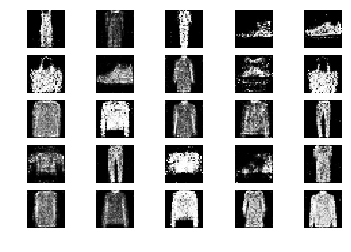

43801 [Discriminator loss: 0.711813, acc.: 50.00%] [Generator loss: 1.014590]
43802 [Discriminator loss: 0.588650, acc.: 68.75%] [Generator loss: 1.060213]
43803 [Discriminator loss: 0.620549, acc.: 64.06%] [Generator loss: 1.004946]
43804 [Discriminator loss: 0.559068, acc.: 70.31%] [Generator loss: 0.947988]
43805 [Discriminator loss: 0.697915, acc.: 64.06%] [Generator loss: 1.220384]
43806 [Discriminator loss: 0.665366, acc.: 60.94%] [Generator loss: 1.063190]
43807 [Discriminator loss: 0.609638, acc.: 65.62%] [Generator loss: 1.064727]
43808 [Discriminator loss: 0.667267, acc.: 57.81%] [Generator loss: 1.036848]
43809 [Discriminator loss: 0.591902, acc.: 76.56%] [Generator loss: 1.100375]
43810 [Discriminator loss: 0.596782, acc.: 62.50%] [Generator loss: 1.044039]
43811 [Discriminator loss: 0.559290, acc.: 67.19%] [Generator loss: 0.981492]
43812 [Discriminator loss: 0.648674, acc.: 67.19%] [Generator loss: 1.016644]
43813 [Discriminator loss: 0.675247, acc.: 60.94%] [Generator lo

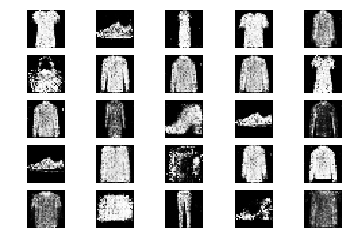

43901 [Discriminator loss: 0.568863, acc.: 70.31%] [Generator loss: 1.006672]
43902 [Discriminator loss: 0.677295, acc.: 57.81%] [Generator loss: 0.951082]
43903 [Discriminator loss: 0.642651, acc.: 59.38%] [Generator loss: 0.908779]
43904 [Discriminator loss: 0.545315, acc.: 71.88%] [Generator loss: 0.983077]
43905 [Discriminator loss: 0.658010, acc.: 60.94%] [Generator loss: 0.888953]
43906 [Discriminator loss: 0.657466, acc.: 62.50%] [Generator loss: 0.949760]
43907 [Discriminator loss: 0.595181, acc.: 68.75%] [Generator loss: 1.029539]
43908 [Discriminator loss: 0.569535, acc.: 70.31%] [Generator loss: 0.929886]
43909 [Discriminator loss: 0.603199, acc.: 70.31%] [Generator loss: 1.039543]
43910 [Discriminator loss: 0.628488, acc.: 64.06%] [Generator loss: 0.995451]
43911 [Discriminator loss: 0.550088, acc.: 70.31%] [Generator loss: 0.985623]
43912 [Discriminator loss: 0.697648, acc.: 48.44%] [Generator loss: 0.984203]
43913 [Discriminator loss: 0.636690, acc.: 59.38%] [Generator lo

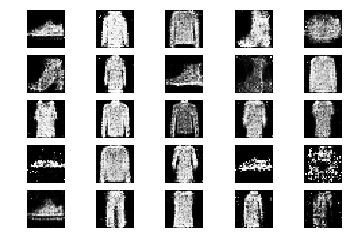

44001 [Discriminator loss: 0.592031, acc.: 67.19%] [Generator loss: 0.935261]
44002 [Discriminator loss: 0.639971, acc.: 64.06%] [Generator loss: 0.952218]
44003 [Discriminator loss: 0.639066, acc.: 62.50%] [Generator loss: 0.899953]
44004 [Discriminator loss: 0.676173, acc.: 57.81%] [Generator loss: 0.958571]
44005 [Discriminator loss: 0.592223, acc.: 65.62%] [Generator loss: 0.940086]
44006 [Discriminator loss: 0.566806, acc.: 70.31%] [Generator loss: 0.836066]
44007 [Discriminator loss: 0.641413, acc.: 57.81%] [Generator loss: 0.843924]
44008 [Discriminator loss: 0.607610, acc.: 65.62%] [Generator loss: 0.895252]
44009 [Discriminator loss: 0.593558, acc.: 68.75%] [Generator loss: 1.056034]
44010 [Discriminator loss: 0.591886, acc.: 62.50%] [Generator loss: 1.173666]
44011 [Discriminator loss: 0.572288, acc.: 68.75%] [Generator loss: 1.033825]
44012 [Discriminator loss: 0.745631, acc.: 51.56%] [Generator loss: 0.996535]
44013 [Discriminator loss: 0.607117, acc.: 59.38%] [Generator lo

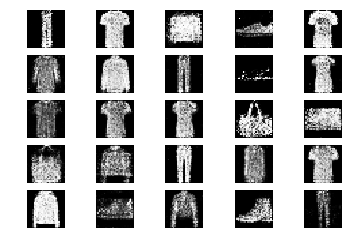

44101 [Discriminator loss: 0.618029, acc.: 67.19%] [Generator loss: 1.052904]
44102 [Discriminator loss: 0.665673, acc.: 56.25%] [Generator loss: 1.123273]
44103 [Discriminator loss: 0.557309, acc.: 68.75%] [Generator loss: 1.178338]
44104 [Discriminator loss: 0.622281, acc.: 57.81%] [Generator loss: 1.069904]
44105 [Discriminator loss: 0.537238, acc.: 75.00%] [Generator loss: 1.016523]
44106 [Discriminator loss: 0.606155, acc.: 64.06%] [Generator loss: 1.028946]
44107 [Discriminator loss: 0.651749, acc.: 62.50%] [Generator loss: 1.062536]
44108 [Discriminator loss: 0.630846, acc.: 59.38%] [Generator loss: 1.102558]
44109 [Discriminator loss: 0.663116, acc.: 56.25%] [Generator loss: 1.031513]
44110 [Discriminator loss: 0.532270, acc.: 78.12%] [Generator loss: 1.148886]
44111 [Discriminator loss: 0.604575, acc.: 73.44%] [Generator loss: 0.972892]
44112 [Discriminator loss: 0.609362, acc.: 67.19%] [Generator loss: 1.005437]
44113 [Discriminator loss: 0.603184, acc.: 67.19%] [Generator lo

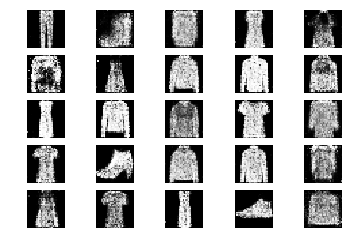

44201 [Discriminator loss: 0.491821, acc.: 79.69%] [Generator loss: 1.039011]
44202 [Discriminator loss: 0.664136, acc.: 60.94%] [Generator loss: 1.164012]
44203 [Discriminator loss: 0.612911, acc.: 65.62%] [Generator loss: 1.017763]
44204 [Discriminator loss: 0.581319, acc.: 75.00%] [Generator loss: 0.924935]
44205 [Discriminator loss: 0.767466, acc.: 51.56%] [Generator loss: 0.868905]
44206 [Discriminator loss: 0.550323, acc.: 73.44%] [Generator loss: 0.961391]
44207 [Discriminator loss: 0.619745, acc.: 60.94%] [Generator loss: 0.970620]
44208 [Discriminator loss: 0.632676, acc.: 67.19%] [Generator loss: 0.993860]
44209 [Discriminator loss: 0.628012, acc.: 64.06%] [Generator loss: 1.001304]
44210 [Discriminator loss: 0.635137, acc.: 56.25%] [Generator loss: 0.881622]
44211 [Discriminator loss: 0.618242, acc.: 71.88%] [Generator loss: 1.144188]
44212 [Discriminator loss: 0.606932, acc.: 70.31%] [Generator loss: 0.970438]
44213 [Discriminator loss: 0.593232, acc.: 65.62%] [Generator lo

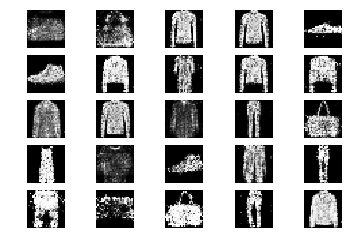

44301 [Discriminator loss: 0.628078, acc.: 65.62%] [Generator loss: 1.002774]
44302 [Discriminator loss: 0.639263, acc.: 68.75%] [Generator loss: 1.102247]
44303 [Discriminator loss: 0.574788, acc.: 75.00%] [Generator loss: 1.038601]
44304 [Discriminator loss: 0.571210, acc.: 75.00%] [Generator loss: 0.961813]
44305 [Discriminator loss: 0.574887, acc.: 68.75%] [Generator loss: 1.075840]
44306 [Discriminator loss: 0.615075, acc.: 64.06%] [Generator loss: 1.130602]
44307 [Discriminator loss: 0.667548, acc.: 59.38%] [Generator loss: 1.030666]
44308 [Discriminator loss: 0.681697, acc.: 53.12%] [Generator loss: 0.962349]
44309 [Discriminator loss: 0.643896, acc.: 67.19%] [Generator loss: 0.897156]
44310 [Discriminator loss: 0.607619, acc.: 68.75%] [Generator loss: 0.972941]
44311 [Discriminator loss: 0.556149, acc.: 73.44%] [Generator loss: 0.890929]
44312 [Discriminator loss: 0.673000, acc.: 57.81%] [Generator loss: 0.975573]
44313 [Discriminator loss: 0.557336, acc.: 75.00%] [Generator lo

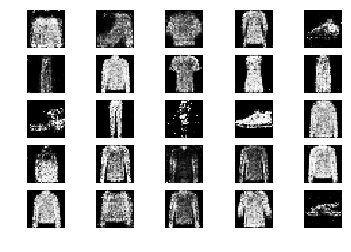

44401 [Discriminator loss: 0.662526, acc.: 53.12%] [Generator loss: 1.040586]
44402 [Discriminator loss: 0.603121, acc.: 70.31%] [Generator loss: 1.150661]
44403 [Discriminator loss: 0.599365, acc.: 64.06%] [Generator loss: 0.955419]
44404 [Discriminator loss: 0.633508, acc.: 62.50%] [Generator loss: 0.962041]
44405 [Discriminator loss: 0.626230, acc.: 67.19%] [Generator loss: 1.004370]
44406 [Discriminator loss: 0.595149, acc.: 60.94%] [Generator loss: 0.978773]
44407 [Discriminator loss: 0.613341, acc.: 71.88%] [Generator loss: 1.041018]
44408 [Discriminator loss: 0.591675, acc.: 73.44%] [Generator loss: 1.039025]
44409 [Discriminator loss: 0.570000, acc.: 67.19%] [Generator loss: 1.154478]
44410 [Discriminator loss: 0.691618, acc.: 54.69%] [Generator loss: 1.065801]
44411 [Discriminator loss: 0.604990, acc.: 65.62%] [Generator loss: 0.989421]
44412 [Discriminator loss: 0.618119, acc.: 67.19%] [Generator loss: 0.940054]
44413 [Discriminator loss: 0.643536, acc.: 70.31%] [Generator lo

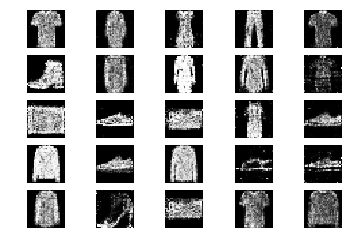

44501 [Discriminator loss: 0.571402, acc.: 68.75%] [Generator loss: 0.906051]
44502 [Discriminator loss: 0.684325, acc.: 59.38%] [Generator loss: 0.942978]
44503 [Discriminator loss: 0.671690, acc.: 57.81%] [Generator loss: 0.970031]
44504 [Discriminator loss: 0.688012, acc.: 56.25%] [Generator loss: 0.978468]
44505 [Discriminator loss: 0.554322, acc.: 78.12%] [Generator loss: 1.023117]
44506 [Discriminator loss: 0.707920, acc.: 54.69%] [Generator loss: 1.011225]
44507 [Discriminator loss: 0.642770, acc.: 60.94%] [Generator loss: 1.010974]
44508 [Discriminator loss: 0.657194, acc.: 67.19%] [Generator loss: 1.036697]
44509 [Discriminator loss: 0.675216, acc.: 59.38%] [Generator loss: 0.972631]
44510 [Discriminator loss: 0.616649, acc.: 70.31%] [Generator loss: 0.976875]
44511 [Discriminator loss: 0.677134, acc.: 59.38%] [Generator loss: 0.938402]
44512 [Discriminator loss: 0.543476, acc.: 67.19%] [Generator loss: 0.915856]
44513 [Discriminator loss: 0.576210, acc.: 70.31%] [Generator lo

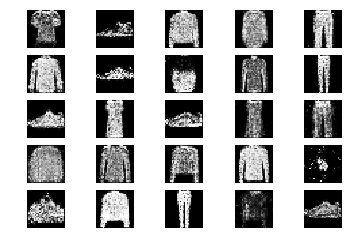

44601 [Discriminator loss: 0.602129, acc.: 65.62%] [Generator loss: 1.044316]
44602 [Discriminator loss: 0.664466, acc.: 60.94%] [Generator loss: 1.129695]
44603 [Discriminator loss: 0.707153, acc.: 53.12%] [Generator loss: 0.987956]
44604 [Discriminator loss: 0.665147, acc.: 62.50%] [Generator loss: 1.161433]
44605 [Discriminator loss: 0.535856, acc.: 75.00%] [Generator loss: 1.023256]
44606 [Discriminator loss: 0.661840, acc.: 60.94%] [Generator loss: 0.866838]
44607 [Discriminator loss: 0.565837, acc.: 71.88%] [Generator loss: 0.841853]
44608 [Discriminator loss: 0.545582, acc.: 75.00%] [Generator loss: 1.005088]
44609 [Discriminator loss: 0.514528, acc.: 70.31%] [Generator loss: 1.033408]
44610 [Discriminator loss: 0.738178, acc.: 53.12%] [Generator loss: 1.026053]
44611 [Discriminator loss: 0.713639, acc.: 53.12%] [Generator loss: 0.972096]
44612 [Discriminator loss: 0.592083, acc.: 65.62%] [Generator loss: 1.046974]
44613 [Discriminator loss: 0.608699, acc.: 65.62%] [Generator lo

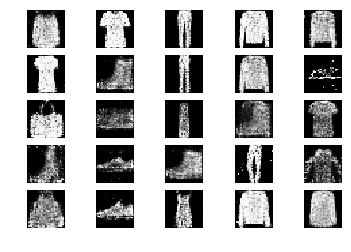

44701 [Discriminator loss: 0.623418, acc.: 68.75%] [Generator loss: 1.034535]
44702 [Discriminator loss: 0.676397, acc.: 56.25%] [Generator loss: 1.018803]
44703 [Discriminator loss: 0.611388, acc.: 70.31%] [Generator loss: 0.979929]
44704 [Discriminator loss: 0.607187, acc.: 65.62%] [Generator loss: 1.085463]
44705 [Discriminator loss: 0.640293, acc.: 64.06%] [Generator loss: 1.035544]
44706 [Discriminator loss: 0.685706, acc.: 59.38%] [Generator loss: 1.104192]
44707 [Discriminator loss: 0.642751, acc.: 62.50%] [Generator loss: 1.004357]
44708 [Discriminator loss: 0.701924, acc.: 53.12%] [Generator loss: 0.995910]
44709 [Discriminator loss: 0.554831, acc.: 73.44%] [Generator loss: 1.103593]
44710 [Discriminator loss: 0.680735, acc.: 56.25%] [Generator loss: 1.090785]
44711 [Discriminator loss: 0.554032, acc.: 73.44%] [Generator loss: 1.164972]
44712 [Discriminator loss: 0.577026, acc.: 67.19%] [Generator loss: 1.073685]
44713 [Discriminator loss: 0.738905, acc.: 50.00%] [Generator lo

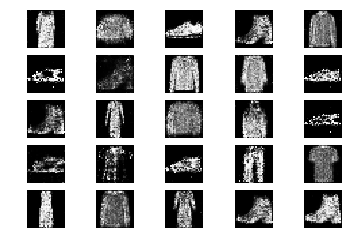

44801 [Discriminator loss: 0.650581, acc.: 59.38%] [Generator loss: 1.043364]
44802 [Discriminator loss: 0.563076, acc.: 65.62%] [Generator loss: 0.951144]
44803 [Discriminator loss: 0.597504, acc.: 62.50%] [Generator loss: 1.065216]
44804 [Discriminator loss: 0.649373, acc.: 62.50%] [Generator loss: 1.138252]
44805 [Discriminator loss: 0.544231, acc.: 75.00%] [Generator loss: 1.120569]
44806 [Discriminator loss: 0.605896, acc.: 68.75%] [Generator loss: 0.991483]
44807 [Discriminator loss: 0.531063, acc.: 67.19%] [Generator loss: 1.016732]
44808 [Discriminator loss: 0.676993, acc.: 64.06%] [Generator loss: 0.851550]
44809 [Discriminator loss: 0.560248, acc.: 73.44%] [Generator loss: 1.056439]
44810 [Discriminator loss: 0.668918, acc.: 67.19%] [Generator loss: 1.162839]
44811 [Discriminator loss: 0.631132, acc.: 62.50%] [Generator loss: 1.114180]
44812 [Discriminator loss: 0.595595, acc.: 62.50%] [Generator loss: 1.086330]
44813 [Discriminator loss: 0.700639, acc.: 51.56%] [Generator lo

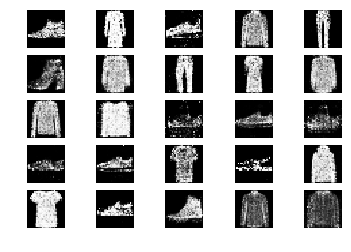

44901 [Discriminator loss: 0.646013, acc.: 65.62%] [Generator loss: 1.044923]
44902 [Discriminator loss: 0.679567, acc.: 54.69%] [Generator loss: 1.198958]
44903 [Discriminator loss: 0.630099, acc.: 64.06%] [Generator loss: 1.030545]
44904 [Discriminator loss: 0.607345, acc.: 70.31%] [Generator loss: 1.079698]
44905 [Discriminator loss: 0.663043, acc.: 65.62%] [Generator loss: 0.963089]
44906 [Discriminator loss: 0.594476, acc.: 67.19%] [Generator loss: 0.972409]
44907 [Discriminator loss: 0.606891, acc.: 68.75%] [Generator loss: 1.078707]
44908 [Discriminator loss: 0.565769, acc.: 73.44%] [Generator loss: 1.125913]
44909 [Discriminator loss: 0.719894, acc.: 54.69%] [Generator loss: 1.031207]
44910 [Discriminator loss: 0.585243, acc.: 71.88%] [Generator loss: 1.044855]
44911 [Discriminator loss: 0.521185, acc.: 73.44%] [Generator loss: 1.058823]
44912 [Discriminator loss: 0.569968, acc.: 68.75%] [Generator loss: 1.043585]
44913 [Discriminator loss: 0.598328, acc.: 75.00%] [Generator lo

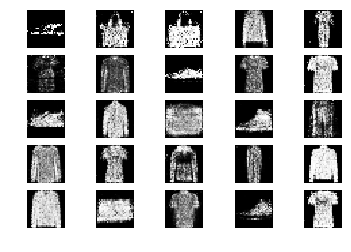

45001 [Discriminator loss: 0.582225, acc.: 73.44%] [Generator loss: 1.074451]
45002 [Discriminator loss: 0.632157, acc.: 60.94%] [Generator loss: 1.066313]
45003 [Discriminator loss: 0.687323, acc.: 56.25%] [Generator loss: 1.064626]
45004 [Discriminator loss: 0.597401, acc.: 71.88%] [Generator loss: 1.057147]
45005 [Discriminator loss: 0.598338, acc.: 75.00%] [Generator loss: 1.004551]
45006 [Discriminator loss: 0.610560, acc.: 73.44%] [Generator loss: 1.108018]
45007 [Discriminator loss: 0.680435, acc.: 65.62%] [Generator loss: 0.980105]
45008 [Discriminator loss: 0.641434, acc.: 71.88%] [Generator loss: 1.106817]
45009 [Discriminator loss: 0.595515, acc.: 73.44%] [Generator loss: 1.140322]
45010 [Discriminator loss: 0.648394, acc.: 64.06%] [Generator loss: 1.138001]
45011 [Discriminator loss: 0.579888, acc.: 68.75%] [Generator loss: 1.102813]
45012 [Discriminator loss: 0.604704, acc.: 67.19%] [Generator loss: 1.120881]
45013 [Discriminator loss: 0.614697, acc.: 67.19%] [Generator lo

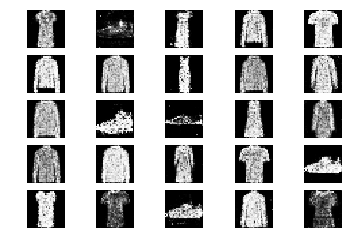

45101 [Discriminator loss: 0.604146, acc.: 62.50%] [Generator loss: 0.961473]
45102 [Discriminator loss: 0.630773, acc.: 67.19%] [Generator loss: 1.016217]
45103 [Discriminator loss: 0.634885, acc.: 64.06%] [Generator loss: 1.080919]
45104 [Discriminator loss: 0.556057, acc.: 67.19%] [Generator loss: 0.945986]
45105 [Discriminator loss: 0.615075, acc.: 64.06%] [Generator loss: 0.994669]
45106 [Discriminator loss: 0.701380, acc.: 64.06%] [Generator loss: 1.018878]
45107 [Discriminator loss: 0.650612, acc.: 60.94%] [Generator loss: 1.111506]
45108 [Discriminator loss: 0.707086, acc.: 56.25%] [Generator loss: 1.054577]
45109 [Discriminator loss: 0.702643, acc.: 56.25%] [Generator loss: 1.018557]
45110 [Discriminator loss: 0.535782, acc.: 73.44%] [Generator loss: 0.919945]
45111 [Discriminator loss: 0.592374, acc.: 68.75%] [Generator loss: 0.960963]
45112 [Discriminator loss: 0.681626, acc.: 60.94%] [Generator loss: 1.053574]
45113 [Discriminator loss: 0.557525, acc.: 68.75%] [Generator lo

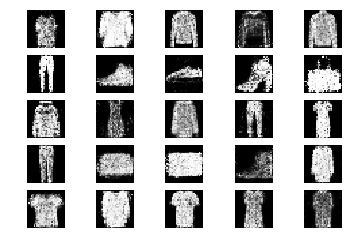

45201 [Discriminator loss: 0.634437, acc.: 59.38%] [Generator loss: 0.954015]
45202 [Discriminator loss: 0.641066, acc.: 57.81%] [Generator loss: 1.063510]
45203 [Discriminator loss: 0.593672, acc.: 60.94%] [Generator loss: 1.072314]
45204 [Discriminator loss: 0.547940, acc.: 76.56%] [Generator loss: 1.037658]
45205 [Discriminator loss: 0.685161, acc.: 59.38%] [Generator loss: 1.028496]
45206 [Discriminator loss: 0.533510, acc.: 75.00%] [Generator loss: 0.926826]
45207 [Discriminator loss: 0.637470, acc.: 64.06%] [Generator loss: 1.034965]
45208 [Discriminator loss: 0.702629, acc.: 54.69%] [Generator loss: 0.979636]
45209 [Discriminator loss: 0.541830, acc.: 73.44%] [Generator loss: 0.995043]
45210 [Discriminator loss: 0.588812, acc.: 64.06%] [Generator loss: 1.042132]
45211 [Discriminator loss: 0.585302, acc.: 75.00%] [Generator loss: 1.059428]
45212 [Discriminator loss: 0.618147, acc.: 60.94%] [Generator loss: 1.064476]
45213 [Discriminator loss: 0.599076, acc.: 65.62%] [Generator lo

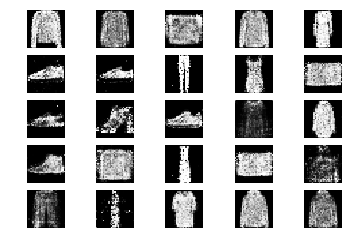

45301 [Discriminator loss: 0.582669, acc.: 75.00%] [Generator loss: 0.991794]
45302 [Discriminator loss: 0.547292, acc.: 65.62%] [Generator loss: 0.998855]
45303 [Discriminator loss: 0.529235, acc.: 75.00%] [Generator loss: 0.946337]
45304 [Discriminator loss: 0.645895, acc.: 65.62%] [Generator loss: 1.117795]
45305 [Discriminator loss: 0.604533, acc.: 65.62%] [Generator loss: 0.931322]
45306 [Discriminator loss: 0.575737, acc.: 68.75%] [Generator loss: 1.105197]
45307 [Discriminator loss: 0.553212, acc.: 68.75%] [Generator loss: 1.129710]
45308 [Discriminator loss: 0.733299, acc.: 56.25%] [Generator loss: 1.077168]
45309 [Discriminator loss: 0.574632, acc.: 68.75%] [Generator loss: 1.085318]
45310 [Discriminator loss: 0.625078, acc.: 65.62%] [Generator loss: 1.082937]
45311 [Discriminator loss: 0.621928, acc.: 70.31%] [Generator loss: 1.051213]
45312 [Discriminator loss: 0.611861, acc.: 65.62%] [Generator loss: 0.999670]
45313 [Discriminator loss: 0.656301, acc.: 59.38%] [Generator lo

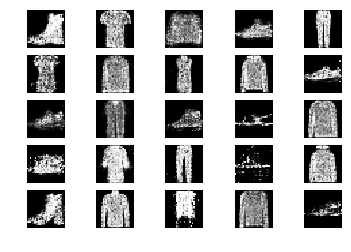

45401 [Discriminator loss: 0.651097, acc.: 54.69%] [Generator loss: 1.047435]
45402 [Discriminator loss: 0.649117, acc.: 67.19%] [Generator loss: 1.038089]
45403 [Discriminator loss: 0.628140, acc.: 59.38%] [Generator loss: 1.036593]
45404 [Discriminator loss: 0.625473, acc.: 60.94%] [Generator loss: 0.991975]
45405 [Discriminator loss: 0.585586, acc.: 73.44%] [Generator loss: 1.010221]
45406 [Discriminator loss: 0.534924, acc.: 78.12%] [Generator loss: 1.029694]
45407 [Discriminator loss: 0.619725, acc.: 64.06%] [Generator loss: 1.094093]
45408 [Discriminator loss: 0.685061, acc.: 54.69%] [Generator loss: 0.908516]
45409 [Discriminator loss: 0.652048, acc.: 64.06%] [Generator loss: 0.992739]
45410 [Discriminator loss: 0.553953, acc.: 71.88%] [Generator loss: 1.006450]
45411 [Discriminator loss: 0.659708, acc.: 57.81%] [Generator loss: 1.076446]
45412 [Discriminator loss: 0.708151, acc.: 51.56%] [Generator loss: 1.033686]
45413 [Discriminator loss: 0.631330, acc.: 56.25%] [Generator lo

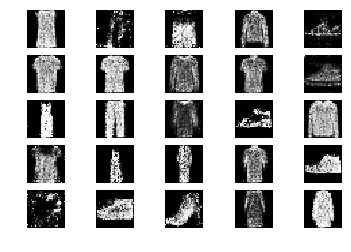

45501 [Discriminator loss: 0.592609, acc.: 65.62%] [Generator loss: 0.989731]
45502 [Discriminator loss: 0.651221, acc.: 56.25%] [Generator loss: 1.130649]
45503 [Discriminator loss: 0.687338, acc.: 54.69%] [Generator loss: 1.119261]
45504 [Discriminator loss: 0.622104, acc.: 62.50%] [Generator loss: 1.096317]
45505 [Discriminator loss: 0.598847, acc.: 70.31%] [Generator loss: 1.093293]
45506 [Discriminator loss: 0.646368, acc.: 62.50%] [Generator loss: 1.064522]
45507 [Discriminator loss: 0.555085, acc.: 76.56%] [Generator loss: 1.059008]
45508 [Discriminator loss: 0.542103, acc.: 71.88%] [Generator loss: 1.098473]
45509 [Discriminator loss: 0.552667, acc.: 71.88%] [Generator loss: 1.060888]
45510 [Discriminator loss: 0.577374, acc.: 67.19%] [Generator loss: 1.164056]
45511 [Discriminator loss: 0.788954, acc.: 46.88%] [Generator loss: 1.163659]
45512 [Discriminator loss: 0.640179, acc.: 67.19%] [Generator loss: 1.111466]
45513 [Discriminator loss: 0.635506, acc.: 60.94%] [Generator lo

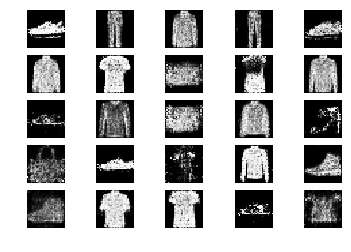

45601 [Discriminator loss: 0.564637, acc.: 75.00%] [Generator loss: 1.121578]
45602 [Discriminator loss: 0.664118, acc.: 62.50%] [Generator loss: 1.056931]
45603 [Discriminator loss: 0.646189, acc.: 60.94%] [Generator loss: 1.165381]
45604 [Discriminator loss: 0.615374, acc.: 62.50%] [Generator loss: 1.017932]
45605 [Discriminator loss: 0.718196, acc.: 59.38%] [Generator loss: 1.000144]
45606 [Discriminator loss: 0.582778, acc.: 70.31%] [Generator loss: 1.117169]
45607 [Discriminator loss: 0.615012, acc.: 65.62%] [Generator loss: 0.969601]
45608 [Discriminator loss: 0.703665, acc.: 56.25%] [Generator loss: 1.065256]
45609 [Discriminator loss: 0.532644, acc.: 71.88%] [Generator loss: 1.213069]
45610 [Discriminator loss: 0.613766, acc.: 67.19%] [Generator loss: 1.126100]
45611 [Discriminator loss: 0.607121, acc.: 64.06%] [Generator loss: 1.212708]
45612 [Discriminator loss: 0.686473, acc.: 56.25%] [Generator loss: 1.204171]
45613 [Discriminator loss: 0.651511, acc.: 60.94%] [Generator lo

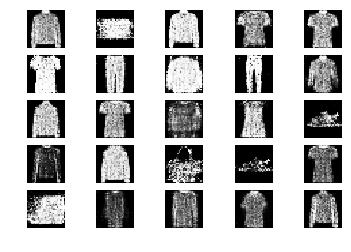

45701 [Discriminator loss: 0.668080, acc.: 54.69%] [Generator loss: 1.025641]
45702 [Discriminator loss: 0.576618, acc.: 67.19%] [Generator loss: 0.970366]
45703 [Discriminator loss: 0.525902, acc.: 78.12%] [Generator loss: 1.056622]
45704 [Discriminator loss: 0.663844, acc.: 56.25%] [Generator loss: 1.087541]
45705 [Discriminator loss: 0.564288, acc.: 70.31%] [Generator loss: 1.066992]
45706 [Discriminator loss: 0.616371, acc.: 60.94%] [Generator loss: 1.009606]
45707 [Discriminator loss: 0.588552, acc.: 65.62%] [Generator loss: 1.070286]
45708 [Discriminator loss: 0.598273, acc.: 65.62%] [Generator loss: 0.997184]
45709 [Discriminator loss: 0.597776, acc.: 76.56%] [Generator loss: 0.990183]
45710 [Discriminator loss: 0.656828, acc.: 60.94%] [Generator loss: 1.020692]
45711 [Discriminator loss: 0.540737, acc.: 71.88%] [Generator loss: 1.143049]
45712 [Discriminator loss: 0.635421, acc.: 62.50%] [Generator loss: 1.018230]
45713 [Discriminator loss: 0.658951, acc.: 51.56%] [Generator lo

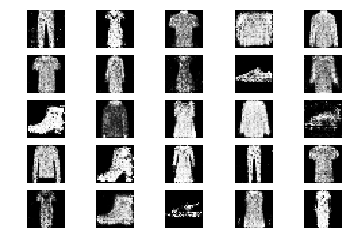

45801 [Discriminator loss: 0.643507, acc.: 62.50%] [Generator loss: 1.034672]
45802 [Discriminator loss: 0.620405, acc.: 60.94%] [Generator loss: 0.985663]
45803 [Discriminator loss: 0.592259, acc.: 67.19%] [Generator loss: 0.926947]
45804 [Discriminator loss: 0.570822, acc.: 73.44%] [Generator loss: 0.869415]
45805 [Discriminator loss: 0.698271, acc.: 57.81%] [Generator loss: 0.948427]
45806 [Discriminator loss: 0.544348, acc.: 75.00%] [Generator loss: 0.986849]
45807 [Discriminator loss: 0.595071, acc.: 68.75%] [Generator loss: 1.026580]
45808 [Discriminator loss: 0.601379, acc.: 60.94%] [Generator loss: 0.975331]
45809 [Discriminator loss: 0.672643, acc.: 59.38%] [Generator loss: 0.986119]
45810 [Discriminator loss: 0.632266, acc.: 65.62%] [Generator loss: 1.111134]
45811 [Discriminator loss: 0.597912, acc.: 65.62%] [Generator loss: 1.087612]
45812 [Discriminator loss: 0.589384, acc.: 70.31%] [Generator loss: 1.056071]
45813 [Discriminator loss: 0.606408, acc.: 70.31%] [Generator lo

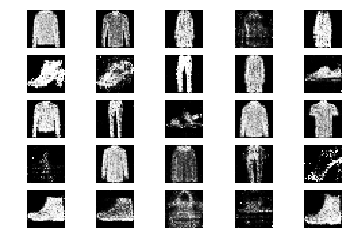

45901 [Discriminator loss: 0.711661, acc.: 53.12%] [Generator loss: 1.037445]
45902 [Discriminator loss: 0.619480, acc.: 60.94%] [Generator loss: 1.025405]
45903 [Discriminator loss: 0.667341, acc.: 54.69%] [Generator loss: 1.087880]
45904 [Discriminator loss: 0.673210, acc.: 57.81%] [Generator loss: 0.999891]
45905 [Discriminator loss: 0.659452, acc.: 62.50%] [Generator loss: 1.005655]
45906 [Discriminator loss: 0.594316, acc.: 64.06%] [Generator loss: 0.950995]
45907 [Discriminator loss: 0.611741, acc.: 67.19%] [Generator loss: 1.042951]
45908 [Discriminator loss: 0.622336, acc.: 67.19%] [Generator loss: 0.932516]
45909 [Discriminator loss: 0.615710, acc.: 64.06%] [Generator loss: 1.006912]
45910 [Discriminator loss: 0.649718, acc.: 64.06%] [Generator loss: 0.949411]
45911 [Discriminator loss: 0.632871, acc.: 67.19%] [Generator loss: 0.845472]
45912 [Discriminator loss: 0.661716, acc.: 59.38%] [Generator loss: 1.117025]
45913 [Discriminator loss: 0.524165, acc.: 76.56%] [Generator lo

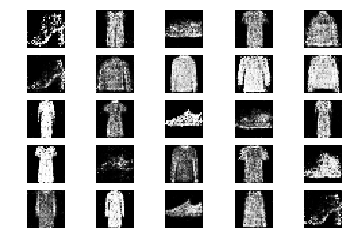

46001 [Discriminator loss: 0.663238, acc.: 67.19%] [Generator loss: 1.073143]
46002 [Discriminator loss: 0.519653, acc.: 76.56%] [Generator loss: 0.948666]
46003 [Discriminator loss: 0.593305, acc.: 64.06%] [Generator loss: 0.997342]
46004 [Discriminator loss: 0.544760, acc.: 75.00%] [Generator loss: 1.129472]
46005 [Discriminator loss: 0.673938, acc.: 62.50%] [Generator loss: 1.128600]
46006 [Discriminator loss: 0.600172, acc.: 60.94%] [Generator loss: 0.965611]
46007 [Discriminator loss: 0.570042, acc.: 65.62%] [Generator loss: 1.016639]
46008 [Discriminator loss: 0.579023, acc.: 70.31%] [Generator loss: 0.966945]
46009 [Discriminator loss: 0.608220, acc.: 59.38%] [Generator loss: 1.054063]
46010 [Discriminator loss: 0.675761, acc.: 56.25%] [Generator loss: 1.131539]
46011 [Discriminator loss: 0.577271, acc.: 73.44%] [Generator loss: 0.993080]
46012 [Discriminator loss: 0.601362, acc.: 65.62%] [Generator loss: 1.145554]
46013 [Discriminator loss: 0.573353, acc.: 70.31%] [Generator lo

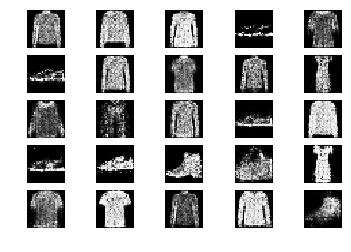

46101 [Discriminator loss: 0.621596, acc.: 64.06%] [Generator loss: 0.962388]
46102 [Discriminator loss: 0.672325, acc.: 64.06%] [Generator loss: 1.018344]
46103 [Discriminator loss: 0.642962, acc.: 67.19%] [Generator loss: 1.079208]
46104 [Discriminator loss: 0.655629, acc.: 62.50%] [Generator loss: 1.074596]
46105 [Discriminator loss: 0.649037, acc.: 51.56%] [Generator loss: 0.972039]
46106 [Discriminator loss: 0.665061, acc.: 54.69%] [Generator loss: 1.040493]
46107 [Discriminator loss: 0.605840, acc.: 65.62%] [Generator loss: 1.149036]
46108 [Discriminator loss: 0.597740, acc.: 68.75%] [Generator loss: 1.043968]
46109 [Discriminator loss: 0.601279, acc.: 64.06%] [Generator loss: 0.963306]
46110 [Discriminator loss: 0.677001, acc.: 53.12%] [Generator loss: 0.912100]
46111 [Discriminator loss: 0.607732, acc.: 71.88%] [Generator loss: 0.953844]
46112 [Discriminator loss: 0.592318, acc.: 60.94%] [Generator loss: 0.939119]
46113 [Discriminator loss: 0.609784, acc.: 68.75%] [Generator lo

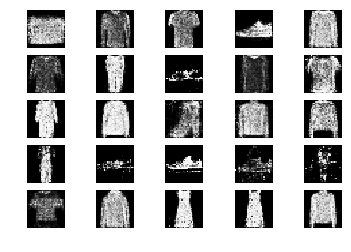

46201 [Discriminator loss: 0.617752, acc.: 60.94%] [Generator loss: 0.920001]
46202 [Discriminator loss: 0.604249, acc.: 70.31%] [Generator loss: 0.976535]
46203 [Discriminator loss: 0.512755, acc.: 76.56%] [Generator loss: 0.935169]
46204 [Discriminator loss: 0.678550, acc.: 59.38%] [Generator loss: 1.035364]
46205 [Discriminator loss: 0.560956, acc.: 70.31%] [Generator loss: 0.861190]
46206 [Discriminator loss: 0.680404, acc.: 60.94%] [Generator loss: 1.004528]
46207 [Discriminator loss: 0.598049, acc.: 75.00%] [Generator loss: 0.951562]
46208 [Discriminator loss: 0.640332, acc.: 68.75%] [Generator loss: 0.943072]
46209 [Discriminator loss: 0.634035, acc.: 67.19%] [Generator loss: 1.025749]
46210 [Discriminator loss: 0.600352, acc.: 68.75%] [Generator loss: 1.176274]
46211 [Discriminator loss: 0.619601, acc.: 67.19%] [Generator loss: 1.170077]
46212 [Discriminator loss: 0.609589, acc.: 68.75%] [Generator loss: 0.994665]
46213 [Discriminator loss: 0.698512, acc.: 56.25%] [Generator lo

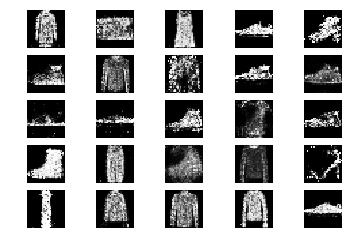

46301 [Discriminator loss: 0.570639, acc.: 67.19%] [Generator loss: 0.989127]
46302 [Discriminator loss: 0.606766, acc.: 64.06%] [Generator loss: 0.864596]
46303 [Discriminator loss: 0.692338, acc.: 54.69%] [Generator loss: 0.932304]
46304 [Discriminator loss: 0.673361, acc.: 62.50%] [Generator loss: 0.955820]
46305 [Discriminator loss: 0.699730, acc.: 57.81%] [Generator loss: 0.922234]
46306 [Discriminator loss: 0.602563, acc.: 64.06%] [Generator loss: 1.047733]
46307 [Discriminator loss: 0.621329, acc.: 70.31%] [Generator loss: 1.060735]
46308 [Discriminator loss: 0.685033, acc.: 56.25%] [Generator loss: 1.058030]
46309 [Discriminator loss: 0.639265, acc.: 67.19%] [Generator loss: 1.025061]
46310 [Discriminator loss: 0.568574, acc.: 70.31%] [Generator loss: 1.019166]
46311 [Discriminator loss: 0.677849, acc.: 57.81%] [Generator loss: 0.988771]
46312 [Discriminator loss: 0.600062, acc.: 59.38%] [Generator loss: 0.949125]
46313 [Discriminator loss: 0.621289, acc.: 64.06%] [Generator lo

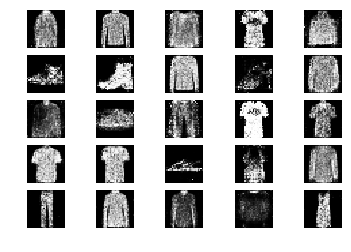

46401 [Discriminator loss: 0.561816, acc.: 70.31%] [Generator loss: 0.993483]
46402 [Discriminator loss: 0.637024, acc.: 64.06%] [Generator loss: 1.041994]
46403 [Discriminator loss: 0.603337, acc.: 71.88%] [Generator loss: 1.062745]
46404 [Discriminator loss: 0.543183, acc.: 70.31%] [Generator loss: 1.108452]
46405 [Discriminator loss: 0.619392, acc.: 60.94%] [Generator loss: 1.005654]
46406 [Discriminator loss: 0.563046, acc.: 65.62%] [Generator loss: 1.006667]
46407 [Discriminator loss: 0.713115, acc.: 53.12%] [Generator loss: 0.954623]
46408 [Discriminator loss: 0.579791, acc.: 68.75%] [Generator loss: 0.972754]
46409 [Discriminator loss: 0.641611, acc.: 60.94%] [Generator loss: 1.022934]
46410 [Discriminator loss: 0.680064, acc.: 54.69%] [Generator loss: 0.841722]
46411 [Discriminator loss: 0.661704, acc.: 59.38%] [Generator loss: 0.962557]
46412 [Discriminator loss: 0.640192, acc.: 62.50%] [Generator loss: 0.947908]
46413 [Discriminator loss: 0.555497, acc.: 76.56%] [Generator lo

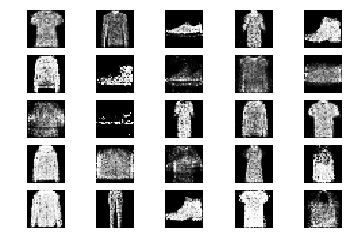

46501 [Discriminator loss: 0.543593, acc.: 78.12%] [Generator loss: 1.097862]
46502 [Discriminator loss: 0.538697, acc.: 68.75%] [Generator loss: 1.039057]
46503 [Discriminator loss: 0.667006, acc.: 57.81%] [Generator loss: 1.021947]
46504 [Discriminator loss: 0.603675, acc.: 70.31%] [Generator loss: 0.971974]
46505 [Discriminator loss: 0.614203, acc.: 62.50%] [Generator loss: 1.101506]
46506 [Discriminator loss: 0.644576, acc.: 68.75%] [Generator loss: 0.992444]
46507 [Discriminator loss: 0.626587, acc.: 64.06%] [Generator loss: 1.057958]
46508 [Discriminator loss: 0.630655, acc.: 64.06%] [Generator loss: 0.937049]
46509 [Discriminator loss: 0.679313, acc.: 54.69%] [Generator loss: 0.914261]
46510 [Discriminator loss: 0.666596, acc.: 51.56%] [Generator loss: 1.006418]
46511 [Discriminator loss: 0.636142, acc.: 59.38%] [Generator loss: 0.811882]
46512 [Discriminator loss: 0.602698, acc.: 65.62%] [Generator loss: 0.988871]
46513 [Discriminator loss: 0.643892, acc.: 60.94%] [Generator lo

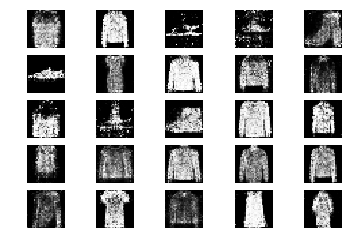

46601 [Discriminator loss: 0.632605, acc.: 64.06%] [Generator loss: 1.176838]
46602 [Discriminator loss: 0.624882, acc.: 65.62%] [Generator loss: 1.023182]
46603 [Discriminator loss: 0.623843, acc.: 65.62%] [Generator loss: 1.132234]
46604 [Discriminator loss: 0.547646, acc.: 73.44%] [Generator loss: 1.003670]
46605 [Discriminator loss: 0.578977, acc.: 65.62%] [Generator loss: 1.105461]
46606 [Discriminator loss: 0.647341, acc.: 54.69%] [Generator loss: 1.045478]
46607 [Discriminator loss: 0.621257, acc.: 67.19%] [Generator loss: 0.991196]
46608 [Discriminator loss: 0.610789, acc.: 65.62%] [Generator loss: 1.082547]
46609 [Discriminator loss: 0.610314, acc.: 59.38%] [Generator loss: 0.948274]
46610 [Discriminator loss: 0.683087, acc.: 59.38%] [Generator loss: 0.993761]
46611 [Discriminator loss: 0.644434, acc.: 59.38%] [Generator loss: 1.075647]
46612 [Discriminator loss: 0.555449, acc.: 68.75%] [Generator loss: 1.071089]
46613 [Discriminator loss: 0.565336, acc.: 71.88%] [Generator lo

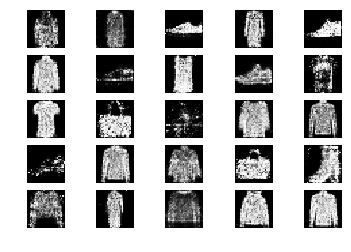

46701 [Discriminator loss: 0.646052, acc.: 68.75%] [Generator loss: 1.037506]
46702 [Discriminator loss: 0.619485, acc.: 71.88%] [Generator loss: 1.011392]
46703 [Discriminator loss: 0.488689, acc.: 78.12%] [Generator loss: 1.088651]
46704 [Discriminator loss: 0.640002, acc.: 68.75%] [Generator loss: 1.178335]
46705 [Discriminator loss: 0.619072, acc.: 62.50%] [Generator loss: 1.118245]
46706 [Discriminator loss: 0.488535, acc.: 78.12%] [Generator loss: 1.168732]
46707 [Discriminator loss: 0.588312, acc.: 71.88%] [Generator loss: 1.090520]
46708 [Discriminator loss: 0.688268, acc.: 56.25%] [Generator loss: 1.035954]
46709 [Discriminator loss: 0.622463, acc.: 65.62%] [Generator loss: 1.099942]
46710 [Discriminator loss: 0.639643, acc.: 64.06%] [Generator loss: 0.981032]
46711 [Discriminator loss: 0.615518, acc.: 60.94%] [Generator loss: 0.988307]
46712 [Discriminator loss: 0.665931, acc.: 60.94%] [Generator loss: 0.855724]
46713 [Discriminator loss: 0.682568, acc.: 57.81%] [Generator lo

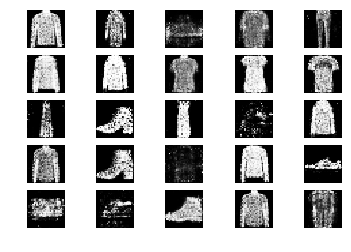

46801 [Discriminator loss: 0.606281, acc.: 64.06%] [Generator loss: 1.066912]
46802 [Discriminator loss: 0.568482, acc.: 70.31%] [Generator loss: 1.108325]
46803 [Discriminator loss: 0.600902, acc.: 65.62%] [Generator loss: 1.049769]
46804 [Discriminator loss: 0.579775, acc.: 71.88%] [Generator loss: 0.956064]
46805 [Discriminator loss: 0.605611, acc.: 59.38%] [Generator loss: 0.953966]
46806 [Discriminator loss: 0.556792, acc.: 70.31%] [Generator loss: 1.115875]
46807 [Discriminator loss: 0.685849, acc.: 60.94%] [Generator loss: 0.965922]
46808 [Discriminator loss: 0.592056, acc.: 67.19%] [Generator loss: 1.058716]
46809 [Discriminator loss: 0.574808, acc.: 75.00%] [Generator loss: 1.095524]
46810 [Discriminator loss: 0.619343, acc.: 65.62%] [Generator loss: 1.087555]
46811 [Discriminator loss: 0.649324, acc.: 62.50%] [Generator loss: 0.951832]
46812 [Discriminator loss: 0.630423, acc.: 64.06%] [Generator loss: 1.171970]
46813 [Discriminator loss: 0.647968, acc.: 62.50%] [Generator lo

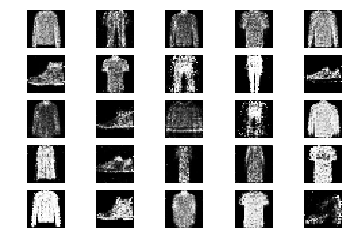

46901 [Discriminator loss: 0.502717, acc.: 73.44%] [Generator loss: 1.131767]
46902 [Discriminator loss: 0.677764, acc.: 54.69%] [Generator loss: 1.029378]
46903 [Discriminator loss: 0.661456, acc.: 59.38%] [Generator loss: 1.126758]
46904 [Discriminator loss: 0.635953, acc.: 57.81%] [Generator loss: 1.112926]
46905 [Discriminator loss: 0.603054, acc.: 64.06%] [Generator loss: 1.123465]
46906 [Discriminator loss: 0.588216, acc.: 65.62%] [Generator loss: 0.948757]
46907 [Discriminator loss: 0.608431, acc.: 64.06%] [Generator loss: 0.918487]
46908 [Discriminator loss: 0.612267, acc.: 67.19%] [Generator loss: 1.027282]
46909 [Discriminator loss: 0.611151, acc.: 65.62%] [Generator loss: 0.946506]
46910 [Discriminator loss: 0.671062, acc.: 54.69%] [Generator loss: 0.989766]
46911 [Discriminator loss: 0.650309, acc.: 60.94%] [Generator loss: 1.087039]
46912 [Discriminator loss: 0.621966, acc.: 67.19%] [Generator loss: 1.086295]
46913 [Discriminator loss: 0.646172, acc.: 59.38%] [Generator lo

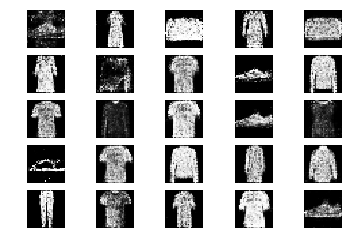

47001 [Discriminator loss: 0.609855, acc.: 73.44%] [Generator loss: 0.984405]
47002 [Discriminator loss: 0.602188, acc.: 67.19%] [Generator loss: 1.118604]
47003 [Discriminator loss: 0.652474, acc.: 53.12%] [Generator loss: 1.009569]
47004 [Discriminator loss: 0.569204, acc.: 67.19%] [Generator loss: 0.941684]
47005 [Discriminator loss: 0.600058, acc.: 65.62%] [Generator loss: 1.156167]
47006 [Discriminator loss: 0.636343, acc.: 60.94%] [Generator loss: 1.083330]
47007 [Discriminator loss: 0.643061, acc.: 60.94%] [Generator loss: 0.991010]
47008 [Discriminator loss: 0.545988, acc.: 68.75%] [Generator loss: 1.127703]
47009 [Discriminator loss: 0.563177, acc.: 70.31%] [Generator loss: 1.176323]
47010 [Discriminator loss: 0.671574, acc.: 51.56%] [Generator loss: 1.059729]
47011 [Discriminator loss: 0.633210, acc.: 62.50%] [Generator loss: 1.131910]
47012 [Discriminator loss: 0.672252, acc.: 65.62%] [Generator loss: 1.098575]
47013 [Discriminator loss: 0.650928, acc.: 56.25%] [Generator lo

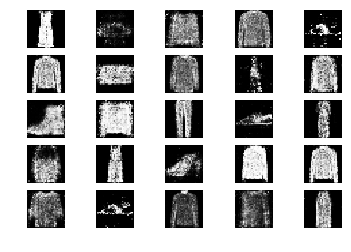

47101 [Discriminator loss: 0.658869, acc.: 54.69%] [Generator loss: 1.086065]
47102 [Discriminator loss: 0.604062, acc.: 68.75%] [Generator loss: 0.935635]
47103 [Discriminator loss: 0.628702, acc.: 67.19%] [Generator loss: 0.959876]
47104 [Discriminator loss: 0.627793, acc.: 67.19%] [Generator loss: 1.152760]
47105 [Discriminator loss: 0.722019, acc.: 51.56%] [Generator loss: 1.016145]
47106 [Discriminator loss: 0.593542, acc.: 67.19%] [Generator loss: 1.096766]
47107 [Discriminator loss: 0.547061, acc.: 75.00%] [Generator loss: 1.052176]
47108 [Discriminator loss: 0.655918, acc.: 62.50%] [Generator loss: 1.057041]
47109 [Discriminator loss: 0.545549, acc.: 78.12%] [Generator loss: 0.938892]
47110 [Discriminator loss: 0.678010, acc.: 56.25%] [Generator loss: 1.030668]
47111 [Discriminator loss: 0.641927, acc.: 62.50%] [Generator loss: 0.982822]
47112 [Discriminator loss: 0.632721, acc.: 59.38%] [Generator loss: 1.026625]
47113 [Discriminator loss: 0.606045, acc.: 68.75%] [Generator lo

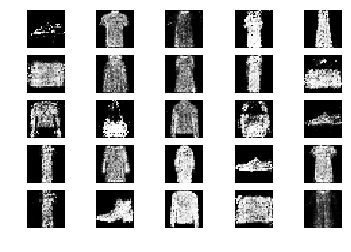

47201 [Discriminator loss: 0.631667, acc.: 64.06%] [Generator loss: 1.037837]
47202 [Discriminator loss: 0.553011, acc.: 70.31%] [Generator loss: 1.146270]
47203 [Discriminator loss: 0.644590, acc.: 70.31%] [Generator loss: 1.168852]
47204 [Discriminator loss: 0.561211, acc.: 73.44%] [Generator loss: 1.059006]
47205 [Discriminator loss: 0.647332, acc.: 59.38%] [Generator loss: 1.044391]
47206 [Discriminator loss: 0.657775, acc.: 59.38%] [Generator loss: 1.017506]
47207 [Discriminator loss: 0.671002, acc.: 67.19%] [Generator loss: 1.013964]
47208 [Discriminator loss: 0.591441, acc.: 68.75%] [Generator loss: 1.078890]
47209 [Discriminator loss: 0.633933, acc.: 59.38%] [Generator loss: 1.097044]
47210 [Discriminator loss: 0.639163, acc.: 62.50%] [Generator loss: 1.089700]
47211 [Discriminator loss: 0.638053, acc.: 59.38%] [Generator loss: 0.967304]
47212 [Discriminator loss: 0.708127, acc.: 60.94%] [Generator loss: 0.981199]
47213 [Discriminator loss: 0.652415, acc.: 56.25%] [Generator lo

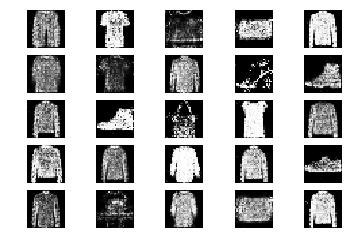

47301 [Discriminator loss: 0.615049, acc.: 65.62%] [Generator loss: 1.031700]
47302 [Discriminator loss: 0.656830, acc.: 56.25%] [Generator loss: 1.202433]
47303 [Discriminator loss: 0.517356, acc.: 78.12%] [Generator loss: 1.007380]
47304 [Discriminator loss: 0.607577, acc.: 62.50%] [Generator loss: 0.995726]
47305 [Discriminator loss: 0.566252, acc.: 70.31%] [Generator loss: 0.941594]
47306 [Discriminator loss: 0.650777, acc.: 62.50%] [Generator loss: 1.086043]
47307 [Discriminator loss: 0.682254, acc.: 51.56%] [Generator loss: 0.990627]
47308 [Discriminator loss: 0.620113, acc.: 65.62%] [Generator loss: 1.013269]
47309 [Discriminator loss: 0.589552, acc.: 68.75%] [Generator loss: 0.926045]
47310 [Discriminator loss: 0.594521, acc.: 67.19%] [Generator loss: 0.987816]
47311 [Discriminator loss: 0.561516, acc.: 70.31%] [Generator loss: 0.876791]
47312 [Discriminator loss: 0.537118, acc.: 75.00%] [Generator loss: 0.958093]
47313 [Discriminator loss: 0.714016, acc.: 54.69%] [Generator lo

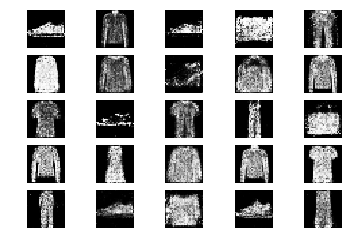

47401 [Discriminator loss: 0.631714, acc.: 67.19%] [Generator loss: 0.840948]
47402 [Discriminator loss: 0.653946, acc.: 67.19%] [Generator loss: 1.052636]
47403 [Discriminator loss: 0.664188, acc.: 59.38%] [Generator loss: 1.024334]
47404 [Discriminator loss: 0.613388, acc.: 64.06%] [Generator loss: 1.022505]
47405 [Discriminator loss: 0.548574, acc.: 76.56%] [Generator loss: 1.063687]
47406 [Discriminator loss: 0.598973, acc.: 65.62%] [Generator loss: 1.072302]
47407 [Discriminator loss: 0.587405, acc.: 68.75%] [Generator loss: 1.134888]
47408 [Discriminator loss: 0.646079, acc.: 57.81%] [Generator loss: 1.018637]
47409 [Discriminator loss: 0.535770, acc.: 71.88%] [Generator loss: 1.078705]
47410 [Discriminator loss: 0.678695, acc.: 57.81%] [Generator loss: 1.113105]
47411 [Discriminator loss: 0.623789, acc.: 62.50%] [Generator loss: 1.001814]
47412 [Discriminator loss: 0.656643, acc.: 62.50%] [Generator loss: 1.106826]
47413 [Discriminator loss: 0.615183, acc.: 62.50%] [Generator lo

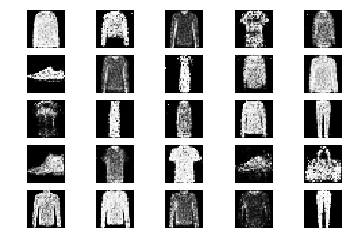

47501 [Discriminator loss: 0.568215, acc.: 79.69%] [Generator loss: 1.010942]
47502 [Discriminator loss: 0.547192, acc.: 70.31%] [Generator loss: 0.996381]
47503 [Discriminator loss: 0.733953, acc.: 45.31%] [Generator loss: 0.865781]
47504 [Discriminator loss: 0.748122, acc.: 54.69%] [Generator loss: 1.064297]
47505 [Discriminator loss: 0.712363, acc.: 51.56%] [Generator loss: 1.105790]
47506 [Discriminator loss: 0.636317, acc.: 54.69%] [Generator loss: 0.990427]
47507 [Discriminator loss: 0.555792, acc.: 73.44%] [Generator loss: 1.053111]
47508 [Discriminator loss: 0.598860, acc.: 60.94%] [Generator loss: 1.121240]
47509 [Discriminator loss: 0.647941, acc.: 57.81%] [Generator loss: 1.218580]
47510 [Discriminator loss: 0.635316, acc.: 64.06%] [Generator loss: 1.131587]
47511 [Discriminator loss: 0.551741, acc.: 78.12%] [Generator loss: 1.159478]
47512 [Discriminator loss: 0.682045, acc.: 57.81%] [Generator loss: 1.011405]
47513 [Discriminator loss: 0.589857, acc.: 68.75%] [Generator lo

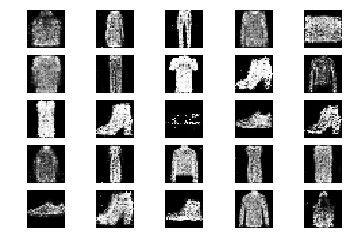

47601 [Discriminator loss: 0.758331, acc.: 51.56%] [Generator loss: 0.947446]
47602 [Discriminator loss: 0.624909, acc.: 60.94%] [Generator loss: 0.937960]
47603 [Discriminator loss: 0.582960, acc.: 70.31%] [Generator loss: 0.977441]
47604 [Discriminator loss: 0.581195, acc.: 73.44%] [Generator loss: 1.190281]
47605 [Discriminator loss: 0.667040, acc.: 57.81%] [Generator loss: 1.047184]
47606 [Discriminator loss: 0.645949, acc.: 57.81%] [Generator loss: 1.118526]
47607 [Discriminator loss: 0.588525, acc.: 68.75%] [Generator loss: 1.152190]
47608 [Discriminator loss: 0.604603, acc.: 64.06%] [Generator loss: 0.994245]
47609 [Discriminator loss: 0.645661, acc.: 62.50%] [Generator loss: 1.006530]
47610 [Discriminator loss: 0.526419, acc.: 78.12%] [Generator loss: 0.992015]
47611 [Discriminator loss: 0.581745, acc.: 71.88%] [Generator loss: 0.990619]
47612 [Discriminator loss: 0.653406, acc.: 64.06%] [Generator loss: 0.934848]
47613 [Discriminator loss: 0.627706, acc.: 67.19%] [Generator lo

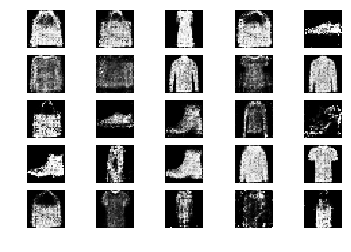

47701 [Discriminator loss: 0.695311, acc.: 59.38%] [Generator loss: 0.967426]
47702 [Discriminator loss: 0.652285, acc.: 57.81%] [Generator loss: 1.180924]
47703 [Discriminator loss: 0.520060, acc.: 71.88%] [Generator loss: 1.101363]
47704 [Discriminator loss: 0.543654, acc.: 78.12%] [Generator loss: 1.051422]
47705 [Discriminator loss: 0.589556, acc.: 70.31%] [Generator loss: 1.095605]
47706 [Discriminator loss: 0.533584, acc.: 70.31%] [Generator loss: 0.998066]
47707 [Discriminator loss: 0.560255, acc.: 76.56%] [Generator loss: 1.152983]
47708 [Discriminator loss: 0.545027, acc.: 75.00%] [Generator loss: 1.048278]
47709 [Discriminator loss: 0.664599, acc.: 62.50%] [Generator loss: 0.989147]
47710 [Discriminator loss: 0.606223, acc.: 64.06%] [Generator loss: 1.026313]
47711 [Discriminator loss: 0.694213, acc.: 54.69%] [Generator loss: 1.072094]
47712 [Discriminator loss: 0.535121, acc.: 70.31%] [Generator loss: 1.040978]
47713 [Discriminator loss: 0.677495, acc.: 54.69%] [Generator lo

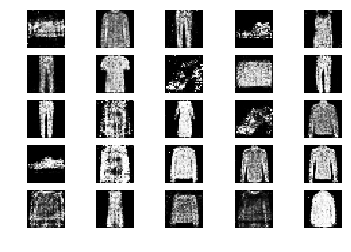

47801 [Discriminator loss: 0.604684, acc.: 68.75%] [Generator loss: 1.022182]
47802 [Discriminator loss: 0.635272, acc.: 60.94%] [Generator loss: 1.242966]
47803 [Discriminator loss: 0.609495, acc.: 67.19%] [Generator loss: 0.925652]
47804 [Discriminator loss: 0.628656, acc.: 62.50%] [Generator loss: 1.072271]
47805 [Discriminator loss: 0.609078, acc.: 60.94%] [Generator loss: 0.952123]
47806 [Discriminator loss: 0.624170, acc.: 70.31%] [Generator loss: 1.065915]
47807 [Discriminator loss: 0.629884, acc.: 65.62%] [Generator loss: 1.000090]
47808 [Discriminator loss: 0.651794, acc.: 59.38%] [Generator loss: 1.165595]
47809 [Discriminator loss: 0.631960, acc.: 59.38%] [Generator loss: 0.984529]
47810 [Discriminator loss: 0.661262, acc.: 64.06%] [Generator loss: 0.998776]
47811 [Discriminator loss: 0.638568, acc.: 65.62%] [Generator loss: 1.027191]
47812 [Discriminator loss: 0.661105, acc.: 59.38%] [Generator loss: 1.004953]
47813 [Discriminator loss: 0.592087, acc.: 65.62%] [Generator lo

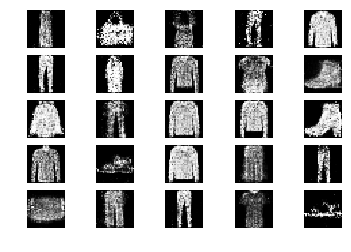

47901 [Discriminator loss: 0.483160, acc.: 82.81%] [Generator loss: 1.039275]
47902 [Discriminator loss: 0.662405, acc.: 67.19%] [Generator loss: 1.009066]
47903 [Discriminator loss: 0.568399, acc.: 70.31%] [Generator loss: 1.033211]
47904 [Discriminator loss: 0.652190, acc.: 64.06%] [Generator loss: 0.999544]
47905 [Discriminator loss: 0.617876, acc.: 59.38%] [Generator loss: 1.034763]
47906 [Discriminator loss: 0.569272, acc.: 68.75%] [Generator loss: 1.091707]
47907 [Discriminator loss: 0.558538, acc.: 76.56%] [Generator loss: 1.091874]
47908 [Discriminator loss: 0.580591, acc.: 64.06%] [Generator loss: 1.155030]
47909 [Discriminator loss: 0.641731, acc.: 68.75%] [Generator loss: 0.976810]
47910 [Discriminator loss: 0.578132, acc.: 68.75%] [Generator loss: 1.024432]
47911 [Discriminator loss: 0.614330, acc.: 70.31%] [Generator loss: 1.100895]
47912 [Discriminator loss: 0.661879, acc.: 57.81%] [Generator loss: 1.105197]
47913 [Discriminator loss: 0.532241, acc.: 76.56%] [Generator lo

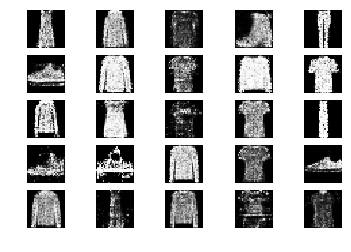

48001 [Discriminator loss: 0.629438, acc.: 65.62%] [Generator loss: 1.057103]
48002 [Discriminator loss: 0.656889, acc.: 64.06%] [Generator loss: 1.017975]
48003 [Discriminator loss: 0.565345, acc.: 71.88%] [Generator loss: 1.043784]
48004 [Discriminator loss: 0.658261, acc.: 59.38%] [Generator loss: 1.051426]
48005 [Discriminator loss: 0.605373, acc.: 68.75%] [Generator loss: 0.974195]
48006 [Discriminator loss: 0.614568, acc.: 70.31%] [Generator loss: 1.034756]
48007 [Discriminator loss: 0.625660, acc.: 62.50%] [Generator loss: 0.965723]
48008 [Discriminator loss: 0.500651, acc.: 76.56%] [Generator loss: 1.002184]
48009 [Discriminator loss: 0.663188, acc.: 68.75%] [Generator loss: 1.007415]
48010 [Discriminator loss: 0.597438, acc.: 64.06%] [Generator loss: 1.048369]
48011 [Discriminator loss: 0.685026, acc.: 51.56%] [Generator loss: 1.104944]
48012 [Discriminator loss: 0.623401, acc.: 65.62%] [Generator loss: 1.079702]
48013 [Discriminator loss: 0.692191, acc.: 62.50%] [Generator lo

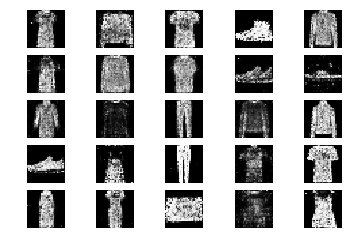

48101 [Discriminator loss: 0.604987, acc.: 68.75%] [Generator loss: 1.110901]
48102 [Discriminator loss: 0.723655, acc.: 57.81%] [Generator loss: 0.971598]
48103 [Discriminator loss: 0.604200, acc.: 70.31%] [Generator loss: 1.009204]
48104 [Discriminator loss: 0.634672, acc.: 59.38%] [Generator loss: 1.008869]
48105 [Discriminator loss: 0.589755, acc.: 68.75%] [Generator loss: 1.025110]
48106 [Discriminator loss: 0.603286, acc.: 64.06%] [Generator loss: 1.006822]
48107 [Discriminator loss: 0.652436, acc.: 59.38%] [Generator loss: 1.224387]
48108 [Discriminator loss: 0.572537, acc.: 71.88%] [Generator loss: 0.973583]
48109 [Discriminator loss: 0.708466, acc.: 51.56%] [Generator loss: 1.076841]
48110 [Discriminator loss: 0.604349, acc.: 65.62%] [Generator loss: 0.966229]
48111 [Discriminator loss: 0.587649, acc.: 75.00%] [Generator loss: 1.185753]
48112 [Discriminator loss: 0.611140, acc.: 62.50%] [Generator loss: 1.118111]
48113 [Discriminator loss: 0.716049, acc.: 59.38%] [Generator lo

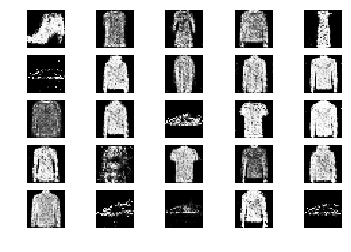

48201 [Discriminator loss: 0.642200, acc.: 60.94%] [Generator loss: 1.016947]
48202 [Discriminator loss: 0.578233, acc.: 67.19%] [Generator loss: 1.086532]
48203 [Discriminator loss: 0.587333, acc.: 75.00%] [Generator loss: 1.098545]
48204 [Discriminator loss: 0.577171, acc.: 64.06%] [Generator loss: 0.995196]
48205 [Discriminator loss: 0.647914, acc.: 54.69%] [Generator loss: 1.011255]
48206 [Discriminator loss: 0.624552, acc.: 65.62%] [Generator loss: 1.133564]
48207 [Discriminator loss: 0.593440, acc.: 67.19%] [Generator loss: 1.045192]
48208 [Discriminator loss: 0.614340, acc.: 62.50%] [Generator loss: 1.050584]
48209 [Discriminator loss: 0.653148, acc.: 68.75%] [Generator loss: 0.998665]
48210 [Discriminator loss: 0.611011, acc.: 62.50%] [Generator loss: 1.168900]
48211 [Discriminator loss: 0.548557, acc.: 71.88%] [Generator loss: 1.081388]
48212 [Discriminator loss: 0.663313, acc.: 59.38%] [Generator loss: 1.136200]
48213 [Discriminator loss: 0.576435, acc.: 71.88%] [Generator lo

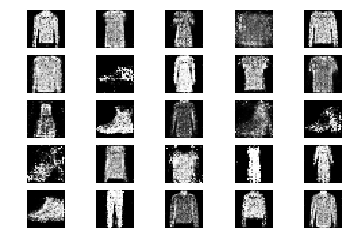

48301 [Discriminator loss: 0.662298, acc.: 57.81%] [Generator loss: 1.047366]
48302 [Discriminator loss: 0.604088, acc.: 68.75%] [Generator loss: 1.052407]
48303 [Discriminator loss: 0.619703, acc.: 62.50%] [Generator loss: 1.068779]
48304 [Discriminator loss: 0.584952, acc.: 70.31%] [Generator loss: 1.070000]
48305 [Discriminator loss: 0.658320, acc.: 62.50%] [Generator loss: 1.051004]
48306 [Discriminator loss: 0.654439, acc.: 60.94%] [Generator loss: 1.078292]
48307 [Discriminator loss: 0.595396, acc.: 70.31%] [Generator loss: 1.150434]
48308 [Discriminator loss: 0.635918, acc.: 59.38%] [Generator loss: 1.114257]
48309 [Discriminator loss: 0.614238, acc.: 64.06%] [Generator loss: 1.190281]
48310 [Discriminator loss: 0.595770, acc.: 71.88%] [Generator loss: 1.021073]
48311 [Discriminator loss: 0.722062, acc.: 54.69%] [Generator loss: 1.106656]
48312 [Discriminator loss: 0.679901, acc.: 60.94%] [Generator loss: 1.029589]
48313 [Discriminator loss: 0.668922, acc.: 62.50%] [Generator lo

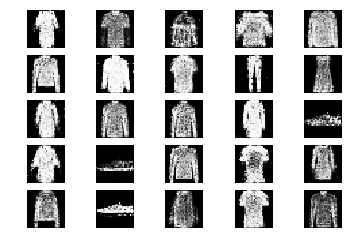

48401 [Discriminator loss: 0.645872, acc.: 60.94%] [Generator loss: 1.073662]
48402 [Discriminator loss: 0.708314, acc.: 59.38%] [Generator loss: 1.101465]
48403 [Discriminator loss: 0.596002, acc.: 62.50%] [Generator loss: 1.105260]
48404 [Discriminator loss: 0.641810, acc.: 70.31%] [Generator loss: 1.067987]
48405 [Discriminator loss: 0.586450, acc.: 64.06%] [Generator loss: 1.175446]
48406 [Discriminator loss: 0.560786, acc.: 75.00%] [Generator loss: 1.114048]
48407 [Discriminator loss: 0.563953, acc.: 75.00%] [Generator loss: 1.109819]
48408 [Discriminator loss: 0.627608, acc.: 62.50%] [Generator loss: 1.173790]
48409 [Discriminator loss: 0.634623, acc.: 68.75%] [Generator loss: 1.043474]
48410 [Discriminator loss: 0.610290, acc.: 68.75%] [Generator loss: 1.035533]
48411 [Discriminator loss: 0.551962, acc.: 79.69%] [Generator loss: 0.938988]
48412 [Discriminator loss: 0.688088, acc.: 54.69%] [Generator loss: 0.957883]
48413 [Discriminator loss: 0.619203, acc.: 64.06%] [Generator lo

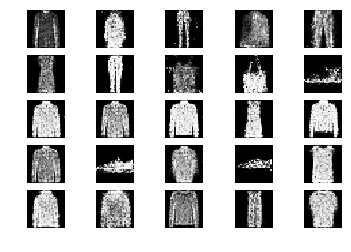

48501 [Discriminator loss: 0.573578, acc.: 71.88%] [Generator loss: 1.093053]
48502 [Discriminator loss: 0.583234, acc.: 67.19%] [Generator loss: 1.069025]
48503 [Discriminator loss: 0.672110, acc.: 56.25%] [Generator loss: 1.186465]
48504 [Discriminator loss: 0.647692, acc.: 62.50%] [Generator loss: 1.046103]
48505 [Discriminator loss: 0.545864, acc.: 73.44%] [Generator loss: 1.058874]
48506 [Discriminator loss: 0.608783, acc.: 73.44%] [Generator loss: 1.161304]
48507 [Discriminator loss: 0.553316, acc.: 70.31%] [Generator loss: 1.059500]
48508 [Discriminator loss: 0.647583, acc.: 64.06%] [Generator loss: 1.190677]
48509 [Discriminator loss: 0.575300, acc.: 73.44%] [Generator loss: 1.170689]
48510 [Discriminator loss: 0.609279, acc.: 65.62%] [Generator loss: 1.149471]
48511 [Discriminator loss: 0.555069, acc.: 79.69%] [Generator loss: 0.998302]
48512 [Discriminator loss: 0.524236, acc.: 71.88%] [Generator loss: 1.053365]
48513 [Discriminator loss: 0.664762, acc.: 57.81%] [Generator lo

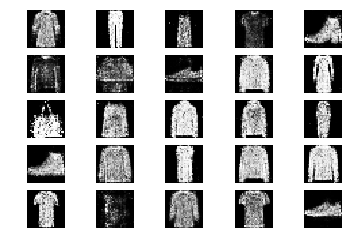

48601 [Discriminator loss: 0.631354, acc.: 59.38%] [Generator loss: 1.094277]
48602 [Discriminator loss: 0.612018, acc.: 65.62%] [Generator loss: 1.055635]
48603 [Discriminator loss: 0.588173, acc.: 65.62%] [Generator loss: 0.981110]
48604 [Discriminator loss: 0.663795, acc.: 60.94%] [Generator loss: 1.100928]
48605 [Discriminator loss: 0.657137, acc.: 65.62%] [Generator loss: 0.956052]
48606 [Discriminator loss: 0.640807, acc.: 64.06%] [Generator loss: 0.935322]
48607 [Discriminator loss: 0.599569, acc.: 67.19%] [Generator loss: 1.134117]
48608 [Discriminator loss: 0.652142, acc.: 60.94%] [Generator loss: 1.038097]
48609 [Discriminator loss: 0.618479, acc.: 67.19%] [Generator loss: 0.991486]
48610 [Discriminator loss: 0.662493, acc.: 57.81%] [Generator loss: 1.045756]
48611 [Discriminator loss: 0.629173, acc.: 65.62%] [Generator loss: 1.074930]
48612 [Discriminator loss: 0.625486, acc.: 59.38%] [Generator loss: 1.151401]
48613 [Discriminator loss: 0.660002, acc.: 62.50%] [Generator lo

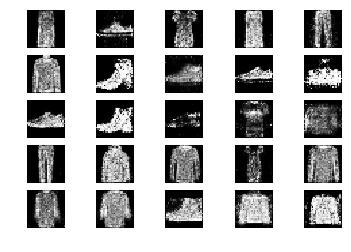

48701 [Discriminator loss: 0.633674, acc.: 64.06%] [Generator loss: 1.066364]
48702 [Discriminator loss: 0.625371, acc.: 65.62%] [Generator loss: 1.012910]
48703 [Discriminator loss: 0.625968, acc.: 62.50%] [Generator loss: 0.983688]
48704 [Discriminator loss: 0.545767, acc.: 75.00%] [Generator loss: 1.054589]
48705 [Discriminator loss: 0.544026, acc.: 67.19%] [Generator loss: 1.056437]
48706 [Discriminator loss: 0.655424, acc.: 60.94%] [Generator loss: 1.133701]
48707 [Discriminator loss: 0.647941, acc.: 59.38%] [Generator loss: 1.055777]
48708 [Discriminator loss: 0.703362, acc.: 59.38%] [Generator loss: 1.082168]
48709 [Discriminator loss: 0.654806, acc.: 54.69%] [Generator loss: 1.132690]
48710 [Discriminator loss: 0.580501, acc.: 68.75%] [Generator loss: 0.928302]
48711 [Discriminator loss: 0.584574, acc.: 73.44%] [Generator loss: 1.169517]
48712 [Discriminator loss: 0.602740, acc.: 54.69%] [Generator loss: 1.119178]
48713 [Discriminator loss: 0.512844, acc.: 75.00%] [Generator lo

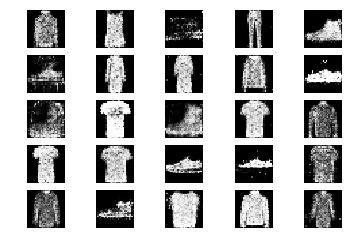

48801 [Discriminator loss: 0.591638, acc.: 64.06%] [Generator loss: 1.218699]
48802 [Discriminator loss: 0.678795, acc.: 62.50%] [Generator loss: 1.023150]
48803 [Discriminator loss: 0.584219, acc.: 75.00%] [Generator loss: 1.139726]
48804 [Discriminator loss: 0.664739, acc.: 59.38%] [Generator loss: 1.121943]
48805 [Discriminator loss: 0.557829, acc.: 71.88%] [Generator loss: 1.004314]
48806 [Discriminator loss: 0.711643, acc.: 62.50%] [Generator loss: 0.981920]
48807 [Discriminator loss: 0.698039, acc.: 50.00%] [Generator loss: 0.980571]
48808 [Discriminator loss: 0.704386, acc.: 62.50%] [Generator loss: 1.078335]
48809 [Discriminator loss: 0.592585, acc.: 71.88%] [Generator loss: 1.026666]
48810 [Discriminator loss: 0.609252, acc.: 73.44%] [Generator loss: 1.142932]
48811 [Discriminator loss: 0.549860, acc.: 71.88%] [Generator loss: 1.106326]
48812 [Discriminator loss: 0.583457, acc.: 71.88%] [Generator loss: 0.988238]
48813 [Discriminator loss: 0.577167, acc.: 68.75%] [Generator lo

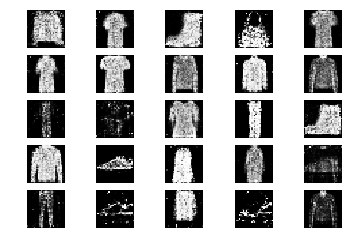

48901 [Discriminator loss: 0.596606, acc.: 64.06%] [Generator loss: 1.044916]
48902 [Discriminator loss: 0.627123, acc.: 64.06%] [Generator loss: 1.012019]
48903 [Discriminator loss: 0.567039, acc.: 71.88%] [Generator loss: 1.065454]
48904 [Discriminator loss: 0.613621, acc.: 65.62%] [Generator loss: 1.051608]
48905 [Discriminator loss: 0.595149, acc.: 64.06%] [Generator loss: 1.054440]
48906 [Discriminator loss: 0.686314, acc.: 56.25%] [Generator loss: 0.987192]
48907 [Discriminator loss: 0.566605, acc.: 73.44%] [Generator loss: 0.887396]
48908 [Discriminator loss: 0.531403, acc.: 75.00%] [Generator loss: 1.101170]
48909 [Discriminator loss: 0.585130, acc.: 70.31%] [Generator loss: 1.096761]
48910 [Discriminator loss: 0.676550, acc.: 64.06%] [Generator loss: 1.006796]
48911 [Discriminator loss: 0.673325, acc.: 62.50%] [Generator loss: 1.016877]
48912 [Discriminator loss: 0.560205, acc.: 73.44%] [Generator loss: 1.080432]
48913 [Discriminator loss: 0.492491, acc.: 81.25%] [Generator lo

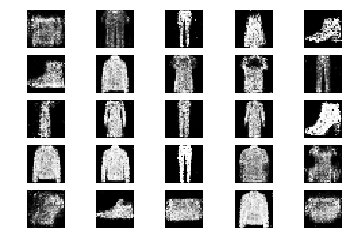

49001 [Discriminator loss: 0.679464, acc.: 64.06%] [Generator loss: 0.996794]
49002 [Discriminator loss: 0.573164, acc.: 67.19%] [Generator loss: 1.035313]
49003 [Discriminator loss: 0.657403, acc.: 60.94%] [Generator loss: 1.021931]
49004 [Discriminator loss: 0.584437, acc.: 70.31%] [Generator loss: 1.083994]
49005 [Discriminator loss: 0.555285, acc.: 68.75%] [Generator loss: 1.042127]
49006 [Discriminator loss: 0.631071, acc.: 57.81%] [Generator loss: 0.927527]
49007 [Discriminator loss: 0.545889, acc.: 71.88%] [Generator loss: 0.994843]
49008 [Discriminator loss: 0.637474, acc.: 67.19%] [Generator loss: 1.089412]
49009 [Discriminator loss: 0.665804, acc.: 64.06%] [Generator loss: 1.064853]
49010 [Discriminator loss: 0.534772, acc.: 75.00%] [Generator loss: 1.017495]
49011 [Discriminator loss: 0.591865, acc.: 75.00%] [Generator loss: 1.120874]
49012 [Discriminator loss: 0.641721, acc.: 67.19%] [Generator loss: 1.084866]
49013 [Discriminator loss: 0.548514, acc.: 70.31%] [Generator lo

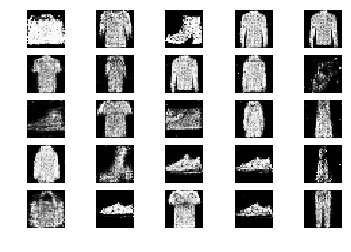

49101 [Discriminator loss: 0.594372, acc.: 67.19%] [Generator loss: 0.926466]
49102 [Discriminator loss: 0.551574, acc.: 75.00%] [Generator loss: 1.117621]
49103 [Discriminator loss: 0.696105, acc.: 59.38%] [Generator loss: 1.027238]
49104 [Discriminator loss: 0.607004, acc.: 65.62%] [Generator loss: 1.138286]
49105 [Discriminator loss: 0.684491, acc.: 54.69%] [Generator loss: 1.135926]
49106 [Discriminator loss: 0.595862, acc.: 70.31%] [Generator loss: 1.129422]
49107 [Discriminator loss: 0.634925, acc.: 59.38%] [Generator loss: 1.082990]
49108 [Discriminator loss: 0.564576, acc.: 71.88%] [Generator loss: 1.038032]
49109 [Discriminator loss: 0.655781, acc.: 59.38%] [Generator loss: 1.051621]
49110 [Discriminator loss: 0.635009, acc.: 65.62%] [Generator loss: 1.012725]
49111 [Discriminator loss: 0.642762, acc.: 65.62%] [Generator loss: 1.023427]
49112 [Discriminator loss: 0.578568, acc.: 79.69%] [Generator loss: 1.091771]
49113 [Discriminator loss: 0.584389, acc.: 65.62%] [Generator lo

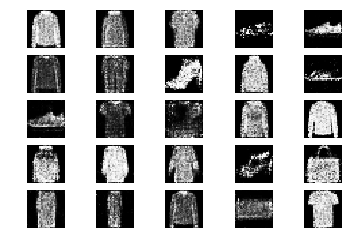

49201 [Discriminator loss: 0.544365, acc.: 75.00%] [Generator loss: 1.057545]
49202 [Discriminator loss: 0.707132, acc.: 64.06%] [Generator loss: 0.999428]
49203 [Discriminator loss: 0.625309, acc.: 65.62%] [Generator loss: 0.970300]
49204 [Discriminator loss: 0.610863, acc.: 62.50%] [Generator loss: 0.936402]
49205 [Discriminator loss: 0.620898, acc.: 67.19%] [Generator loss: 0.938948]
49206 [Discriminator loss: 0.622129, acc.: 67.19%] [Generator loss: 0.947752]
49207 [Discriminator loss: 0.668350, acc.: 62.50%] [Generator loss: 1.095532]
49208 [Discriminator loss: 0.544196, acc.: 71.88%] [Generator loss: 1.099877]
49209 [Discriminator loss: 0.595939, acc.: 67.19%] [Generator loss: 1.058322]
49210 [Discriminator loss: 0.516793, acc.: 71.88%] [Generator loss: 1.076455]
49211 [Discriminator loss: 0.521319, acc.: 73.44%] [Generator loss: 1.095244]
49212 [Discriminator loss: 0.569749, acc.: 68.75%] [Generator loss: 1.249482]
49213 [Discriminator loss: 0.577305, acc.: 65.62%] [Generator lo

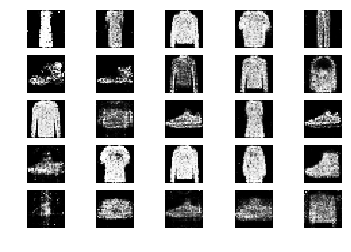

49301 [Discriminator loss: 0.549836, acc.: 70.31%] [Generator loss: 1.099444]
49302 [Discriminator loss: 0.507479, acc.: 71.88%] [Generator loss: 1.166896]
49303 [Discriminator loss: 0.683565, acc.: 64.06%] [Generator loss: 1.082325]
49304 [Discriminator loss: 0.676346, acc.: 60.94%] [Generator loss: 1.045607]
49305 [Discriminator loss: 0.621156, acc.: 59.38%] [Generator loss: 0.957414]
49306 [Discriminator loss: 0.512306, acc.: 79.69%] [Generator loss: 1.185495]
49307 [Discriminator loss: 0.664190, acc.: 64.06%] [Generator loss: 1.045854]
49308 [Discriminator loss: 0.653754, acc.: 64.06%] [Generator loss: 0.932093]
49309 [Discriminator loss: 0.710582, acc.: 51.56%] [Generator loss: 0.961374]
49310 [Discriminator loss: 0.605818, acc.: 67.19%] [Generator loss: 1.167290]
49311 [Discriminator loss: 0.611905, acc.: 60.94%] [Generator loss: 1.188219]
49312 [Discriminator loss: 0.605649, acc.: 71.88%] [Generator loss: 1.001880]
49313 [Discriminator loss: 0.599507, acc.: 76.56%] [Generator lo

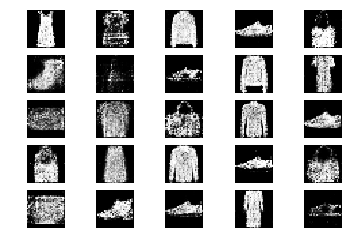

49401 [Discriminator loss: 0.618961, acc.: 67.19%] [Generator loss: 1.043283]
49402 [Discriminator loss: 0.626725, acc.: 65.62%] [Generator loss: 1.042692]
49403 [Discriminator loss: 0.580782, acc.: 57.81%] [Generator loss: 0.923414]
49404 [Discriminator loss: 0.603359, acc.: 70.31%] [Generator loss: 0.958446]
49405 [Discriminator loss: 0.648202, acc.: 60.94%] [Generator loss: 0.996368]
49406 [Discriminator loss: 0.563328, acc.: 73.44%] [Generator loss: 1.079321]
49407 [Discriminator loss: 0.592679, acc.: 67.19%] [Generator loss: 1.163713]
49408 [Discriminator loss: 0.577631, acc.: 65.62%] [Generator loss: 1.205876]
49409 [Discriminator loss: 0.568839, acc.: 65.62%] [Generator loss: 1.154918]
49410 [Discriminator loss: 0.612047, acc.: 79.69%] [Generator loss: 1.019549]
49411 [Discriminator loss: 0.608307, acc.: 68.75%] [Generator loss: 1.144826]
49412 [Discriminator loss: 0.738013, acc.: 57.81%] [Generator loss: 1.016794]
49413 [Discriminator loss: 0.574557, acc.: 65.62%] [Generator lo

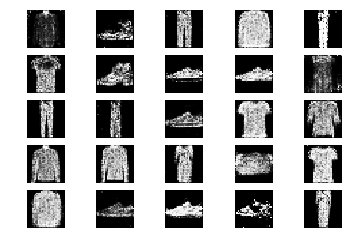

49501 [Discriminator loss: 0.585139, acc.: 62.50%] [Generator loss: 1.042474]
49502 [Discriminator loss: 0.596836, acc.: 65.62%] [Generator loss: 1.089720]
49503 [Discriminator loss: 0.626441, acc.: 68.75%] [Generator loss: 1.130203]
49504 [Discriminator loss: 0.565110, acc.: 71.88%] [Generator loss: 1.038239]
49505 [Discriminator loss: 0.604340, acc.: 64.06%] [Generator loss: 0.963938]
49506 [Discriminator loss: 0.593022, acc.: 60.94%] [Generator loss: 1.028346]
49507 [Discriminator loss: 0.615263, acc.: 62.50%] [Generator loss: 1.055479]
49508 [Discriminator loss: 0.615080, acc.: 67.19%] [Generator loss: 1.002920]
49509 [Discriminator loss: 0.606969, acc.: 59.38%] [Generator loss: 1.178976]
49510 [Discriminator loss: 0.641434, acc.: 62.50%] [Generator loss: 1.031196]
49511 [Discriminator loss: 0.565005, acc.: 68.75%] [Generator loss: 1.038080]
49512 [Discriminator loss: 0.610980, acc.: 64.06%] [Generator loss: 1.152422]
49513 [Discriminator loss: 0.563316, acc.: 73.44%] [Generator lo

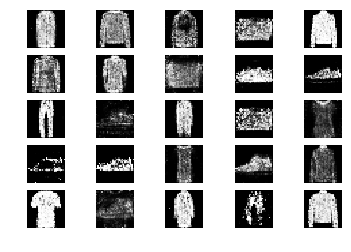

49601 [Discriminator loss: 0.584743, acc.: 70.31%] [Generator loss: 1.171707]
49602 [Discriminator loss: 0.595185, acc.: 68.75%] [Generator loss: 1.020746]
49603 [Discriminator loss: 0.634082, acc.: 62.50%] [Generator loss: 1.161976]
49604 [Discriminator loss: 0.621325, acc.: 65.62%] [Generator loss: 1.036358]
49605 [Discriminator loss: 0.551670, acc.: 70.31%] [Generator loss: 1.057030]
49606 [Discriminator loss: 0.593917, acc.: 73.44%] [Generator loss: 1.031415]
49607 [Discriminator loss: 0.746628, acc.: 57.81%] [Generator loss: 1.099043]
49608 [Discriminator loss: 0.658092, acc.: 62.50%] [Generator loss: 1.055306]
49609 [Discriminator loss: 0.641994, acc.: 65.62%] [Generator loss: 1.067073]
49610 [Discriminator loss: 0.586850, acc.: 68.75%] [Generator loss: 1.035007]
49611 [Discriminator loss: 0.611498, acc.: 70.31%] [Generator loss: 1.193414]
49612 [Discriminator loss: 0.654648, acc.: 68.75%] [Generator loss: 1.123529]
49613 [Discriminator loss: 0.619792, acc.: 67.19%] [Generator lo

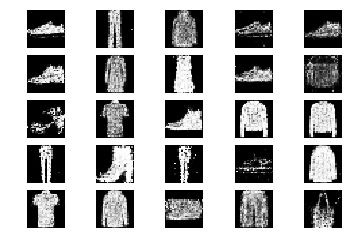

49701 [Discriminator loss: 0.555758, acc.: 67.19%] [Generator loss: 1.028418]
49702 [Discriminator loss: 0.575578, acc.: 65.62%] [Generator loss: 1.206816]
49703 [Discriminator loss: 0.598606, acc.: 64.06%] [Generator loss: 1.028328]
49704 [Discriminator loss: 0.598332, acc.: 75.00%] [Generator loss: 0.988381]
49705 [Discriminator loss: 0.638013, acc.: 68.75%] [Generator loss: 0.953646]
49706 [Discriminator loss: 0.603445, acc.: 65.62%] [Generator loss: 1.003019]
49707 [Discriminator loss: 0.619047, acc.: 62.50%] [Generator loss: 0.985709]
49708 [Discriminator loss: 0.513374, acc.: 75.00%] [Generator loss: 1.104005]
49709 [Discriminator loss: 0.737951, acc.: 53.12%] [Generator loss: 0.911040]
49710 [Discriminator loss: 0.614121, acc.: 68.75%] [Generator loss: 1.119272]
49711 [Discriminator loss: 0.603093, acc.: 62.50%] [Generator loss: 1.039549]
49712 [Discriminator loss: 0.575821, acc.: 67.19%] [Generator loss: 1.005335]
49713 [Discriminator loss: 0.578223, acc.: 70.31%] [Generator lo

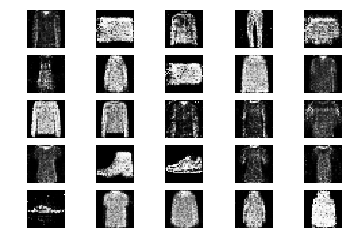

49801 [Discriminator loss: 0.571063, acc.: 70.31%] [Generator loss: 1.013447]
49802 [Discriminator loss: 0.639396, acc.: 62.50%] [Generator loss: 1.242496]
49803 [Discriminator loss: 0.568537, acc.: 70.31%] [Generator loss: 1.097482]
49804 [Discriminator loss: 0.604044, acc.: 62.50%] [Generator loss: 1.224957]
49805 [Discriminator loss: 0.540868, acc.: 78.12%] [Generator loss: 1.209779]
49806 [Discriminator loss: 0.658375, acc.: 64.06%] [Generator loss: 1.133848]
49807 [Discriminator loss: 0.557444, acc.: 70.31%] [Generator loss: 1.101406]
49808 [Discriminator loss: 0.630132, acc.: 68.75%] [Generator loss: 1.008971]
49809 [Discriminator loss: 0.533190, acc.: 76.56%] [Generator loss: 1.082791]
49810 [Discriminator loss: 0.580402, acc.: 71.88%] [Generator loss: 1.037037]
49811 [Discriminator loss: 0.686563, acc.: 56.25%] [Generator loss: 0.997707]
49812 [Discriminator loss: 0.622048, acc.: 67.19%] [Generator loss: 1.059418]
49813 [Discriminator loss: 0.594327, acc.: 67.19%] [Generator lo

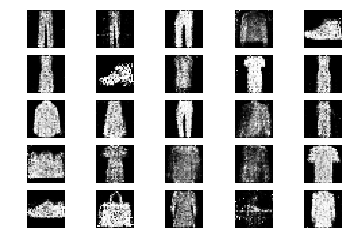

49901 [Discriminator loss: 0.621316, acc.: 59.38%] [Generator loss: 1.078047]
49902 [Discriminator loss: 0.654872, acc.: 64.06%] [Generator loss: 0.944900]
49903 [Discriminator loss: 0.635411, acc.: 62.50%] [Generator loss: 0.929221]
49904 [Discriminator loss: 0.565377, acc.: 71.88%] [Generator loss: 0.928665]
49905 [Discriminator loss: 0.633428, acc.: 62.50%] [Generator loss: 1.013122]
49906 [Discriminator loss: 0.680828, acc.: 50.00%] [Generator loss: 1.129291]
49907 [Discriminator loss: 0.603330, acc.: 65.62%] [Generator loss: 0.913335]
49908 [Discriminator loss: 0.625027, acc.: 62.50%] [Generator loss: 1.004133]
49909 [Discriminator loss: 0.561627, acc.: 70.31%] [Generator loss: 0.975891]
49910 [Discriminator loss: 0.566567, acc.: 68.75%] [Generator loss: 0.941060]
49911 [Discriminator loss: 0.683427, acc.: 57.81%] [Generator loss: 1.002819]
49912 [Discriminator loss: 0.586142, acc.: 65.62%] [Generator loss: 1.216241]
49913 [Discriminator loss: 0.591803, acc.: 67.19%] [Generator lo

In [9]:
epochs = 50000

batch_size = 32
valid = np.ones((batch_size, 1))
fake = np.zeros((batch_size, 1))

for epoch in range(epochs):
  idx = np.random.randint(0, x_train.shape[0], batch_size)
  imgs = x_train[idx]

  noise = np.random.normal(0, 1, (batch_size, 100))

  gen_imgs = generator.predict(noise)

  d_loss_real = discriminator.train_on_batch(imgs, valid)
  d_loss_fake = discriminator.train_on_batch(gen_imgs, fake)
  d_loss = 0.5*np.add(d_loss_real, d_loss_fake)

  noise = np.random.normal(0, 1, (batch_size, 100))
  g_loss = combined.train_on_batch(noise, valid)

  print("%d [Discriminator loss: %f, acc.: %.2f%%] [Generator loss: %f]" % (epoch, d_loss[0], 100*d_loss[1], g_loss))

  if epoch % 100 == 0:
    sample_images(epoch)

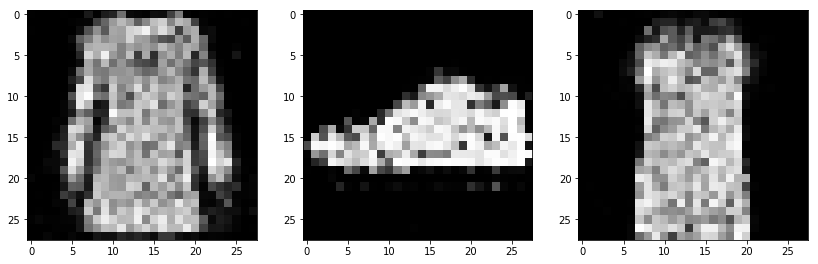

In [18]:
gen_imgs = generator.predict(np.random.normal(0, 1, (5*5, 100)))

gen_imgs = 0.5*gen_imgs+0.5

plt.figure(figsize=(14, 7))
plt.subplot(131)
plt.imshow(gen_imgs[0, :, :, 0], cmap='gray')
plt.subplot(132)
plt.imshow(gen_imgs[1, :, :, 0], cmap='gray')
plt.subplot(133)
plt.imshow(gen_imgs[2, :, :, 0], cmap='gray')
plt.show()
plt.close()